In [2]:
%load_ext autoreload
%autoreload 2

In [5]:
# Import statements:
import sys
import os
import yaml
sys.path.append(os.getcwd() + '/../Client_modules/')

from mTempControl import *
import mResSweepDouble
from socProxy import makeProxy
import h5py
from PythonDrivers.control_atten import setatten
from PythonDrivers.getInputDicts import *
import time
import datetime
from run_FFS import run_FFS, run_TT
from PythonDrivers.ldausbcli import CLI_Vaunix_Attn
from contextlib import contextmanager,redirect_stderr,redirect_stdout
from os import devnull

# tempPath = os.path.join('Z:','t1Team','logFiles')

In [6]:
# Temperature monitoring infrastructure (this could be a module)
tc = tempController() # needs to be reinstantiated to read in latest day's logfile

In [12]:
# Instantiate four instances of the RFSOC
socs=[]
soccfgs=[]

# soc1,soccfg1=makeProxy('192.168.1.10')
# socs.append(soc1)
# soccfgs.append(soccfg1)
# print(soccfg1)

# soc2,soccfg2=makeProxy('192.168.1.11')
# socs.append(soc2)
# soccfgs.append(soccfg2)
# print(soccfg2)

soc3,soccfg3=makeProxy('192.168.1.12')
socs.append(soc3)
soccfgs.append(soccfg3)
print(soccfg3)

# soc4,soccfg4=makeProxy('192.168.1.13')
# socs.append(soc4)
# soccfgs.append(soccfg4)
# print(soccfg4)

Pyro.NameServer PYRO:Pyro.NameServer@192.168.1.12:8888
myqick2 PYRO:obj_8c19f2bf3cbb4158ad4588158beb68e5@192.168.1.12:33537


NamingError: unknown name: myqick

In [13]:
# Instantiate four instances of the RFSOC
socs=[]
soccfgs=[]

soc3,soccfg3=makeProxy('192.168.1.12')
socs.append(soc3)
soccfgs.append(soccfg3)
print(soccfg3)

Pyro.NameServer PYRO:Pyro.NameServer@192.168.1.12:8888
myqick2 PYRO:obj_8c19f2bf3cbb4158ad4588158beb68e5@192.168.1.12:33537
myqick PYRO:obj_9e38767653e3490884e2705196a00989@192.168.1.12:33001

QICK configuration:

	Board: ZCU216

	Global clocks (MHz): tProcessor 430.080, RF reference 245.760

	7 signal generator channels:
	0:	axis_signal_gen_v4 - tProc output 1, envelope memory 65536 samples
		DAC tile 2, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	1:	axis_signal_gen_v4 - tProc output 2, envelope memory 65536 samples
		DAC tile 2, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	2:	axis_signal_gen_v4 - tProc output 3, envelope memory 65536 samples
		DAC tile 2, ch 2, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	3:	axis_signal_gen_v4 - tProc output 4, envelope memory 65536 samples
		DAC tile 2, ch 3, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	4:	axis_signal_gen_v4 - tProc output 5, envelope memory 65536 samples
		DAC tile 3, ch 0, 32-bit DDS, fabric=430.080 MH

# Read in sweep parameters

In [ ]:
# Read in sweep initial confirguration from yaml file
setup_file_name='2023-08-29_cooldown_setup.yaml'
setup_file_location = os.path.join('setup_files',setup_file_name)

stream = open(setup_file_location, 'r')
setupDict = yaml.full_load(stream)
stream.close()

# create and add wanted chipDicts, add a chip for each rfsoc
chipDicts=[]
chipDict1 = setupDict['2023-08-01 TALE04-annealed']
#chipDict2 = setupDict['2023-08-21 TAHP02_AuPd_Cl_etch']
#chipDict3 = setupDict['2023-08-24_TAHP02-Au-Cl-etch']
#chipDict4 = setupDict['2023-08-24_TAHP02_Au_F_etch']



chipDicts.append(chipDict1)
#chipDicts.append(chipDict2)
#chipDicts.append(chipDict3)
#chipDicts.append(chipDict4)

In [24]:
# Read in sweep initial confirguration from yaml file
setup_file_name='2023-08-29_cooldown_setup_TT.yaml'
setup_file_location = os.path.join('setup_files',setup_file_name)

stream = open(setup_file_location, 'r')
setupDict = yaml.full_load(stream)
stream.close()

# create and add wanted chipDicts, add a chip for each rfsoc
chipDicts=[]
chipDict3 = setupDict['2023-08-24_TAHP02-Au-Cl-etch']

chipDicts.append(chipDict3)

# Set attenuations and check that we using a good power

In [12]:
savePath = r'Z:\t1Team\Data\rfsoc_dump'
attobj = CLI_Vaunix_Attn()
attobj.set_attenuation(1,20,1)
attobj.set_attenuation(1,20,2)
attobj.set_attenuation(1,10,3)
attobj.set_attenuation(1,10,4)

True

In [ ]:
getInputDicts(chipDict1,measType='FFS')[0]

In [ ]:
#RFSoC 10

# define sweep params
inputDict = {}
inputDict['LO_f'] = 0  # local oscillator frequency

# define frequencies
inputDict['span_f'] = [.01, .01]

# center freqs

#inputDict['res_f']=[4528.043,4776.834]
#inputDict['names']=['4p42',
#  '4p70']

inputDict['res_f']=[4935.091,5092.406]
inputDict['names']=['4p94',
  '5p09']

# define numbers of points
inputDict['n_expts'] = 500  # number of points along the frequency axis
inputDict['n_rounds'] = 1 # number of times to sweep along the frequency axis
inputDict['n_reps'] = 1  # number of repetitions to take at each frequency point
# inputDict['n_reps'] = 1

# timing. Units are clock cycles, but converted from us
inputDict['ring_up_time'] = 500  # time waiting for the resonator to ring up at the start of each sweep
inputDict['ring_between_time'] = 50  # time waiting for the resonator to ring up at the start of each sweep
inputDict['readout_length'] = 10000  # time to average over
inputDict['adc_trig_offset'] = 0.1  # time after the DAC starts the final steady pulse before the ADC starts it's read

# power
# idxs = [np.argmin(np.abs(np.array(f)-inputDict['res_f'][0])),np.argmin(np.abs(np.array(f)-inputDict['res_f'][1]))]
inputDict['basePowers'] = 0 # dBm
inputDict['gain'] = [30000, 30000]

# acquire data
# Acquire
inputDict['power'] = inputDict['basePowers']


Instance2 = mResSweepDouble.ResSweep(path=savePath, prefix='phase_test', inputDict=inputDict, soc=socs[0], soccfg=soccfgs[0])

with open(devnull,'w') as f:
    with redirect_stderr(f):
        data2 = mResSweepDouble.ResSweep.acquire(Instance2)
mResSweepDouble.ResSweep.display(Instance2, data2, fit=True)
# mResSweepDouble.ResSweep.save_data(Instance2, data2)

In [ ]:
# RFSoC 11

# define sweep params
inputDict = {}
inputDict['LO_f'] = 0  # local oscillator frequency

# define frequencies
inputDict['span_f'] = [.5, .5]

# center freqs

inputDict['res_f']=[7991.71,7385.58]
inputDict['names']=['4p42','4p70']
# define numbers of points
inputDict['n_expts'] = 500  # number of points along the frequency axis
inputDict['n_rounds'] = 1 # number of times to sweep along the frequency axis
inputDict['n_reps'] = 1  # number of repetitions to take at each frequency point

# timing. Units are clock cycles, but converted from us
inputDict['ring_up_time'] = 500  # time waiting for the resonator to ring up at the start of each sweep
inputDict['ring_between_time'] = 50  # time waiting for the resonator to ring up at the start of each sweep
inputDict['readout_length'] = 10000  # time to average over
inputDict['adc_trig_offset'] = 0.1  # time after the DAC starts the final steady pulse before the ADC starts it's read

# power
# idxs = [np.argmin(np.abs(np.array(f)-inputDict['res_f'][0])),np.argmin(np.abs(np.array(f)-inputDict['res_f'][1]))]
inputDict['basePowers'] = 0 # dBm
inputDict['gain'] = [30000, 30000]

# acquire data
# Acquire
inputDict['power'] = inputDict['basePowers']
Instance2 = mResSweepDouble.ResSweep(path=savePath, prefix='phase_test', inputDict=inputDict, soc=socs[1], soccfg=soccfgs[1])

with open(devnull,'w') as f:
    with redirect_stderr(f):
        data2 = mResSweepDouble.ResSweep.acquire(Instance2)
mResSweepDouble.ResSweep.display(Instance2, data2, fit=False)
# mResSweepDouble.ResSweep.save_data(Instance2, data2)

Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 12.001 s


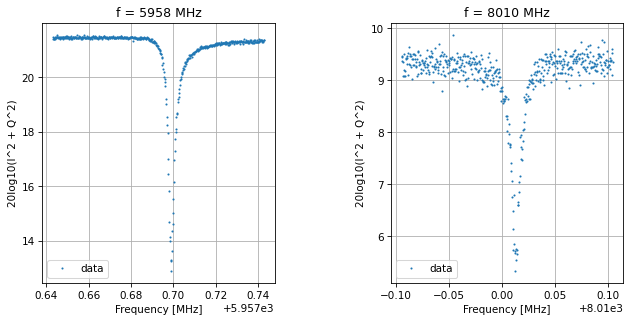

([[], []], [[], []])

In [35]:
# RFSoC 12

# define sweep params
inputDict = {}
inputDict['LO_f'] = 0  # local oscillator frequency

# define frequencies
inputDict['span_f'] = [0.1, 0.2]

# center freqs

inputDict['res_f']=[5957.693,8010.005]
inputDict['names']=['4p42',
  '4p70']
# define numbers of points
inputDict['n_expts'] = 500  # number of points along the frequency axis
inputDict['n_rounds'] = 1 # number of times to sweep along the frequency axis
inputDict['n_reps'] = 1  # number of repetitions to take at each frequency point
# inputDict['n_reps'] = 1

# timing. Units are clock cycles, but converted from us
inputDict['ring_up_time'] = 500  # time waiting for the resonator to ring up at the start of each sweep
inputDict['ring_between_time'] = 50  # time waiting for the resonator to ring up at the start of each sweep
inputDict['readout_length'] = 10000  # time to average over
inputDict['adc_trig_offset'] = 0.1  # time after the DAC starts the final steady pulse before the ADC starts it's read

# power
# idxs = [np.argmin(np.abs(np.array(f)-inputDict['res_f'][0])),np.argmin(np.abs(np.array(f)-inputDict['res_f'][1]))]
inputDict['basePowers'] = 0 # dBm
inputDict['gain'] = [30000, 30000]

# acquire data
# Acquire
inputDict['power'] = inputDict['basePowers']
Instance2 = mResSweepDouble.ResSweep(path=savePath, prefix='phase_test', inputDict=inputDict, soc=socs[0], soccfg=soccfgs[0])

with open(devnull,'w') as f:
    with redirect_stderr(f):
        data2 = mResSweepDouble.ResSweep.acquire(Instance2)
mResSweepDouble.ResSweep.display(Instance2, data2, fit=False)
# mResSweepDouble.ResSweep.save_data(Instance2, data2)

In [ ]:
# RFSoC 13

# define sweep params
inputDict = {}
inputDict['LO_f'] = 0  # local oscillator frequency

# define frequencies
inputDict['span_f'] = [.5, .5]

# center freqs

inputDict['res_f']=[8014.64,8014.64]
inputDict['names']=['4p42',
  '4p70']
# define numbers of points
inputDict['n_expts'] = 500  # number of points along the frequency axis
inputDict['n_rounds'] = 1 # number of times to sweep along the frequency axis
inputDict['n_reps'] = 1  # number of repetitions to take at each frequency point
# inputDict['n_reps'] = 1

# timing. Units are clock cycles, but converted from us
inputDict['ring_up_time'] = 500  # time waiting for the resonator to ring up at the start of each sweep
inputDict['ring_between_time'] = 50  # time waiting for the resonator to ring up at the start of each sweep
inputDict['readout_length'] = 10000  # time to average over
inputDict['adc_trig_offset'] = 0.1  # time after the DAC starts the final steady pulse before the ADC starts it's read

# power
# idxs = [np.argmin(np.abs(np.array(f)-inputDict['res_f'][0])),np.argmin(np.abs(np.array(f)-inputDict['res_f'][1]))]
inputDict['basePowers'] = 0 # dBm
inputDict['gain'] = [30000, 30000]

# acquire data
# Acquire
inputDict['power'] = inputDict['basePowers']
Instance2 = mResSweepDouble.ResSweep(path=savePath, prefix='phase_test', inputDict=inputDict, soc=socs[3], soccfg=soccfgs[3])

with open(devnull,'w') as f:
    with redirect_stderr(f):
        data2 = mResSweepDouble.ResSweep.acquire(Instance2)
mResSweepDouble.ResSweep.display(Instance2, data2, fit=True)
# mResSweepDouble.ResSweep.save_data(Instance2, data2)

In [34]:
tc.setTemp(0)

# Take measurements

1695820603.7541275
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.781 s


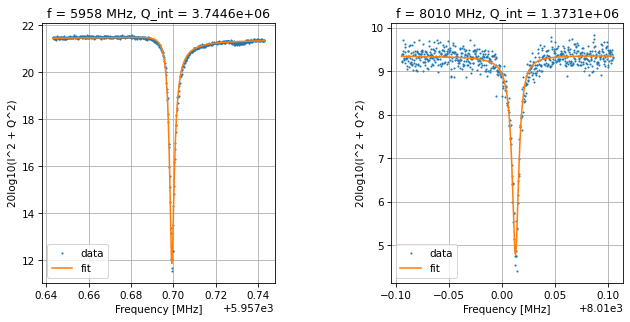

Frequencies out are: [5957.699001933966, 8010.012915417614] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.586 s


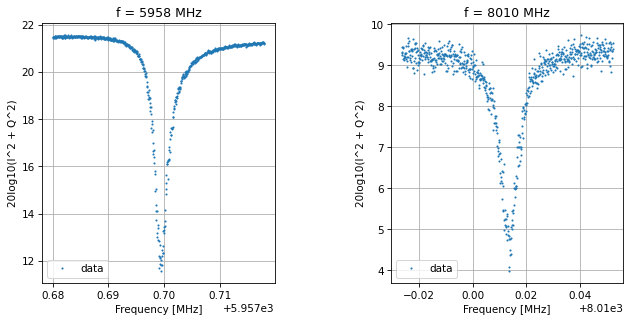

Saving data-2023-09-27-09-17-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.464 s


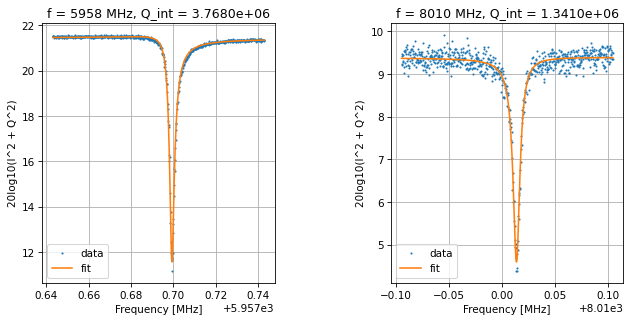

Frequencies out are: [5957.699030889667, 8010.013939552585] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.518 s


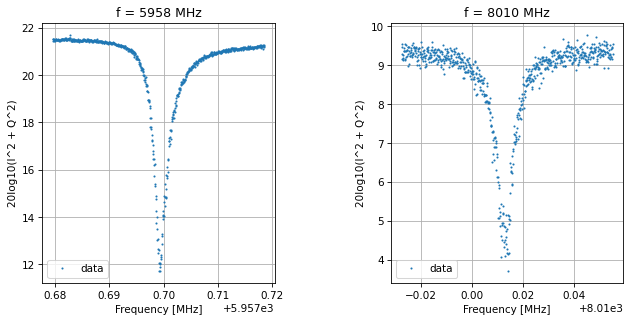

Saving data-2023-09-27-09-17-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.581 s


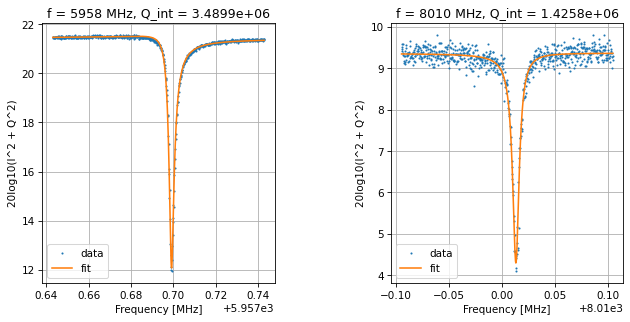

Frequencies out are: [5957.698819074424, 8010.013359494702] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.562 s


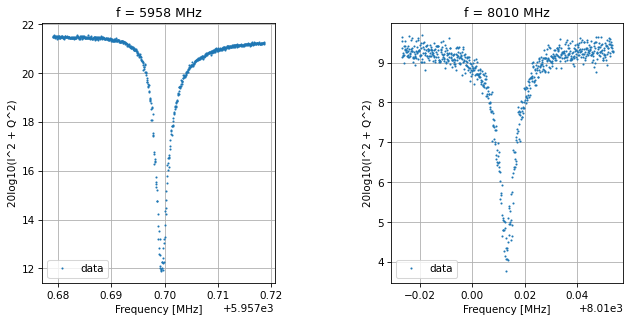

Saving data-2023-09-27-09-18-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


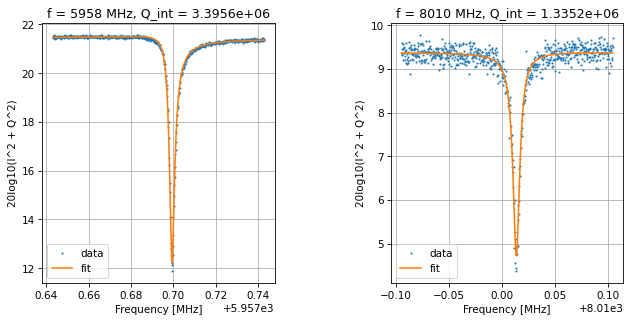

Frequencies out are: [5957.699060157792, 8010.013737200395] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.488 s


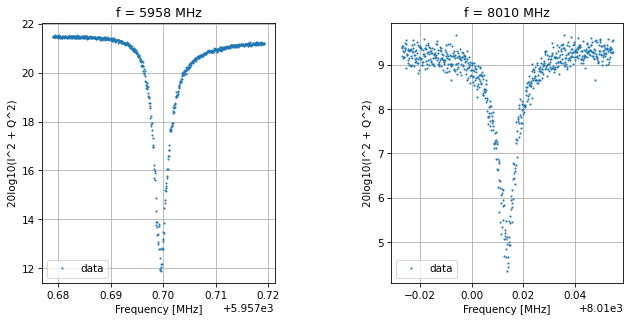

Saving data-2023-09-27-09-18-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.267 s


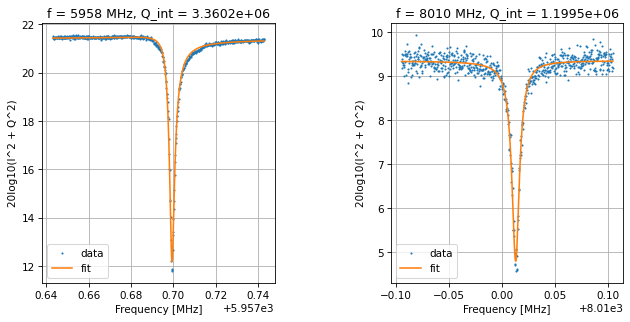

Frequencies out are: [5957.699051035091, 8010.013077924835] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.382 s


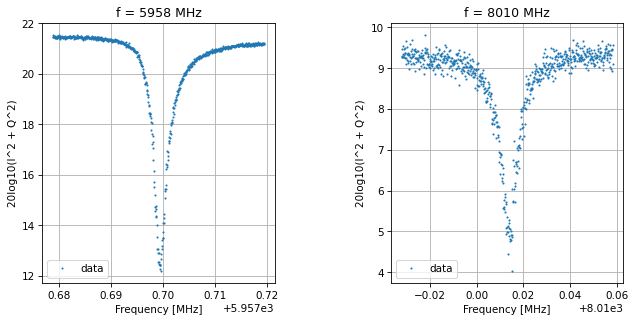

Saving data-2023-09-27-09-19-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.480 s


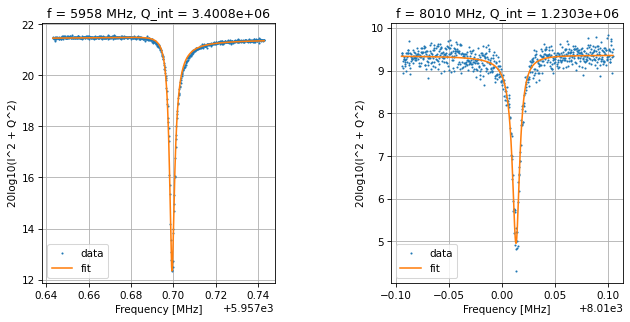

Frequencies out are: [5957.69908662862, 8010.013527366426] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.440 s


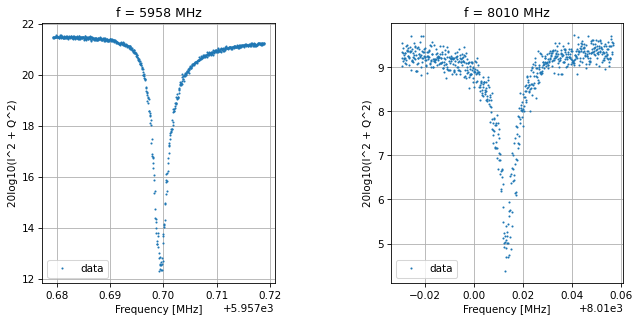

Saving data-2023-09-27-09-19-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.410 s


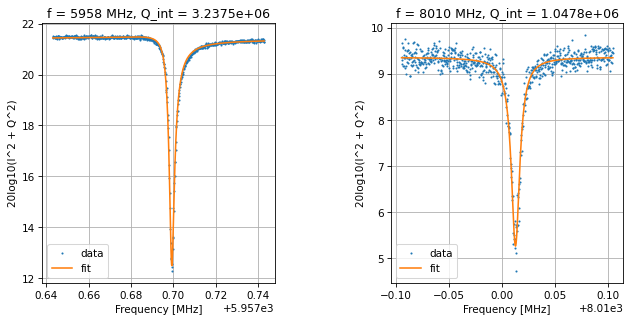

Frequencies out are: [5957.698940200018, 8010.012860126184] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.319 s


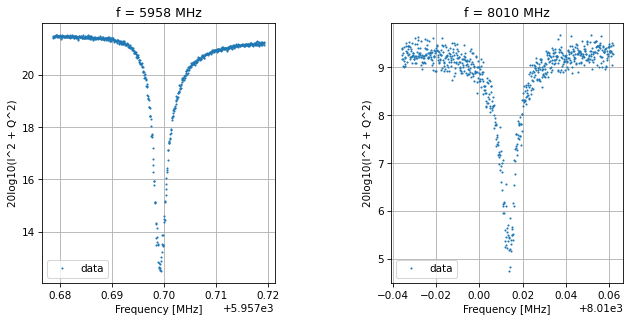

Saving data-2023-09-27-09-20-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.376 s


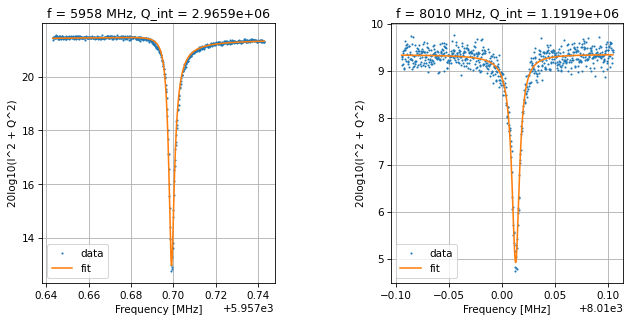

Frequencies out are: [5957.698845316604, 8010.013077688102] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


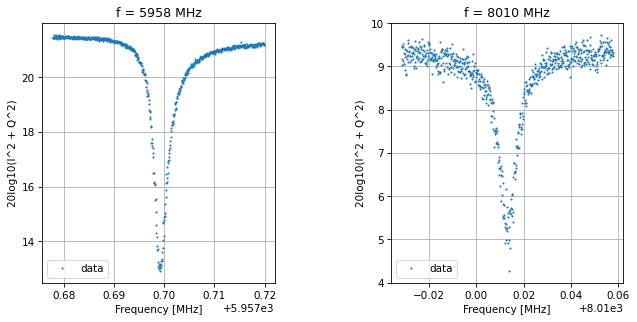

Saving data-2023-09-27-09-20-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.520 s


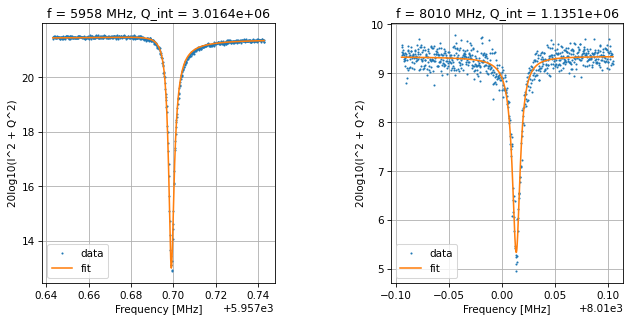

Frequencies out are: [5957.698781860603, 8010.013653391354] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.458 s


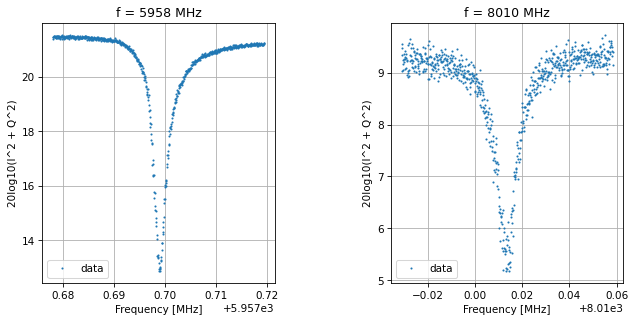

Saving data-2023-09-27-09-21-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.324 s


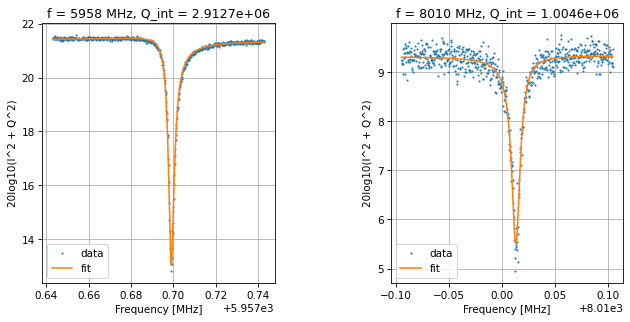

Frequencies out are: [5957.698726352987, 8010.01340565972] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.451 s


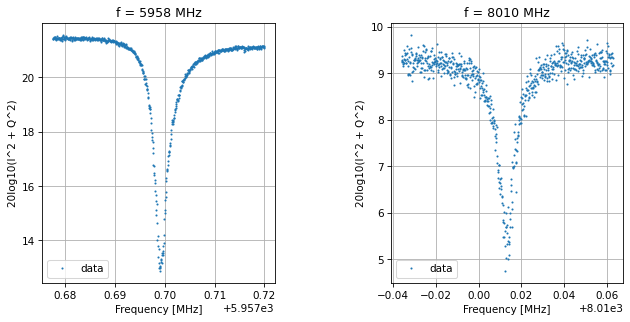

Saving data-2023-09-27-09-21-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.422 s


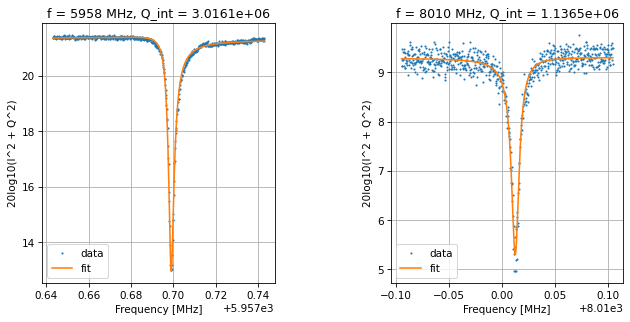

Frequencies out are: [5957.698710134991, 8010.012817651299] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.498 s


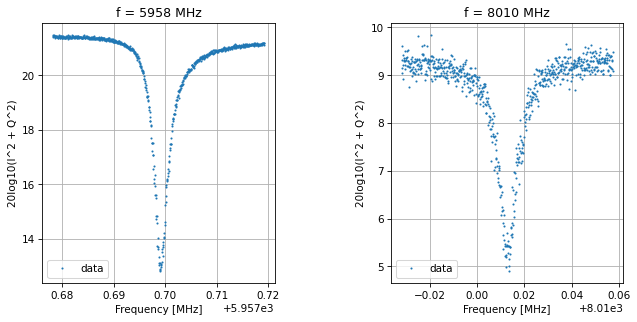

Saving data-2023-09-27-09-22-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.370 s


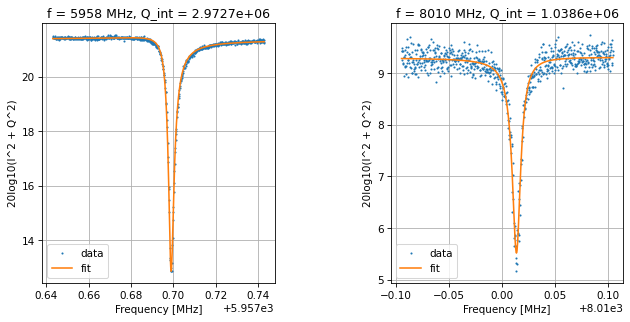

Frequencies out are: [5957.698648161006, 8010.013953996401] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.425 s


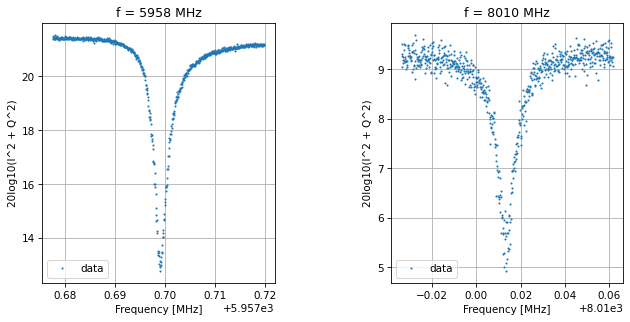

Saving data-2023-09-27-09-23-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.280 s


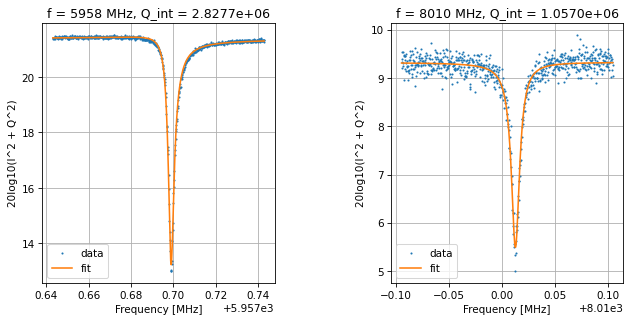

Frequencies out are: [5957.698650423469, 8010.01288684447] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.427 s


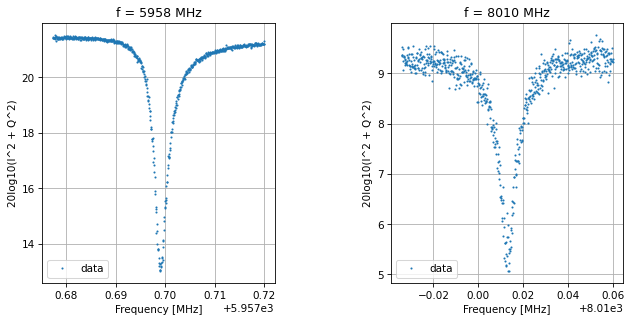

Saving data-2023-09-27-09-23-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.407 s


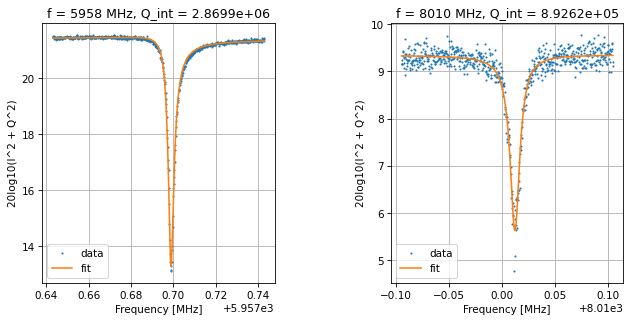

Frequencies out are: [5957.698620415994, 8010.012413537872] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.333 s


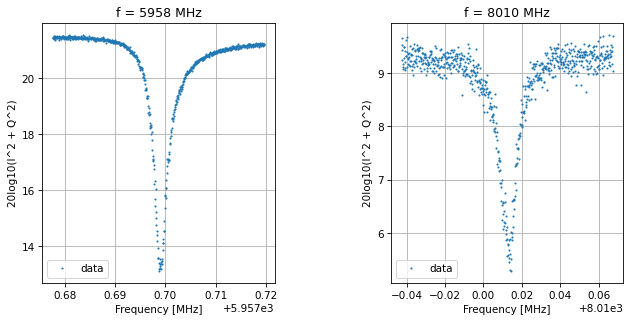

Saving data-2023-09-27-09-24-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.446 s


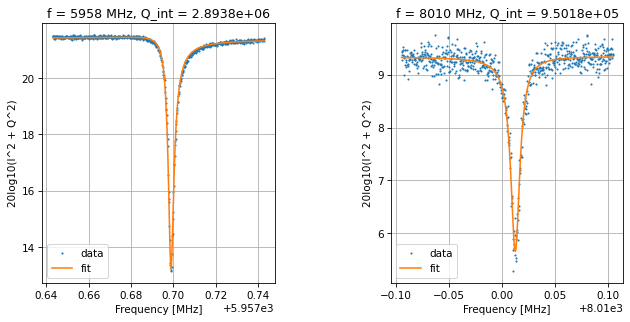

Frequencies out are: [5957.698612100871, 8010.012771554793] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.395 s


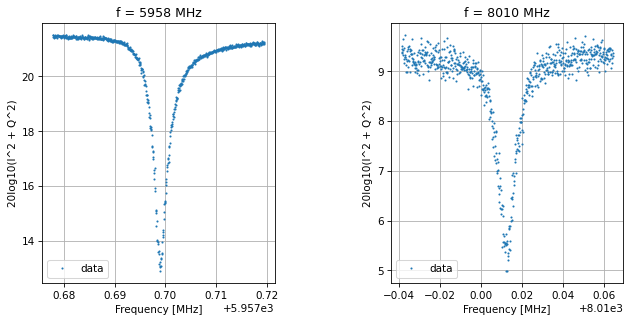

Saving data-2023-09-27-09-24-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.740 s


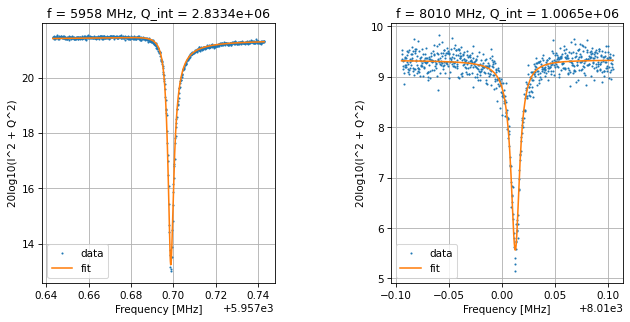

Frequencies out are: [5957.698466292535, 8010.012751740382] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.508 s


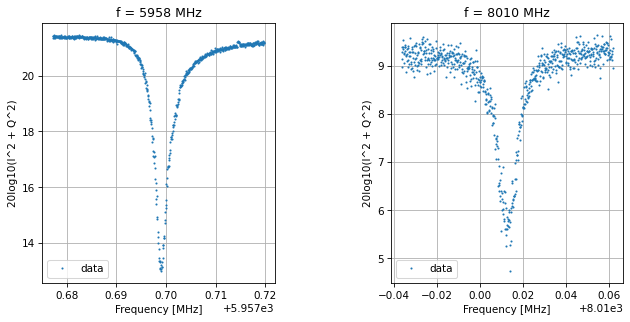

Saving data-2023-09-27-09-25-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.446 s


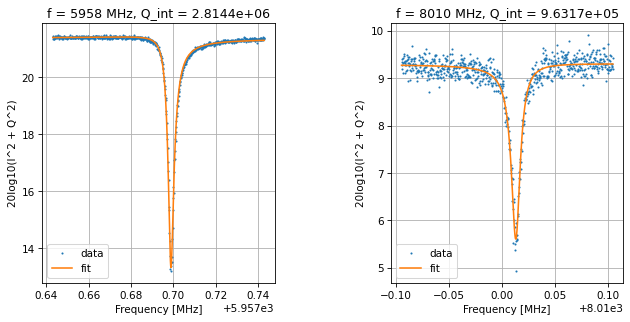

Frequencies out are: [5957.698609408714, 8010.013415029292] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.516 s


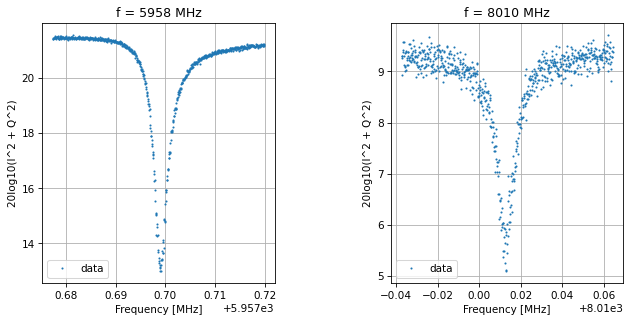

Saving data-2023-09-27-09-25-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


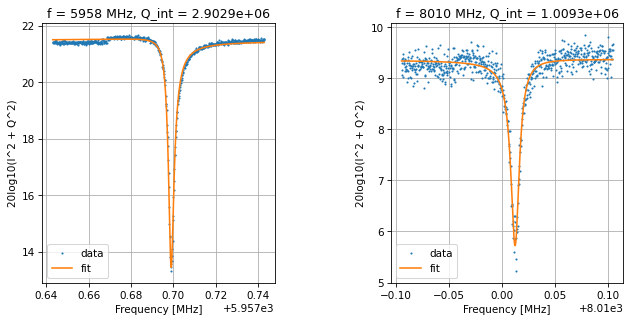

Frequencies out are: [5957.698719058489, 8010.012720467695] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.371 s


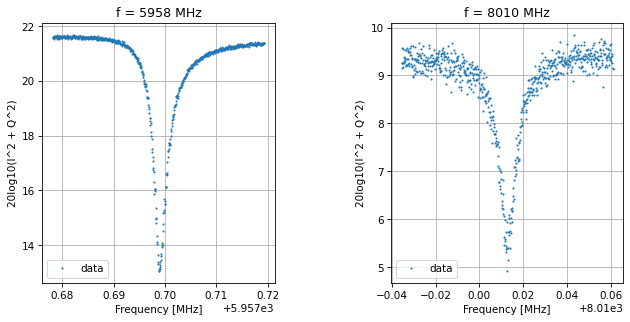

Saving data-2023-09-27-09-26-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.457 s


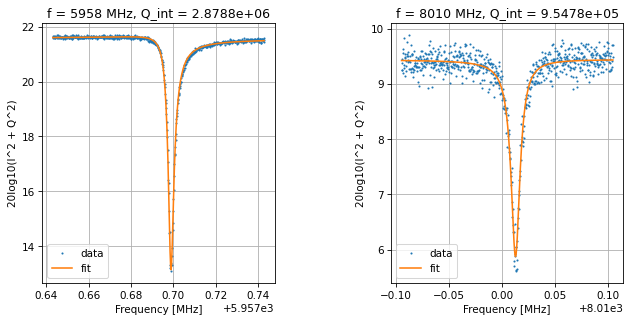

Frequencies out are: [5957.698586875984, 8010.012998593712] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.535 s


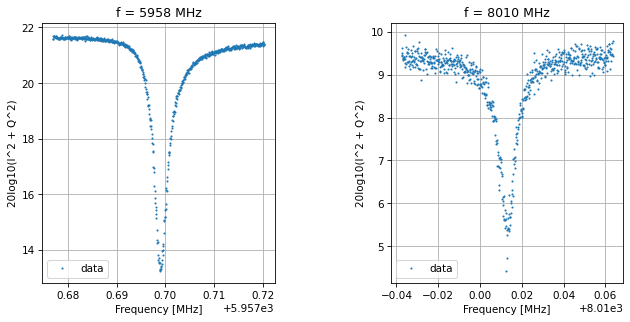

Saving data-2023-09-27-09-26-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.596 s


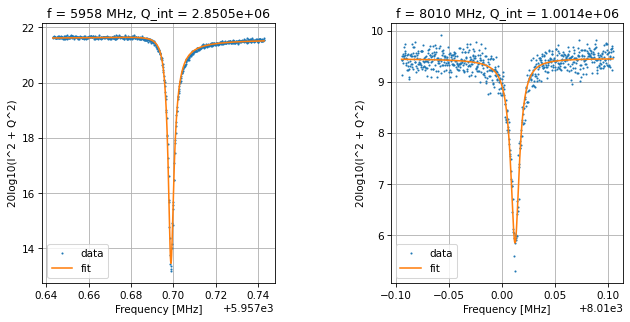

Frequencies out are: [5957.6985867245785, 8010.012487868434] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.551 s


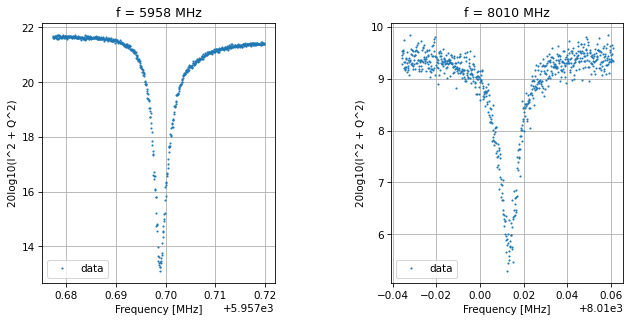

Saving data-2023-09-27-09-27-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.565 s


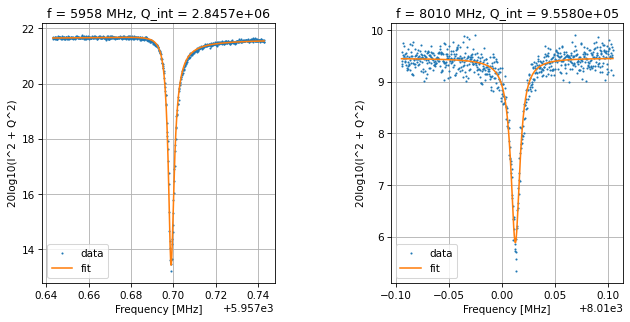

Frequencies out are: [5957.6986489764695, 8010.012777091167] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.531 s


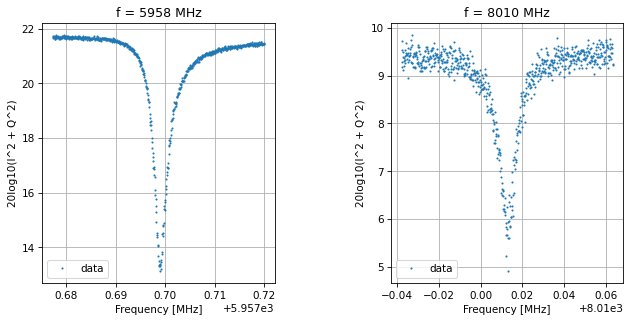

Saving data-2023-09-27-09-27-56
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.358 s


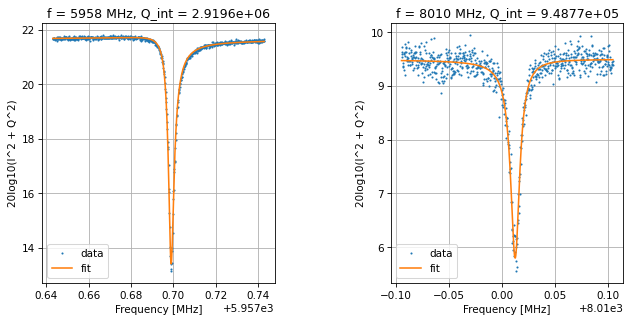

Frequencies out are: [5957.698661397481, 8010.012719190857] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.509 s


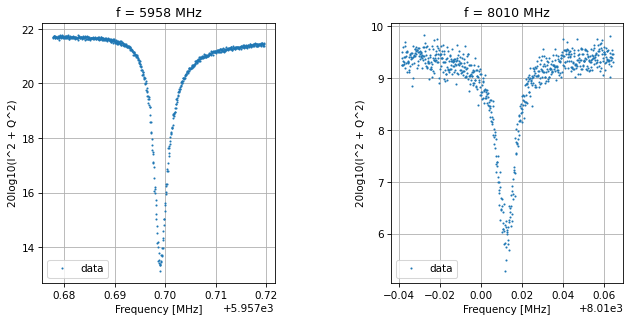

Saving data-2023-09-27-09-28-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.539 s


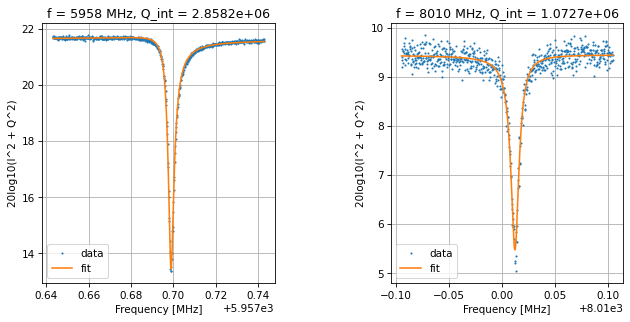

Frequencies out are: [5957.698604759191, 8010.012467333867] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


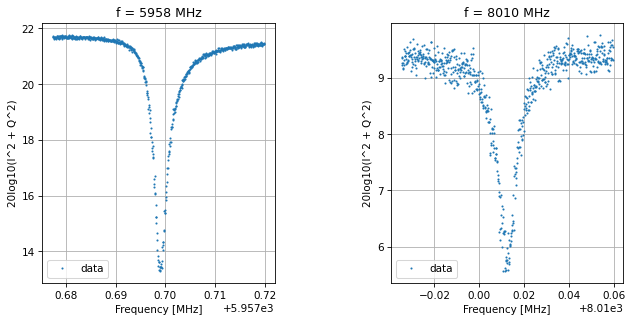

Saving data-2023-09-27-09-29-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.396 s


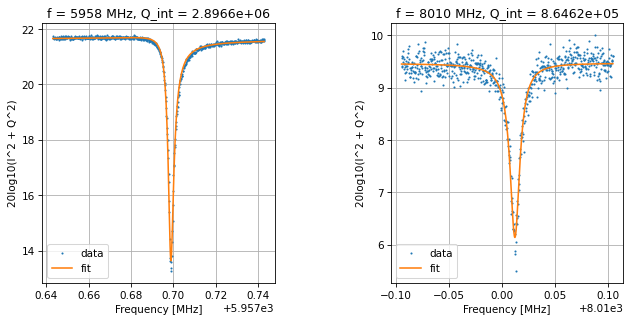

Frequencies out are: [5957.698554584558, 8010.012387723709] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.524 s


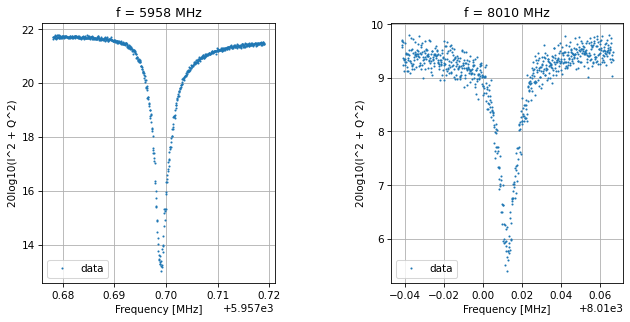

Saving data-2023-09-27-09-29-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.449 s


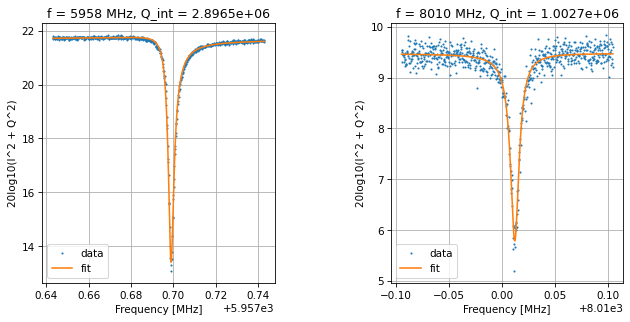

Frequencies out are: [5957.698616951513, 8010.012276681122] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.503 s


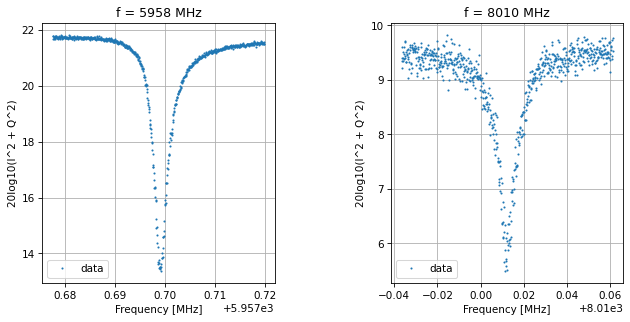

Saving data-2023-09-27-09-30-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.487 s


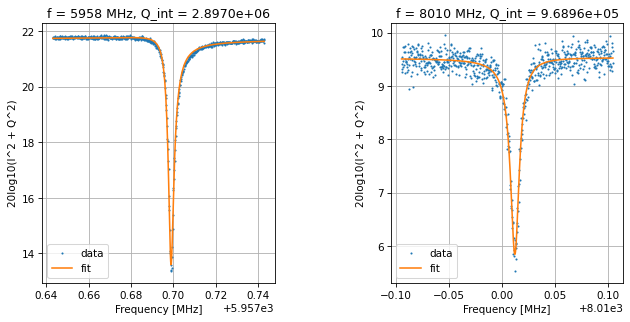

Frequencies out are: [5957.698626723955, 8010.012430012873] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.843 s


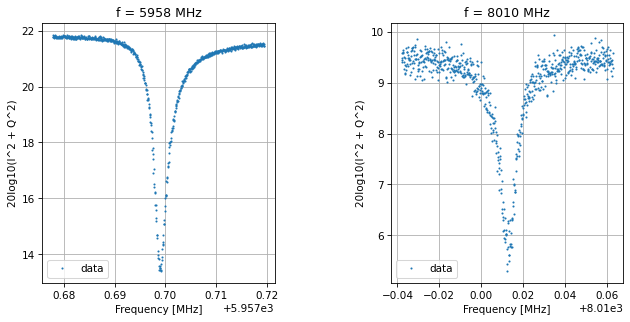

Saving data-2023-09-27-09-30-40
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


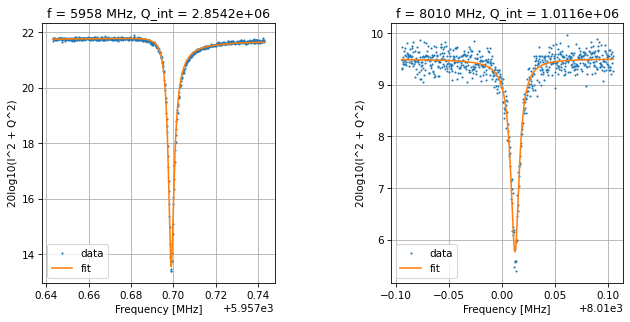

Frequencies out are: [5957.698661513788, 8010.012431154836] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.368 s


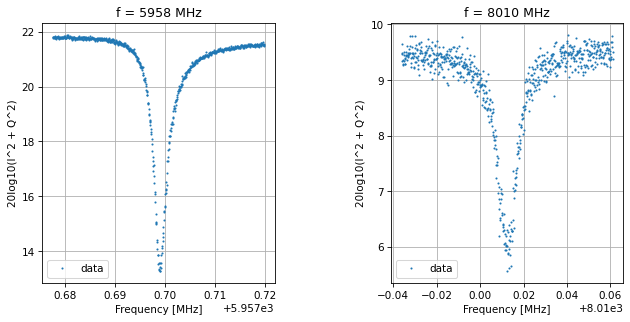

Saving data-2023-09-27-09-31-13
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.420 s


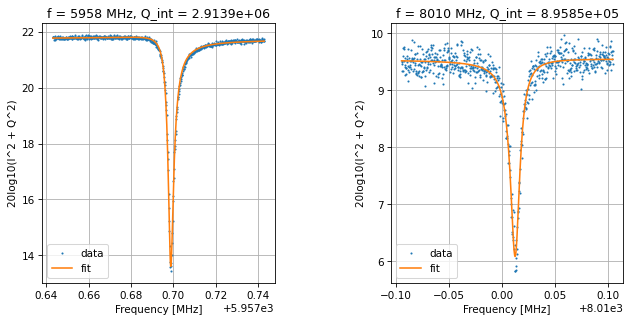

Frequencies out are: [5957.698497349218, 8010.012772515456] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.436 s


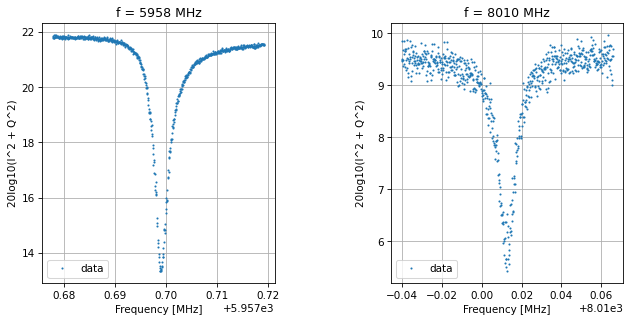

Saving data-2023-09-27-09-31-46
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.510 s


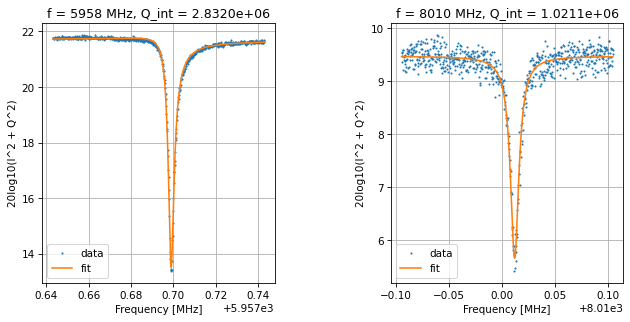

Frequencies out are: [5957.698631384002, 8010.012031705472] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.421 s


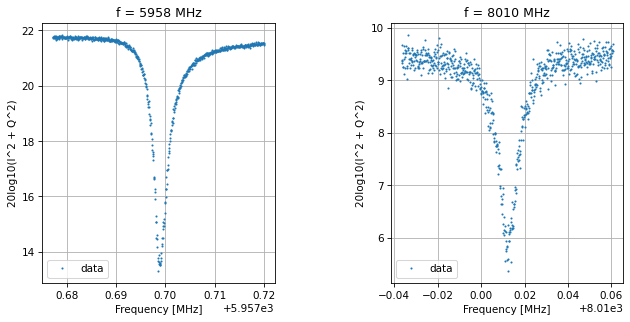

Saving data-2023-09-27-09-32-19
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.539 s


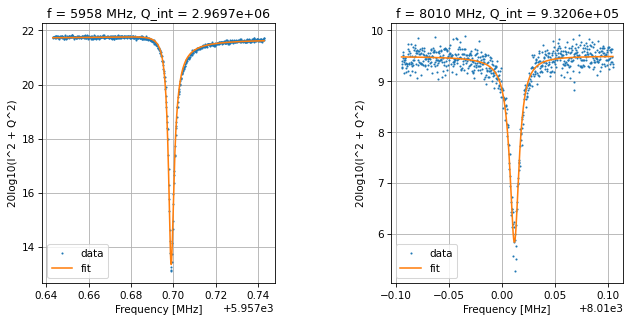

Frequencies out are: [5957.69867166777, 8010.011913316324] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.477 s


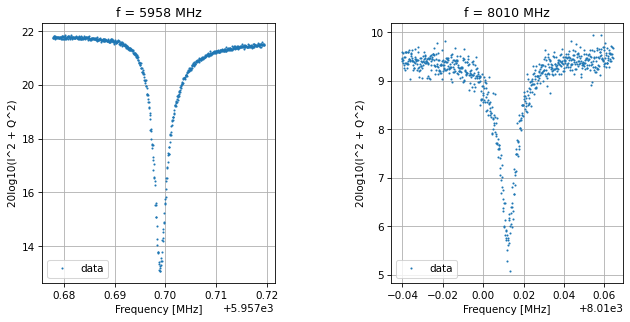

Saving data-2023-09-27-09-32-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.356 s


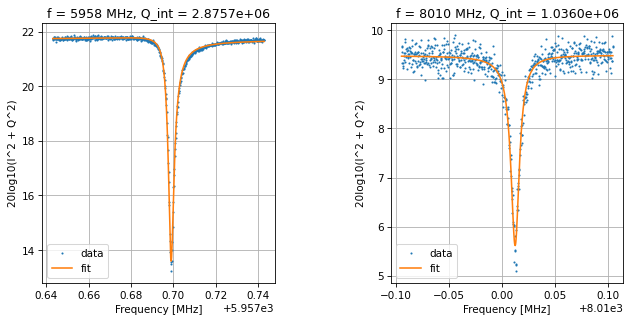

Frequencies out are: [5957.698665998767, 8010.012631151797] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.441 s


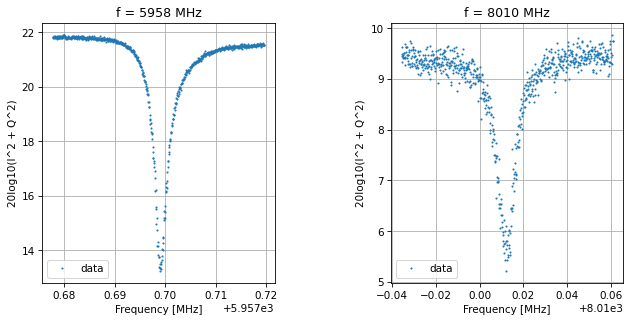

Saving data-2023-09-27-09-33-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.452 s


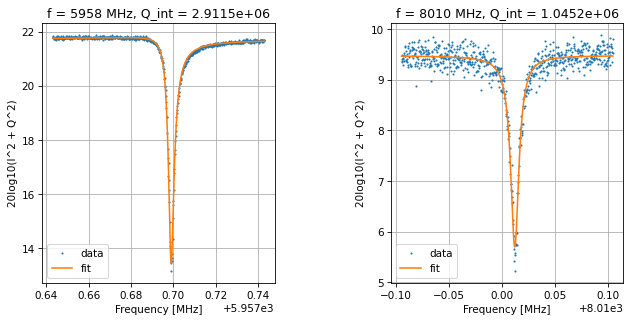

Frequencies out are: [5957.698696618128, 8010.0122145753885] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.556 s


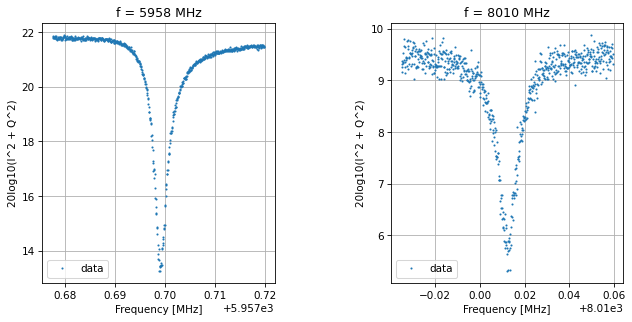

Saving data-2023-09-27-09-33-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.557 s


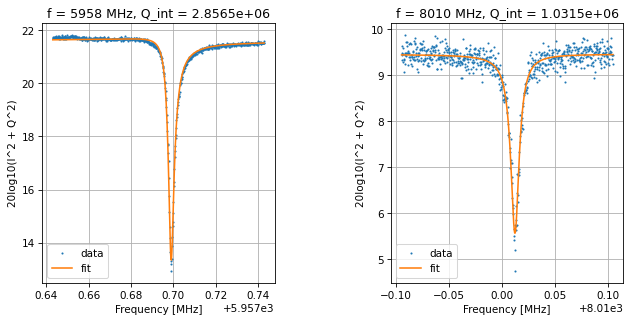

Frequencies out are: [5957.698652563768, 8010.012410865143] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.426 s


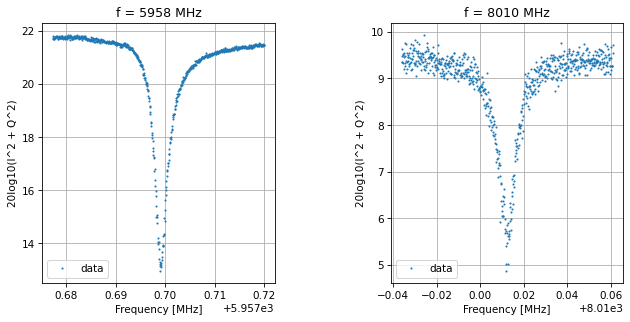

Saving data-2023-09-27-09-34-30
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.564 s


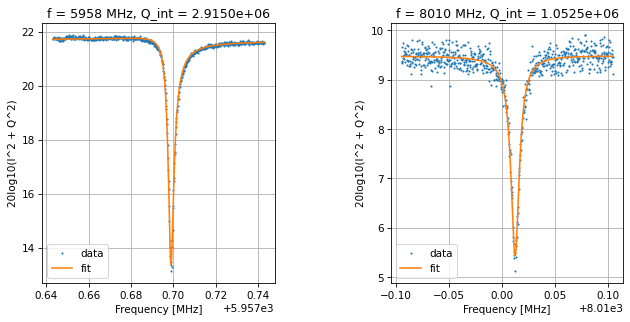

Frequencies out are: [5957.698575900359, 8010.0125493470205] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.584 s


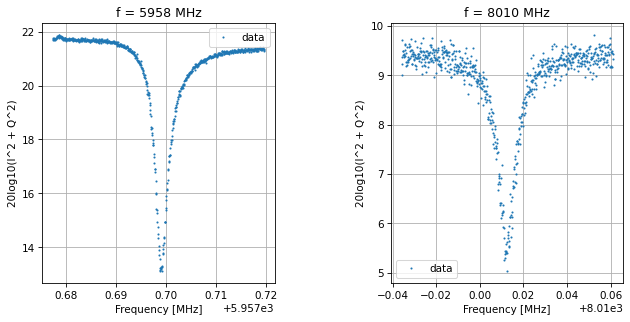

Saving data-2023-09-27-09-35-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.467 s


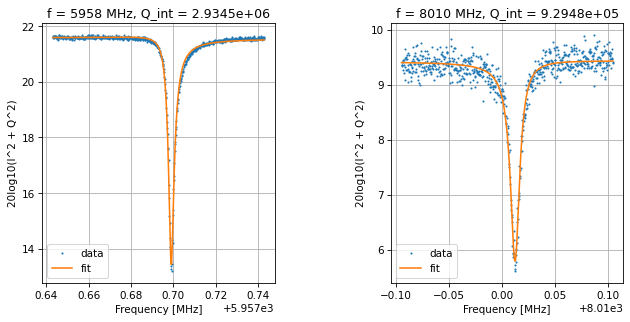

Frequencies out are: [5957.698775592073, 8010.012700459577] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.387 s


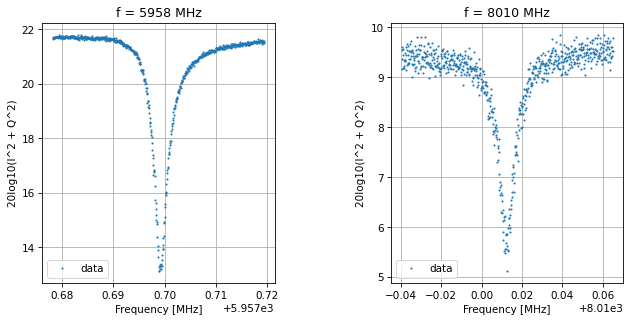

Saving data-2023-09-27-09-35-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.350 s


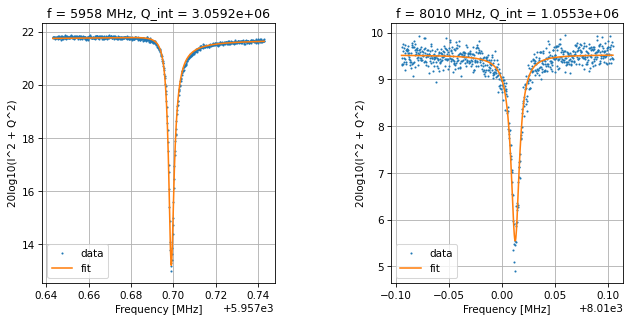

Frequencies out are: [5957.698721273746, 8010.012636619573] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


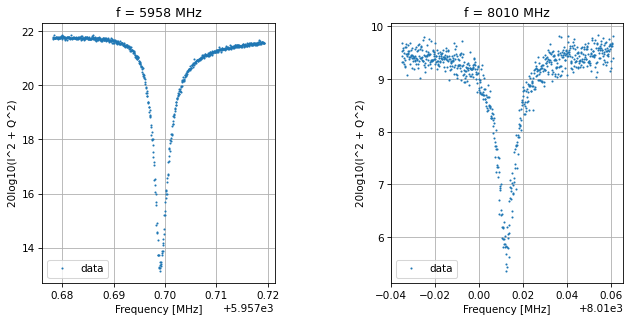

Saving data-2023-09-27-09-36-08
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.511 s


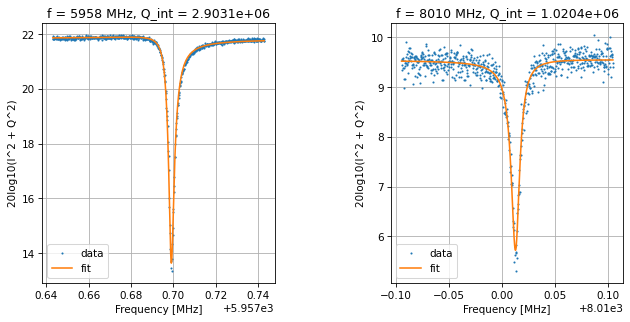

Frequencies out are: [5957.69877622873, 8010.013080290242] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.438 s


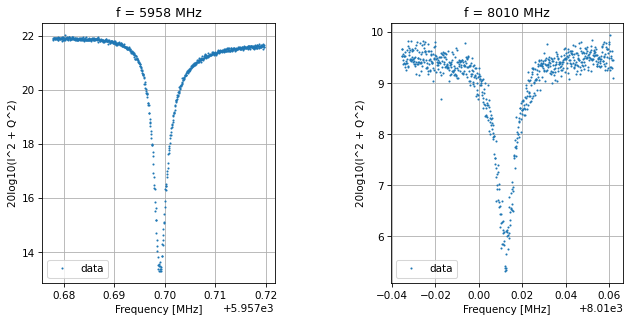

Saving data-2023-09-27-09-36-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.566 s


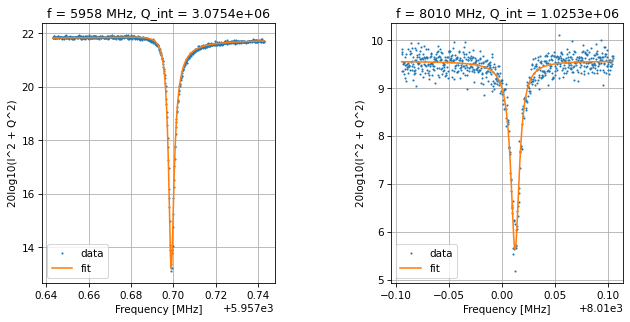

Frequencies out are: [5957.698700871908, 8010.0125069796095] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.503 s


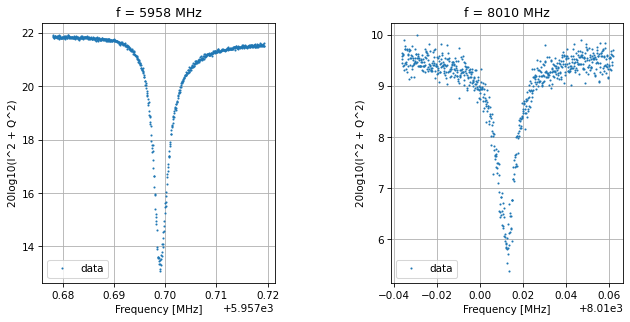

Saving data-2023-09-27-09-37-14
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.456 s


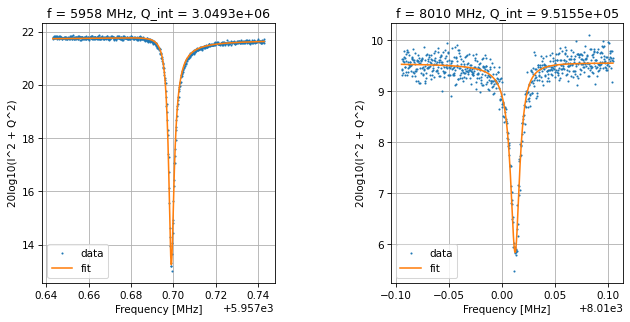

Frequencies out are: [5957.698751755954, 8010.012734304958] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.435 s


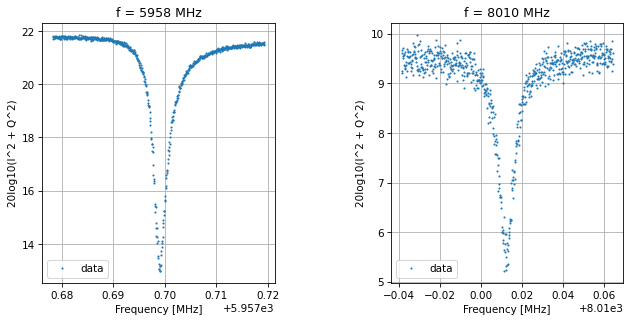

Saving data-2023-09-27-09-37-47
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.498 s


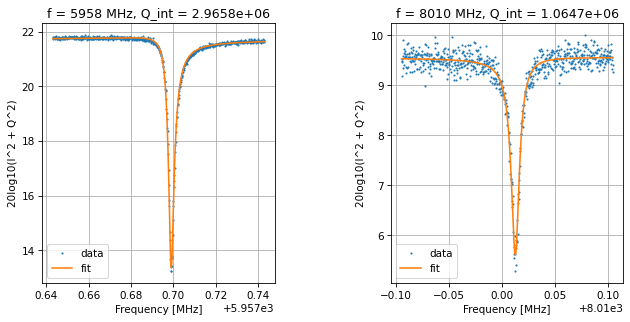

Frequencies out are: [5957.698693818252, 8010.012907167758] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.492 s


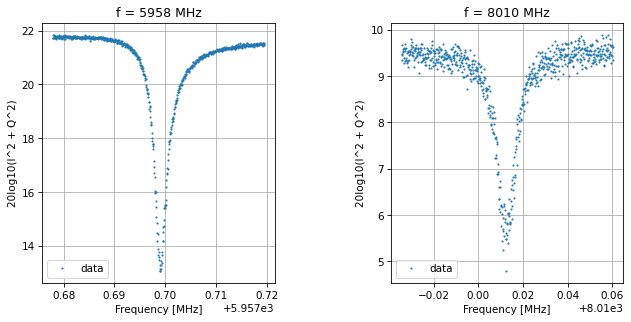

Saving data-2023-09-27-09-38-20
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.408 s


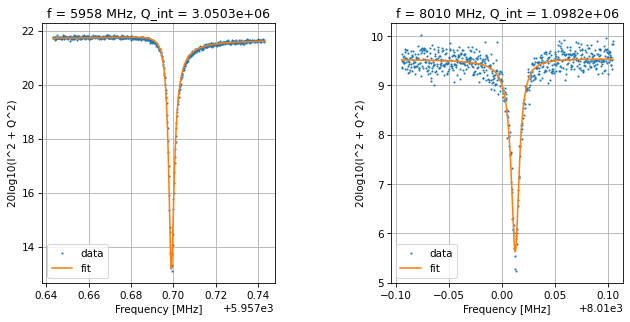

Frequencies out are: [5957.698740716719, 8010.0127542692935] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.450 s


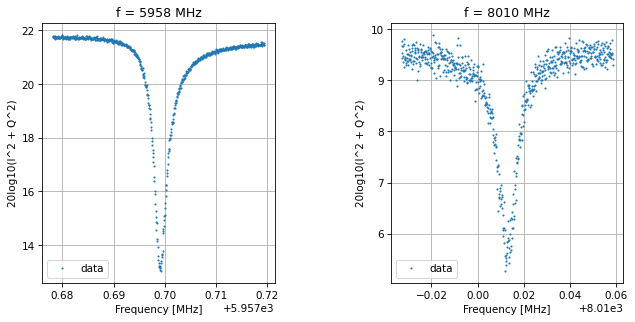

Saving data-2023-09-27-09-38-52
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.490 s


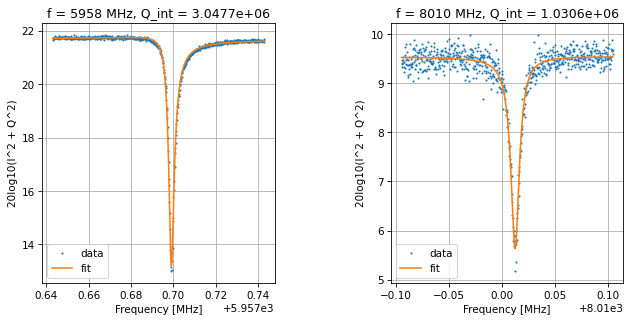

Frequencies out are: [5957.698779162119, 8010.012589980541] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.533 s


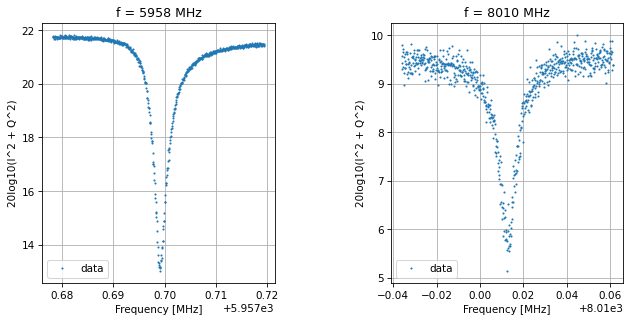

Saving data-2023-09-27-09-39-25
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


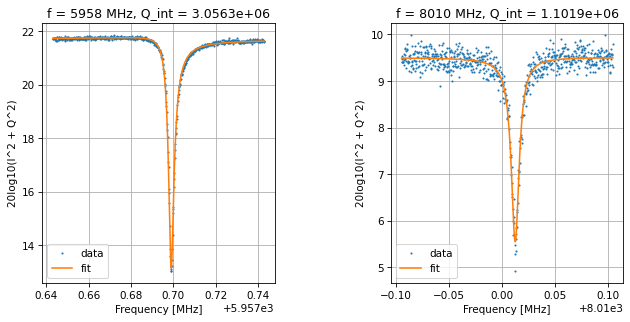

Frequencies out are: [5957.698717402221, 8010.012655624173] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.525 s


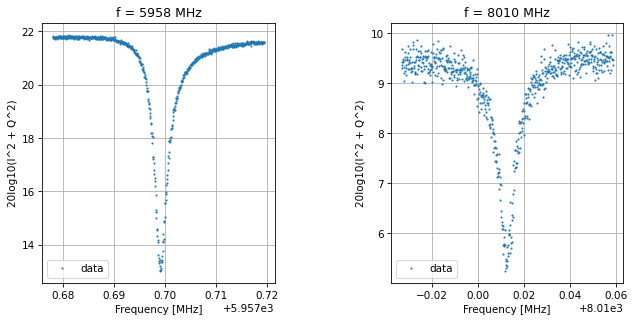

Saving data-2023-09-27-09-39-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.495 s


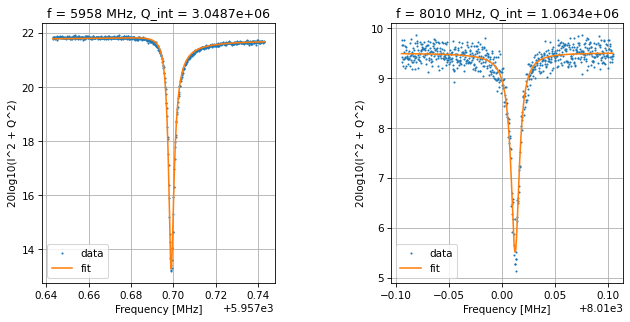

Frequencies out are: [5957.6986848002925, 8010.012596980371] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


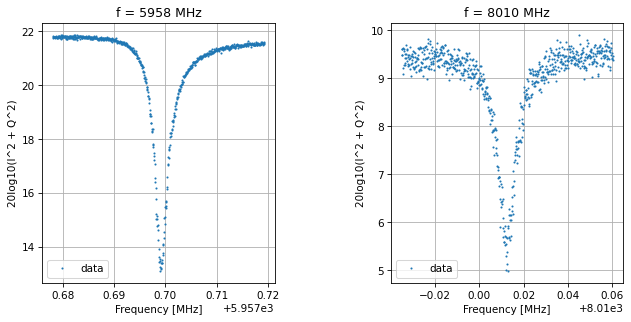

Saving data-2023-09-27-09-40-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.602 s


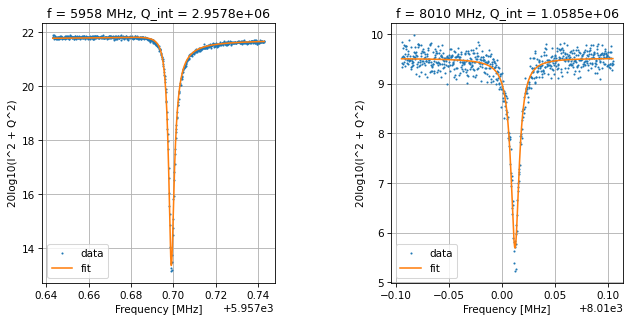

Frequencies out are: [5957.698721907049, 8010.0124455805235] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.316 s


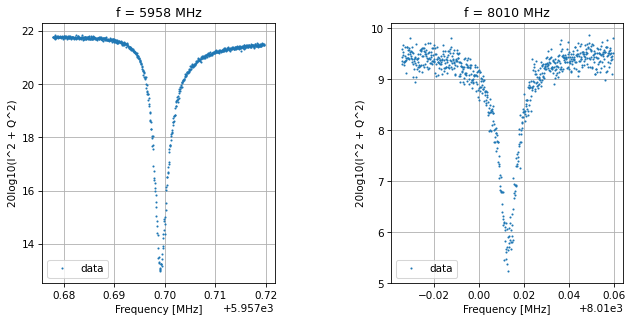

Saving data-2023-09-27-09-41-04
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.496 s


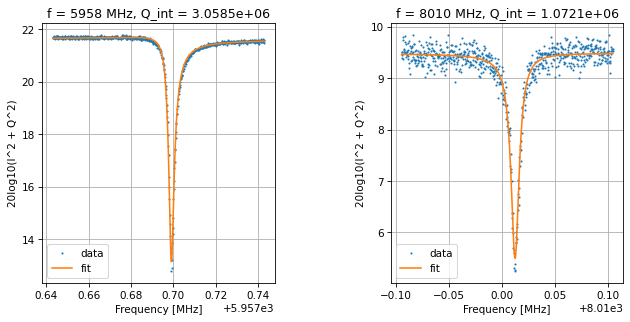

Frequencies out are: [5957.698774625033, 8010.012604358314] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.539 s


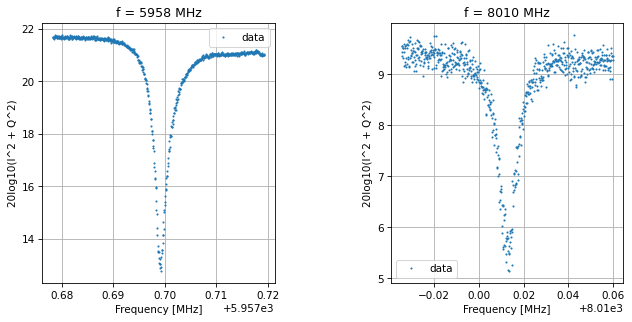

Saving data-2023-09-27-09-41-37
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.406 s


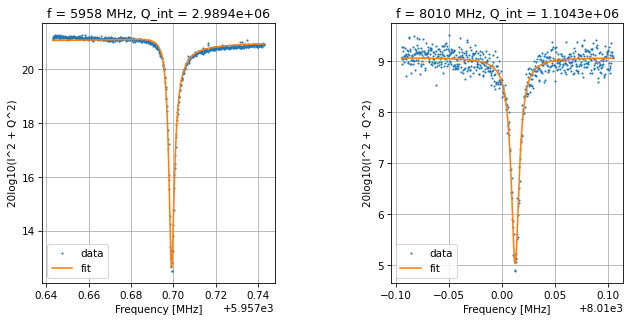

Frequencies out are: [5957.698793667421, 8010.0125411595145] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.570 s


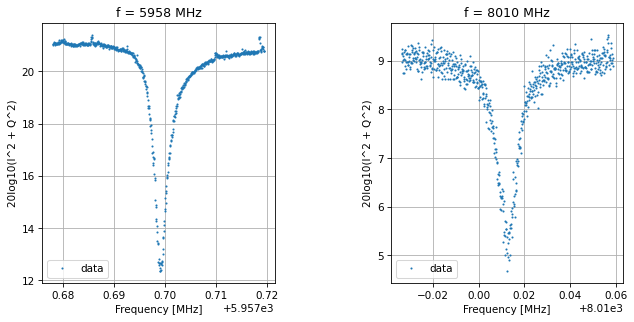

Saving data-2023-09-27-09-42-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.891 s


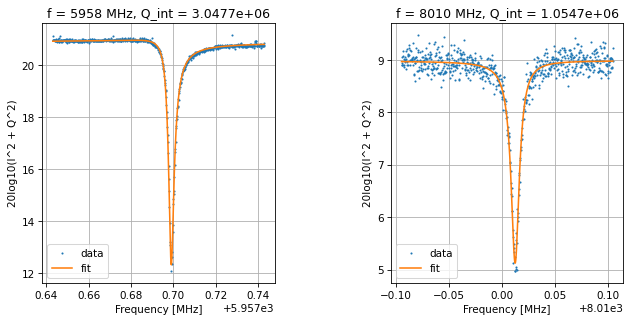

Frequencies out are: [5957.69868980685, 8010.012627570971] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.599 s


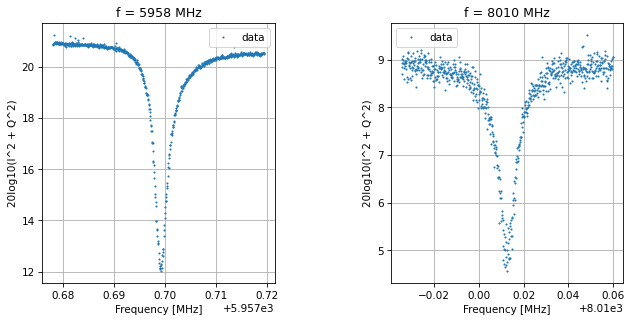

Saving data-2023-09-27-09-42-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.577 s


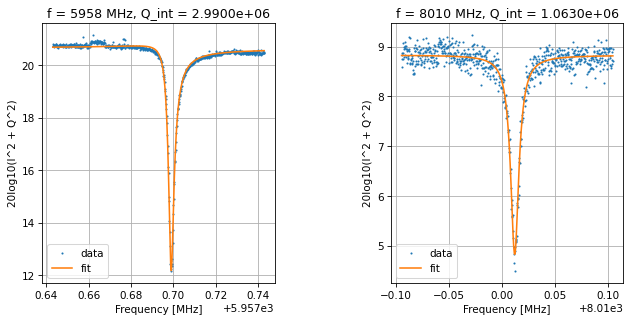

Frequencies out are: [5957.698614688522, 8010.012034278332] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.489 s


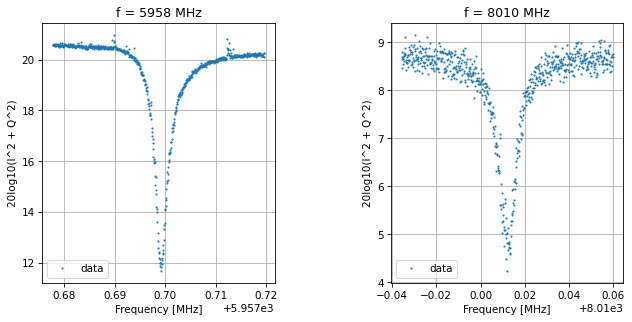

Saving data-2023-09-27-09-43-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.514 s


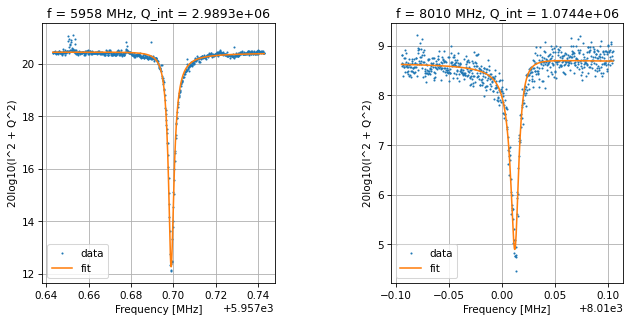

Frequencies out are: [5957.6988373572685, 8010.01283312171] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.371 s


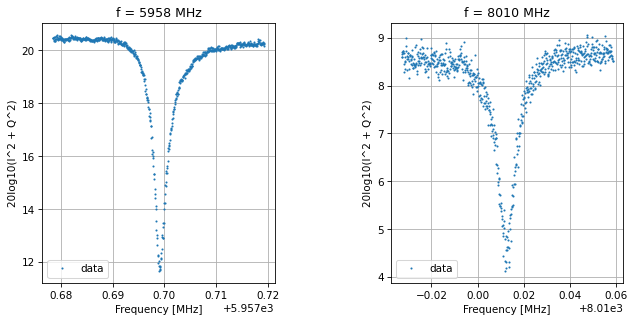

Saving data-2023-09-27-09-43-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.491 s


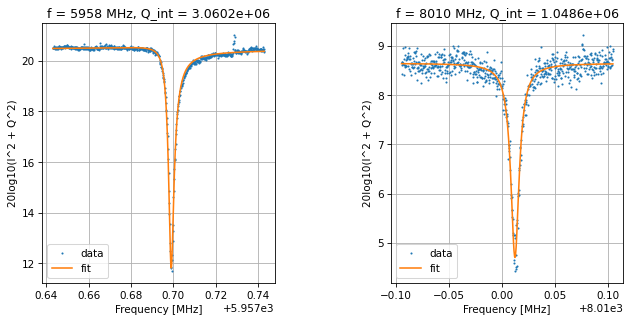

Frequencies out are: [5957.6986908166555, 8010.012305719477] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.538 s


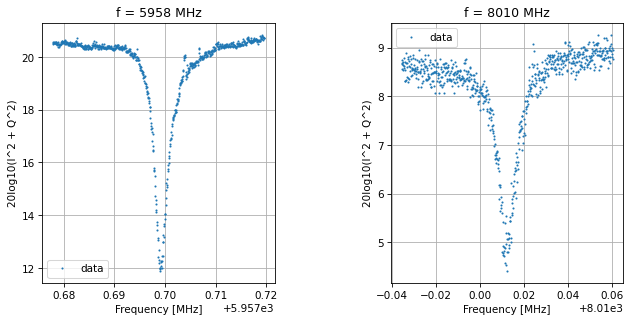

Saving data-2023-09-27-09-44-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


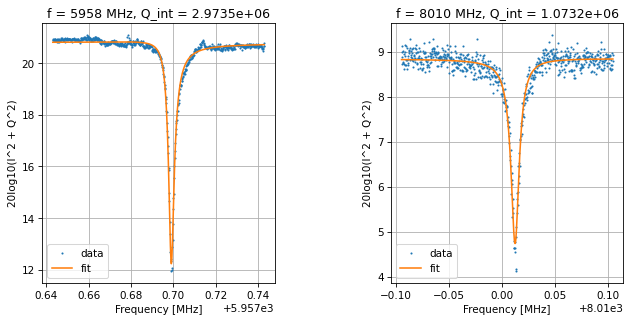

Frequencies out are: [5957.698803662312, 8010.012575934095] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.370 s


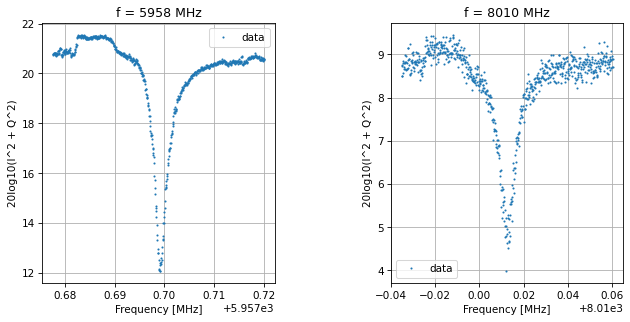

Saving data-2023-09-27-09-44-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


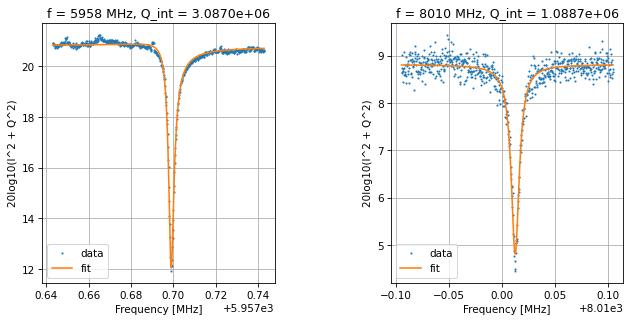

Frequencies out are: [5957.698657738726, 8010.012579962571] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.427 s


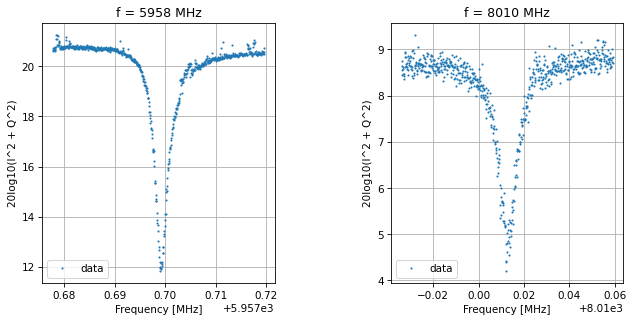

Saving data-2023-09-27-09-45-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.566 s


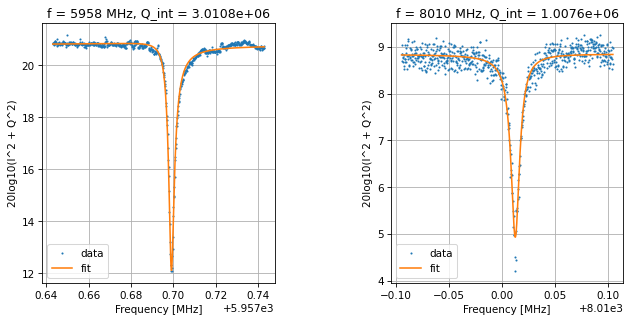

Frequencies out are: [5957.69881995012, 8010.012765879106] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.377 s


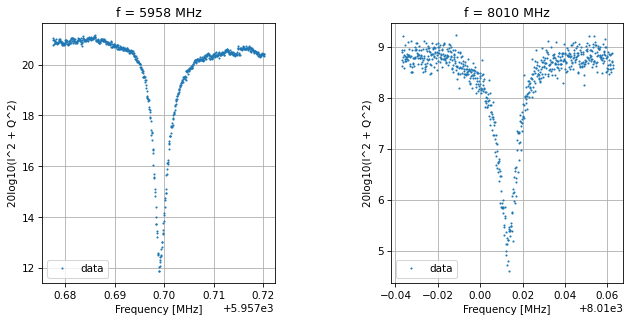

Saving data-2023-09-27-09-46-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.352 s


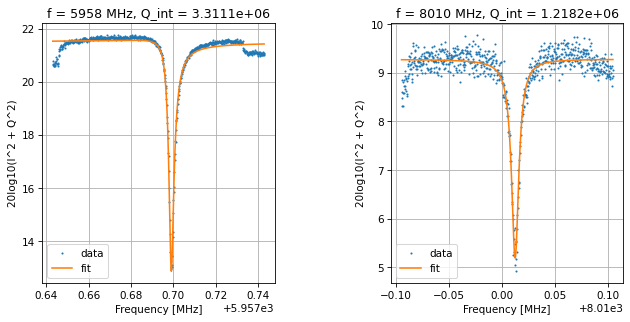

Frequencies out are: [5957.698768455449, 8010.012580014803] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.535 s


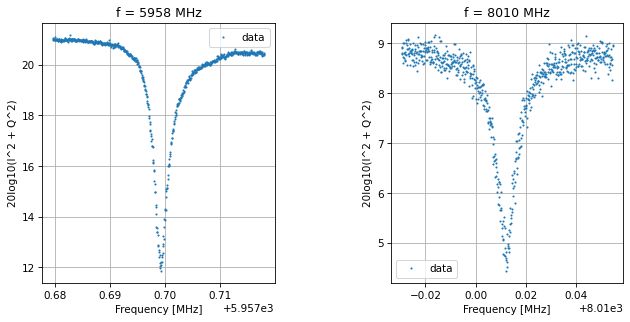

Saving data-2023-09-27-09-46-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


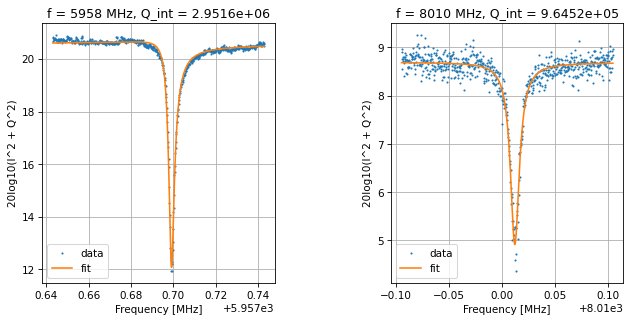

Frequencies out are: [5957.698777771258, 8010.012132601762] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.485 s


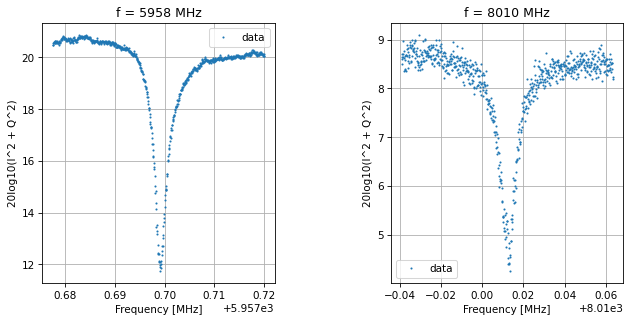

Saving data-2023-09-27-09-47-05
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.390 s


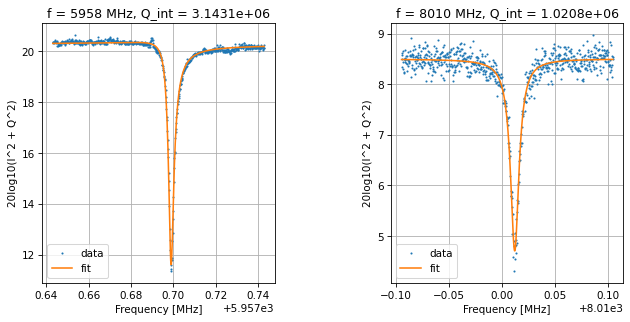

Frequencies out are: [5957.698629653253, 8010.012145286946] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.464 s


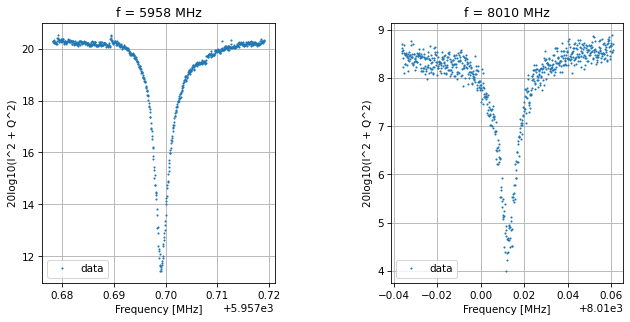

Saving data-2023-09-27-09-47-38
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.517 s


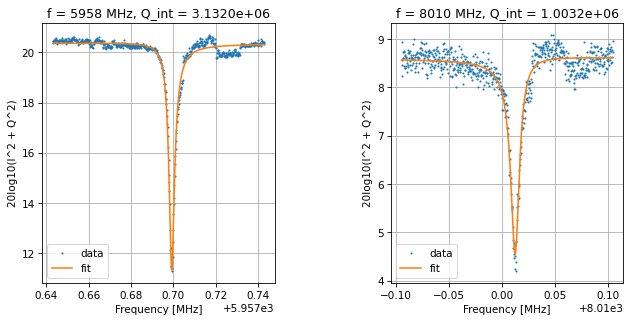

Frequencies out are: [5957.699116517389, 8010.012927978093] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.316 s


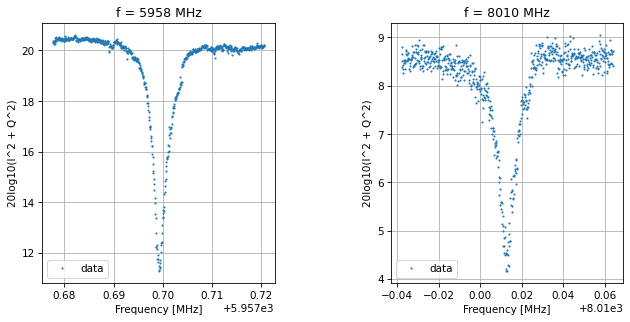

Saving data-2023-09-27-09-48-11
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.481 s


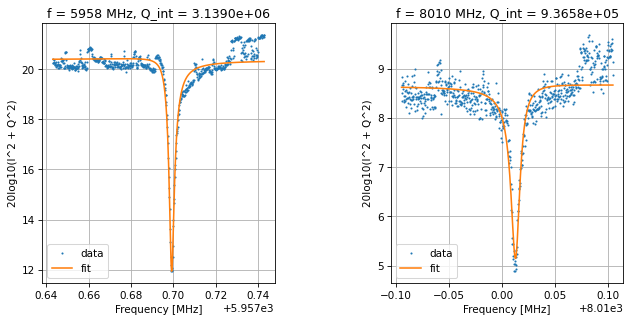

Frequencies out are: [5957.69896662056, 8010.013280371326] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.508 s


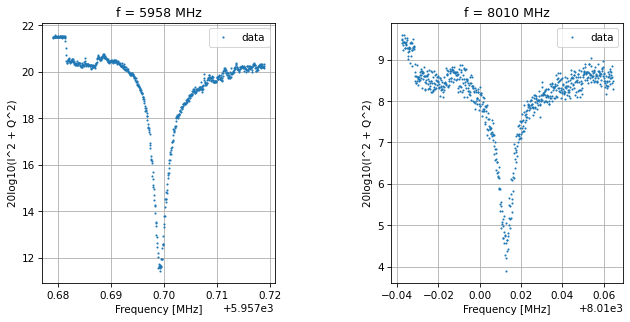

Saving data-2023-09-27-09-48-44
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.335 s


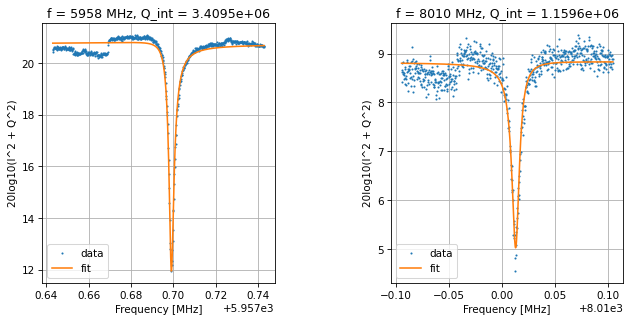

Frequencies out are: [5957.698846178184, 8010.013248578482] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


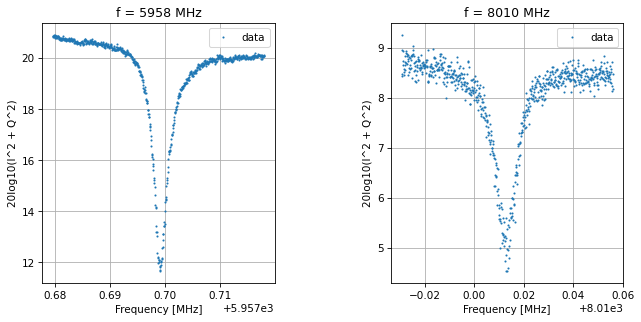

Saving data-2023-09-27-09-49-17
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.399 s


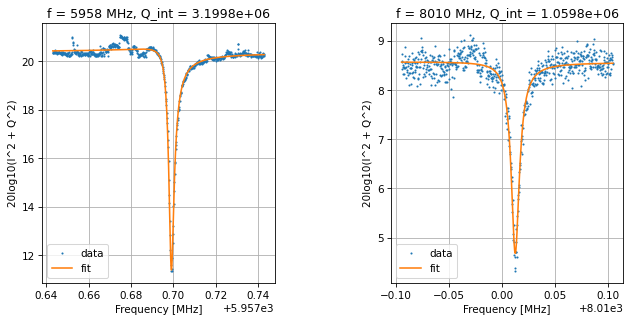

Frequencies out are: [5957.698651275142, 8010.012415476276] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.526 s


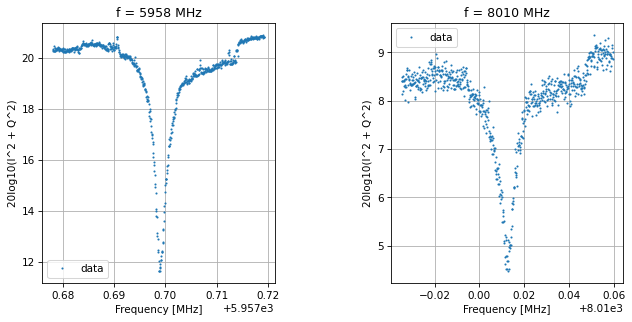

Saving data-2023-09-27-09-49-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.530 s


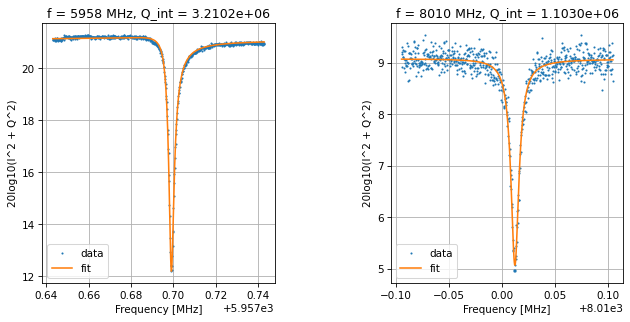

Frequencies out are: [5957.698739353392, 8010.0121700194795] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.471 s


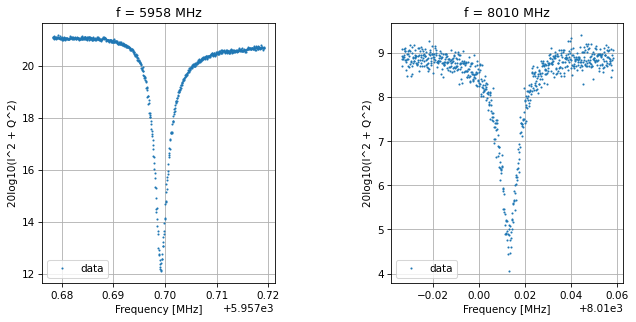

Saving data-2023-09-27-09-50-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.439 s


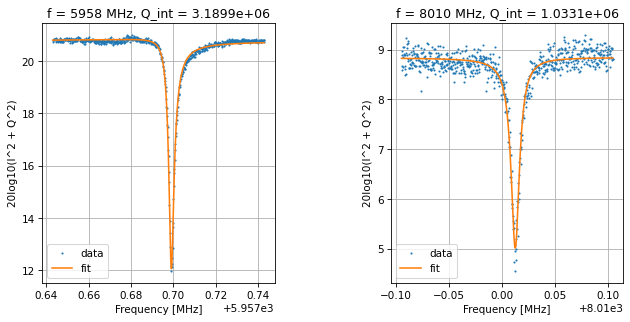

Frequencies out are: [5957.69881156109, 8010.012714883567] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.388 s


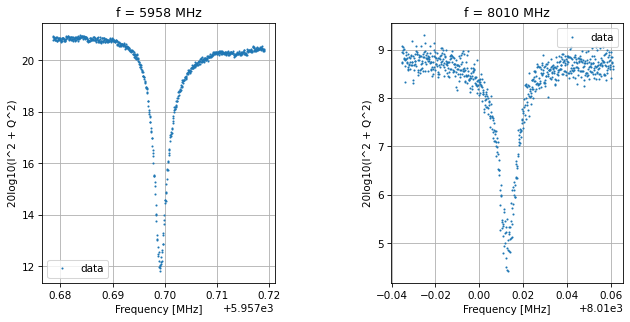

Saving data-2023-09-27-09-50-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.494 s


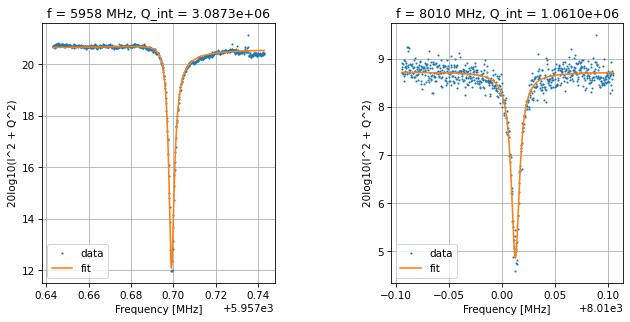

Frequencies out are: [5957.698793828381, 8010.012704326079] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.475 s


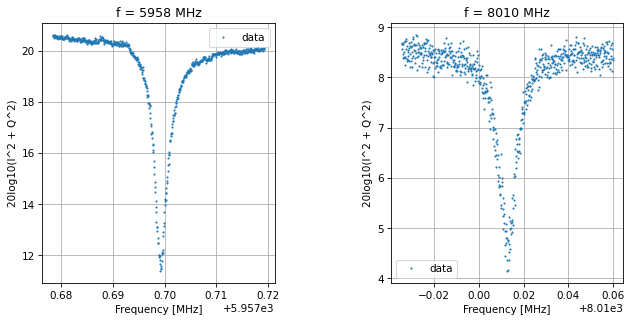

Saving data-2023-09-27-09-51-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.495 s


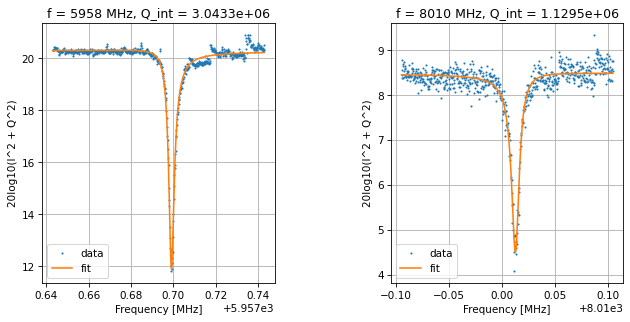

Frequencies out are: [5957.698891578402, 8010.013098720531] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.462 s


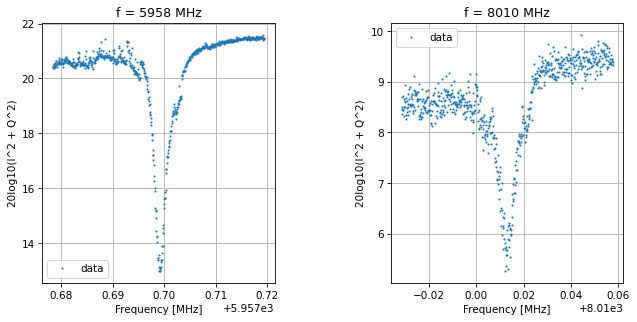

Saving data-2023-09-27-09-52-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.393 s


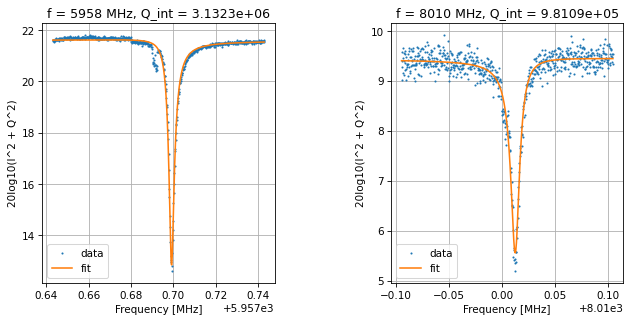

Frequencies out are: [5957.698960934298, 8010.012997255438] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.499 s


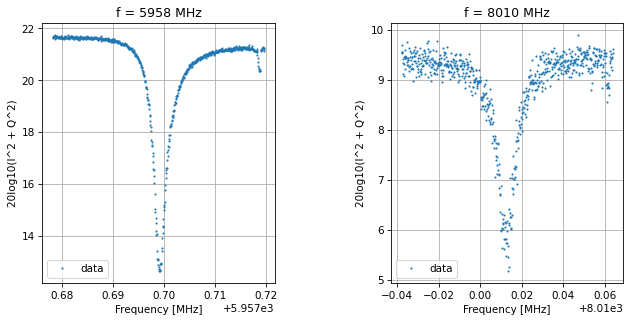

Saving data-2023-09-27-09-52-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.383 s


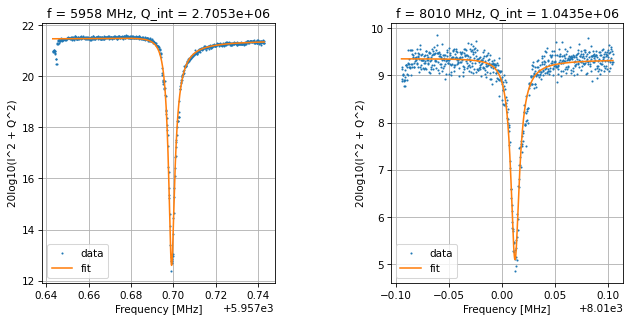

Frequencies out are: [5957.698817027647, 8010.012074589327] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


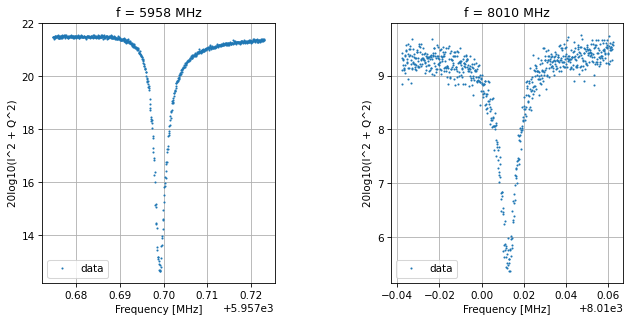

Saving data-2023-09-27-09-53-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.572 s


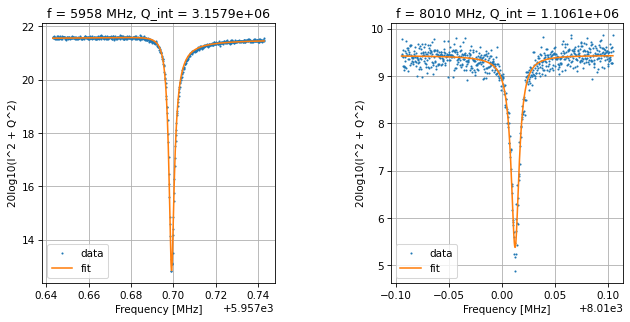

Frequencies out are: [5957.698873384618, 8010.012539928783] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


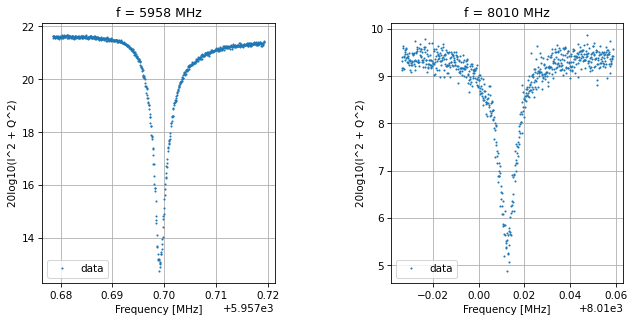

Saving data-2023-09-27-09-53-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.437 s


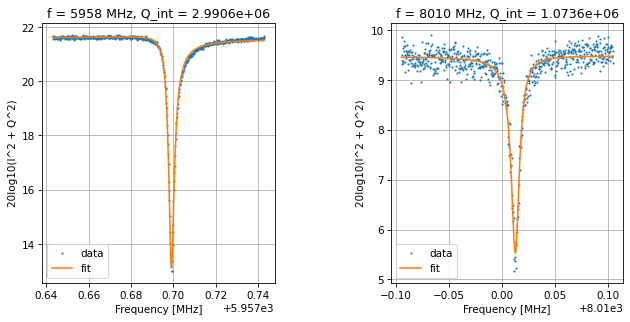

Frequencies out are: [5957.698808909845, 8010.012859412802] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.474 s


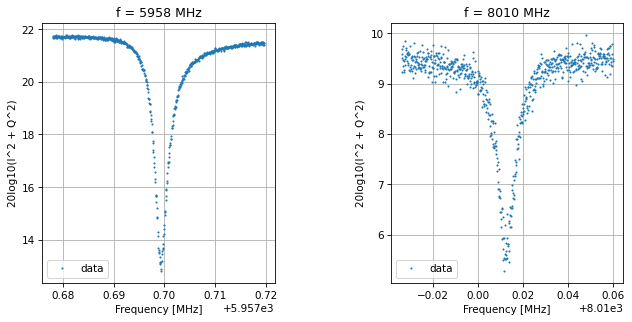

Saving data-2023-09-27-09-54-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.386 s


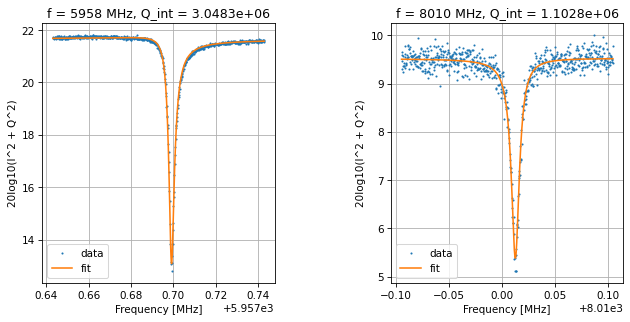

Frequencies out are: [5957.698855141911, 8010.012816528788] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.270 s


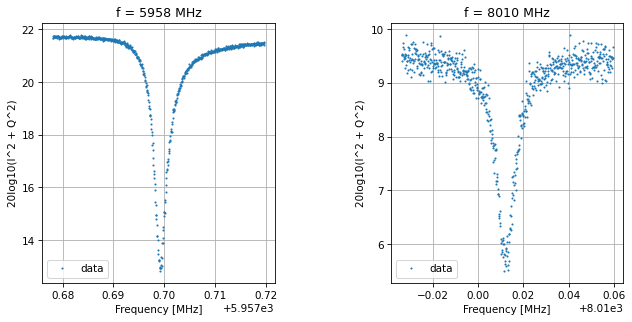

Saving data-2023-09-27-09-54-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.307 s


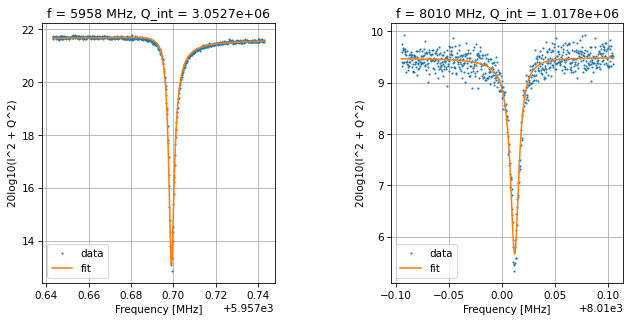

Frequencies out are: [5957.698788188636, 8010.012239304537] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.348 s


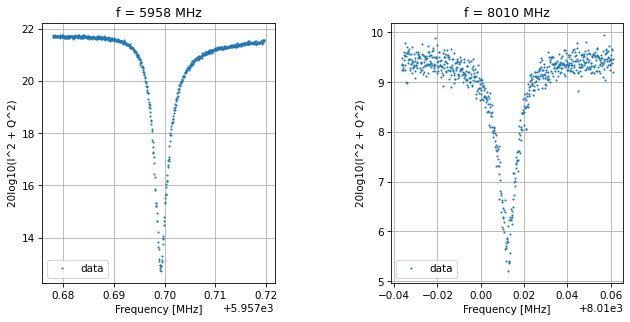

Saving data-2023-09-27-09-55-17
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.390 s


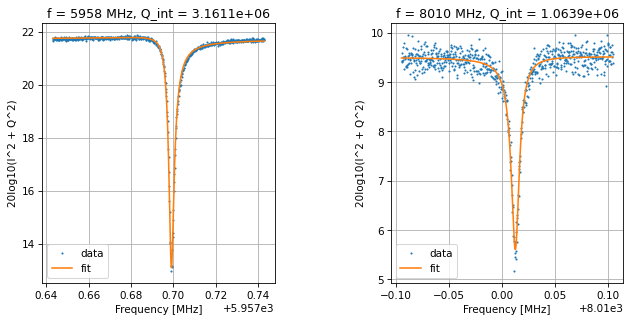

Frequencies out are: [5957.69881045816, 8010.01288778022] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.398 s


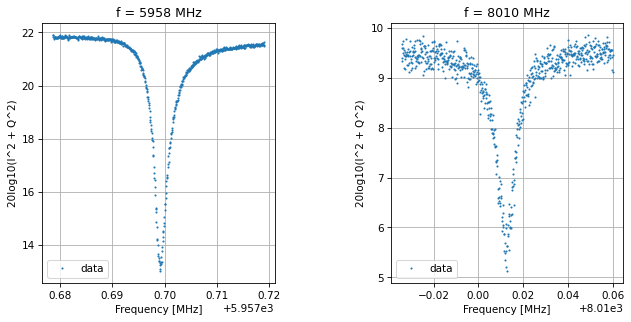

Saving data-2023-09-27-09-55-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.611 s


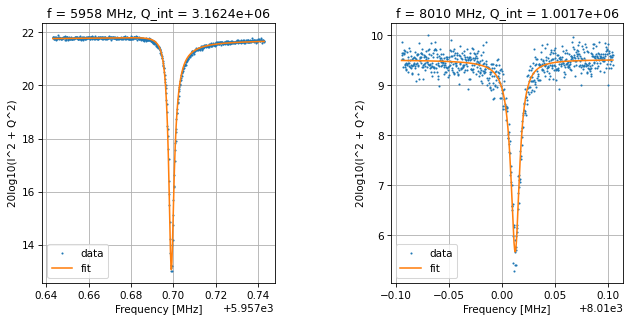

Frequencies out are: [5957.698747001197, 8010.012668943793] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.464 s


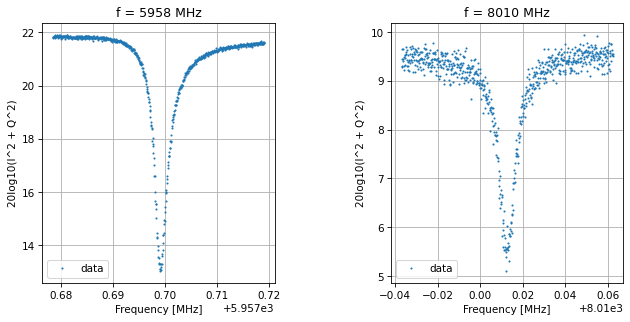

Saving data-2023-09-27-09-56-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


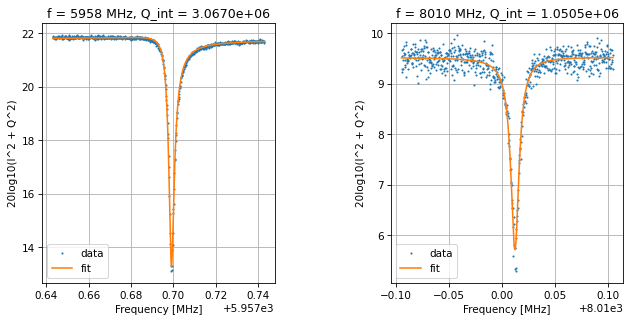

Frequencies out are: [5957.698799676646, 8010.012400878935] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


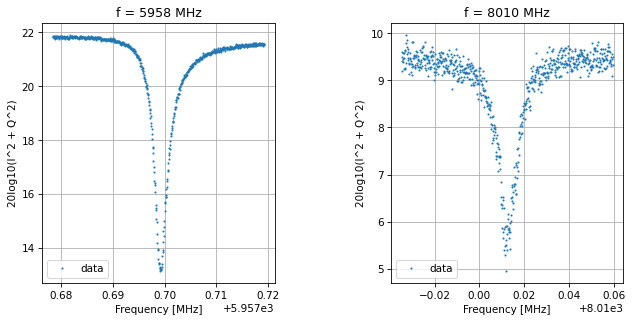

Saving data-2023-09-27-09-56-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.496 s


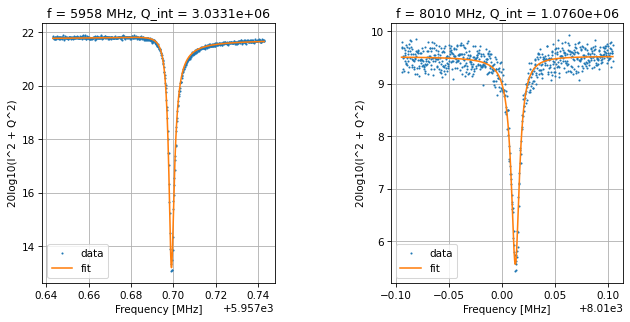

Frequencies out are: [5957.698782912216, 8010.012816415015] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.520 s


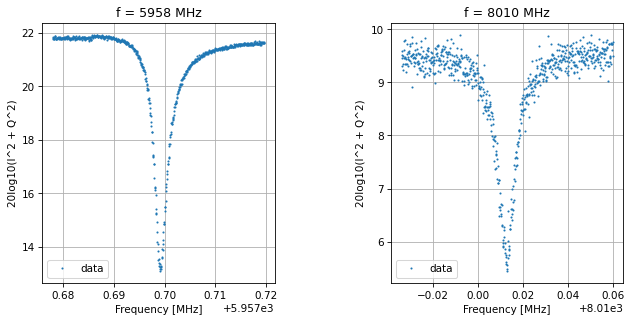

Saving data-2023-09-27-09-57-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.487 s


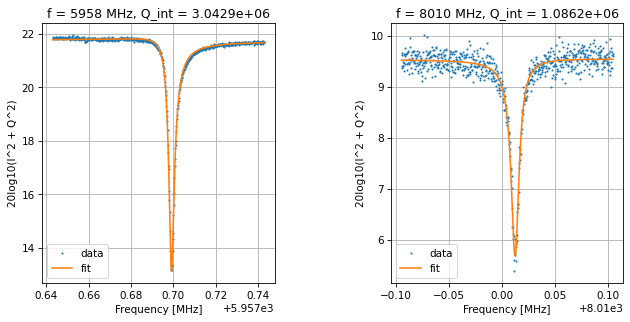

Frequencies out are: [5957.698819675052, 8010.01263740732] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


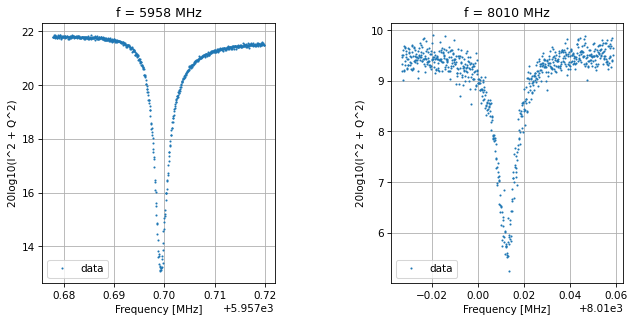

Saving data-2023-09-27-09-58-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


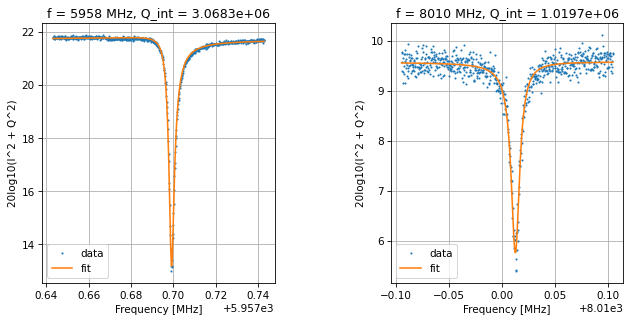

Frequencies out are: [5957.6988783370125, 8010.012893142025] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.450 s


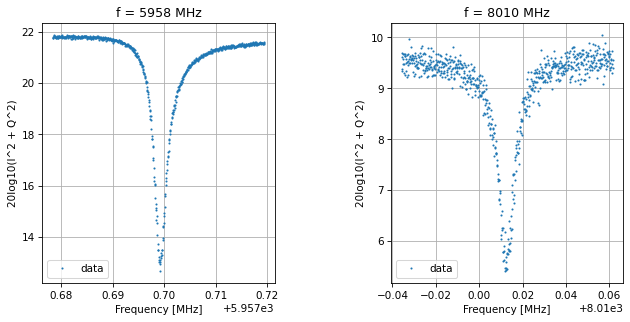

Saving data-2023-09-27-09-58-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.488 s


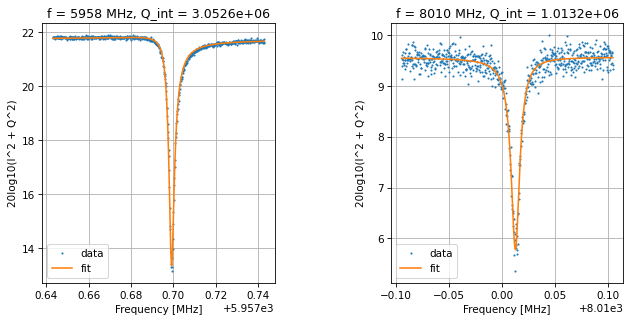

Frequencies out are: [5957.6988763835225, 8010.012887662577] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.289 s


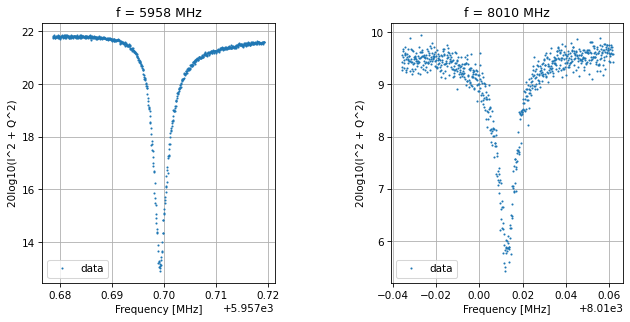

Saving data-2023-09-27-09-59-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.366 s


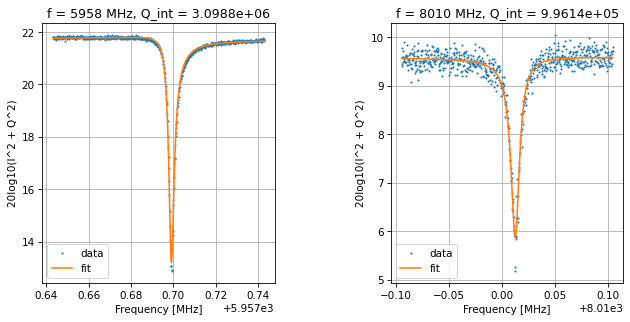

Frequencies out are: [5957.698789729274, 8010.012772880052] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.486 s


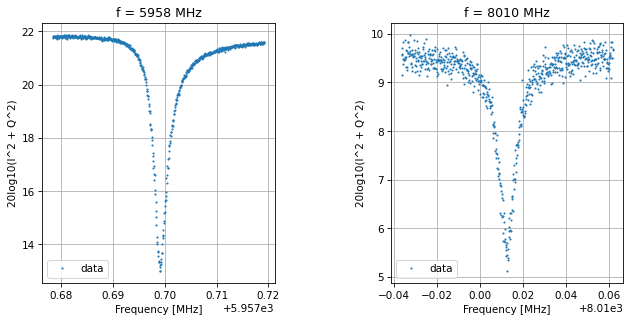

Saving data-2023-09-27-09-59-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.563 s


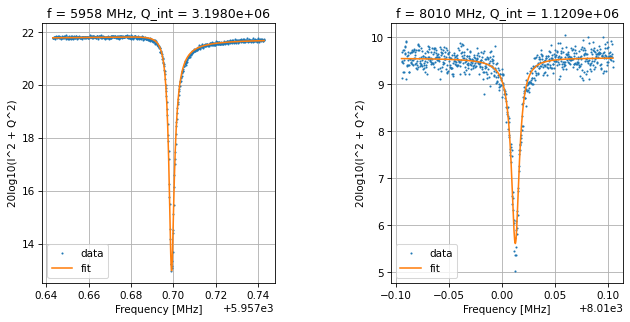

Frequencies out are: [5957.698865157865, 8010.012767162864] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.550 s


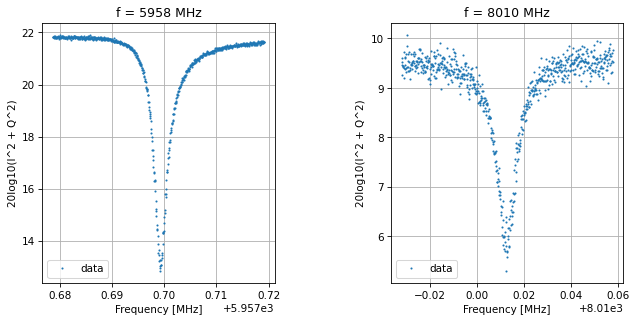

Saving data-2023-09-27-10-00-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.498 s


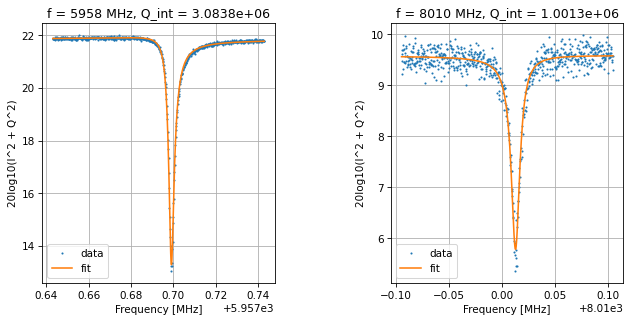

Frequencies out are: [5957.698797887798, 8010.013068118819] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.373 s


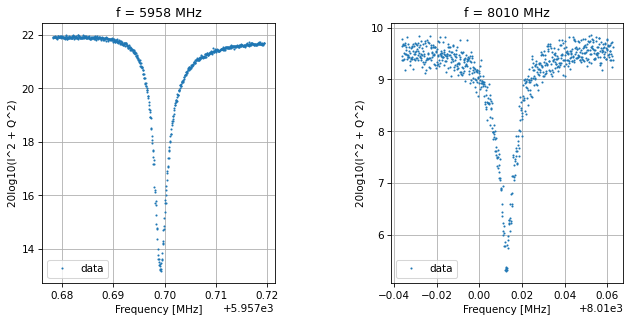

Saving data-2023-09-27-10-00-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.449 s


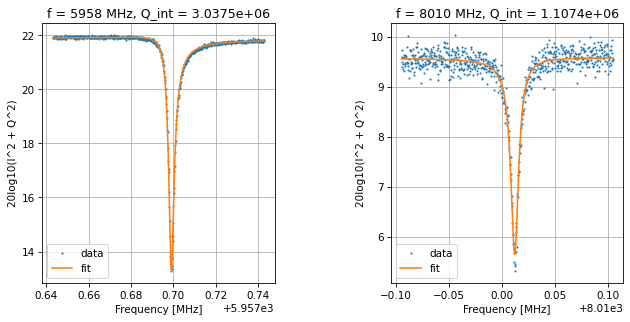

Frequencies out are: [5957.698757480276, 8010.01226764902] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.411 s


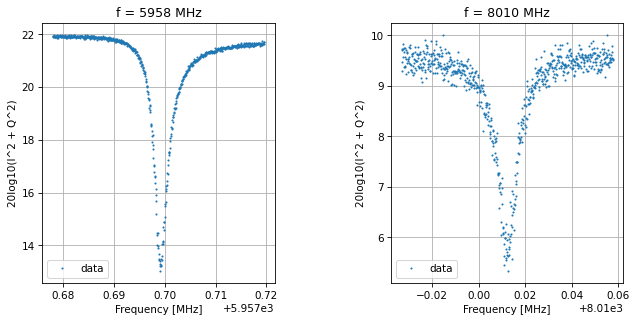

Saving data-2023-09-27-10-01-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


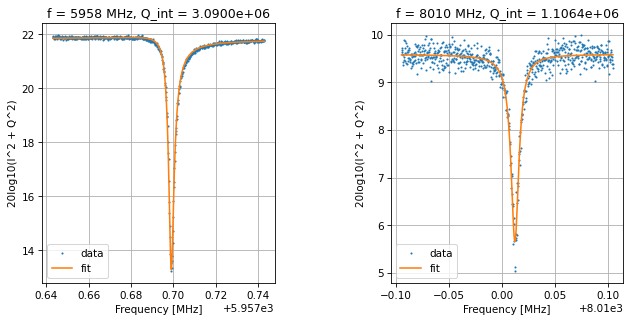

Frequencies out are: [5957.698744075749, 8010.012346503931] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.472 s


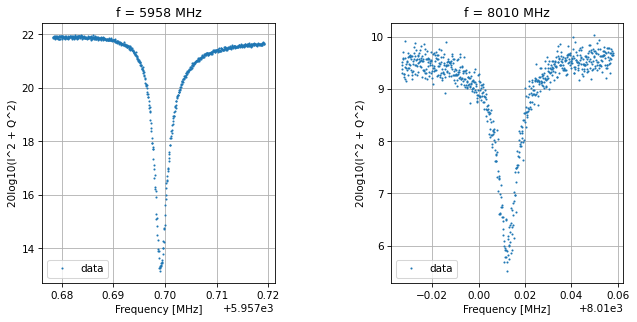

Saving data-2023-09-27-10-01-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


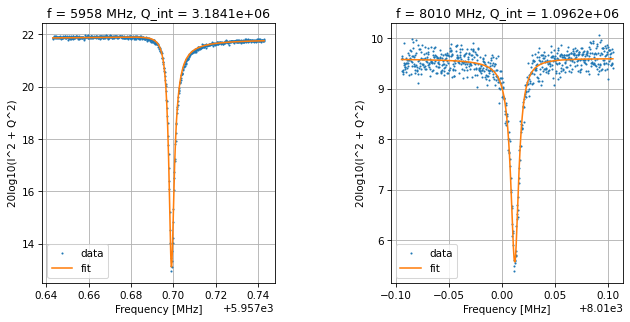

Frequencies out are: [5957.698820339967, 8010.012283022642] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.554 s


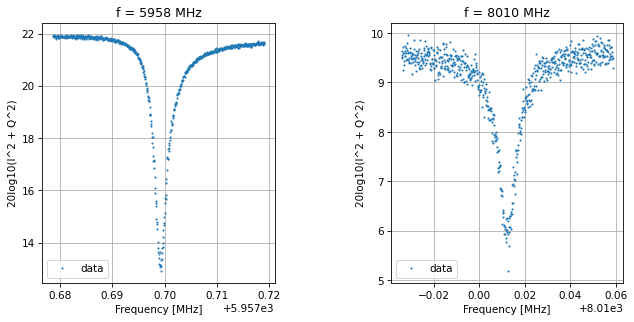

Saving data-2023-09-27-10-02-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.529 s


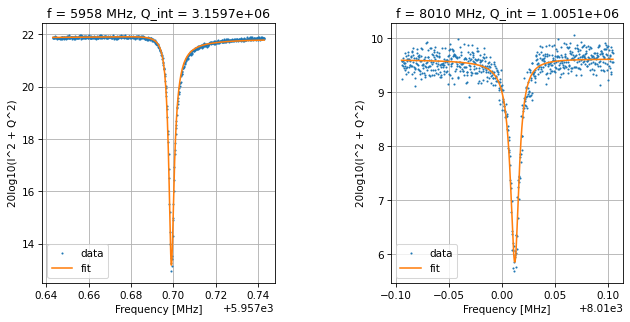

Frequencies out are: [5957.698812852871, 8010.012359389367] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.488 s


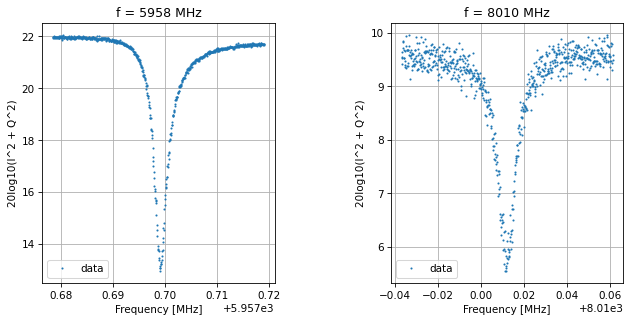

Saving data-2023-09-27-10-02-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.367 s


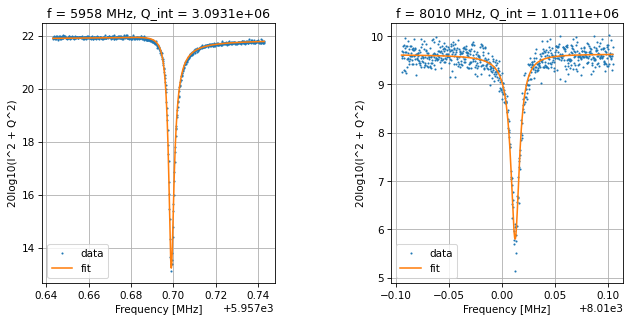

Frequencies out are: [5957.698707148867, 8010.012639928244] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.322 s


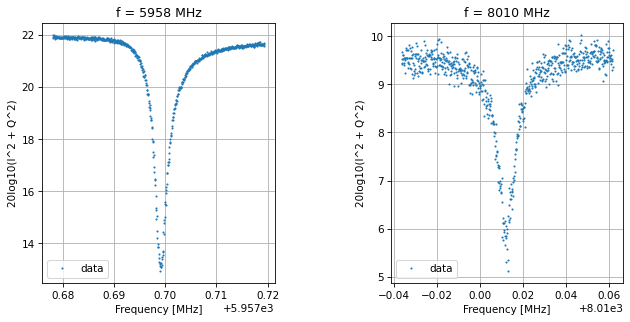

Saving data-2023-09-27-10-03-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.483 s


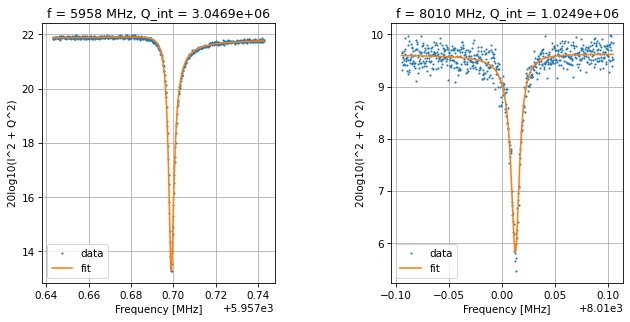

Frequencies out are: [5957.698699350016, 8010.012928109802] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.560 s


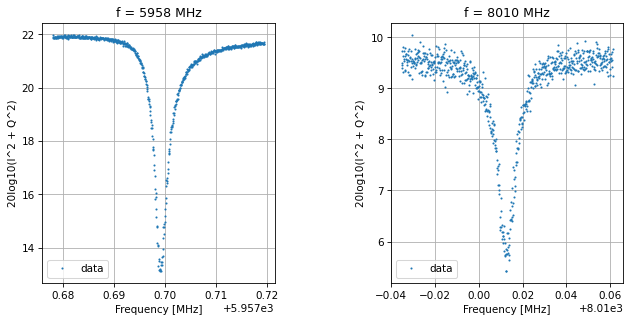

Saving data-2023-09-27-10-04-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.433 s


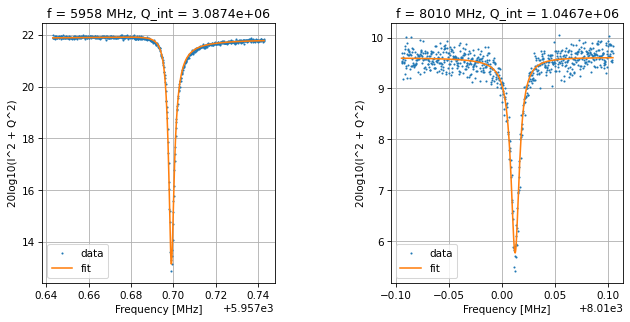

Frequencies out are: [5957.698771427562, 8010.012581451287] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.400 s


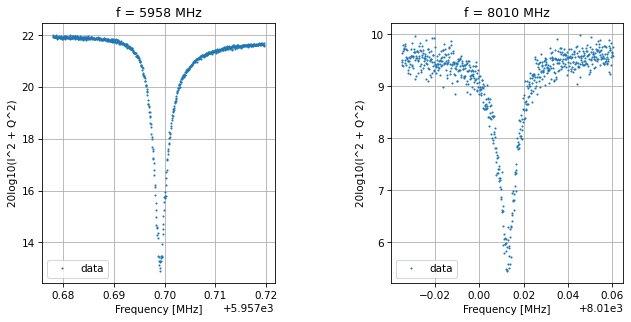

Saving data-2023-09-27-10-04-35
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.449 s


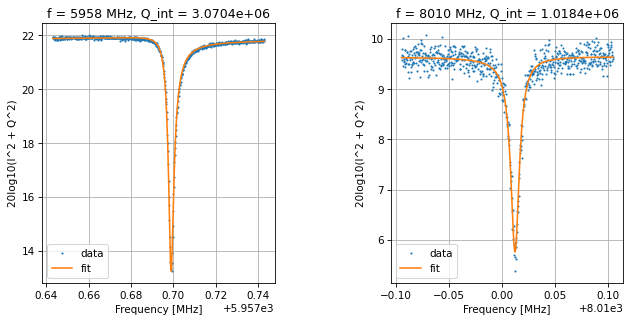

Frequencies out are: [5957.698651776685, 8010.012523910336] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.586 s


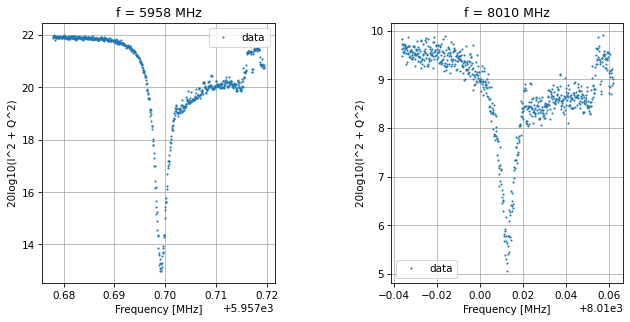

Saving data-2023-09-27-10-05-08
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.478 s


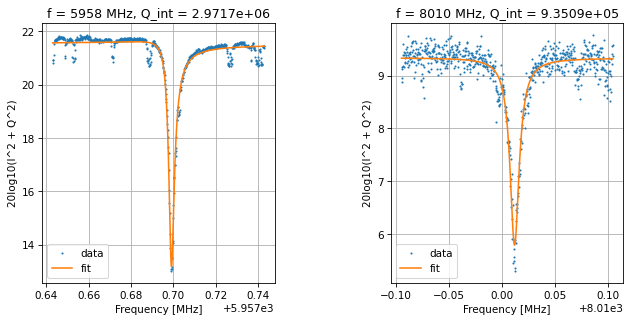

Frequencies out are: [5957.698760276261, 8010.011875975935] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.502 s


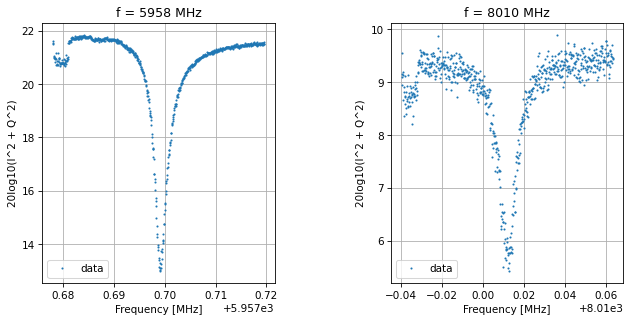

Saving data-2023-09-27-10-05-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


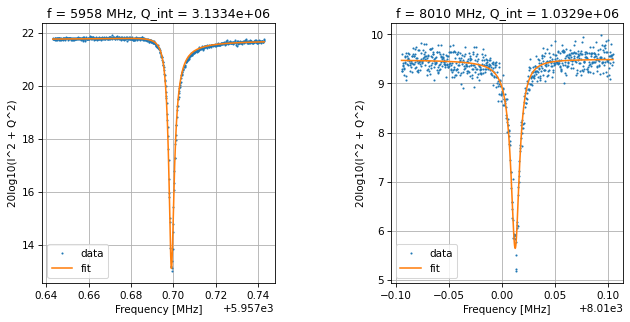

Frequencies out are: [5957.698823458091, 8010.012750457569] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.457 s


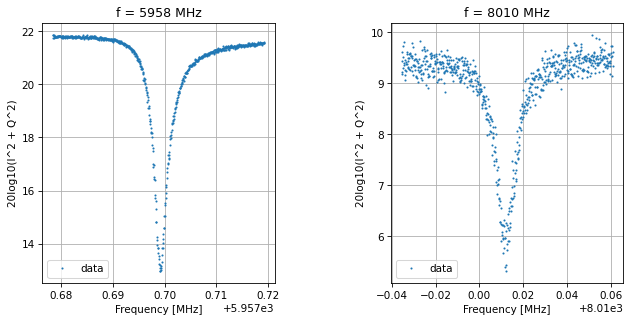

Saving data-2023-09-27-10-06-14
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.478 s


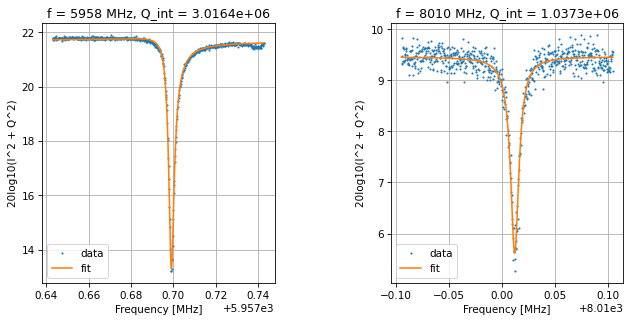

Frequencies out are: [5957.698741494866, 8010.012148173787] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.582 s


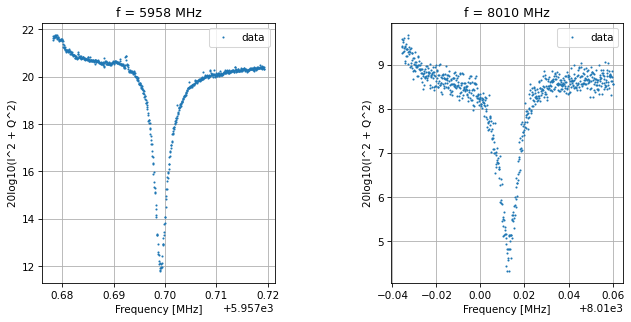

Saving data-2023-09-27-10-06-47
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.531 s


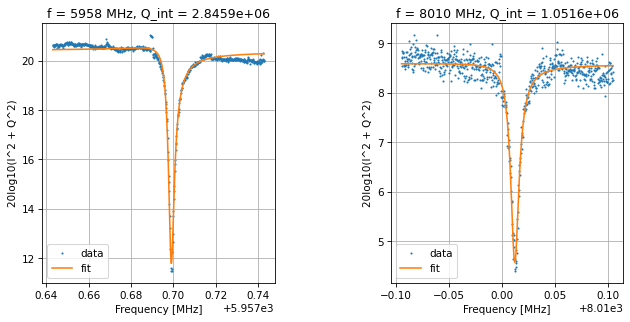

Frequencies out are: [5957.69858053885, 8010.011868285968] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


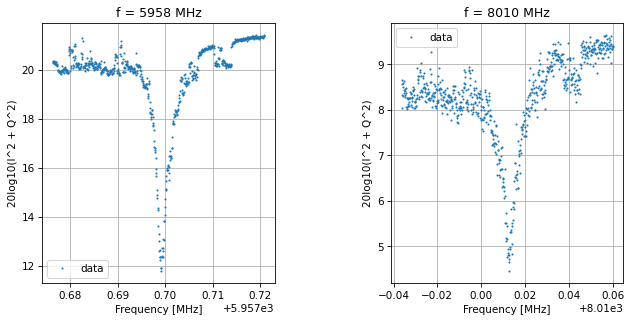

Saving data-2023-09-27-10-07-20
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.542 s


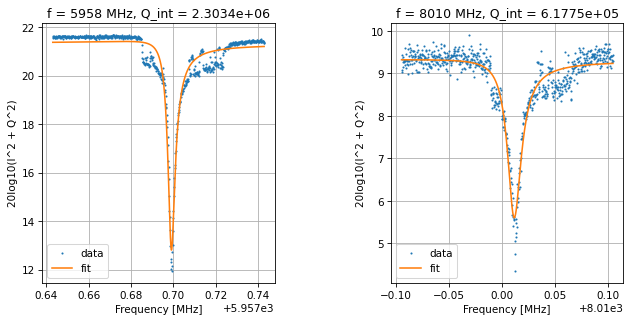

Frequencies out are: [5957.698612452153, 8010.010881070684] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.481 s


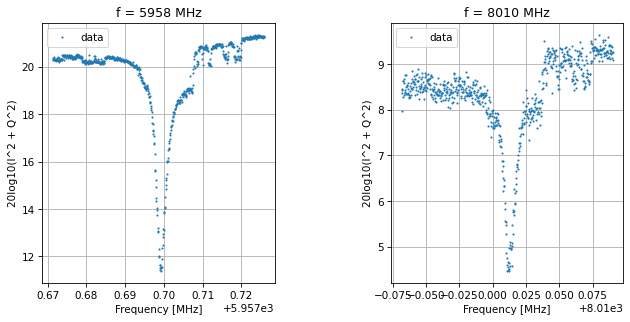

Saving data-2023-09-27-10-07-53
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.586 s


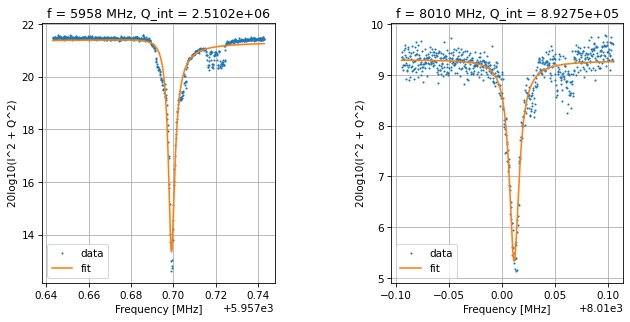

Frequencies out are: [5957.698788728304, 8010.01130404058] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.503 s


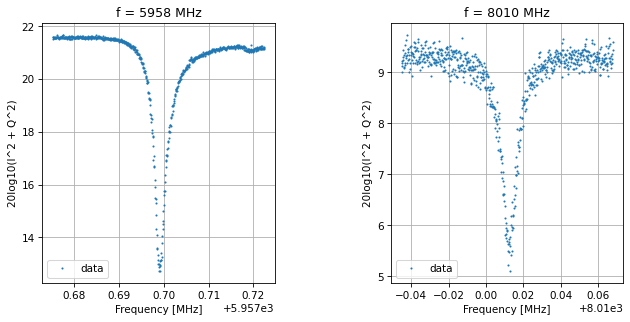

Saving data-2023-09-27-10-08-26
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.417 s


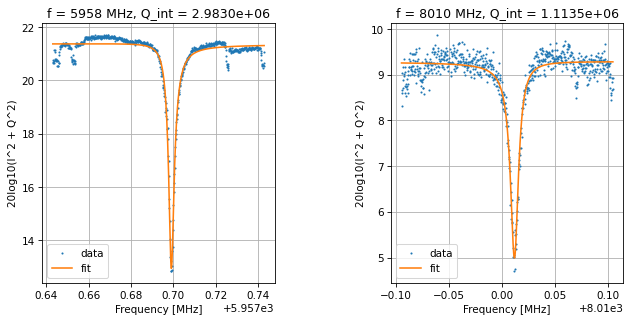

Frequencies out are: [5957.698924883788, 8010.012096642297] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.279 s


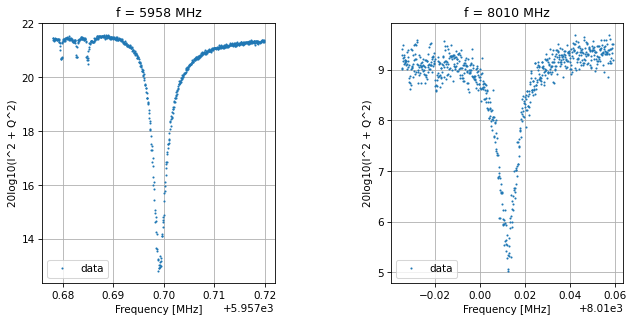

Saving data-2023-09-27-10-08-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.306 s


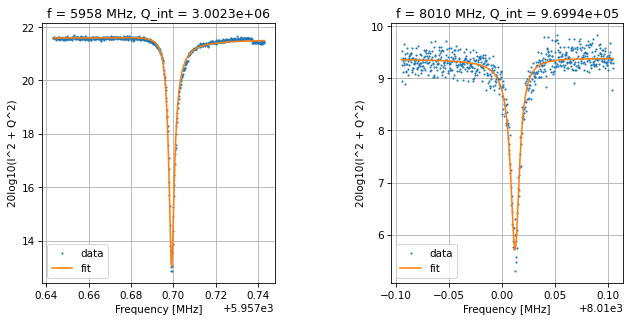

Frequencies out are: [5957.698894903217, 8010.012662054538] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.275 s


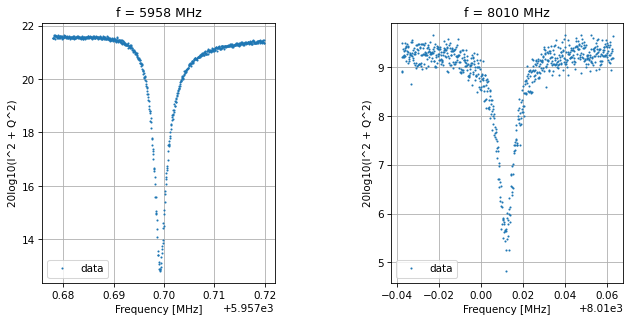

Saving data-2023-09-27-10-09-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.483 s


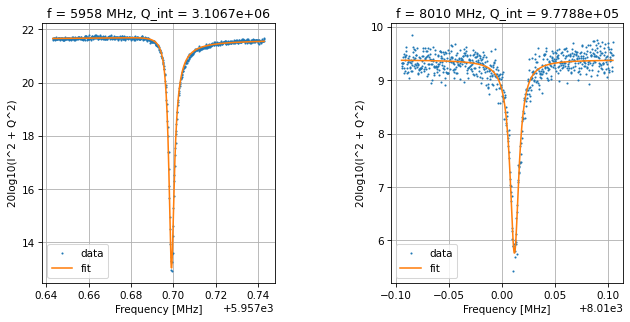

Frequencies out are: [5957.698830520523, 8010.01186783577] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.446 s


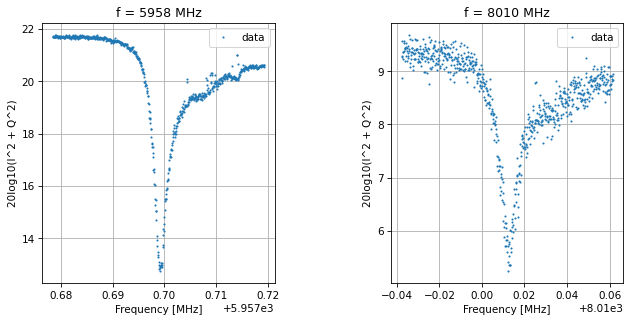

Saving data-2023-09-27-10-10-04
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.414 s


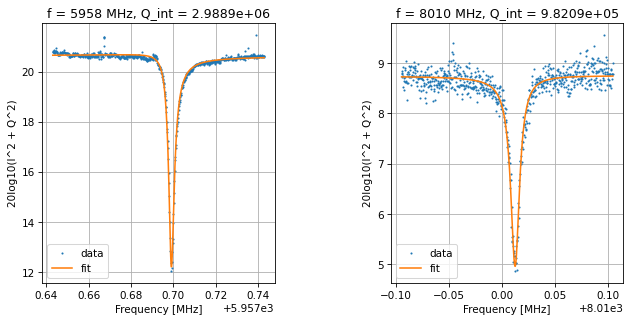

Frequencies out are: [5957.698832180488, 8010.012648672361] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


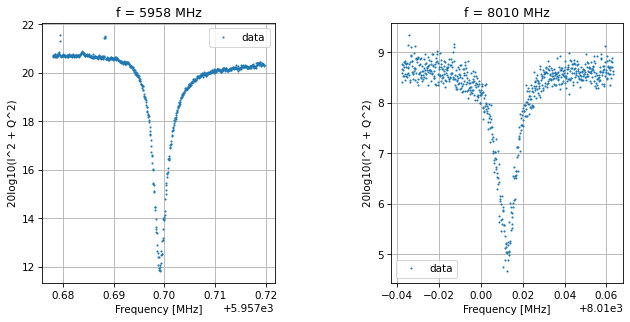

Saving data-2023-09-27-10-10-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.463 s


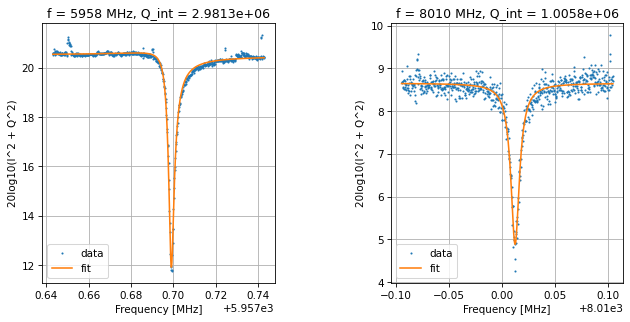

Frequencies out are: [5957.698673525957, 8010.012444302318] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


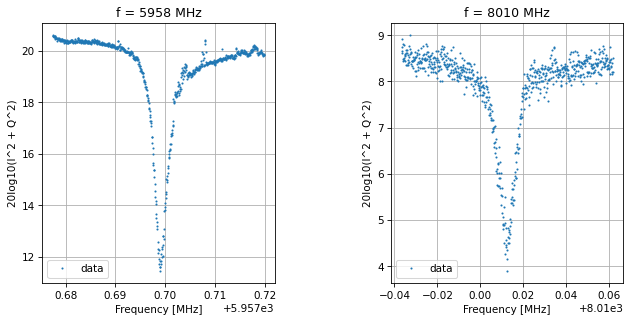

Saving data-2023-09-27-10-11-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.455 s


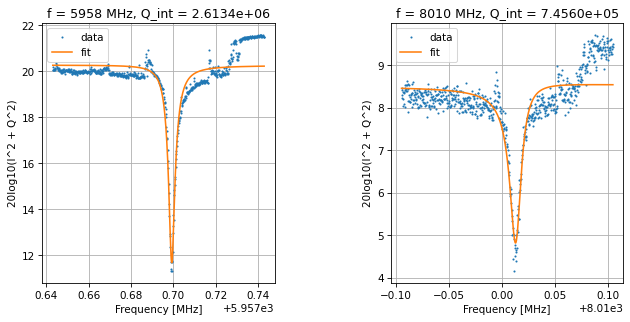

Frequencies out are: [5957.6991797213, 8010.013776098191] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.883 s


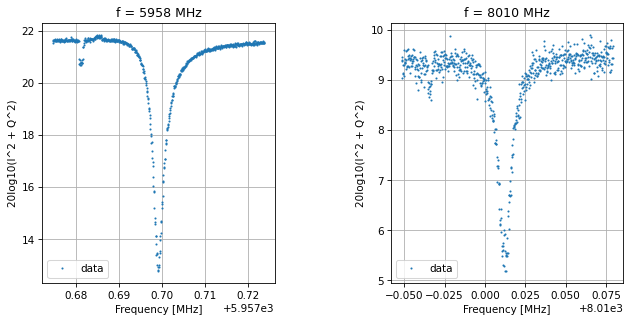

Saving data-2023-09-27-10-11-42
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.574 s


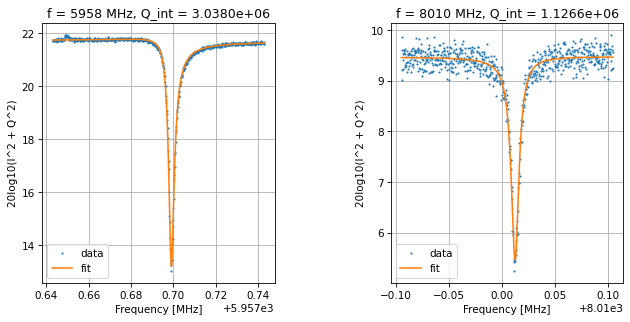

Frequencies out are: [5957.698754365513, 8010.0125495277825] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.425 s


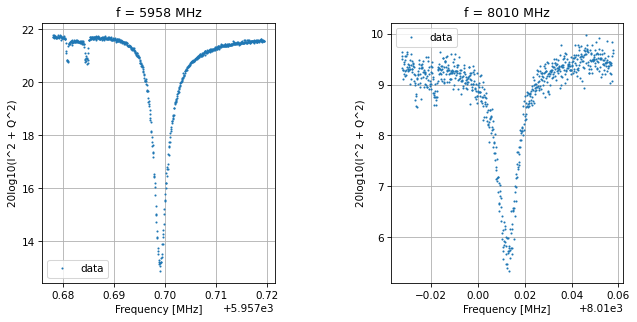

Saving data-2023-09-27-10-12-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.514 s


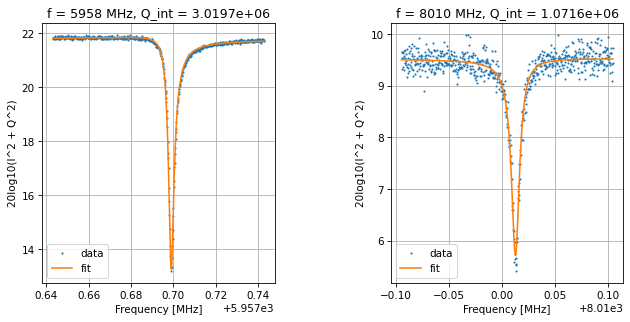

Frequencies out are: [5957.69870715288, 8010.013006906234] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.491 s


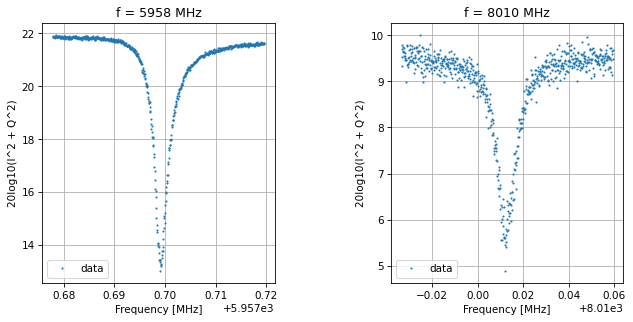

Saving data-2023-09-27-10-12-48
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.382 s


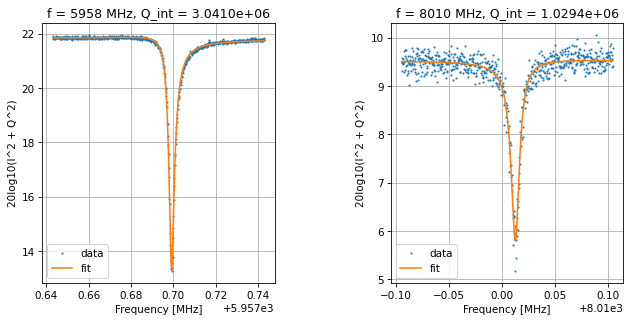

Frequencies out are: [5957.698891447591, 8010.01287864621] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.444 s


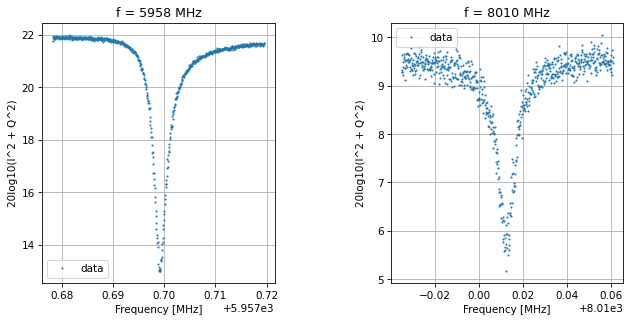

Saving data-2023-09-27-10-13-21
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.392 s


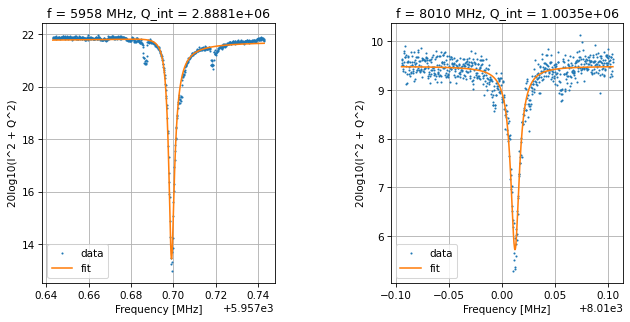

Frequencies out are: [5957.698794377806, 8010.012405662943] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


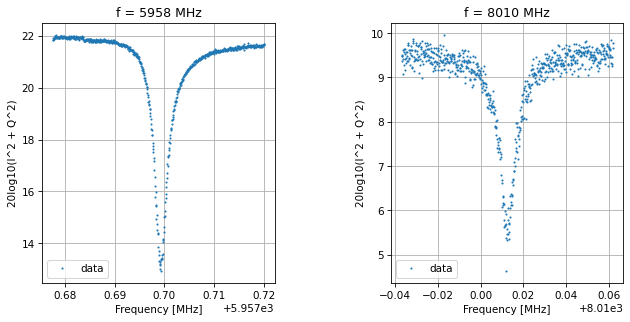

Saving data-2023-09-27-10-13-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


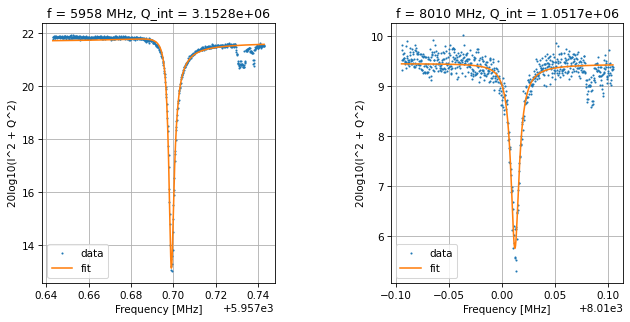

Frequencies out are: [5957.698684530759, 8010.012107333809] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.535 s


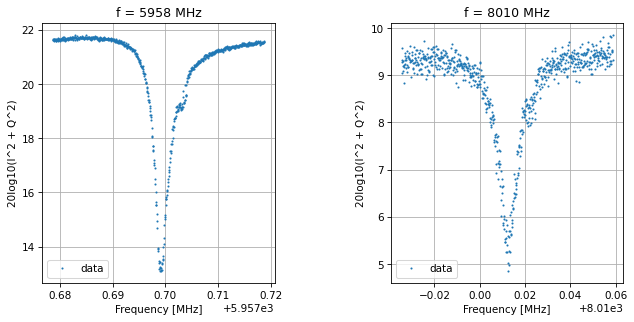

Saving data-2023-09-27-10-14-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.353 s


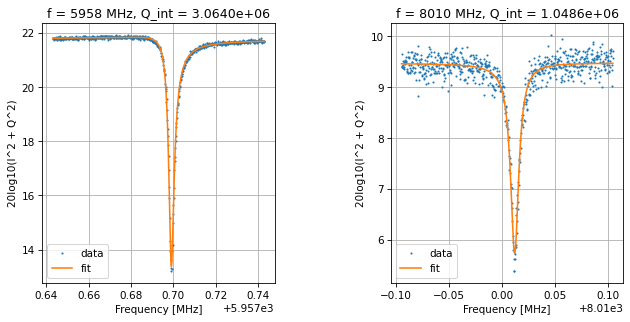

Frequencies out are: [5957.698761933444, 8010.01216175425] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


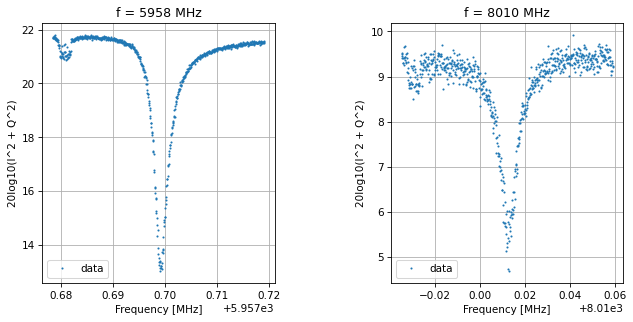

Saving data-2023-09-27-10-15-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.524 s


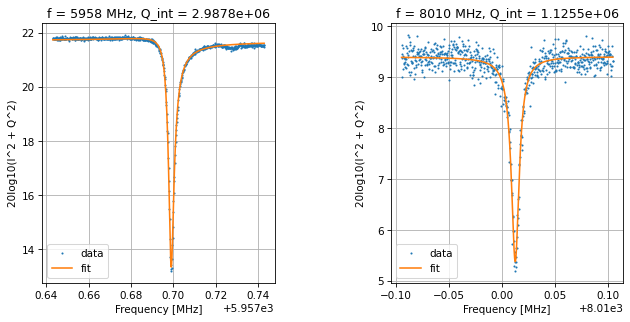

Frequencies out are: [5957.698655748261, 8010.012674788974] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.574 s


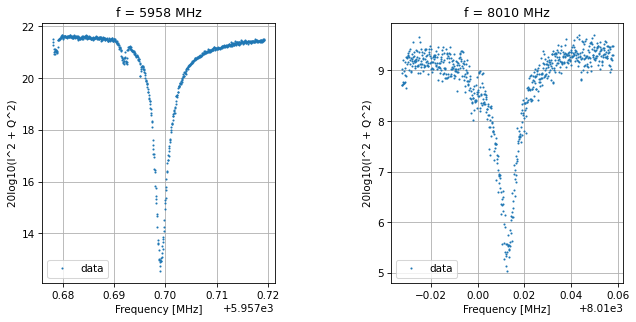

Saving data-2023-09-27-10-15-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


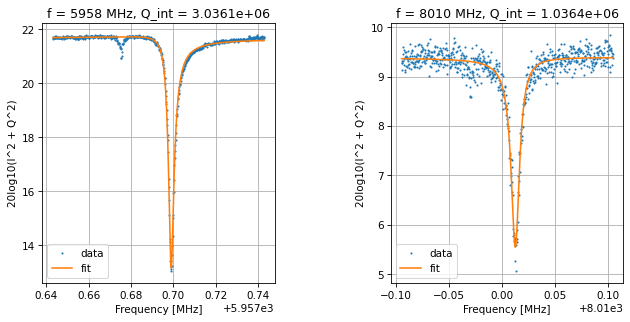

Frequencies out are: [5957.698686106542, 8010.012893789356] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.533 s


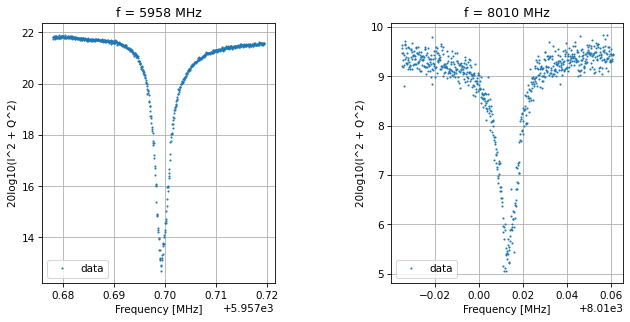

Saving data-2023-09-27-10-16-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.351 s


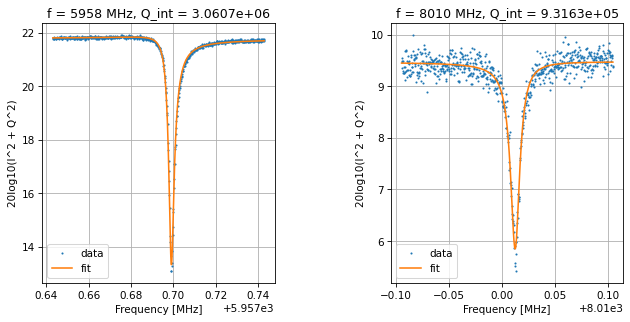

Frequencies out are: [5957.698787648331, 8010.012737977979] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.444 s


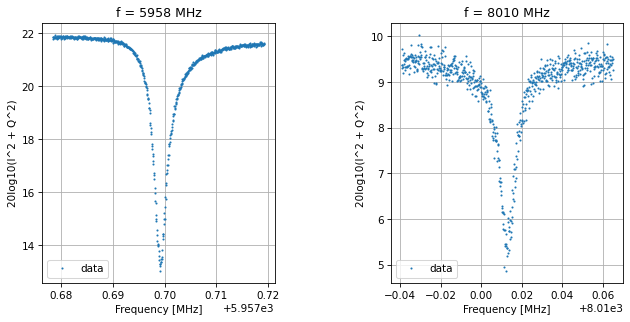

Saving data-2023-09-27-10-16-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.550 s


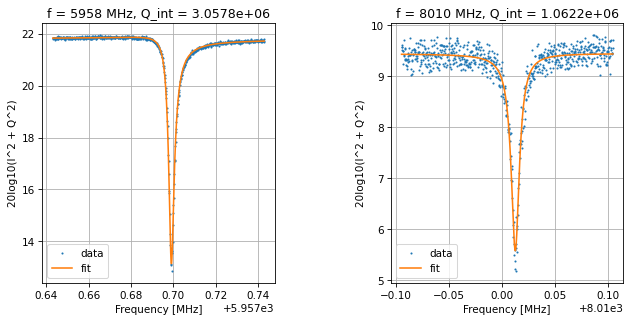

Frequencies out are: [5957.698771786819, 8010.0127172433195] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.532 s


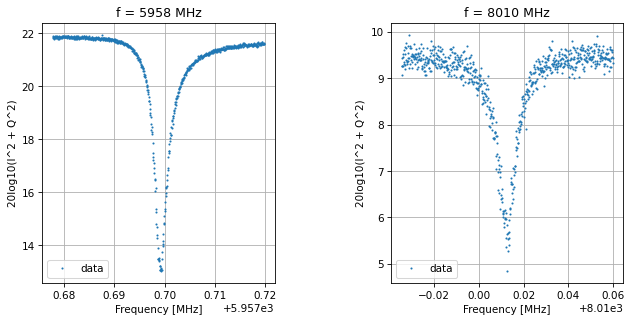

Saving data-2023-09-27-10-17-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.515 s


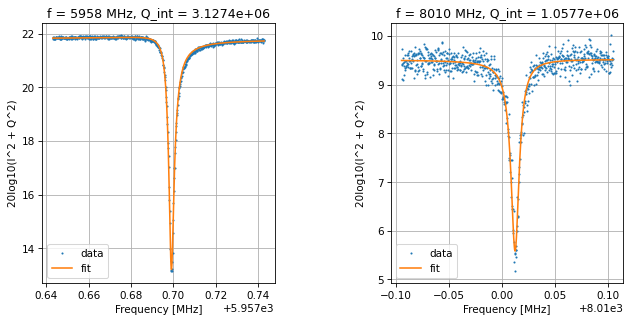

Frequencies out are: [5957.698807347966, 8010.012603450527] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.396 s


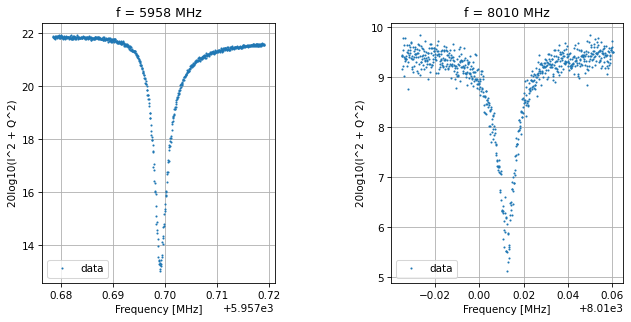

Saving data-2023-09-27-10-17-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.517 s


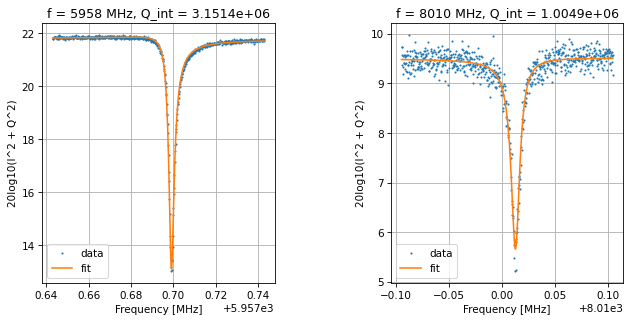

Frequencies out are: [5957.698796539215, 8010.013056955873] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


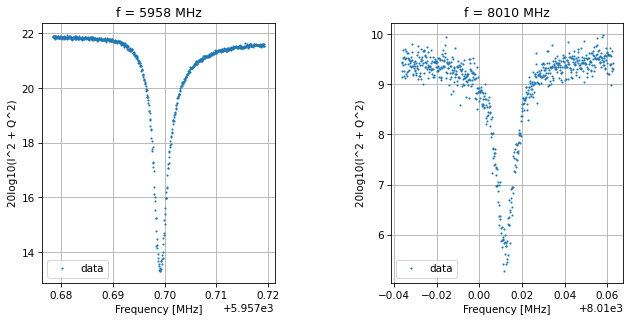

Saving data-2023-09-27-10-18-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.374 s


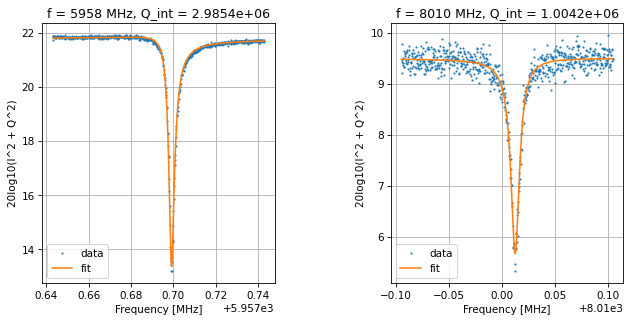

Frequencies out are: [5957.698841233936, 8010.012652749339] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.511 s


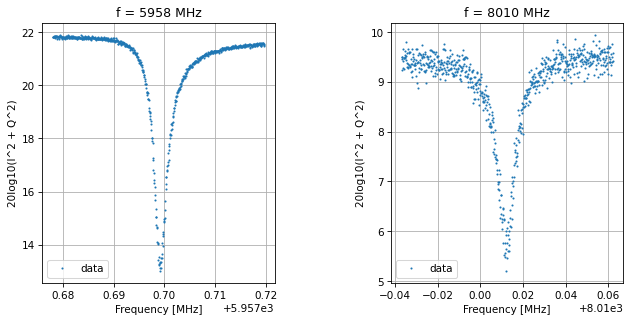

Saving data-2023-09-27-10-18-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.319 s


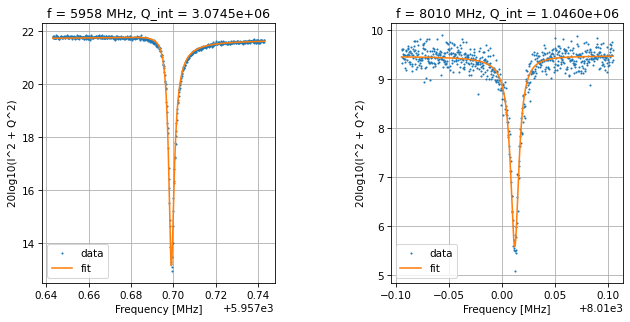

Frequencies out are: [5957.698751044089, 8010.012261816932] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.492 s


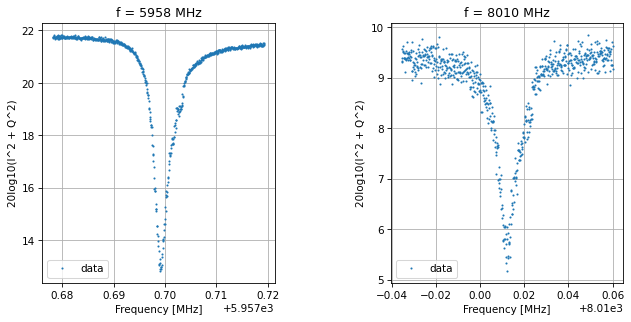

Saving data-2023-09-27-10-19-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.616 s


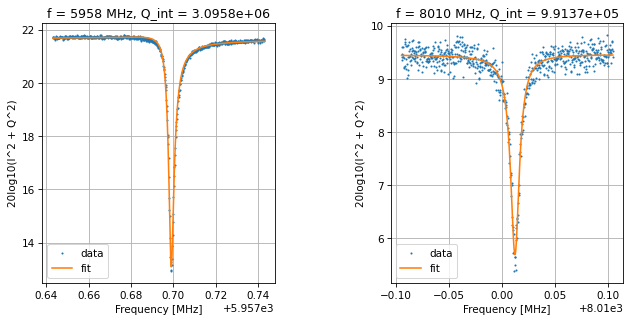

Frequencies out are: [5957.6987022987605, 8010.0124517485665] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.511 s


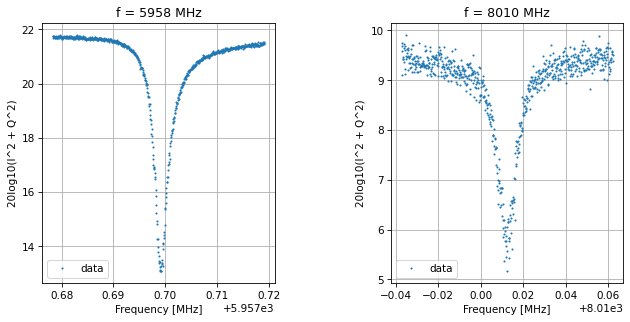

Saving data-2023-09-27-10-19-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.457 s


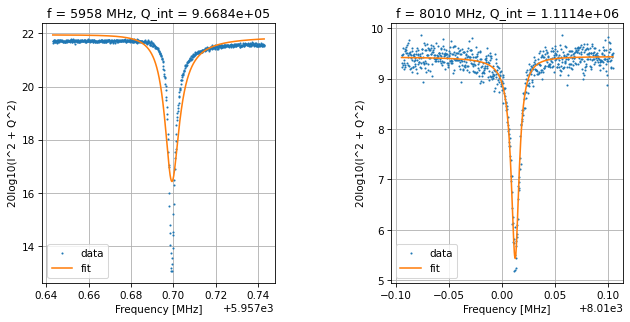

Frequencies out are: [5957.698865922825, 8010.012683226381] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.567 s


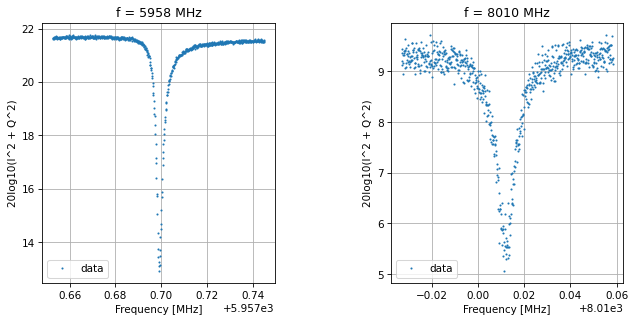

Saving data-2023-09-27-10-20-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.517 s


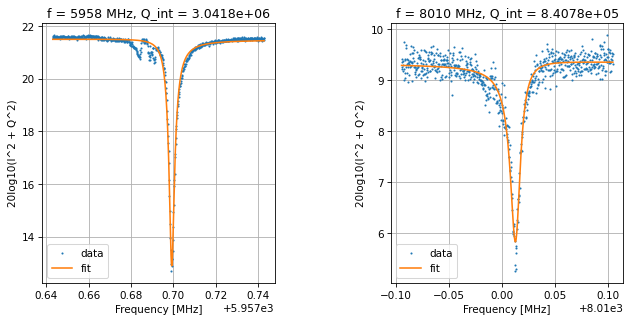

Frequencies out are: [5957.699120311399, 8010.013422268053] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.392 s


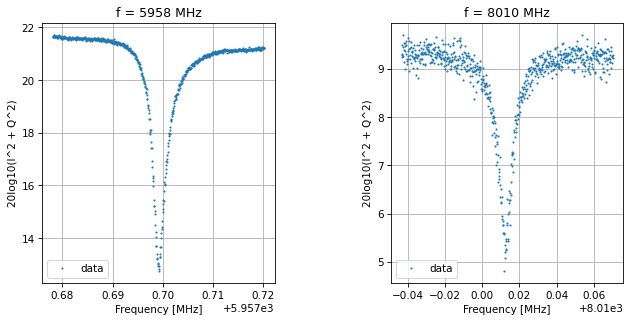

Saving data-2023-09-27-10-21-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.477 s


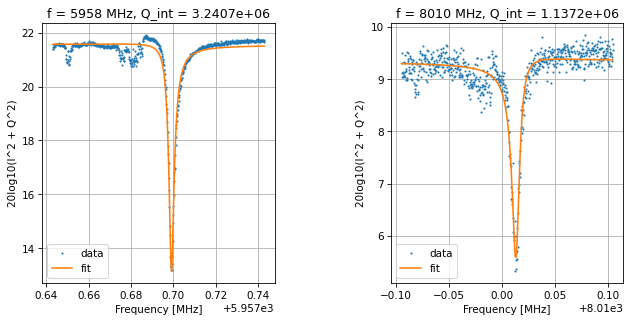

Frequencies out are: [5957.698942133265, 8010.013831488883] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.619 s


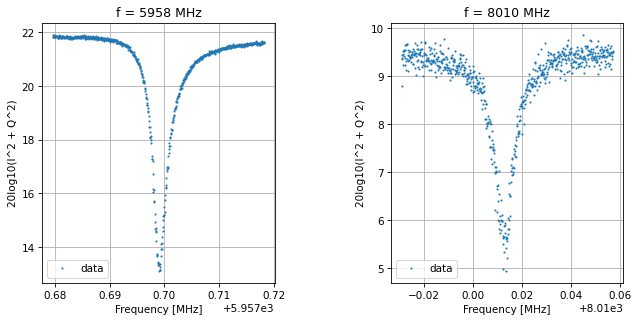

Saving data-2023-09-27-10-21-35
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.581 s


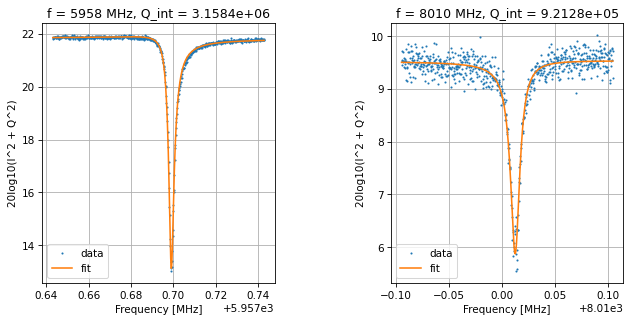

Frequencies out are: [5957.698762012913, 8010.012793466735] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.588 s


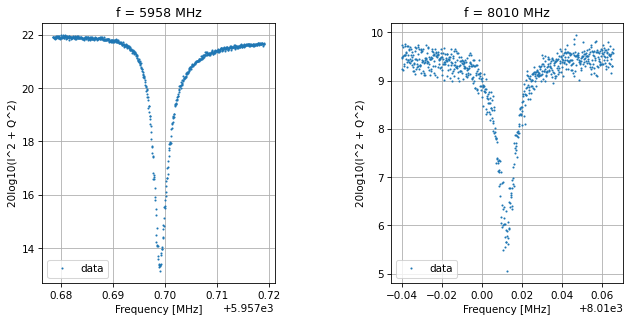

Saving data-2023-09-27-10-22-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.423 s


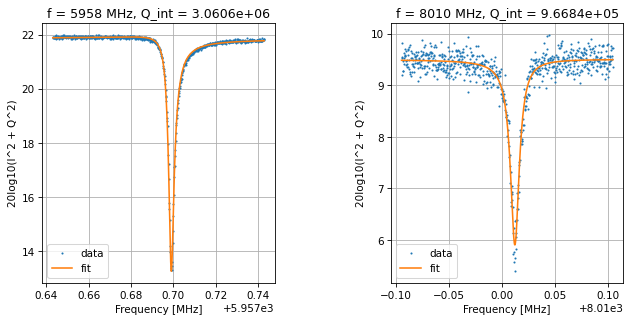

Frequencies out are: [5957.698744811035, 8010.012376963564] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.394 s


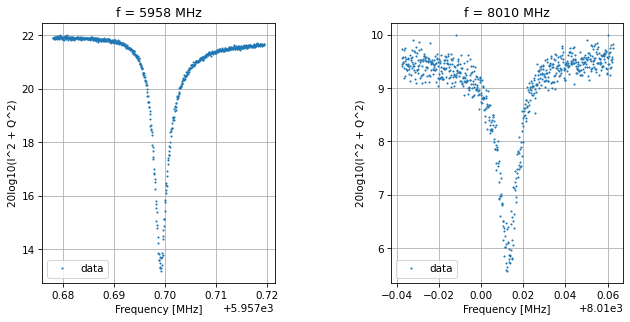

Saving data-2023-09-27-10-22-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.602 s


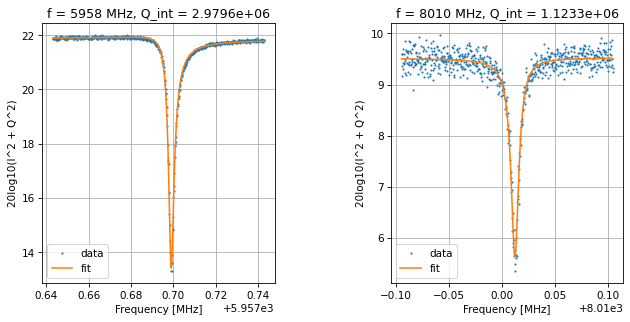

Frequencies out are: [5957.698696736575, 8010.012406030438] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.401 s


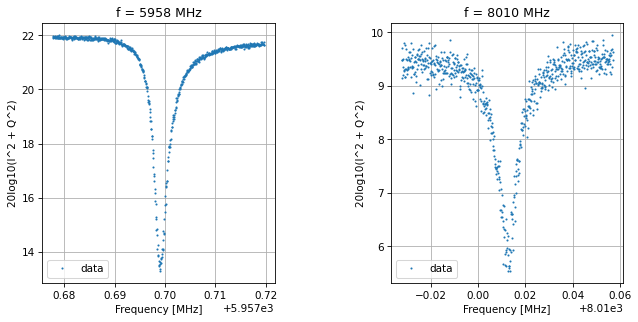

Saving data-2023-09-27-10-23-14
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.631 s


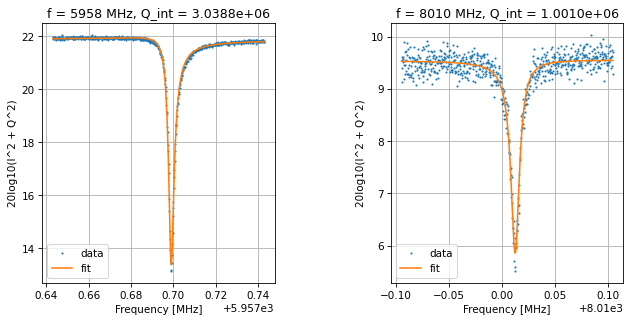

Frequencies out are: [5957.698694784826, 8010.012730553397] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.585 s


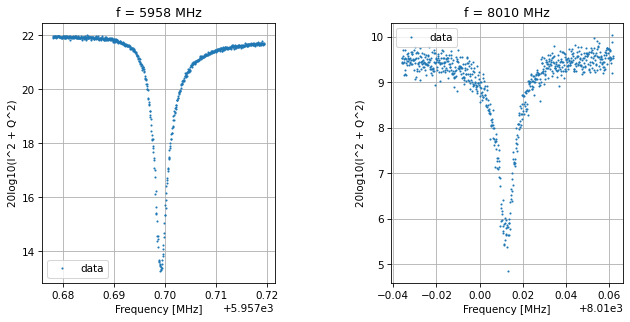

Saving data-2023-09-27-10-23-47
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.590 s


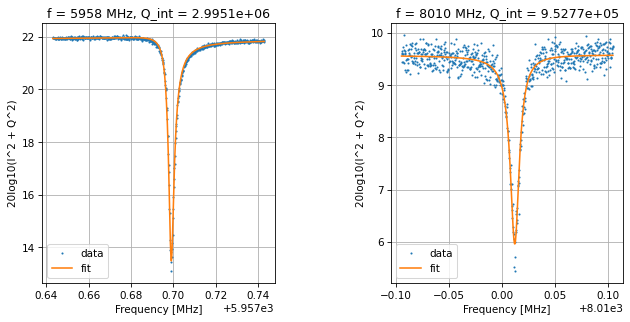

Frequencies out are: [5957.698722746022, 8010.0123233341155] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.499 s


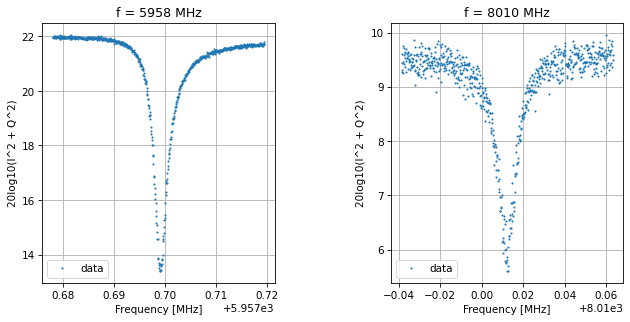

Saving data-2023-09-27-10-24-21
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.477 s


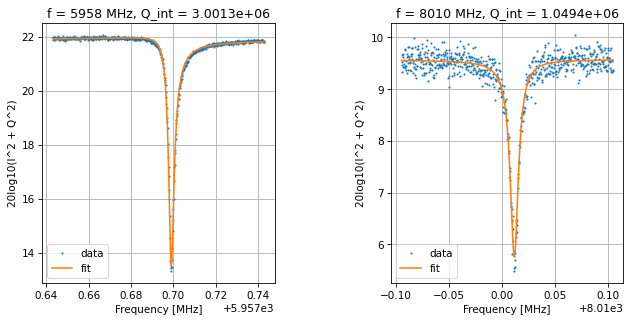

Frequencies out are: [5957.698723743286, 8010.011818164461] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.542 s


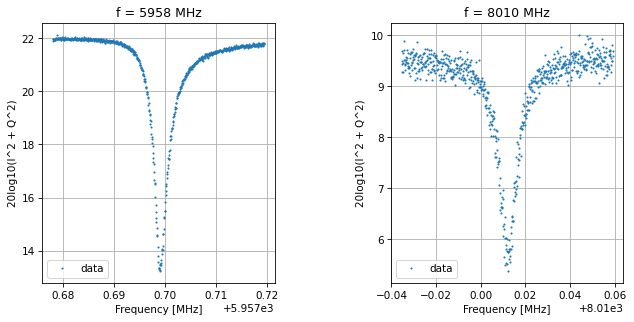

Saving data-2023-09-27-10-24-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


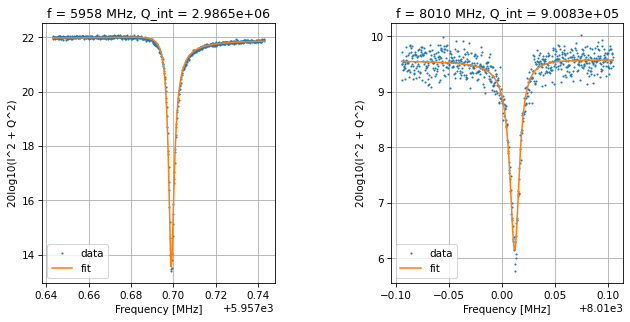

Frequencies out are: [5957.698714767987, 8010.012348832012] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.519 s


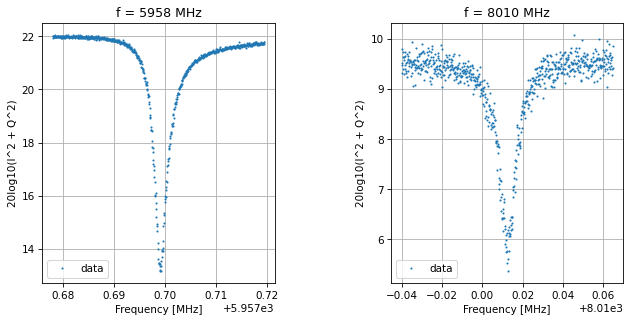

Saving data-2023-09-27-10-25-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


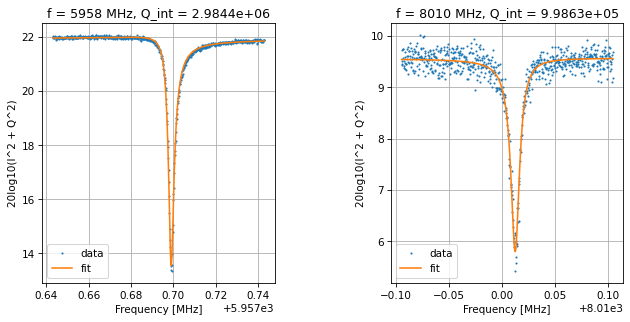

Frequencies out are: [5957.698684554197, 8010.012756523706] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.593 s


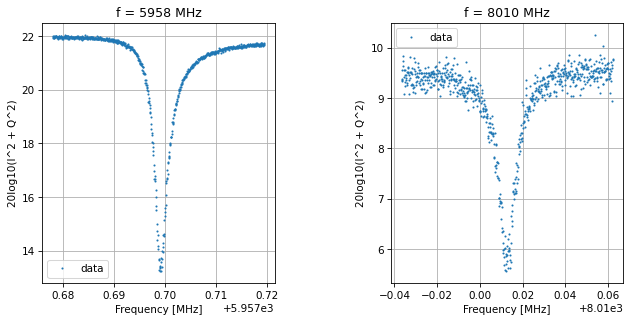

Saving data-2023-09-27-10-26-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.526 s


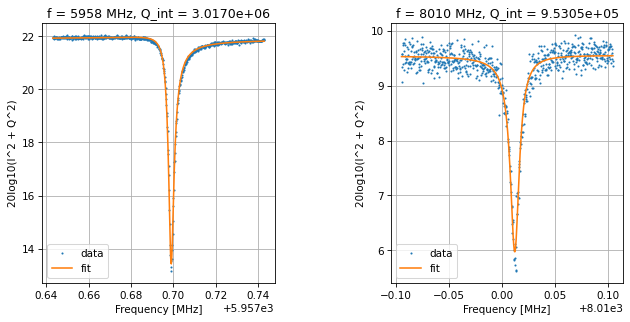

Frequencies out are: [5957.698679840464, 8010.012336880619] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.428 s


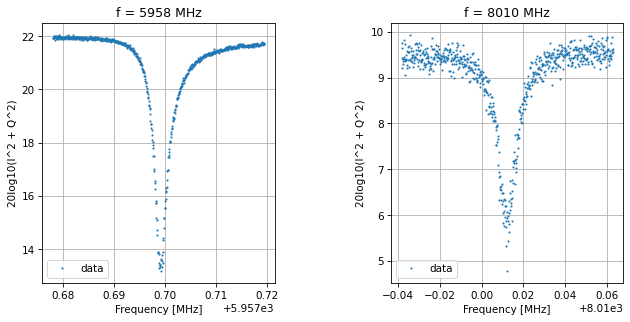

Saving data-2023-09-27-10-26-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.378 s


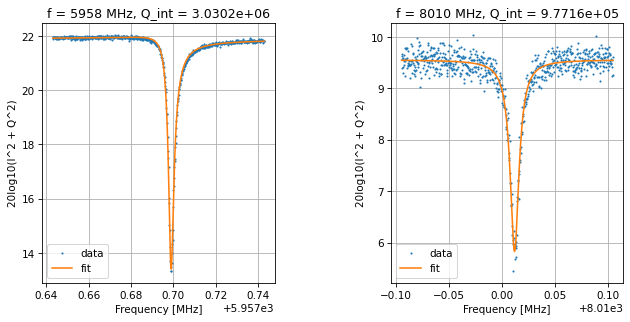

Frequencies out are: [5957.698649031612, 8010.011957908536] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.398 s


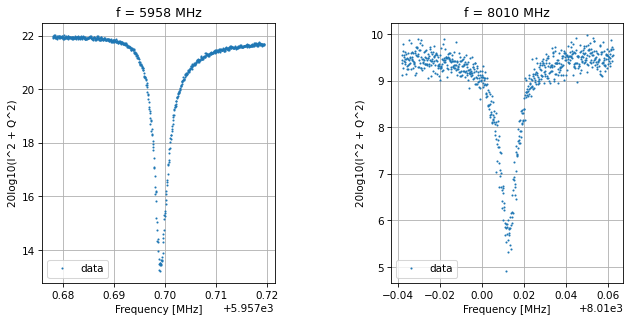

Saving data-2023-09-27-10-27-05
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.478 s


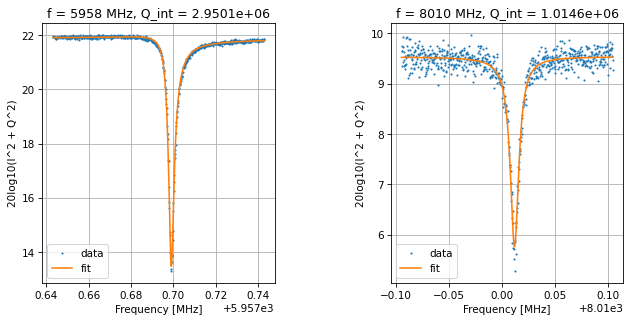

Frequencies out are: [5957.698727178424, 8010.011977463388] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.512 s


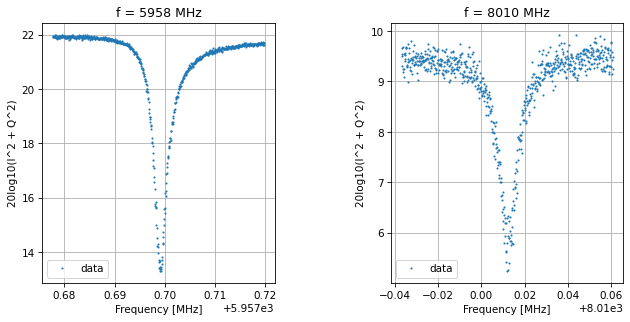

Saving data-2023-09-27-10-27-38
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.505 s


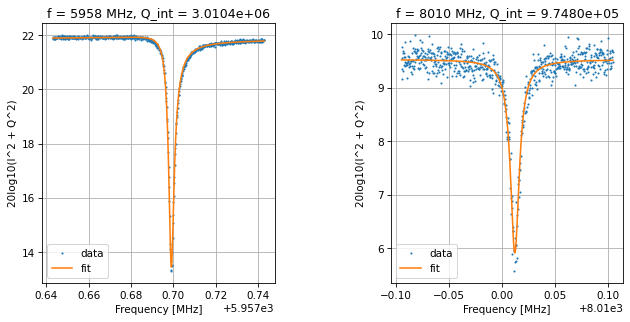

Frequencies out are: [5957.698756333342, 8010.012159778706] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.385 s


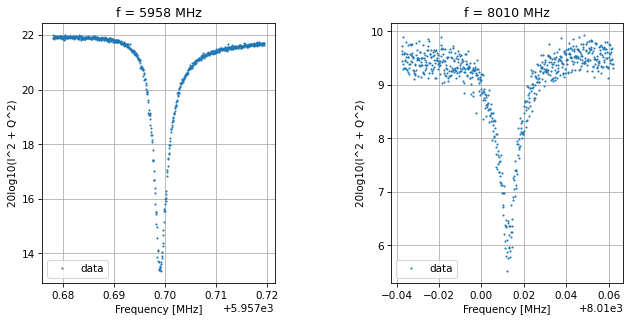

Saving data-2023-09-27-10-28-11
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


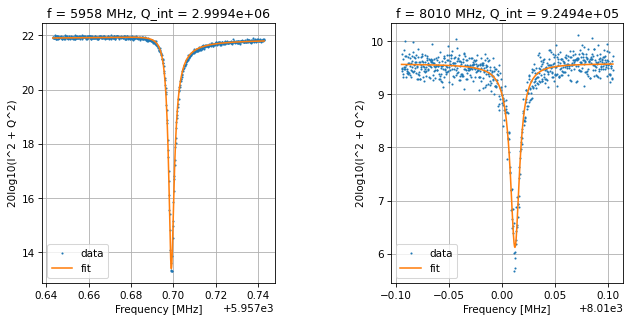

Frequencies out are: [5957.698754060922, 8010.012401394169] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.427 s


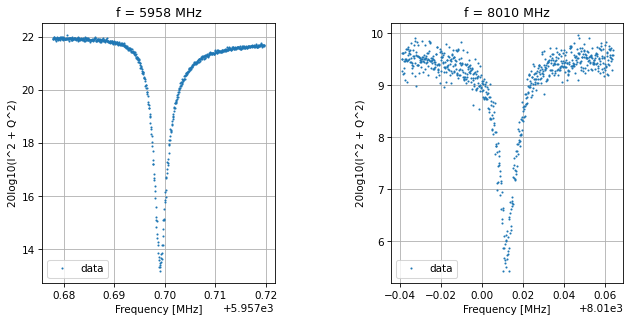

Saving data-2023-09-27-10-28-44
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.265 s


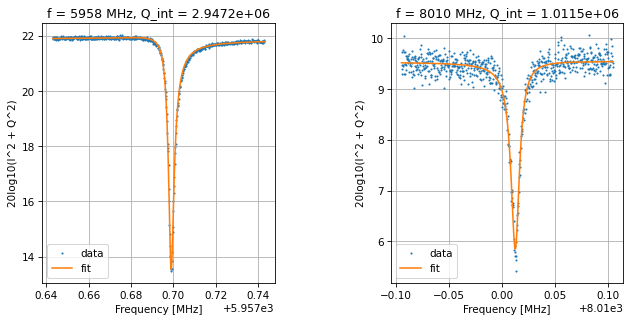

Frequencies out are: [5957.6986711765885, 8010.012866428921] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.513 s


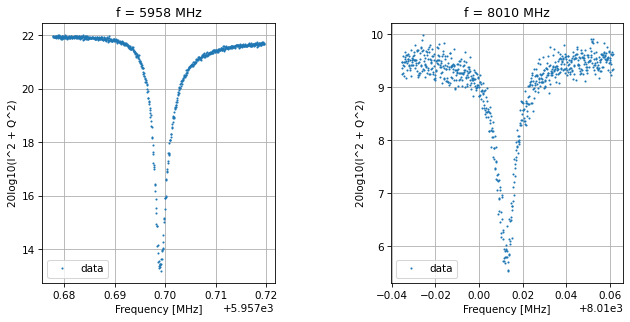

Saving data-2023-09-27-10-29-17
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.435 s


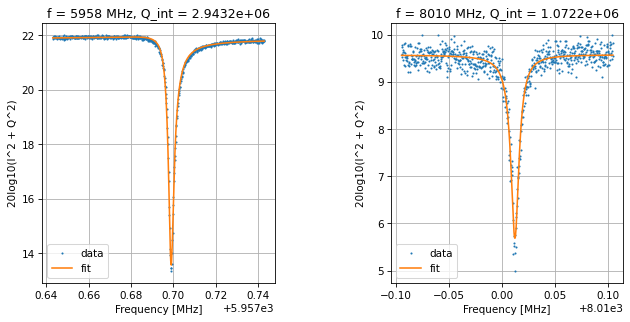

Frequencies out are: [5957.698645208462, 8010.012361530429] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.559 s


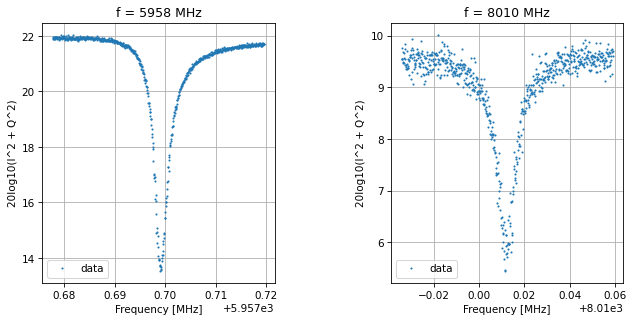

Saving data-2023-09-27-10-29-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.894 s


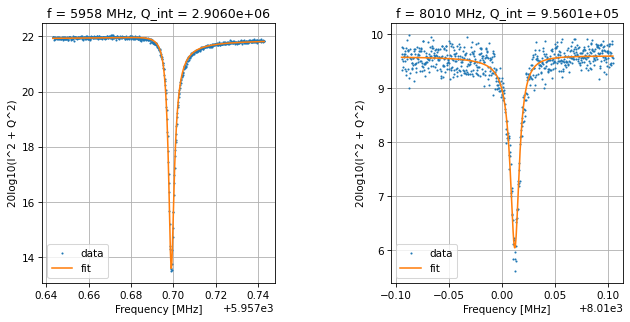

Frequencies out are: [5957.698712118815, 8010.012417091119] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.472 s


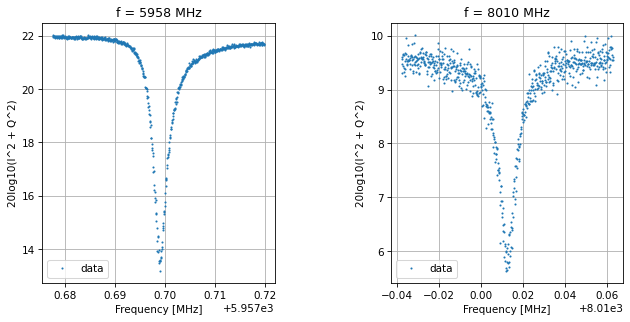

Saving data-2023-09-27-10-30-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.513 s


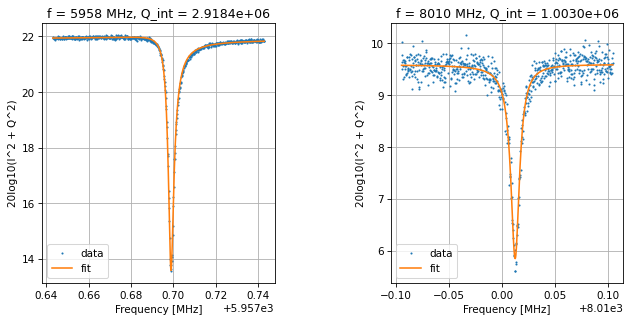

Frequencies out are: [5957.698595145447, 8010.012630012769] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.489 s


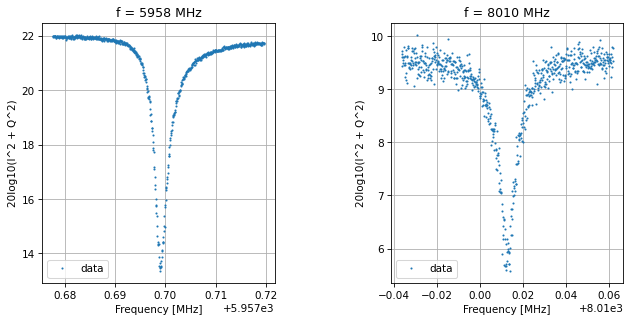

Saving data-2023-09-27-10-30-56
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.418 s


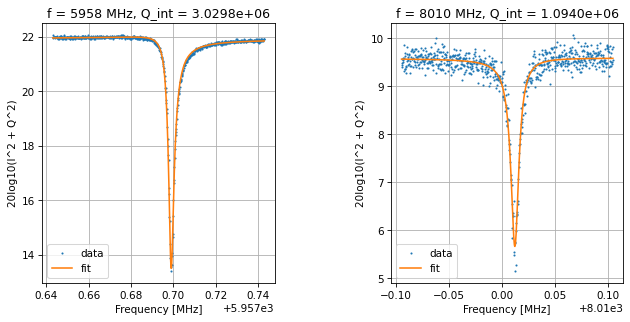

Frequencies out are: [5957.698701000699, 8010.012398273442] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.414 s


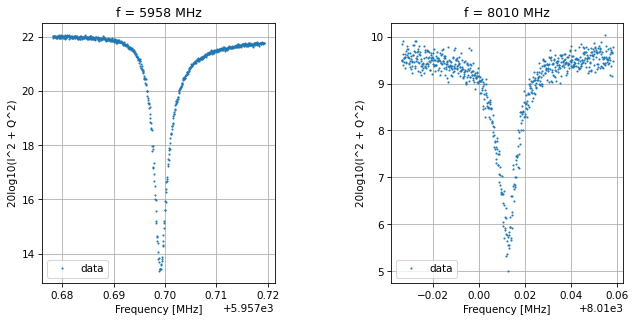

Saving data-2023-09-27-10-31-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.552 s


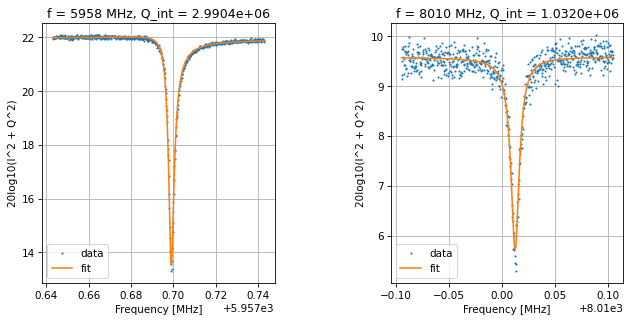

Frequencies out are: [5957.698713179175, 8010.012538306903] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.612 s


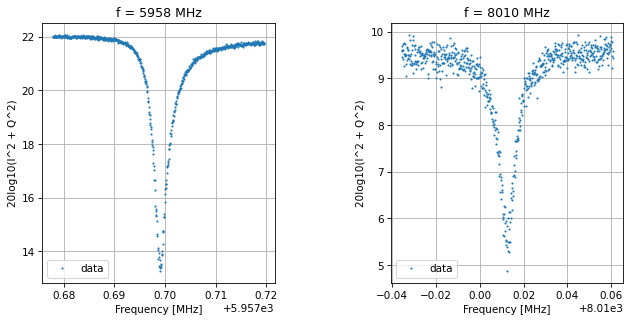

Saving data-2023-09-27-10-32-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.500 s


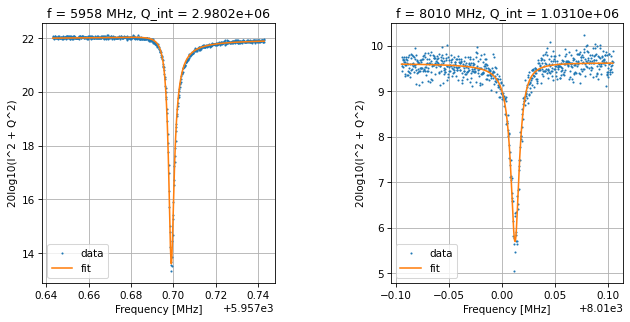

Frequencies out are: [5957.698718637669, 8010.012629764982] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.537 s


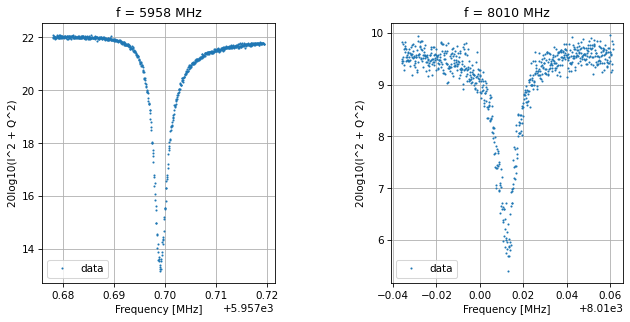

Saving data-2023-09-27-10-32-35
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.457 s


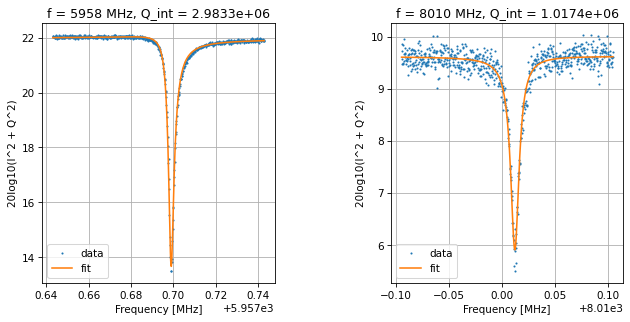

Frequencies out are: [5957.698682612737, 8010.0123541902485] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


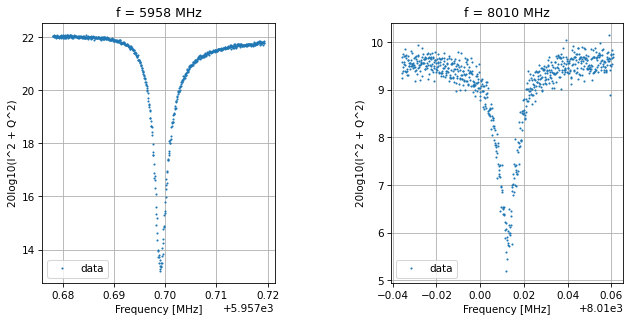

Saving data-2023-09-27-10-33-08
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.366 s


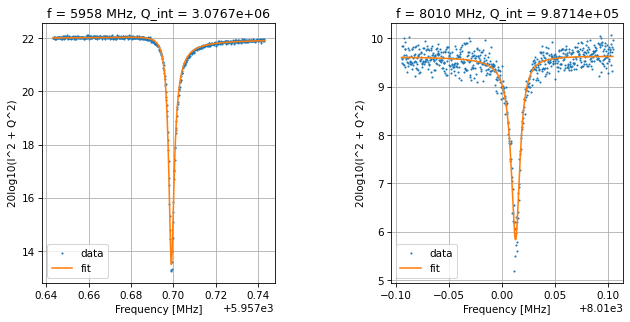

Frequencies out are: [5957.698773599139, 8010.0131138755505] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


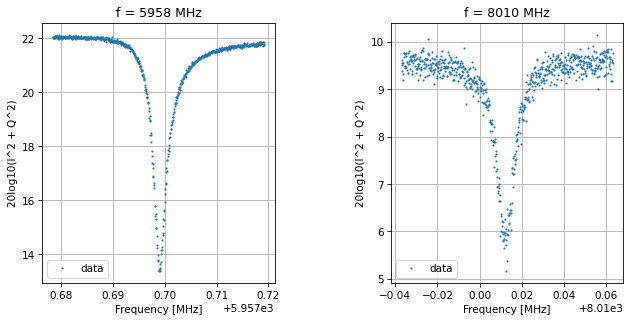

Saving data-2023-09-27-10-33-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.347 s


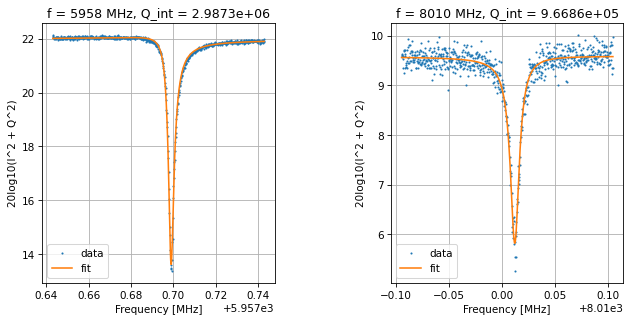

Frequencies out are: [5957.698652227675, 8010.0123640336005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.471 s


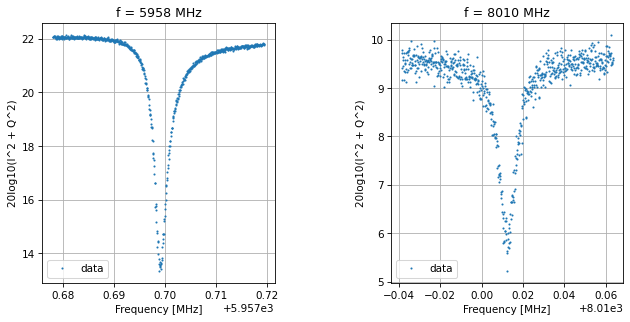

Saving data-2023-09-27-10-34-14
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.547 s


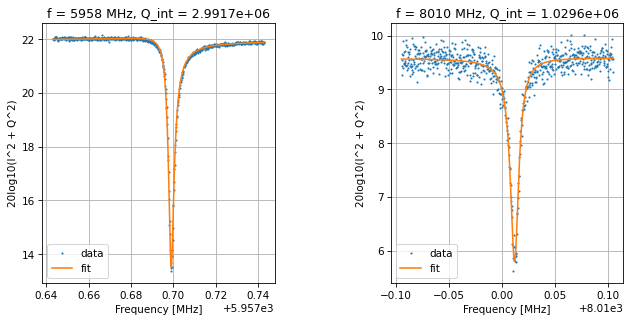

Frequencies out are: [5957.698676528301, 8010.012106886902] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.525 s


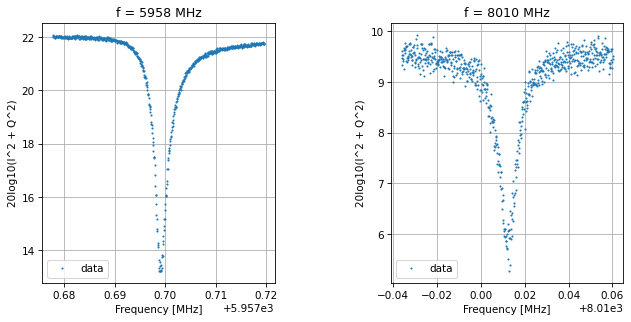

Saving data-2023-09-27-10-34-46
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.405 s


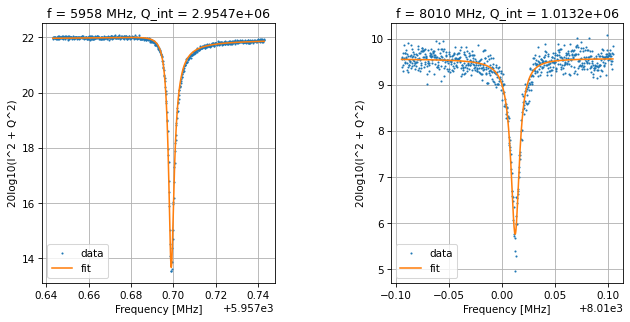

Frequencies out are: [5957.698718732475, 8010.012633497297] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


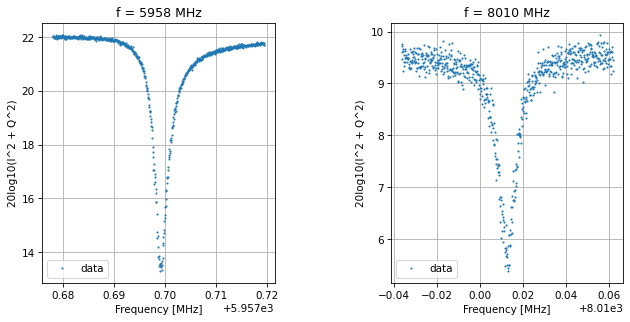

Saving data-2023-09-27-10-35-19
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.431 s


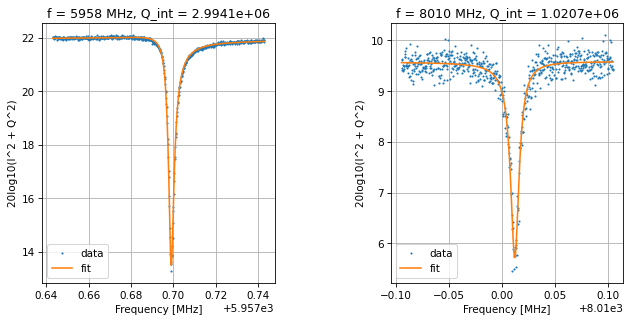

Frequencies out are: [5957.698693213533, 8010.0123471303905] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.467 s


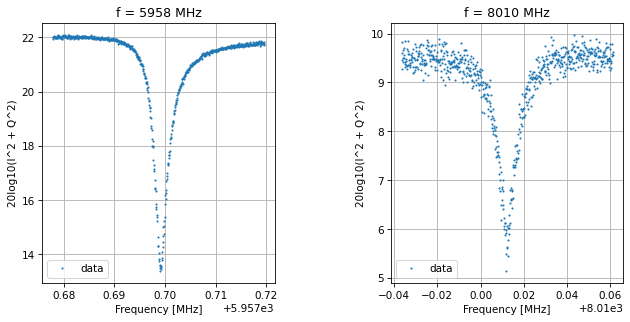

Saving data-2023-09-27-10-35-52
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.474 s


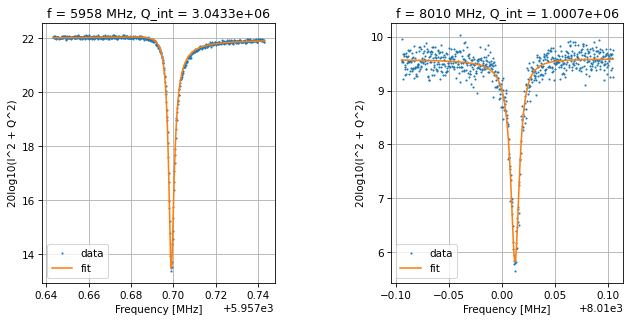

Frequencies out are: [5957.698715305762, 8010.012594776365] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.894 s


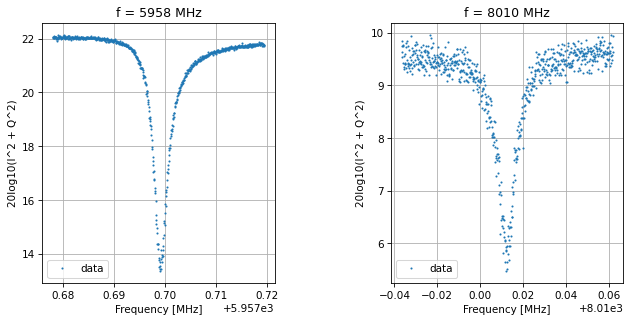

Saving data-2023-09-27-10-36-25
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.524 s


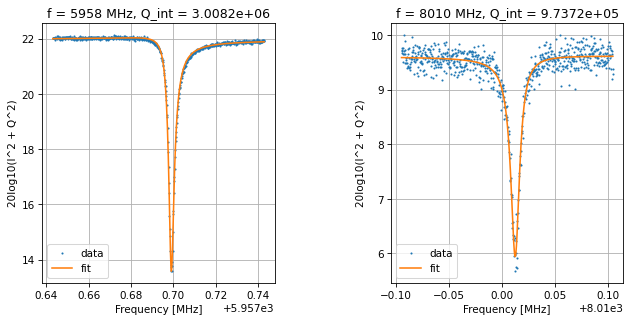

Frequencies out are: [5957.698756931038, 8010.012822932737] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.602 s


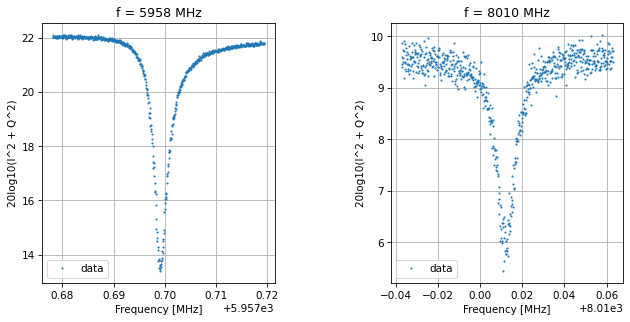

Saving data-2023-09-27-10-36-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.527 s


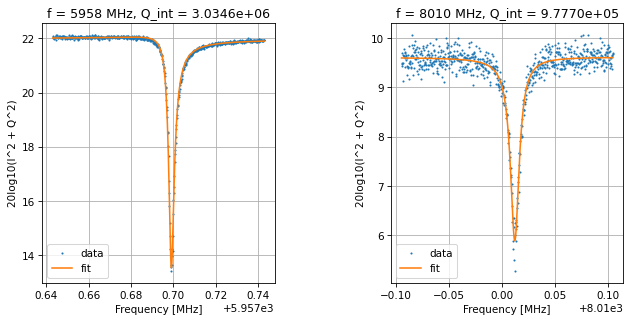

Frequencies out are: [5957.6987571938835, 8010.012267146225] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.542 s


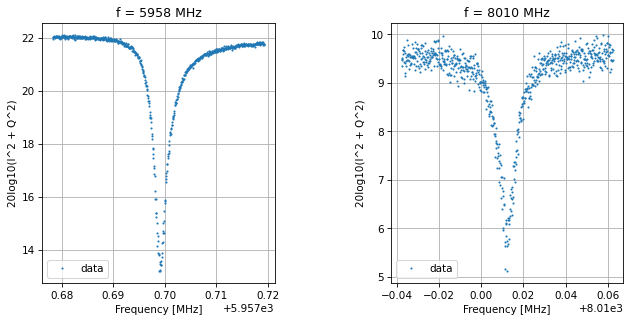

Saving data-2023-09-27-10-37-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.420 s


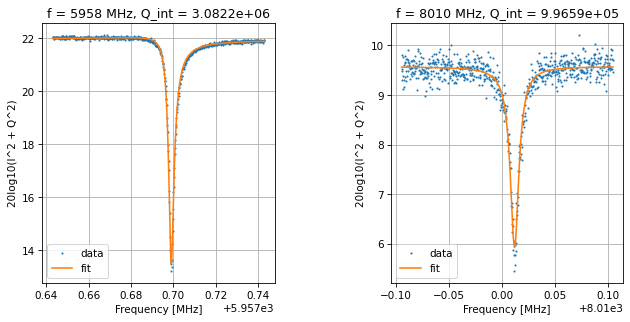

Frequencies out are: [5957.698736632313, 8010.012017967732] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.462 s


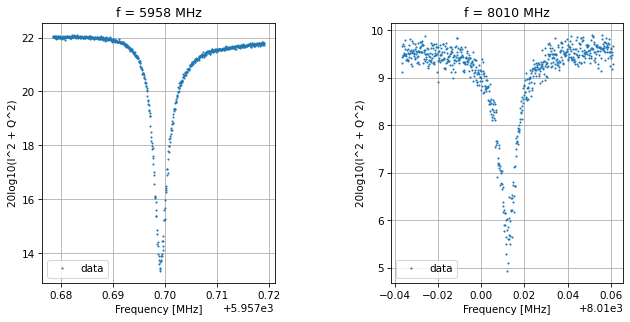

Saving data-2023-09-27-10-38-04
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


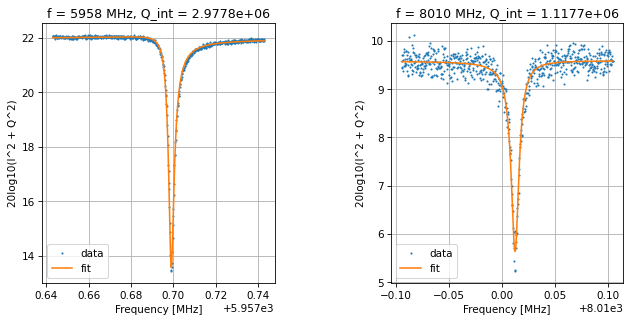

Frequencies out are: [5957.698721588245, 8010.012589111092] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.399 s


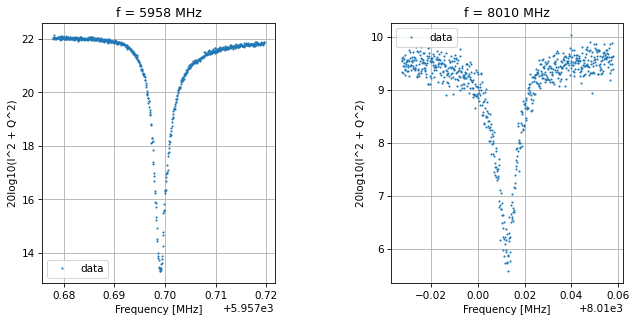

Saving data-2023-09-27-10-38-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.398 s


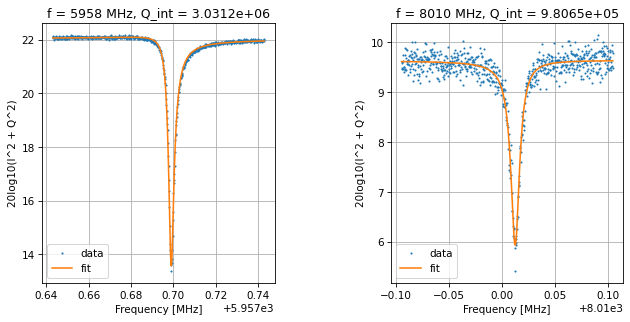

Frequencies out are: [5957.698713604486, 8010.012730993275] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.288 s


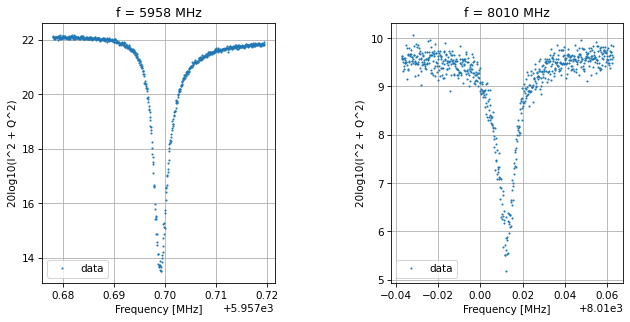

Saving data-2023-09-27-10-39-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


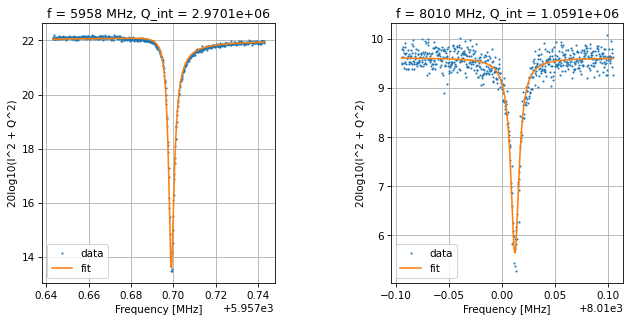

Frequencies out are: [5957.698720030362, 8010.012230351722] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.498 s


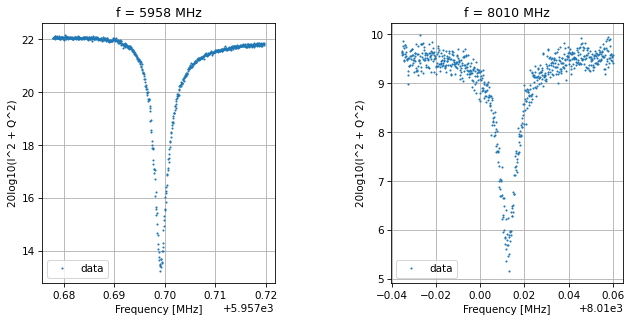

Saving data-2023-09-27-10-39-42
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.452 s


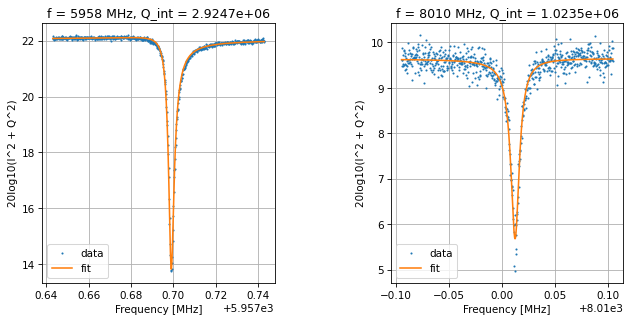

Frequencies out are: [5957.69872116002, 8010.012595848825] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.485 s


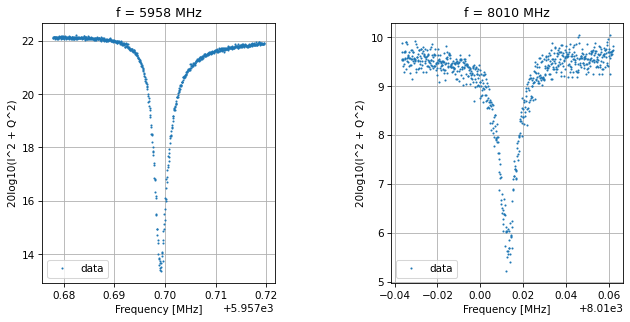

Saving data-2023-09-27-10-40-14
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.344 s


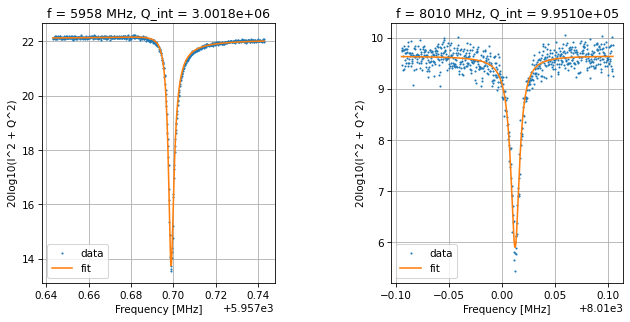

Frequencies out are: [5957.698636127782, 8010.012509944498] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.544 s


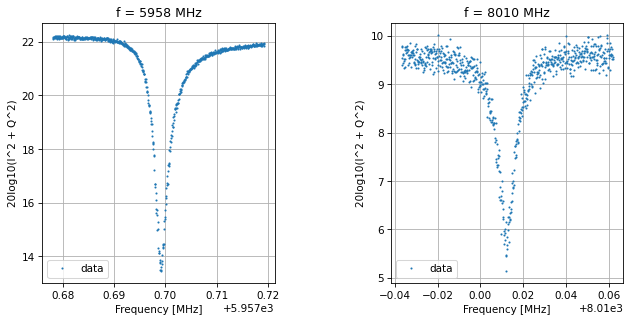

Saving data-2023-09-27-10-40-47
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.460 s


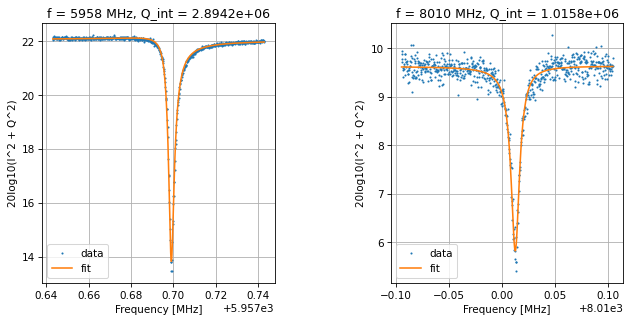

Frequencies out are: [5957.698729573294, 8010.012742136833] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.369 s


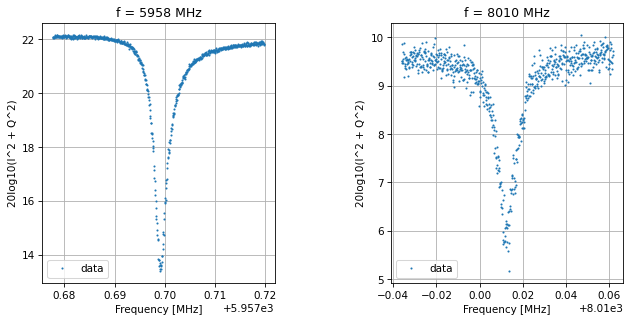

Saving data-2023-09-27-10-41-20
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.442 s


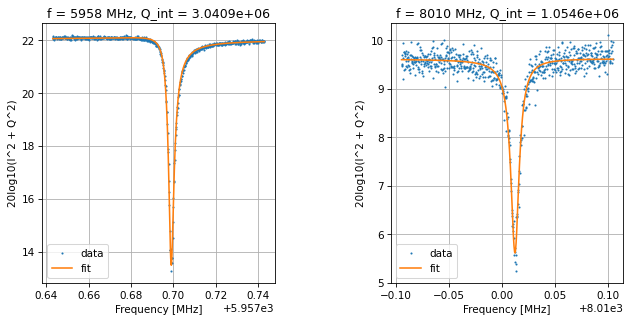

Frequencies out are: [5957.698696398319, 8010.012459529083] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.542 s


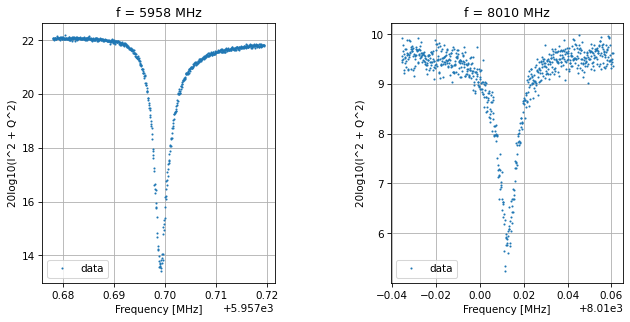

Saving data-2023-09-27-10-41-53
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.526 s


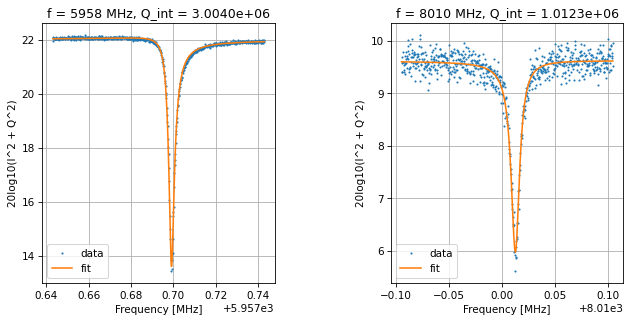

Frequencies out are: [5957.698839935534, 8010.012893535868] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.772 s


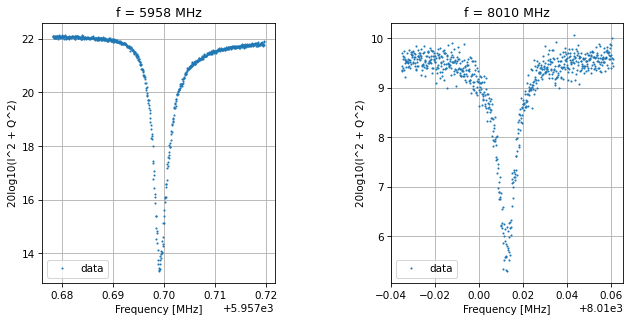

Saving data-2023-09-27-10-42-25
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.409 s


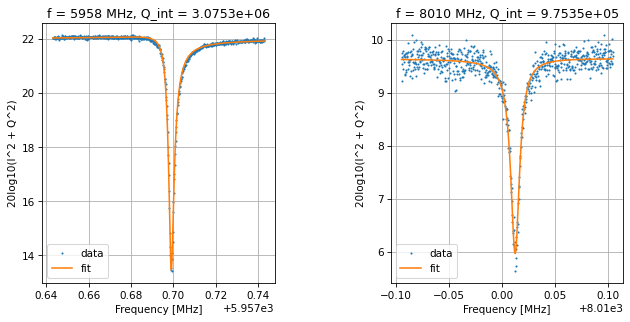

Frequencies out are: [5957.698714171301, 8010.01266241286] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.519 s


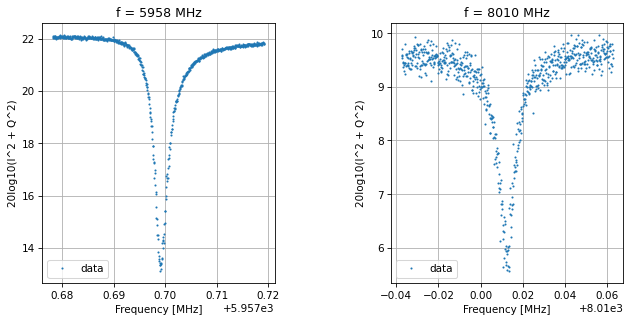

Saving data-2023-09-27-10-42-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.531 s


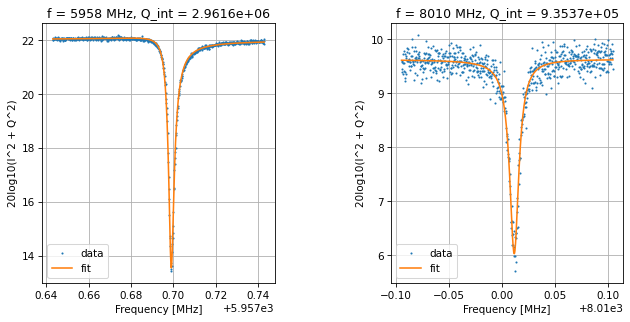

Frequencies out are: [5957.698709673024, 8010.011740504735] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.522 s


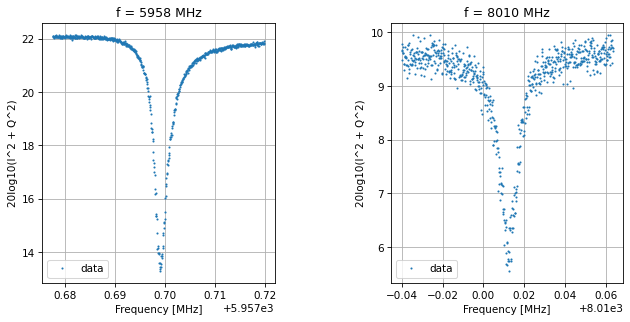

Saving data-2023-09-27-10-43-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.373 s


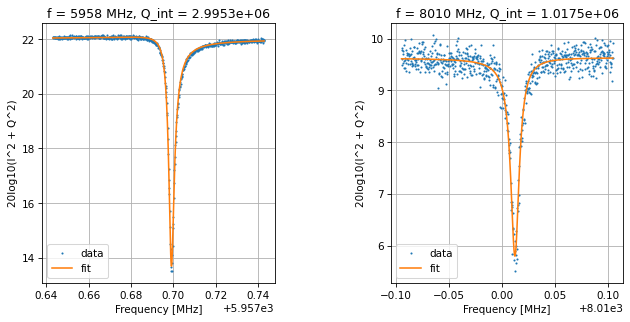

Frequencies out are: [5957.69880860587, 8010.012461568666] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.460 s


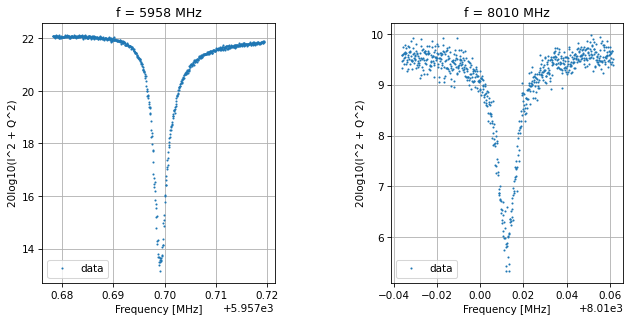

Saving data-2023-09-27-10-44-04
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.453 s


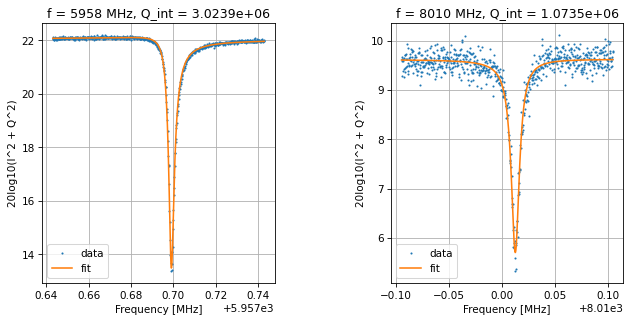

Frequencies out are: [5957.698775914353, 8010.012771864744] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.505 s


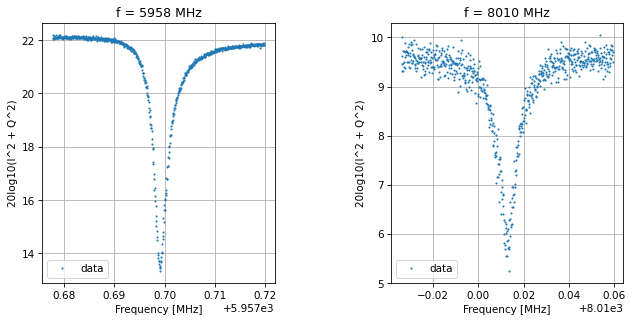

Saving data-2023-09-27-10-44-37
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.421 s


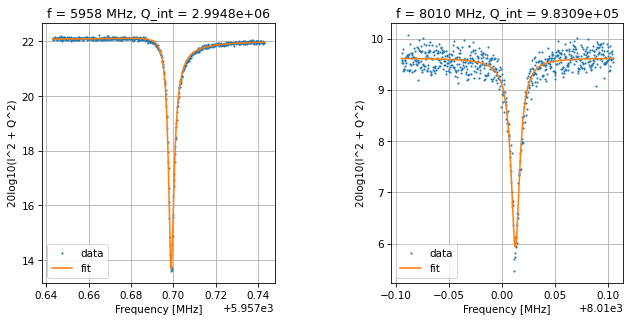

Frequencies out are: [5957.698663773221, 8010.012725957335] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.505 s


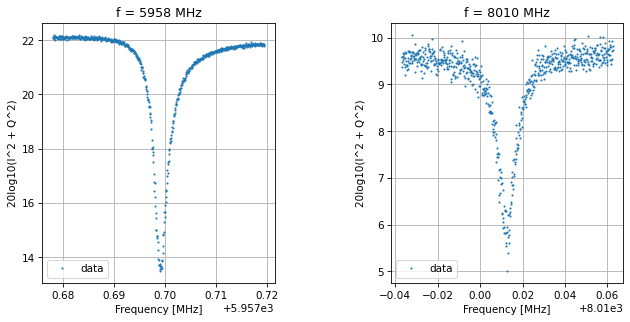

Saving data-2023-09-27-10-45-10
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


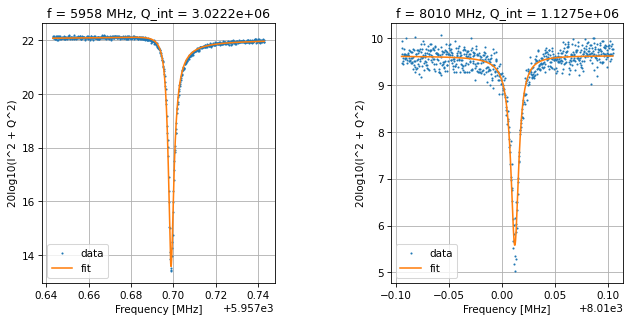

Frequencies out are: [5957.6985943064365, 8010.012283498452] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.545 s


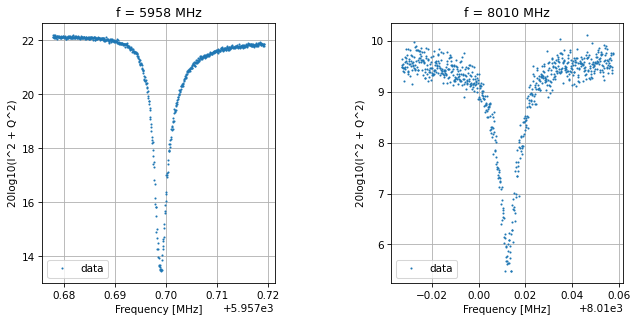

Saving data-2023-09-27-10-45-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.434 s


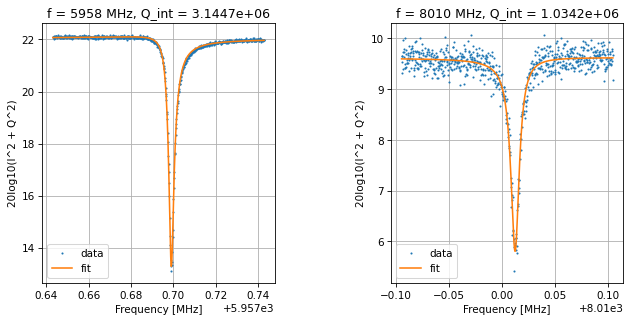

Frequencies out are: [5957.698765110042, 8010.012661937647] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


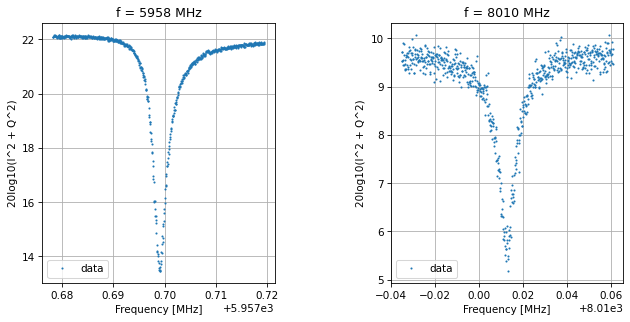

Saving data-2023-09-27-10-46-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.399 s


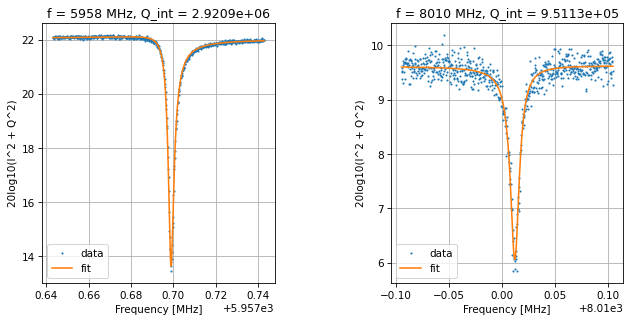

Frequencies out are: [5957.698607715499, 8010.012375768833] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.583 s


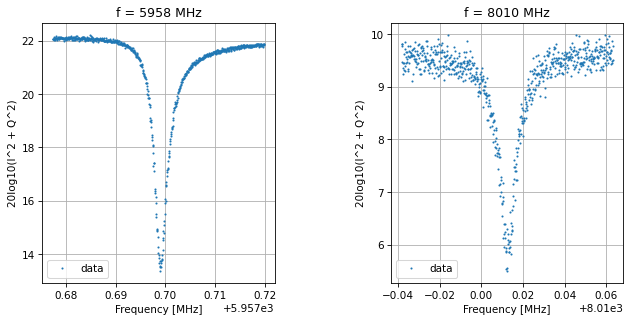

Saving data-2023-09-27-10-46-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.467 s


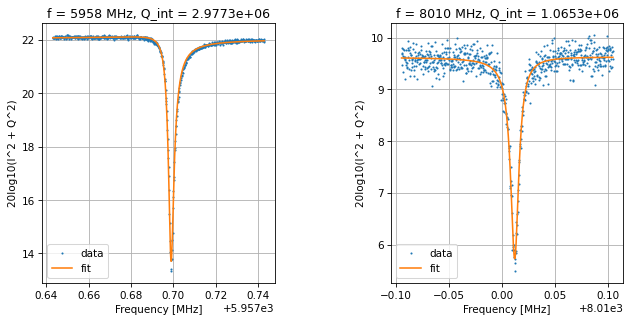

Frequencies out are: [5957.698649207778, 8010.012238010006] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.408 s


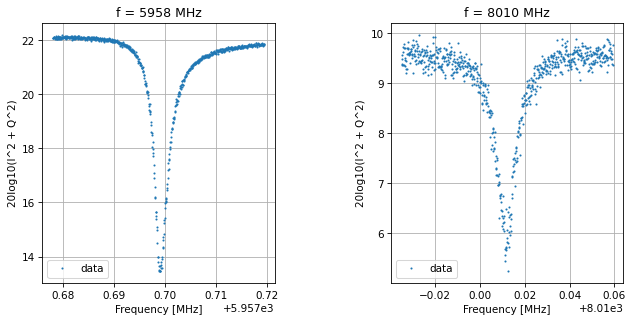

Saving data-2023-09-27-10-47-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.516 s


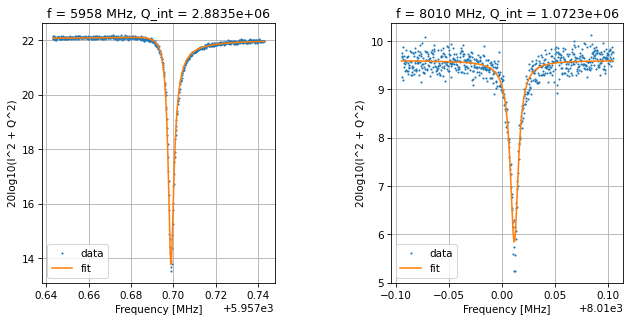

Frequencies out are: [5957.698556707938, 8010.011692742691] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.543 s


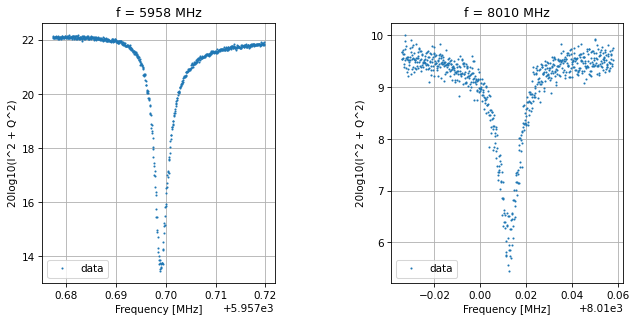

Saving data-2023-09-27-10-47-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.467 s


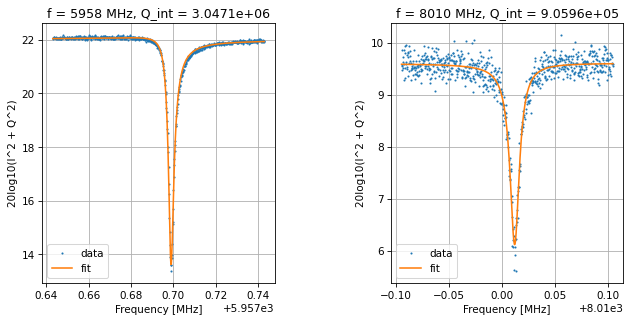

Frequencies out are: [5957.698643042677, 8010.012181603561] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.812 s


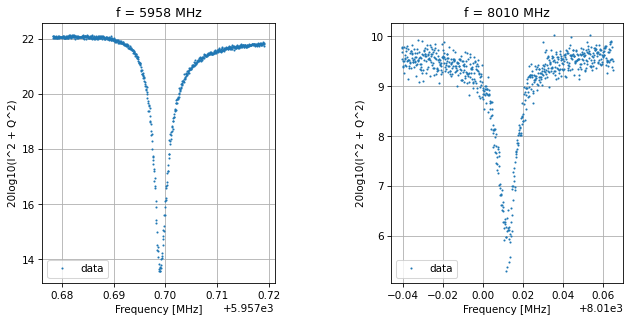

Saving data-2023-09-27-10-48-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.471 s


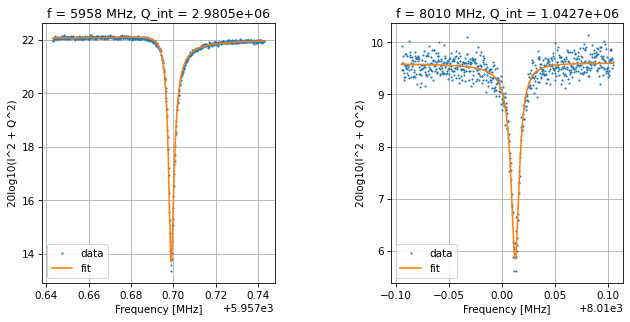

Frequencies out are: [5957.698685454634, 8010.012743286921] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.268 s


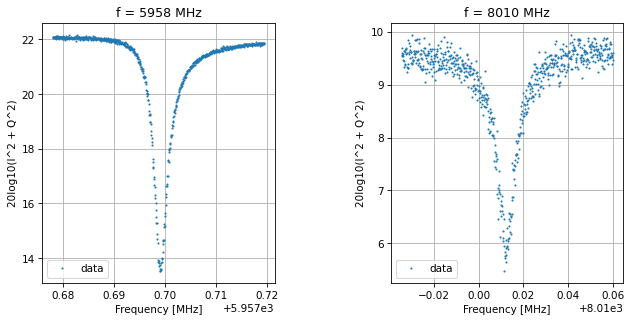

Saving data-2023-09-27-10-49-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.380 s


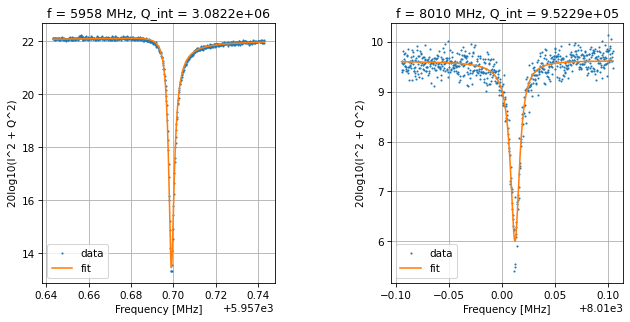

Frequencies out are: [5957.698763896027, 8010.012525654223] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.321 s


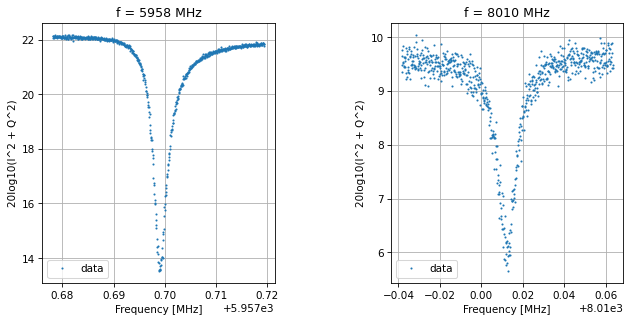

Saving data-2023-09-27-10-49-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


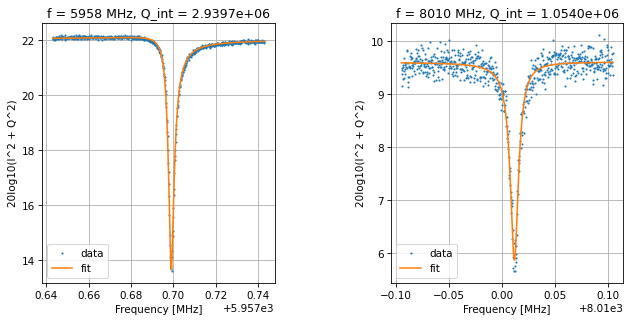

Frequencies out are: [5957.698704988092, 8010.011911874937] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.540 s


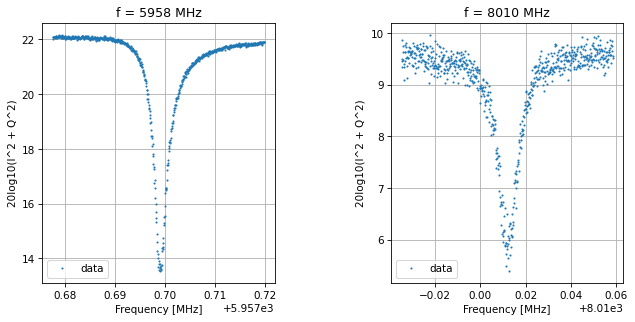

Saving data-2023-09-27-10-50-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.609 s


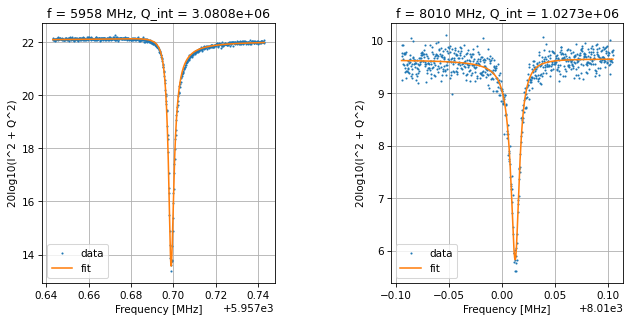

Frequencies out are: [5957.6986626529, 8010.012785202629] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.480 s


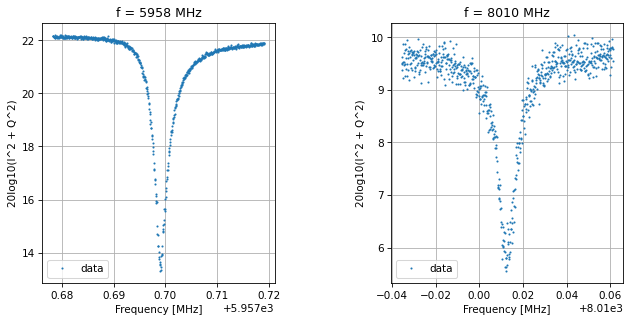

Saving data-2023-09-27-10-50-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.586 s


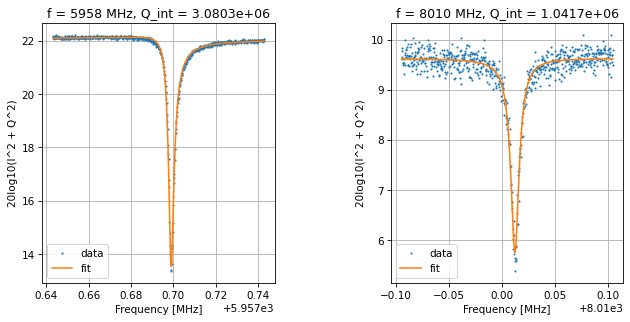

Frequencies out are: [5957.698671828125, 8010.012369753868] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.495 s


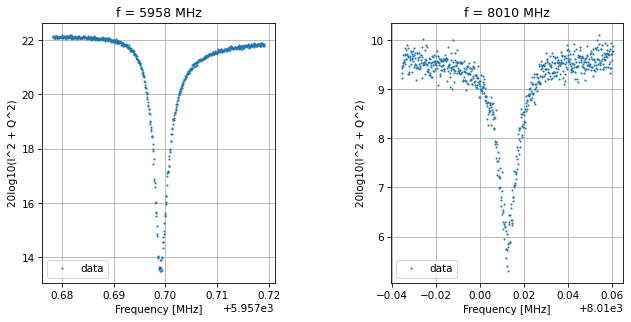

Saving data-2023-09-27-10-51-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.402 s


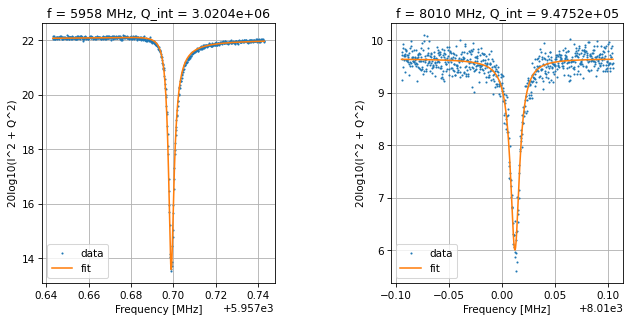

Frequencies out are: [5957.698688665259, 8010.012355213093] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.421 s


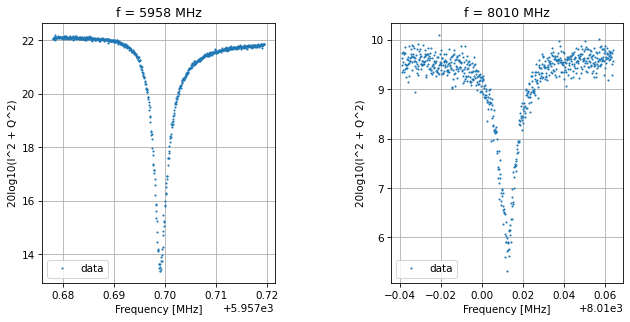

Saving data-2023-09-27-10-51-44
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.358 s


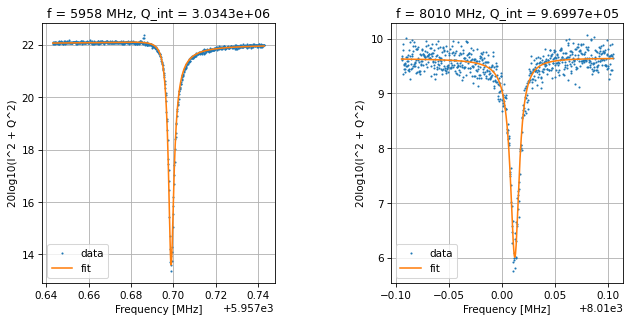

Frequencies out are: [5957.698635350038, 8010.012302611271] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.381 s


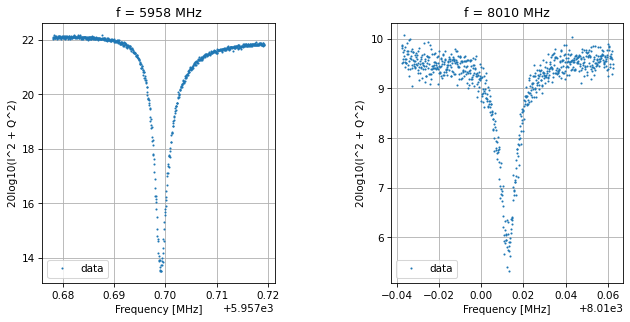

Saving data-2023-09-27-10-52-17
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.341 s


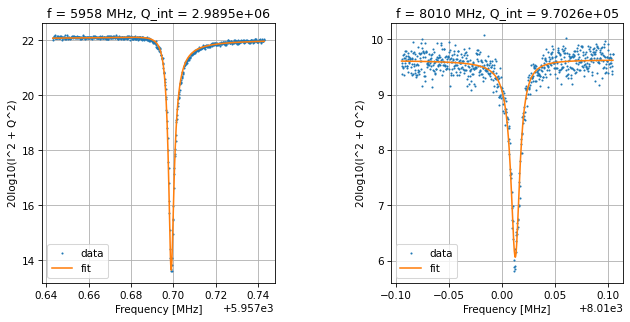

Frequencies out are: [5957.69867698799, 8010.012806724393] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.318 s


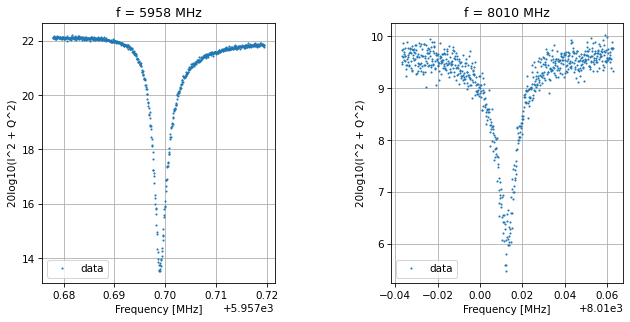

Saving data-2023-09-27-10-52-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.419 s


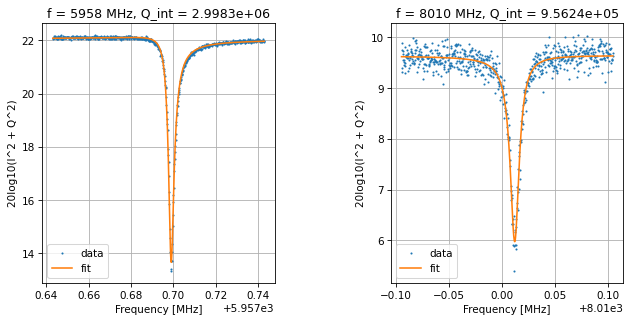

Frequencies out are: [5957.698680140172, 8010.012269478331] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.495 s


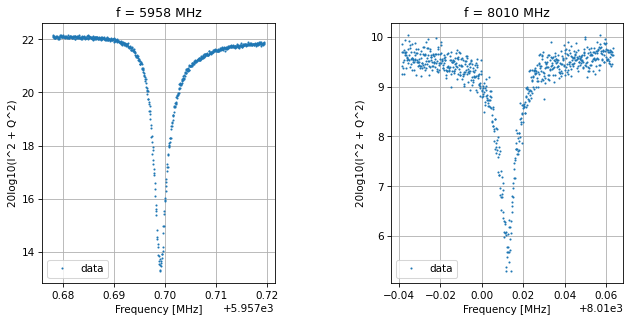

Saving data-2023-09-27-10-53-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.577 s


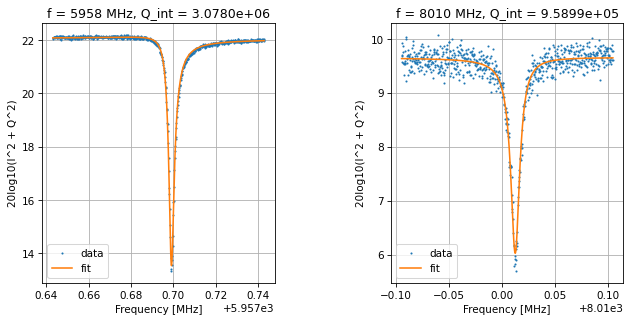

Frequencies out are: [5957.698830435108, 8010.012744862745] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.409 s


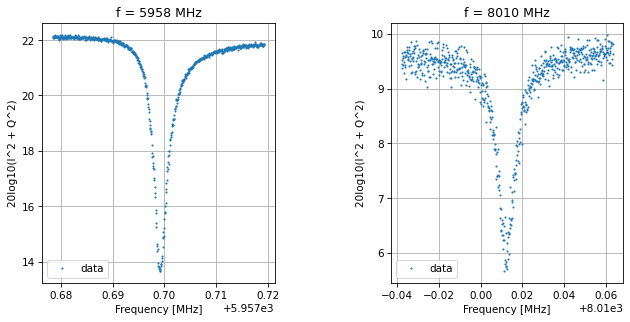

Saving data-2023-09-27-10-53-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.585 s


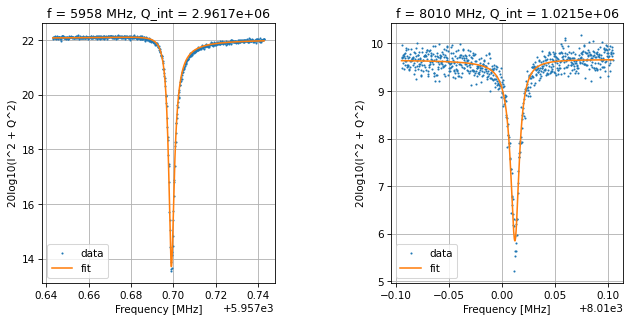

Frequencies out are: [5957.698790121601, 8010.012470429159] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.435 s


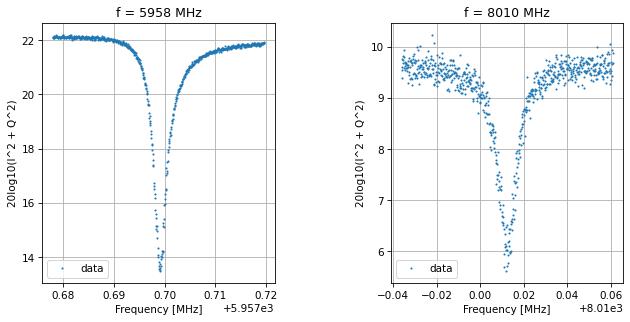

Saving data-2023-09-27-10-54-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.744 s


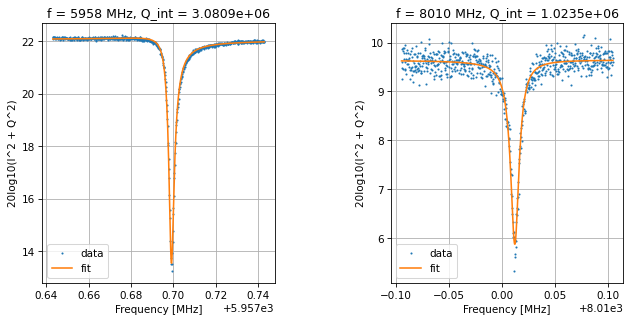

Frequencies out are: [5957.69881281605, 8010.012316535144] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.462 s


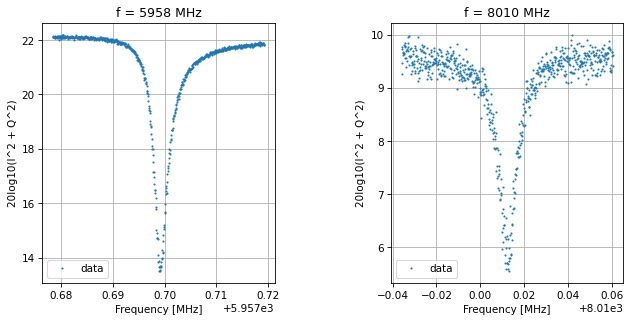

Saving data-2023-09-27-10-55-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.525 s


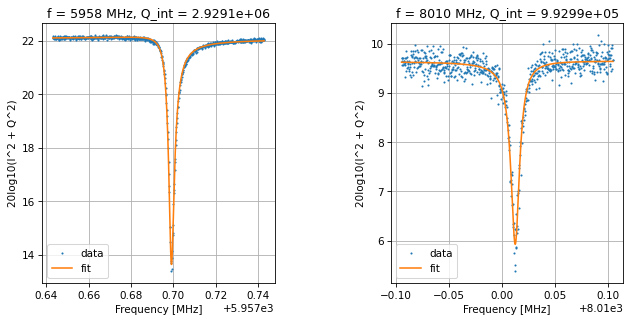

Frequencies out are: [5957.698815121956, 8010.012767028369] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.432 s


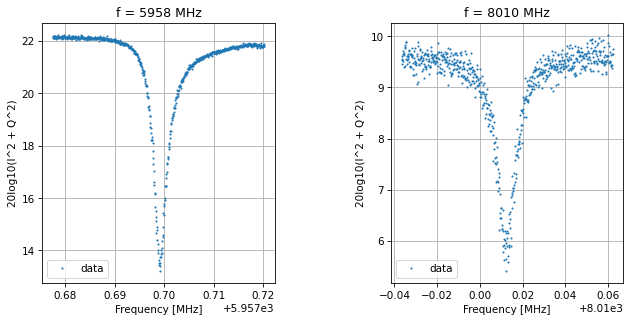

Saving data-2023-09-27-10-55-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.418 s


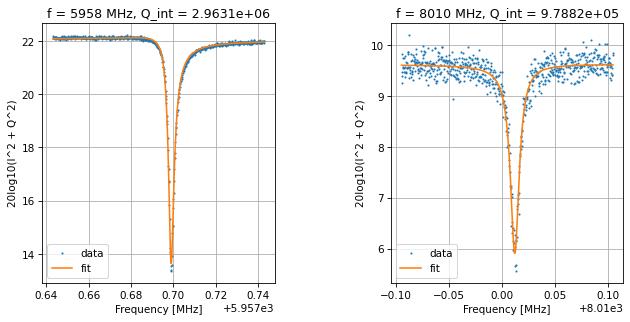

Frequencies out are: [5957.69863548363, 8010.012300380394] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.412 s


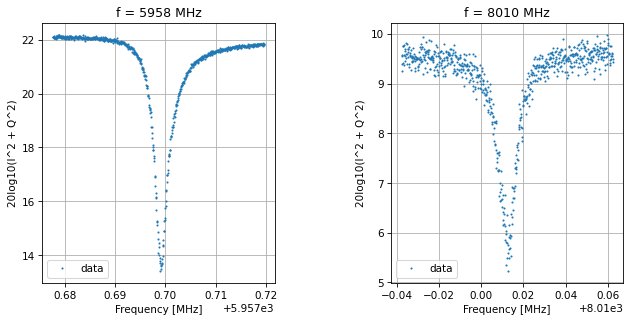

Saving data-2023-09-27-10-56-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.499 s


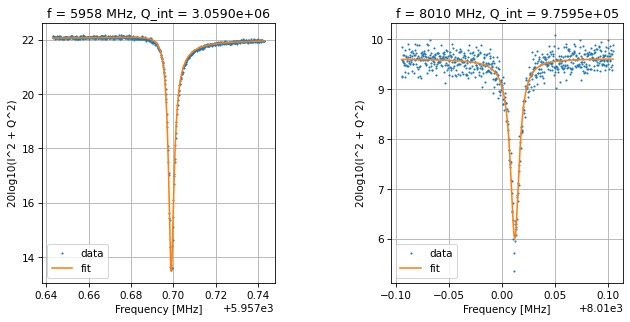

Frequencies out are: [5957.698692540733, 8010.012255178989] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.517 s


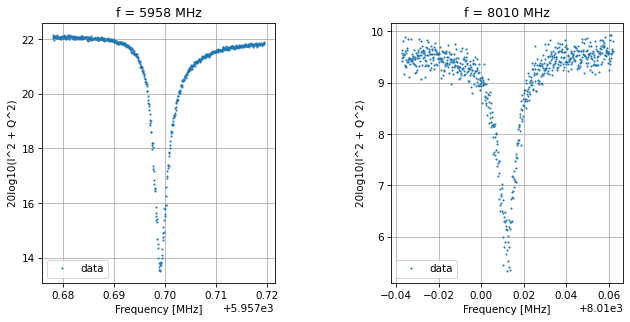

Saving data-2023-09-27-10-56-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.582 s


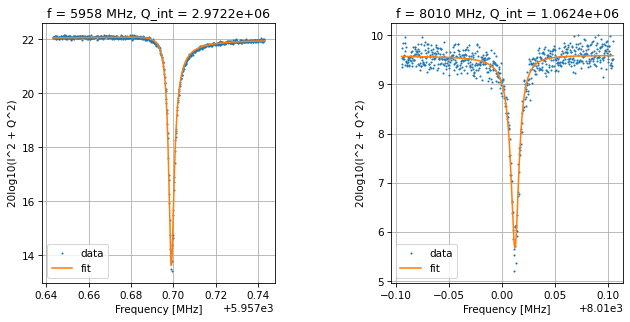

Frequencies out are: [5957.698751160239, 8010.012476720618] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.521 s


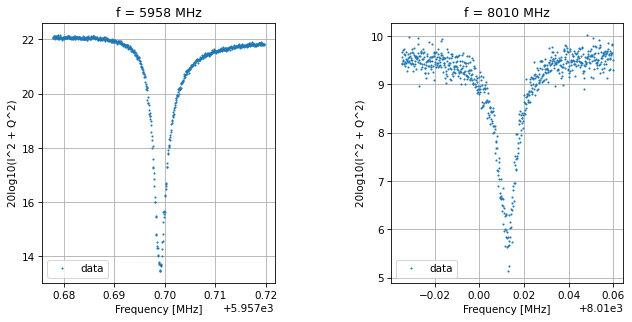

Saving data-2023-09-27-10-57-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.444 s


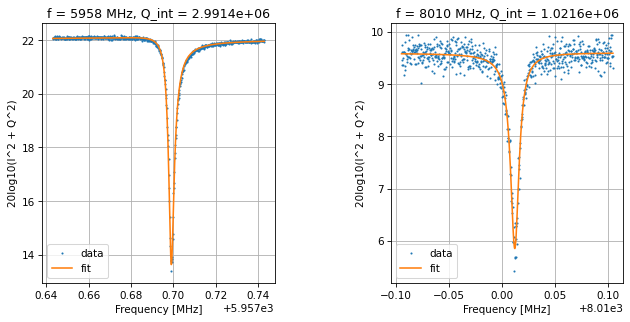

Frequencies out are: [5957.698770033155, 8010.012297198605] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.313 s


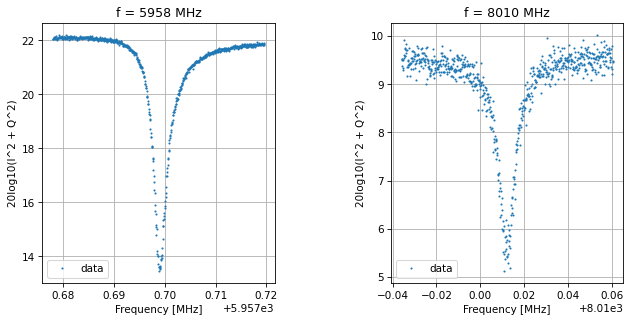

Saving data-2023-09-27-10-57-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.431 s


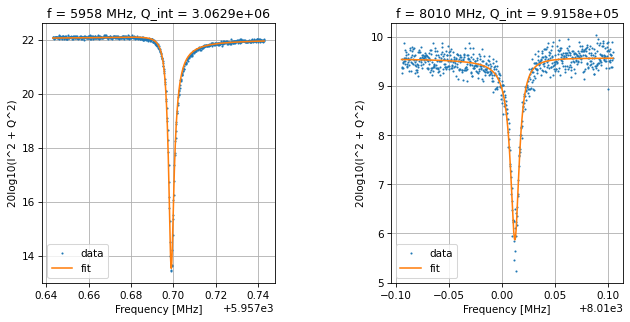

Frequencies out are: [5957.698711160676, 8010.012532434235] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


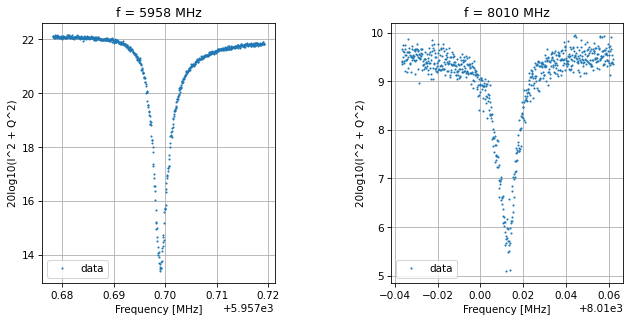

Saving data-2023-09-27-10-58-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.442 s


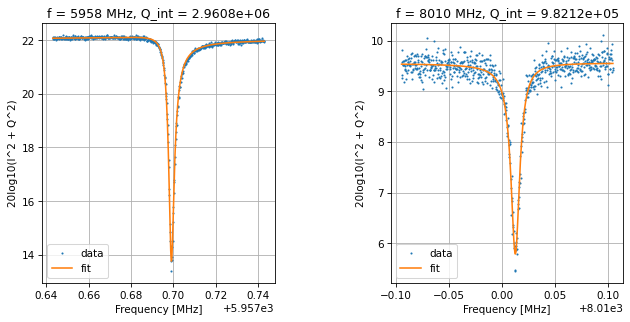

Frequencies out are: [5957.6987822529745, 8010.012851951847] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


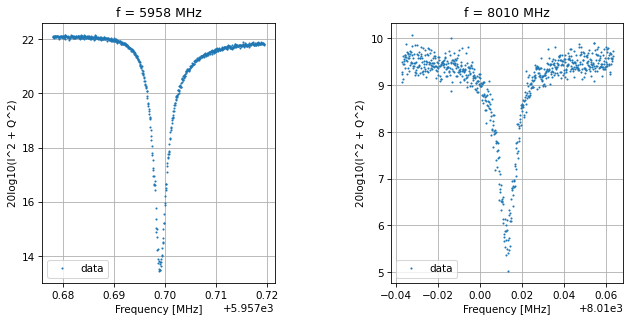

Saving data-2023-09-27-10-58-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.334 s


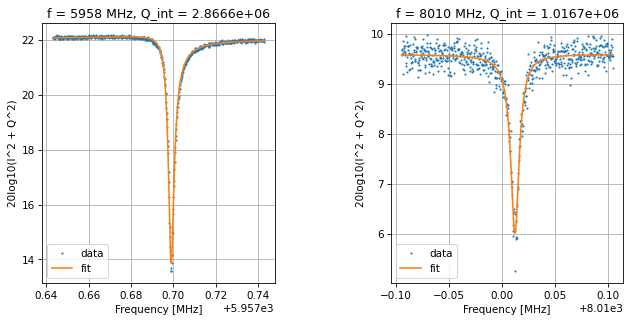

Frequencies out are: [5957.698672656204, 8010.012446372994] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.338 s


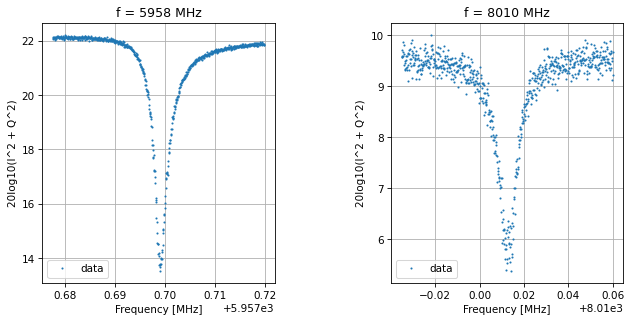

Saving data-2023-09-27-10-59-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.509 s


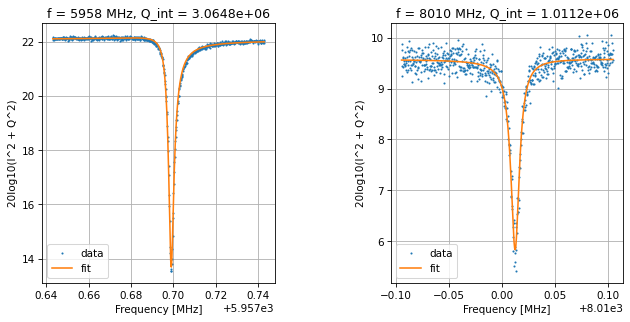

Frequencies out are: [5957.698693205235, 8010.012613024036] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.535 s


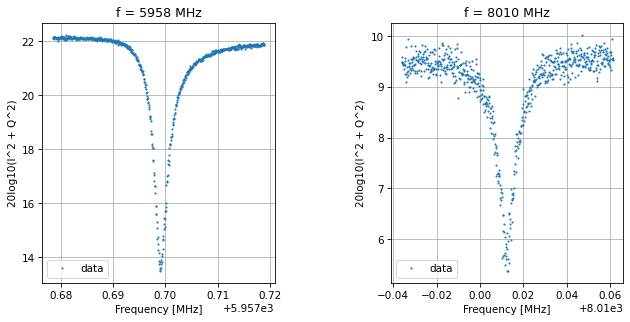

Saving data-2023-09-27-10-59-56
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.567 s


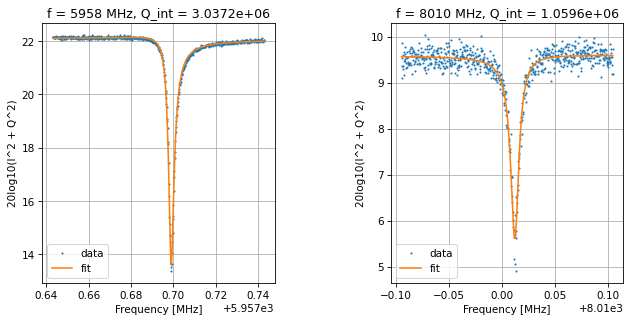

Frequencies out are: [5957.698714178326, 8010.012435858081] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.447 s


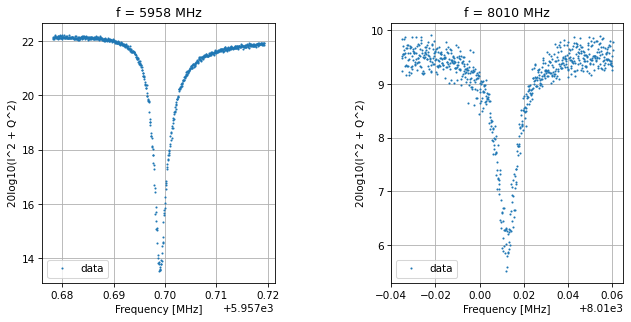

Saving data-2023-09-27-11-00-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 16.016 s


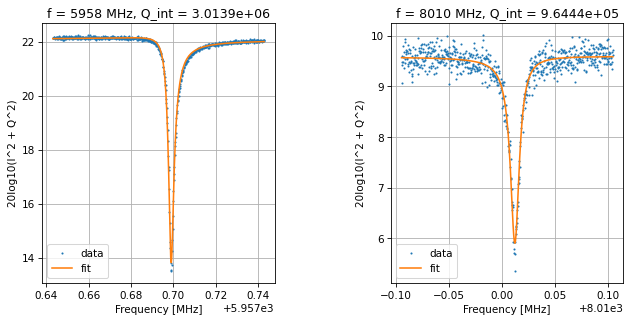

Frequencies out are: [5957.698676249953, 8010.012456289999] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.480 s


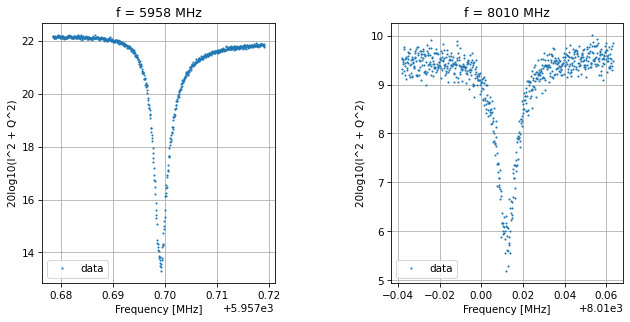

Saving data-2023-09-27-11-01-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


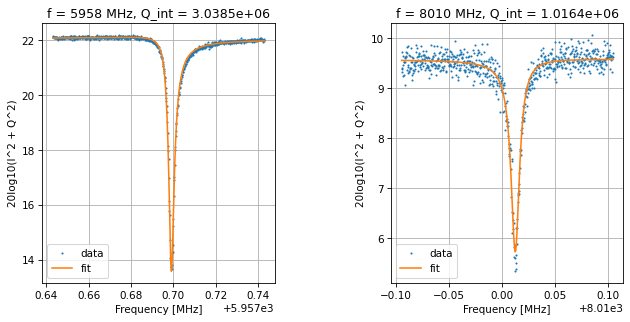

Frequencies out are: [5957.698796311031, 8010.012854318937] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


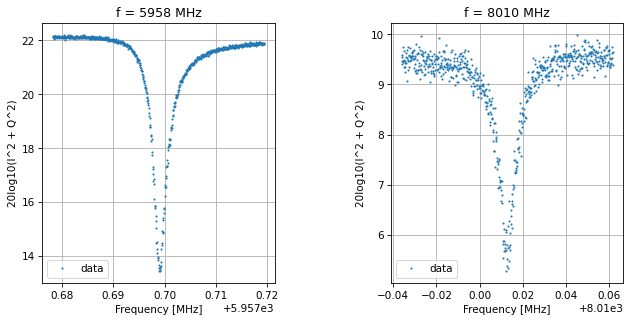

Saving data-2023-09-27-11-01-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.622 s


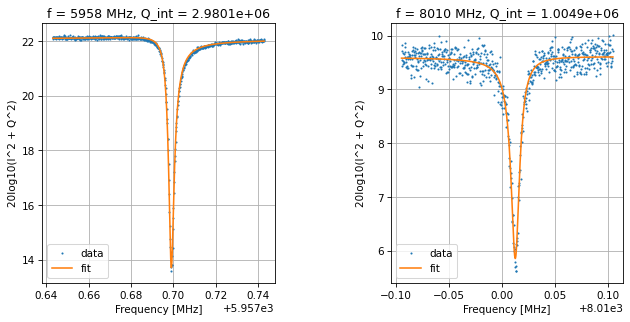

Frequencies out are: [5957.6987733734395, 8010.012882786346] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.573 s


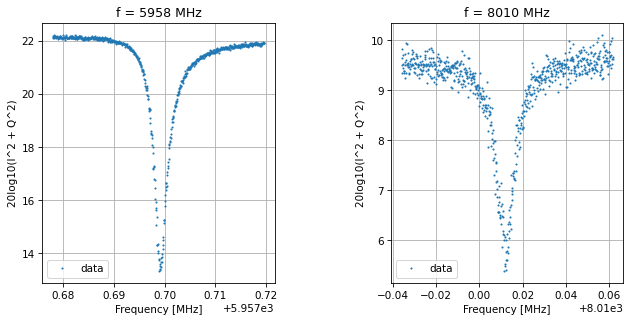

Saving data-2023-09-27-11-02-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.492 s


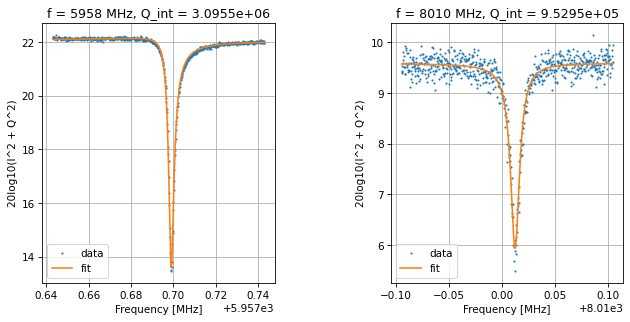

Frequencies out are: [5957.698705674634, 8010.01252563106] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.643 s


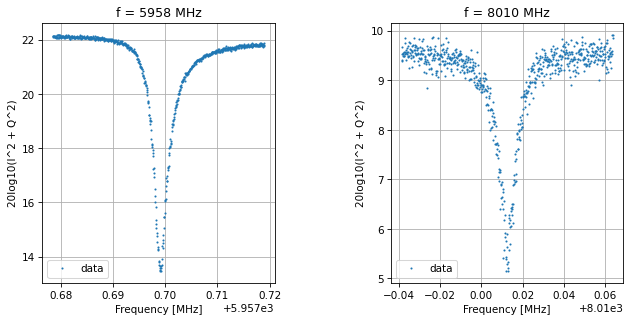

Saving data-2023-09-27-11-02-42
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.563 s


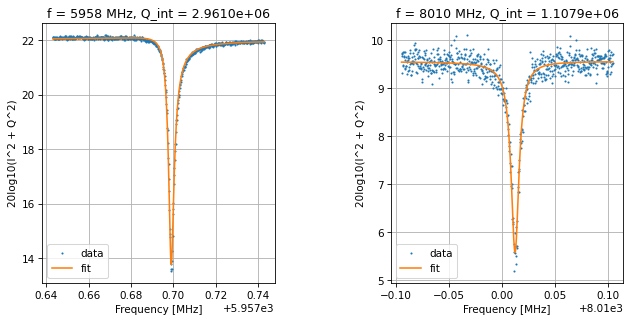

Frequencies out are: [5957.6987111940925, 8010.012515206498] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.565 s


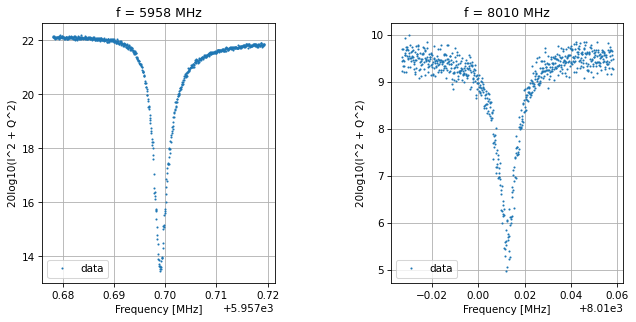

Saving data-2023-09-27-11-03-15
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.561 s


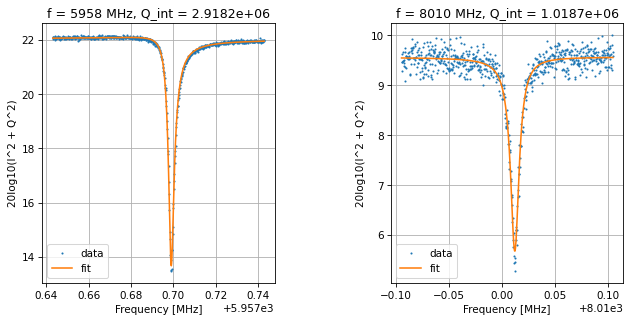

Frequencies out are: [5957.69871186566, 8010.0123029174965] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


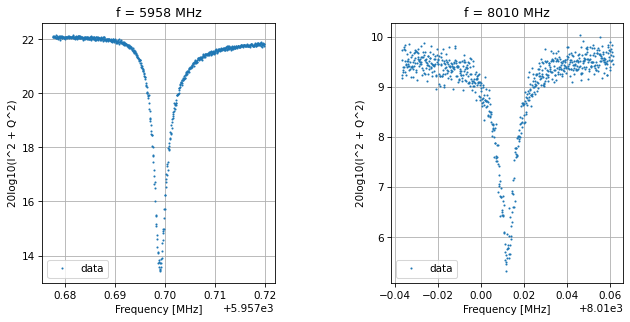

Saving data-2023-09-27-11-03-48
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.527 s


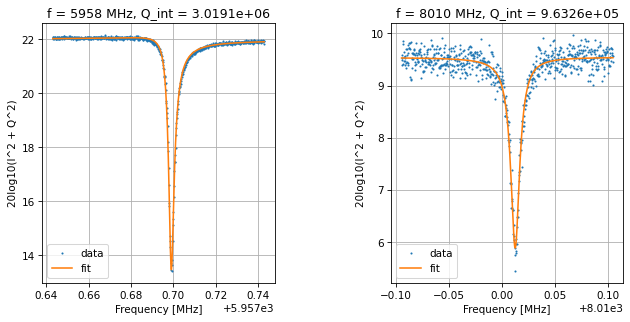

Frequencies out are: [5957.698730577758, 8010.012614653607] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.432 s


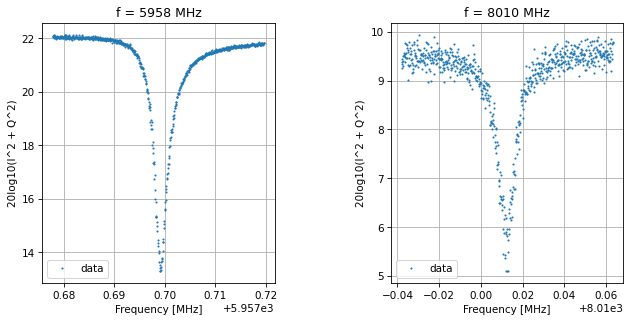

Saving data-2023-09-27-11-04-21
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.557 s


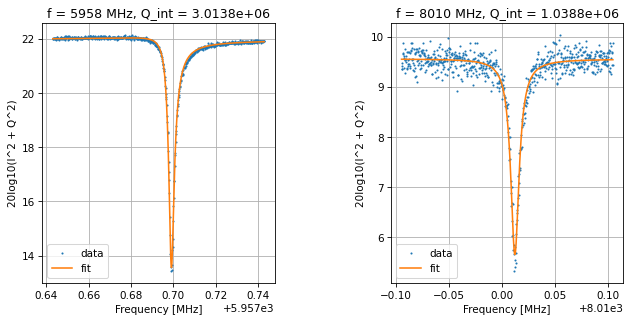

Frequencies out are: [5957.698797852285, 8010.012189422247] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


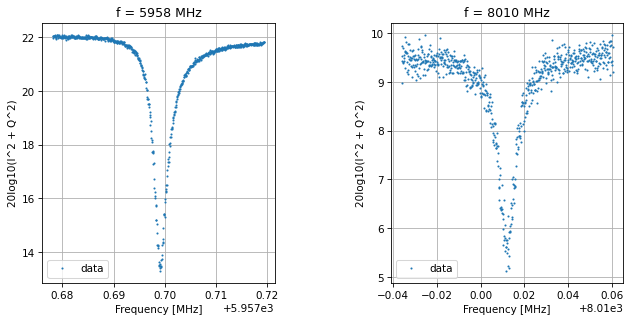

Saving data-2023-09-27-11-04-53
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.550 s


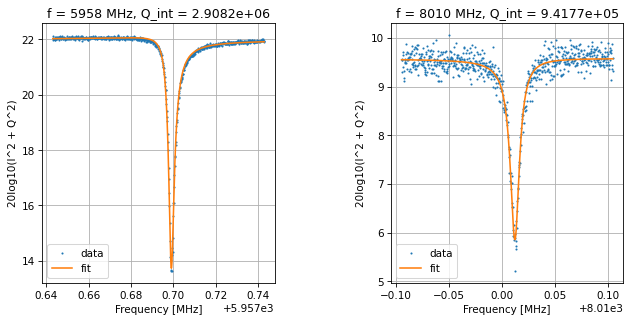

Frequencies out are: [5957.698757610226, 8010.012471455316] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.519 s


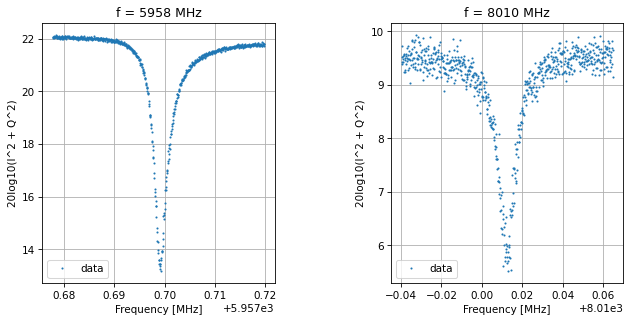

Saving data-2023-09-27-11-05-26
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.511 s


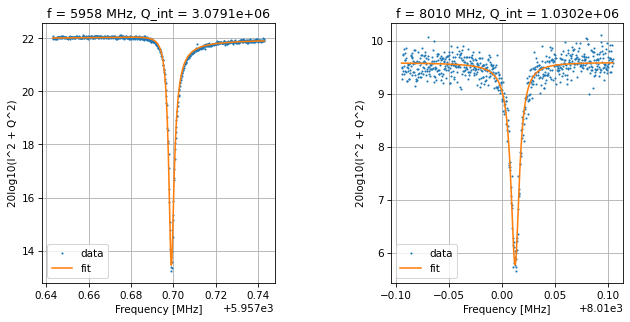

Frequencies out are: [5957.698753046295, 8010.012532546116] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.413 s


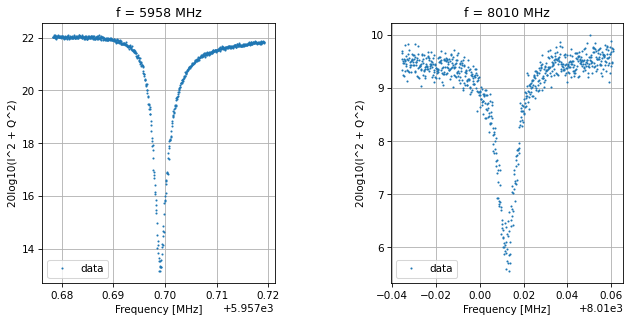

Saving data-2023-09-27-11-05-59
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.278 s


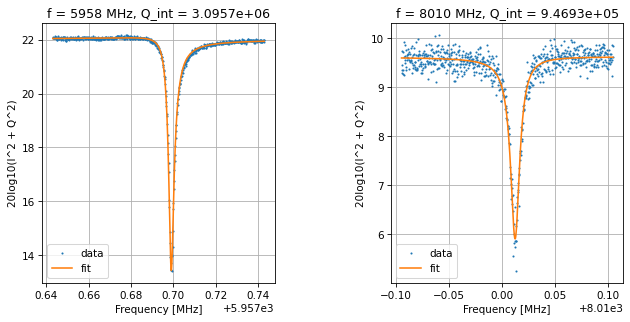

Frequencies out are: [5957.698751166307, 8010.012658049] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.414 s


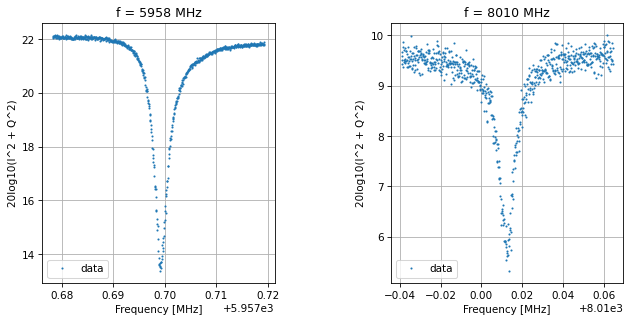

Saving data-2023-09-27-11-06-32
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.481 s


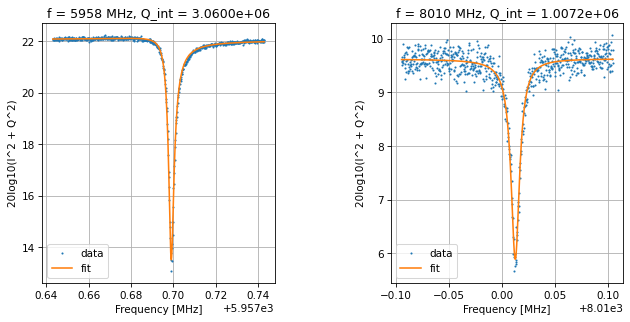

Frequencies out are: [5957.698737794633, 8010.012720138079] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.539 s


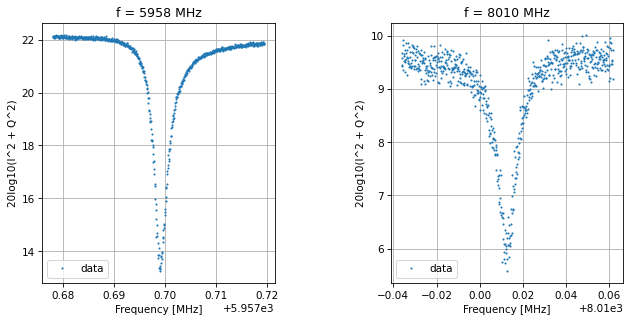

Saving data-2023-09-27-11-07-05
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.413 s


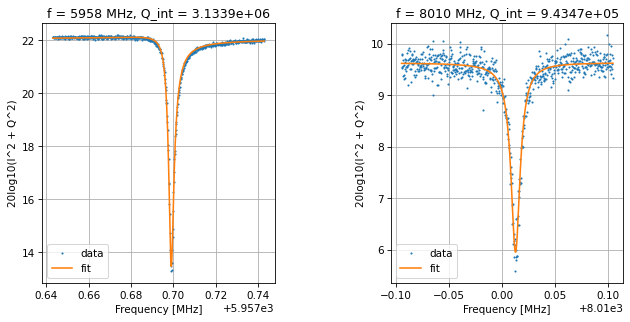

Frequencies out are: [5957.698721550863, 8010.012922549949] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.357 s


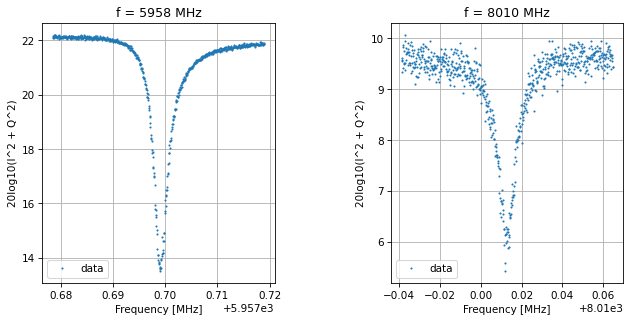

Saving data-2023-09-27-11-07-37
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.564 s


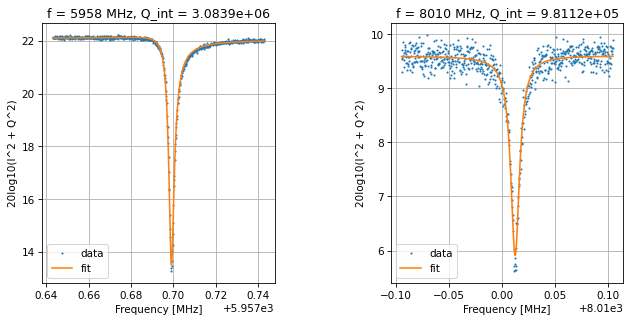

Frequencies out are: [5957.698802753077, 8010.012572964903] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.660 s


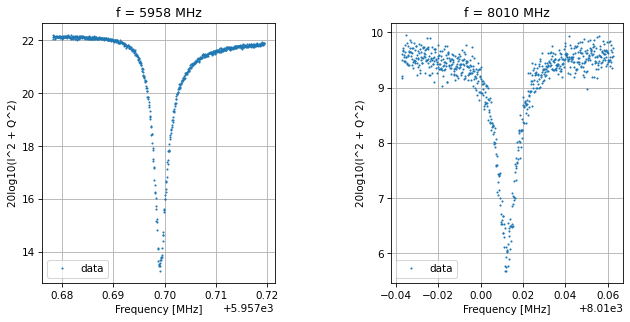

Saving data-2023-09-27-11-08-10
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


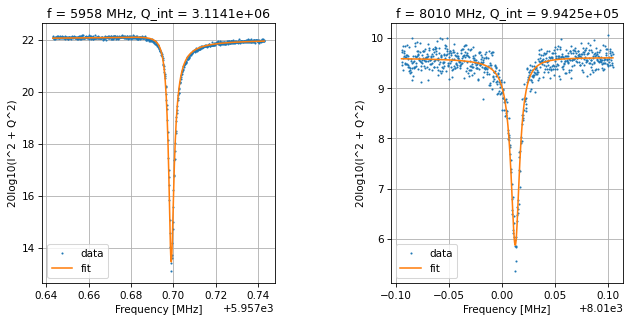

Frequencies out are: [5957.698691131725, 8010.012816051797] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.517 s


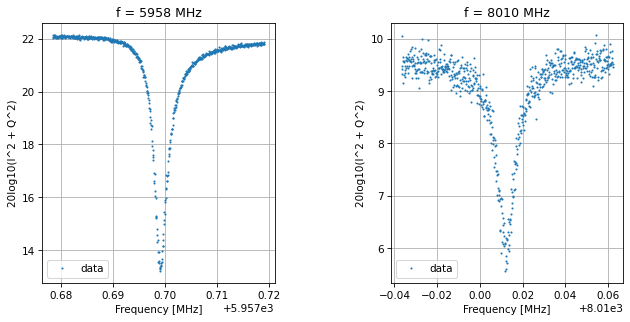

Saving data-2023-09-27-11-08-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


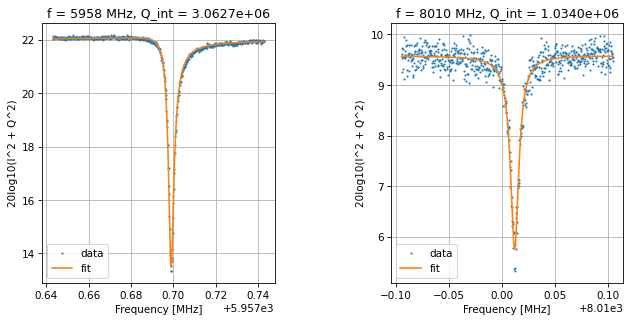

Frequencies out are: [5957.698641838006, 8010.012089701949] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.392 s


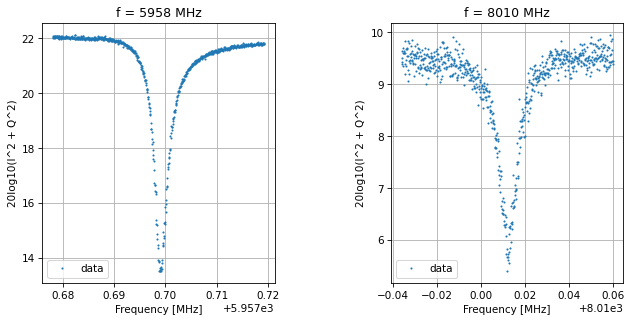

Saving data-2023-09-27-11-09-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.577 s


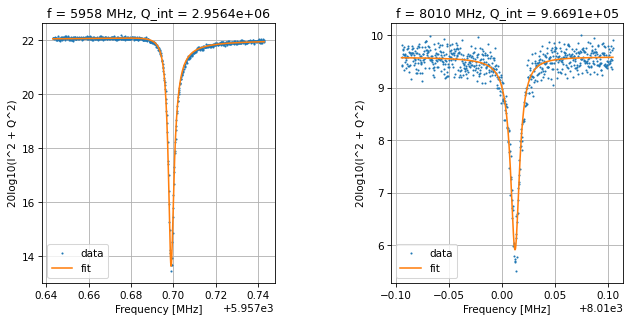

Frequencies out are: [5957.698642238088, 8010.0125120070425] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.336 s


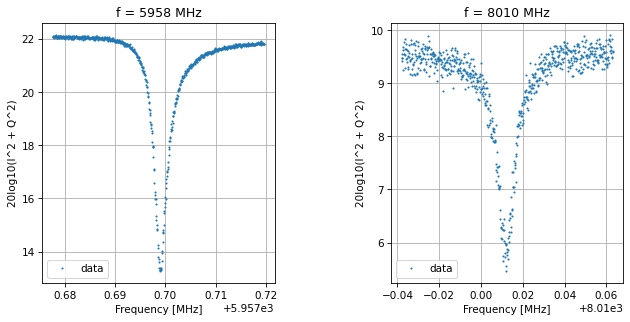

Saving data-2023-09-27-11-09-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.490 s


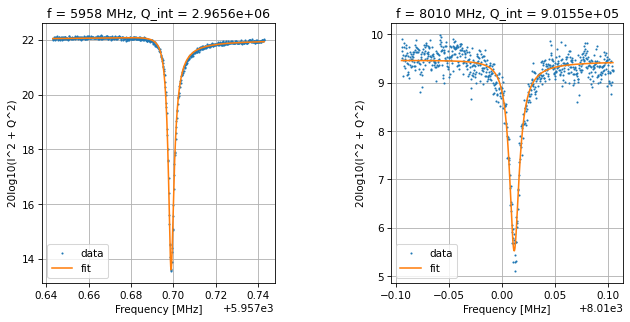

Frequencies out are: [5957.698619419237, 8010.011238974702] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.545 s


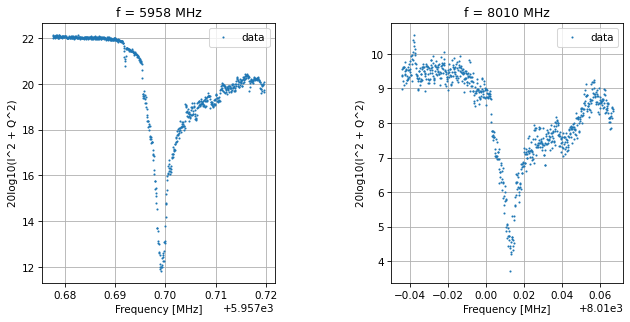

Saving data-2023-09-27-11-10-21
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.322 s


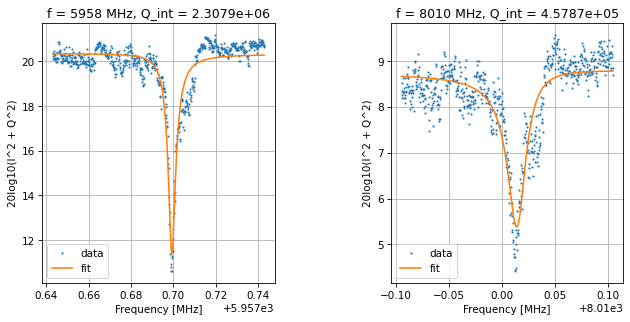

Frequencies out are: [5957.699211438289, 8010.015361993609] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.411 s


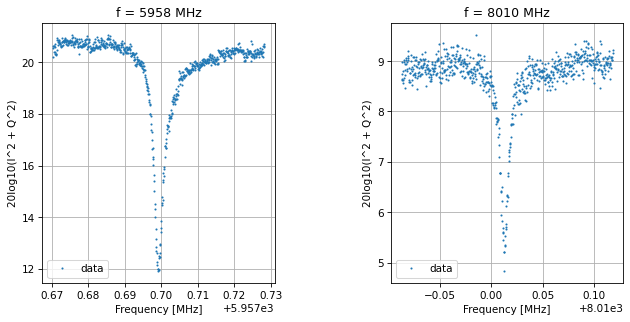

Saving data-2023-09-27-11-10-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.444 s


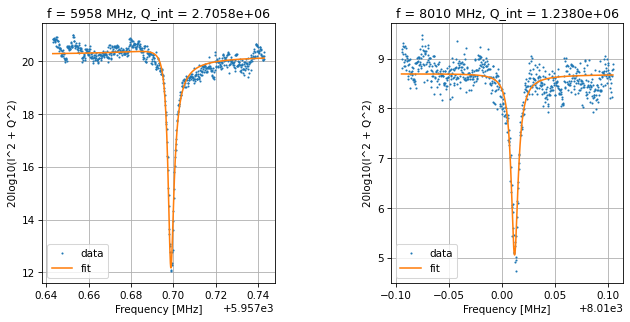

Frequencies out are: [5957.698344938228, 8010.011778997149] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.456 s


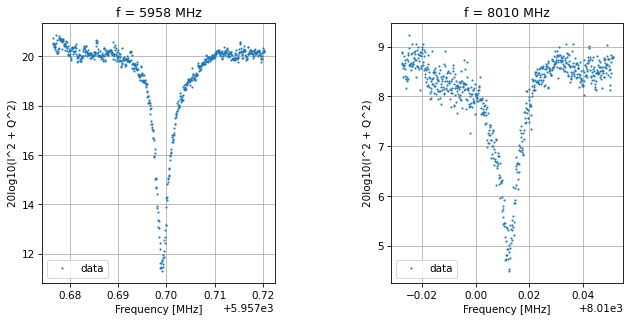

Saving data-2023-09-27-11-11-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.523 s


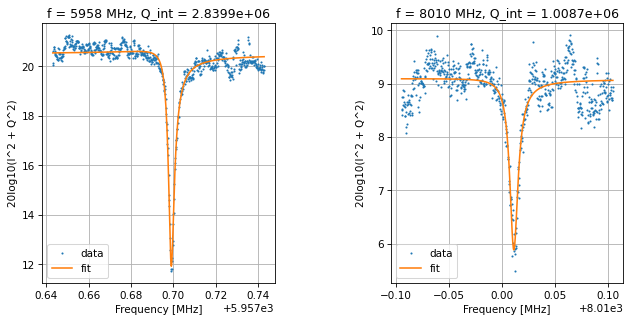

Frequencies out are: [5957.698605951809, 8010.0109689564215] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


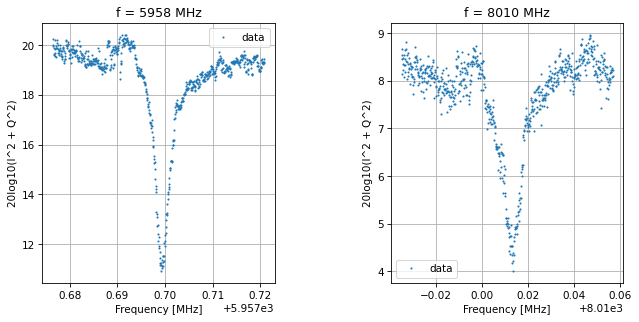

Saving data-2023-09-27-11-12-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.608 s


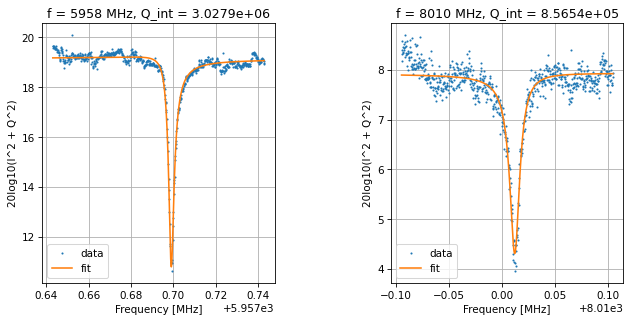

Frequencies out are: [5957.698728012455, 8010.012427033638] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.379 s


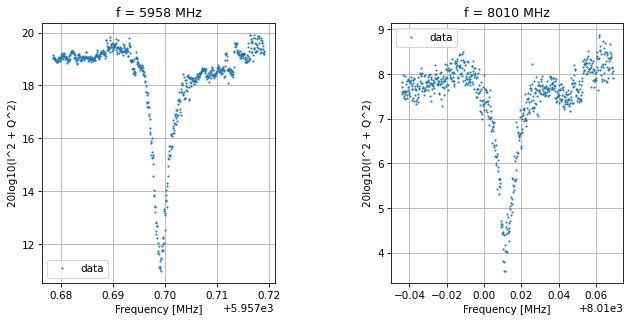

Saving data-2023-09-27-11-12-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.376 s


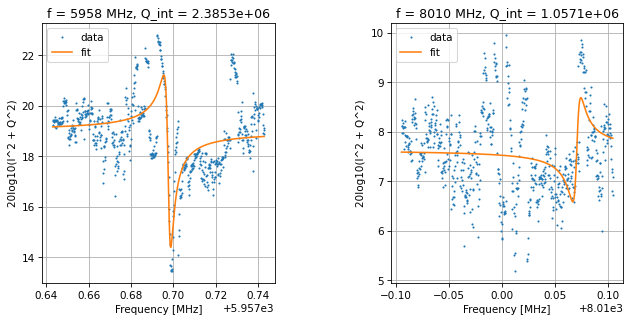

Frequencies out are: [5957.697146237958, 8010.071307528392] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.559 s


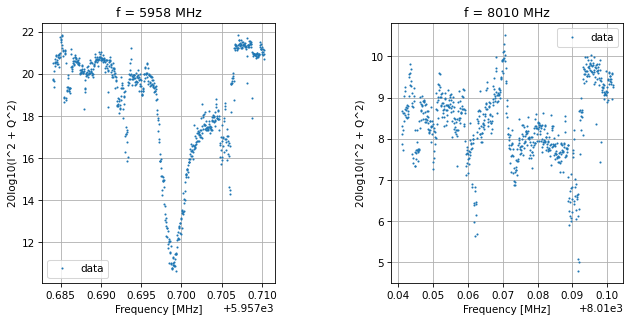

Saving data-2023-09-27-11-13-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.965 s


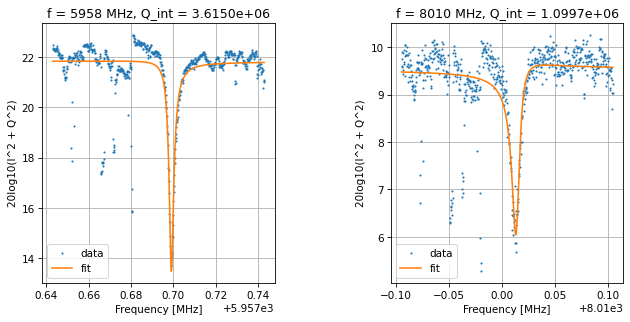

Frequencies out are: [5957.698964807944, 8010.014178307278] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


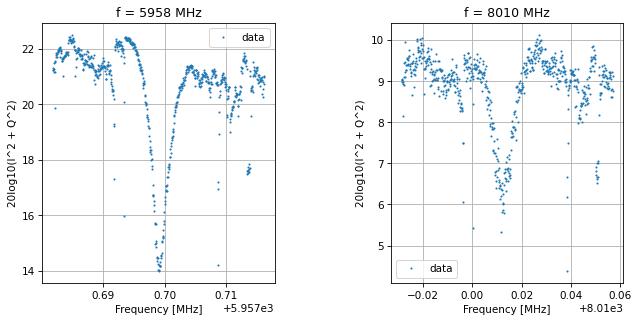

Saving data-2023-09-27-11-13-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.458 s


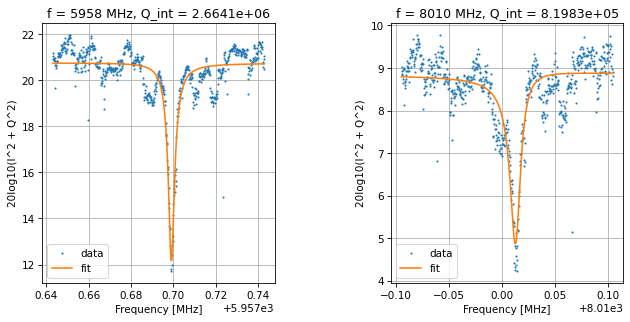

Frequencies out are: [5957.699031272368, 8010.013549637161] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.486 s


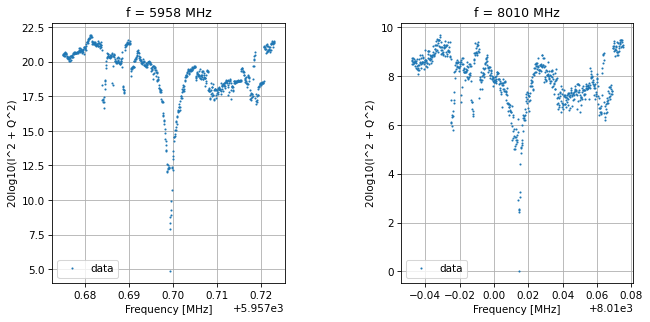

Saving data-2023-09-27-11-14-13
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.369 s


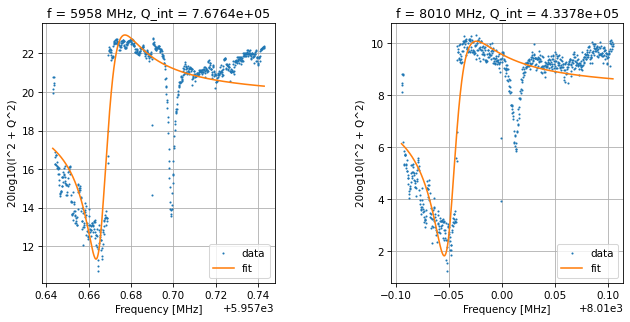

Frequencies out are: [5957.671460274132, 8009.958597835565] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.579 s


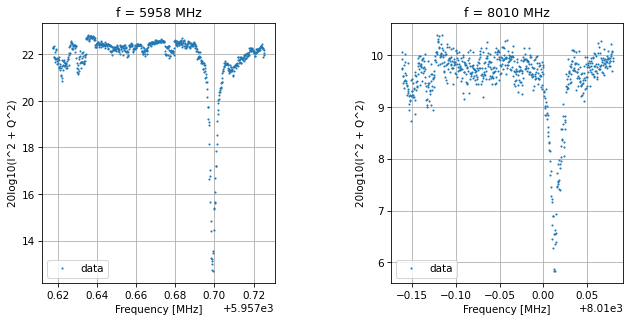

Saving data-2023-09-27-11-14-46
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.395 s


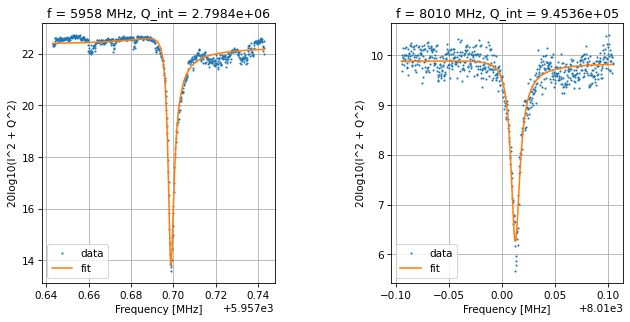

Frequencies out are: [5957.698159152115, 8010.012012256339] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.318 s


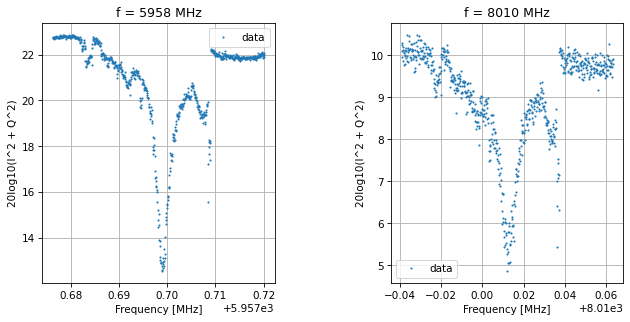

Saving data-2023-09-27-11-15-19
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.344 s


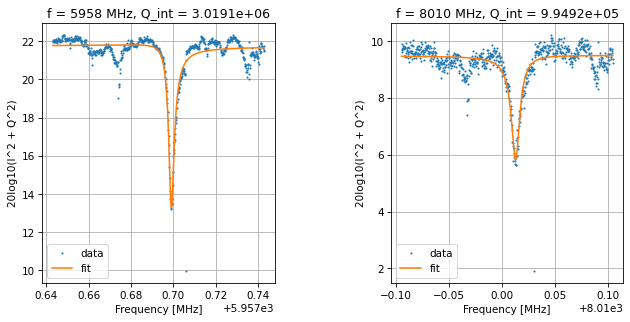

Frequencies out are: [5957.698767739586, 8010.01321823938] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.442 s


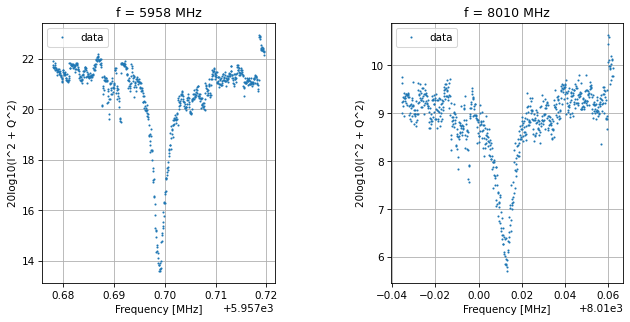

Saving data-2023-09-27-11-15-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


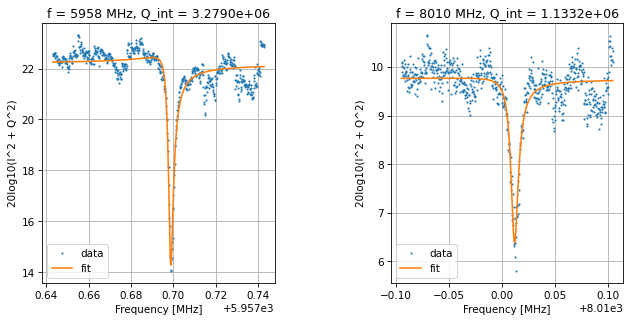

Frequencies out are: [5957.698286267695, 8010.011493892359] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.497 s


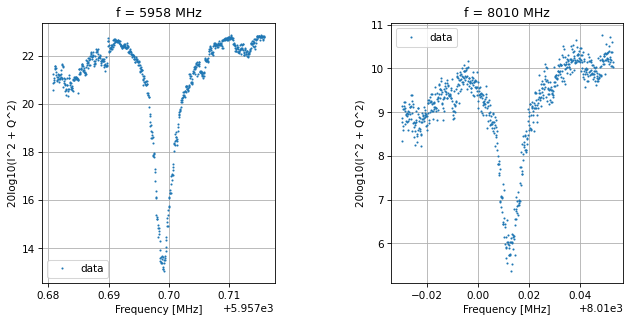

Saving data-2023-09-27-11-16-25
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.522 s


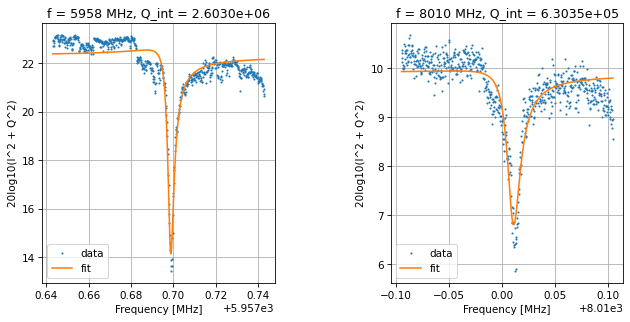

Frequencies out are: [5957.698133192735, 8010.009678526244] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.531 s


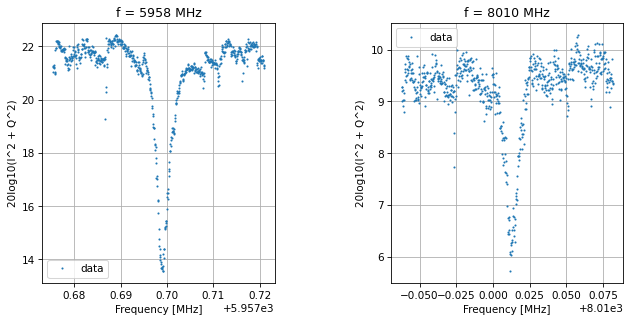

Saving data-2023-09-27-11-16-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.449 s


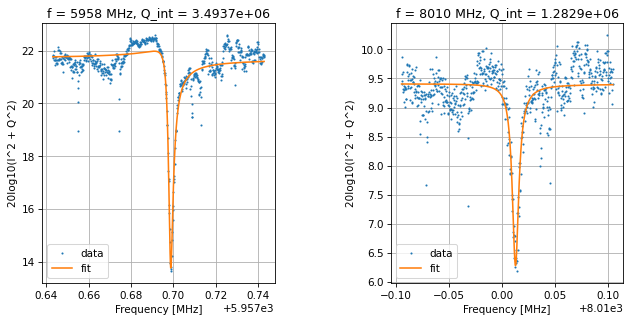

Frequencies out are: [5957.698268725615, 8010.012720139883] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.463 s


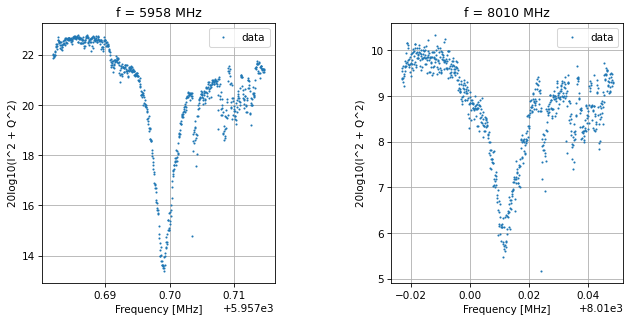

Saving data-2023-09-27-11-17-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.449 s


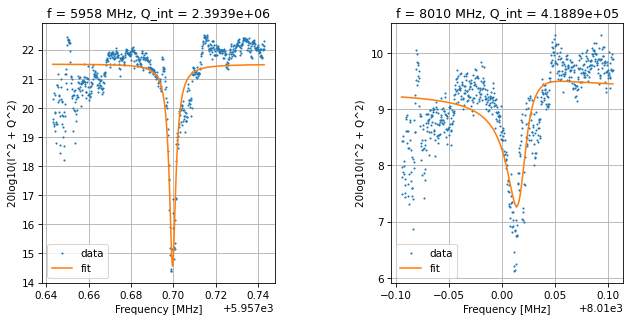

Frequencies out are: [5957.699644643607, 8010.017611781605] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.624 s


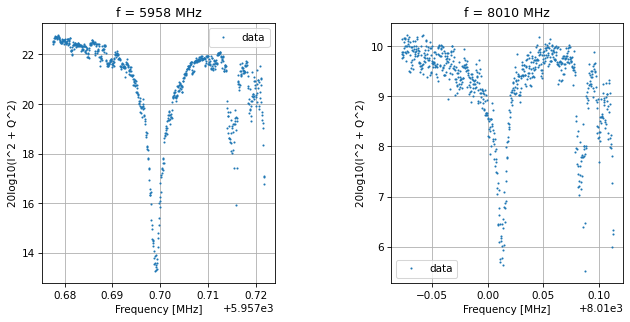

Saving data-2023-09-27-11-18-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.512 s


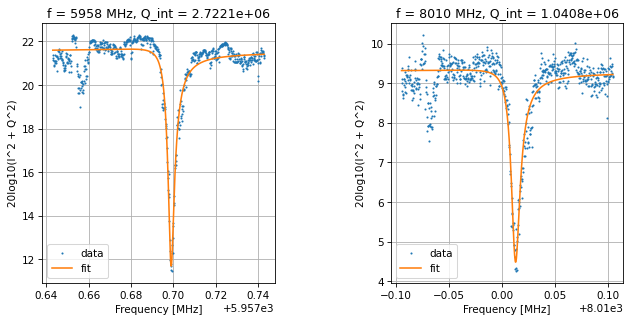

Frequencies out are: [5957.698452538341, 8010.012136943739] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.523 s


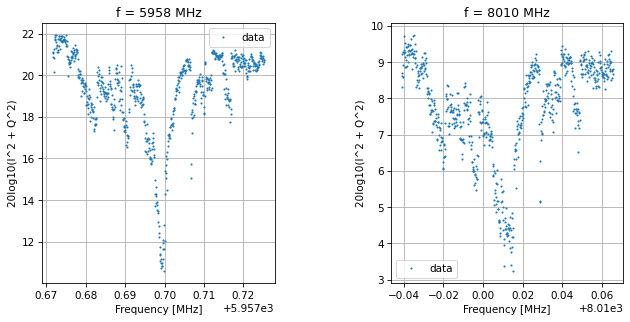

Saving data-2023-09-27-11-18-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.553 s


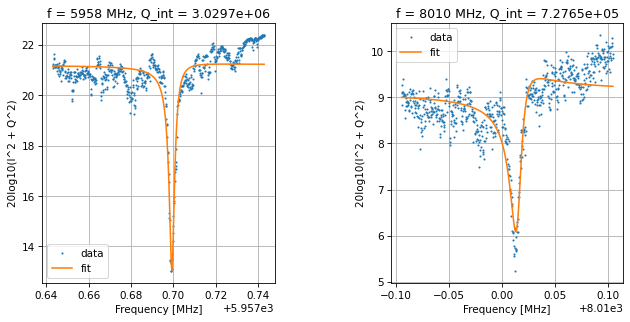

Frequencies out are: [5957.6995887375315, 8010.015905665842] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.420 s


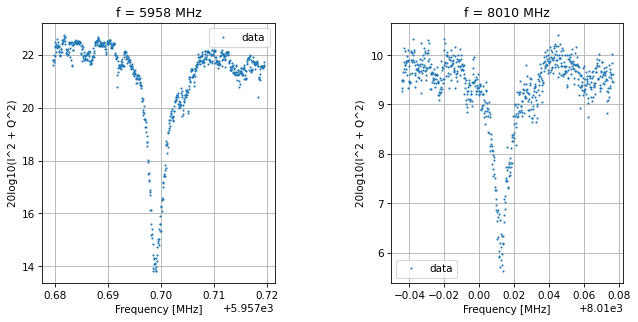

Saving data-2023-09-27-11-19-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.492 s


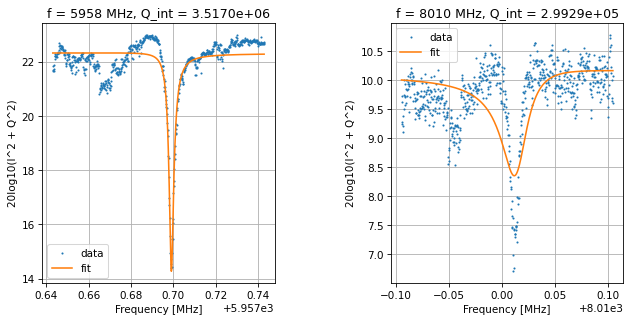

Frequencies out are: [5957.698985640652, 8010.014729826547] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 16.046 s


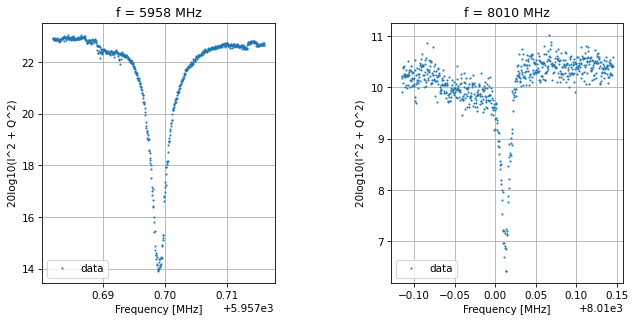

Saving data-2023-09-27-11-19-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.587 s


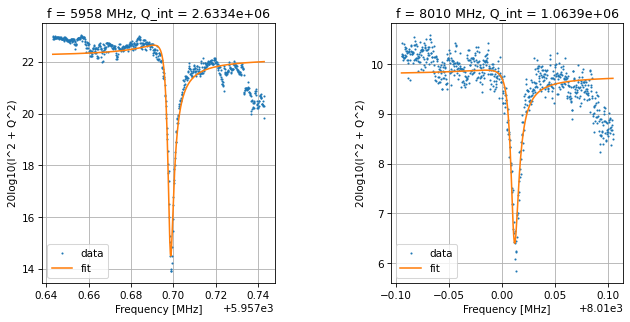

Frequencies out are: [5957.697854064407, 8010.010961811346] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


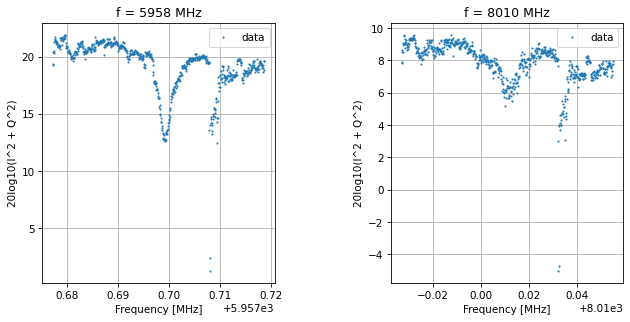

Saving data-2023-09-27-11-20-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.461 s


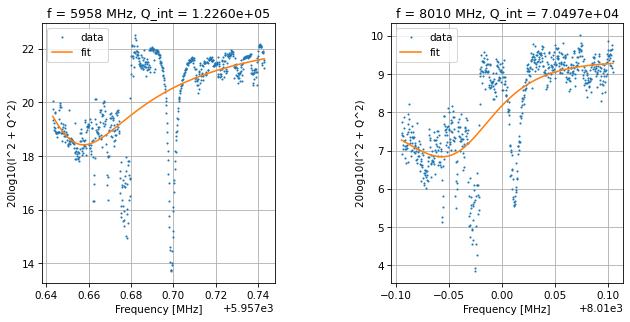

Frequencies out are: [5957.636233853158, 8009.969275511023] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.412 s


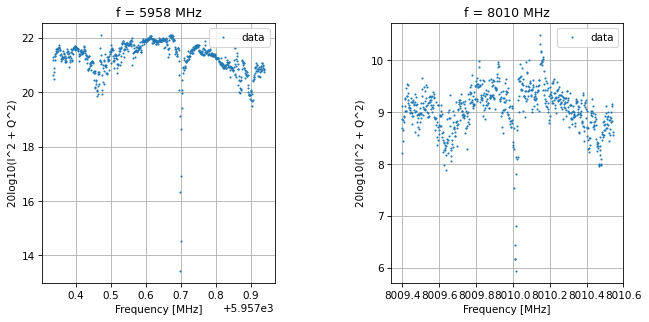

Saving data-2023-09-27-11-20-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.560 s


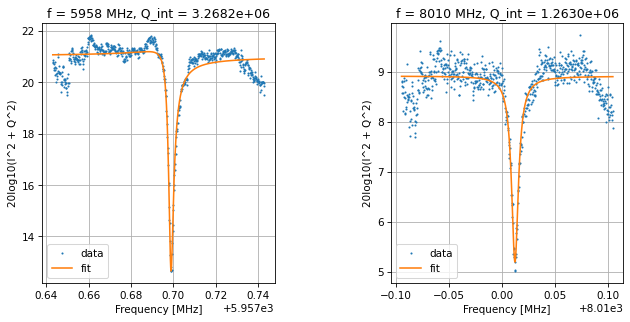

Frequencies out are: [5957.698450174154, 8010.012289923943] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


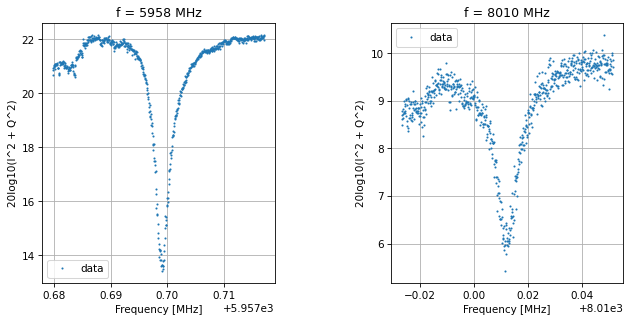

Saving data-2023-09-27-11-21-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.513 s


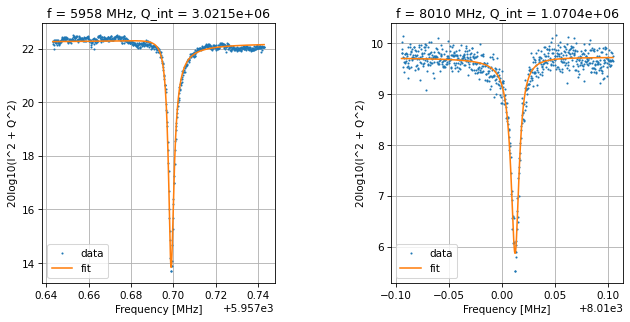

Frequencies out are: [5957.6986510835695, 8010.012635347404] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


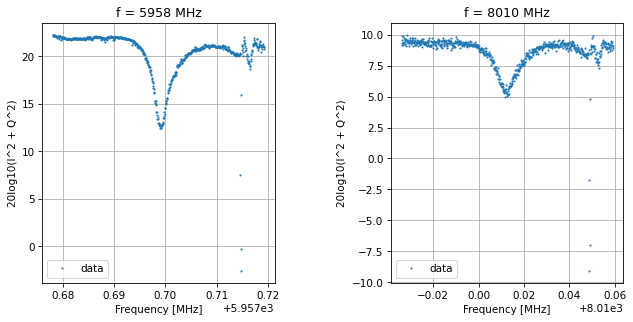

Saving data-2023-09-27-11-21-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.426 s


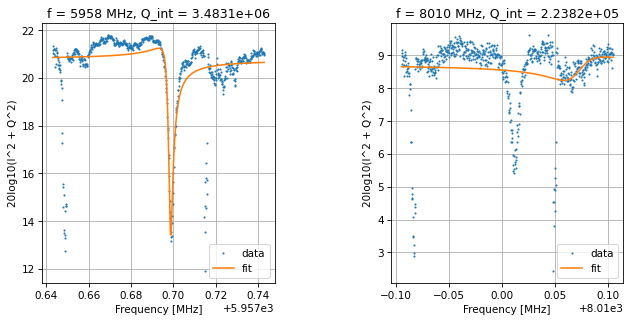

Frequencies out are: [5957.6980914753385, 8010.071610138346] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


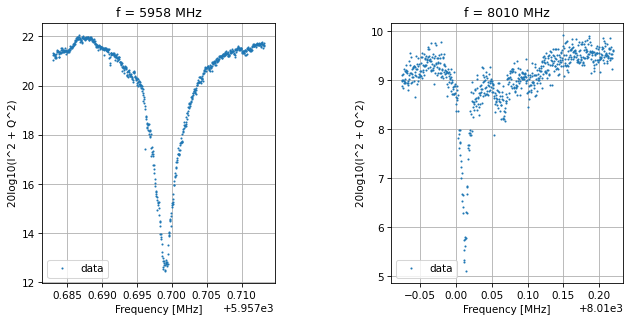

Saving data-2023-09-27-11-22-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.445 s


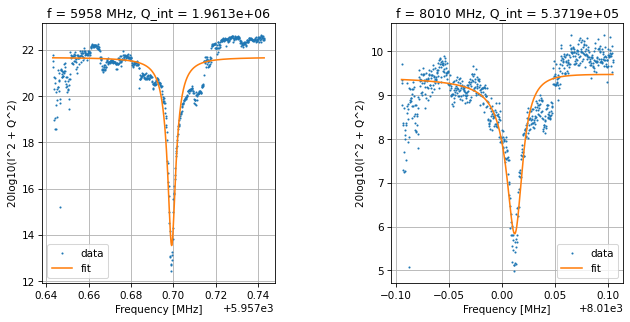

Frequencies out are: [5957.699273864354, 8010.013352575781] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.455 s


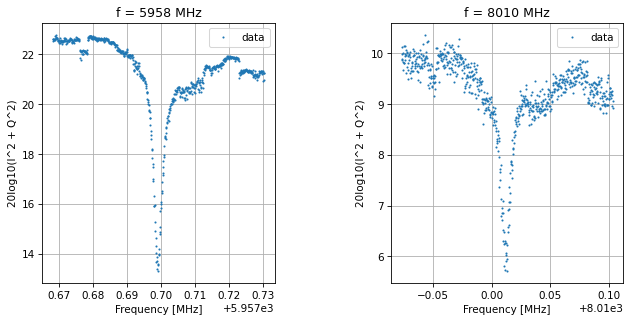

Saving data-2023-09-27-11-23-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.329 s


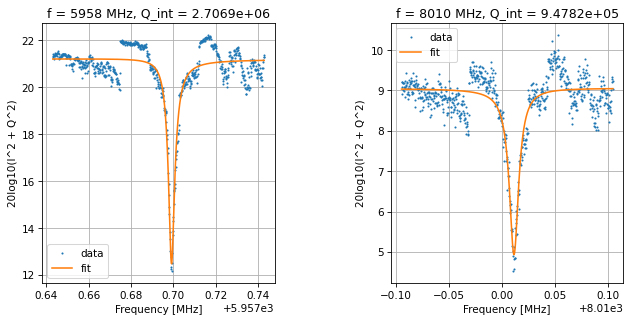

Frequencies out are: [5957.69901873098, 8010.0115477658055] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.460 s


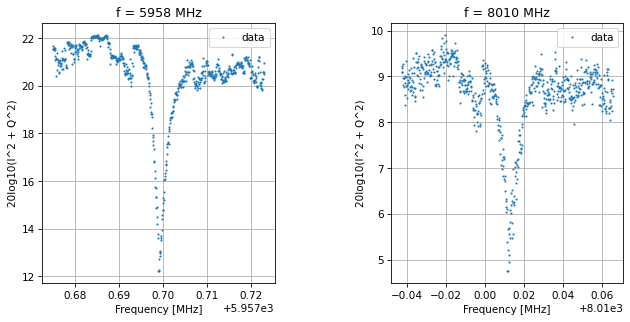

Saving data-2023-09-27-11-23-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.385 s


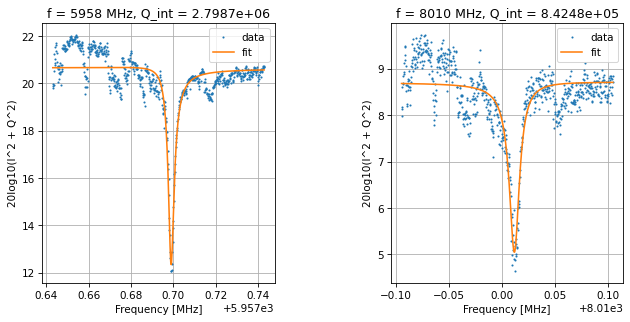

Frequencies out are: [5957.698717772949, 8010.012050957463] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.562 s


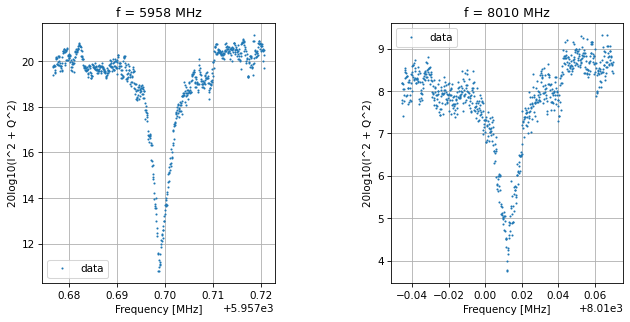

Saving data-2023-09-27-11-24-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.454 s


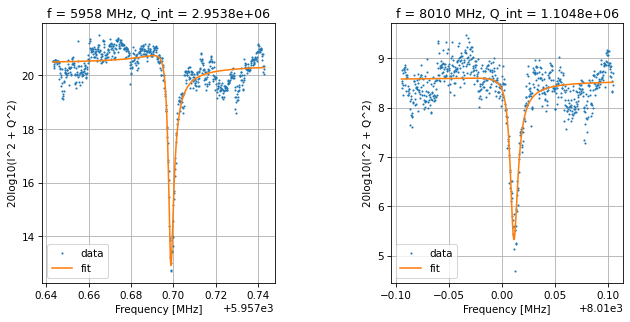

Frequencies out are: [5957.69821019535, 8010.010694658304] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.472 s


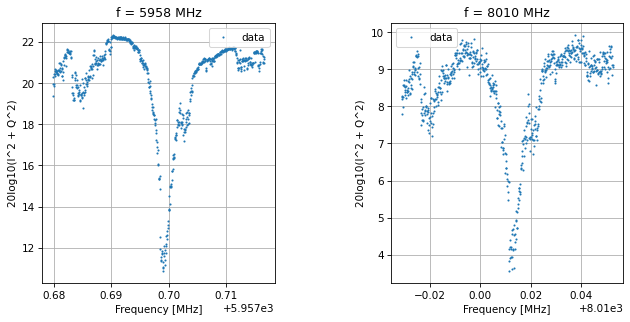

Saving data-2023-09-27-11-24-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.480 s


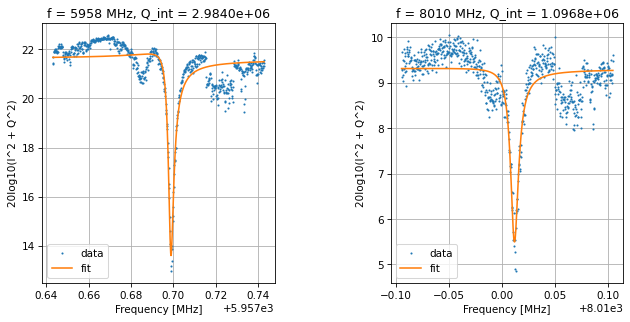

Frequencies out are: [5957.698365599428, 8010.011498026541] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.613 s


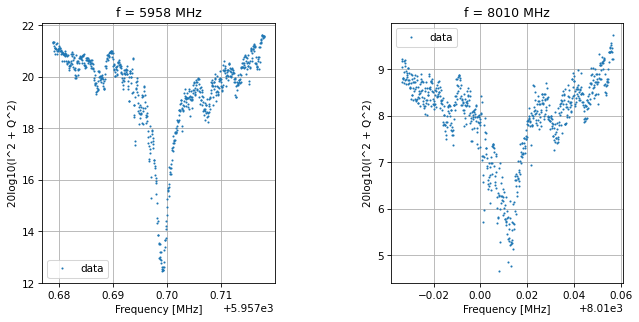

Saving data-2023-09-27-11-25-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.381 s


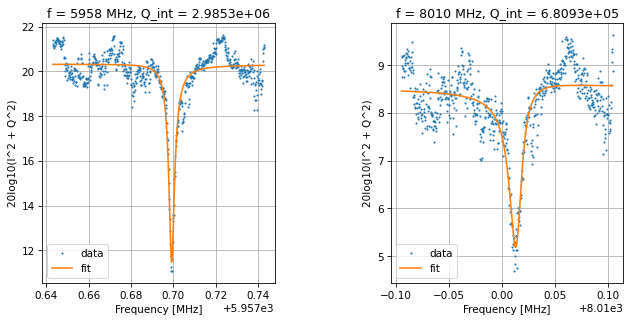

Frequencies out are: [5957.6991021320955, 8010.014257197505] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.436 s


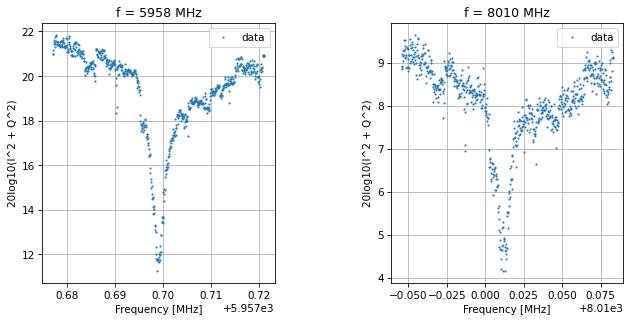

Saving data-2023-09-27-11-25-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


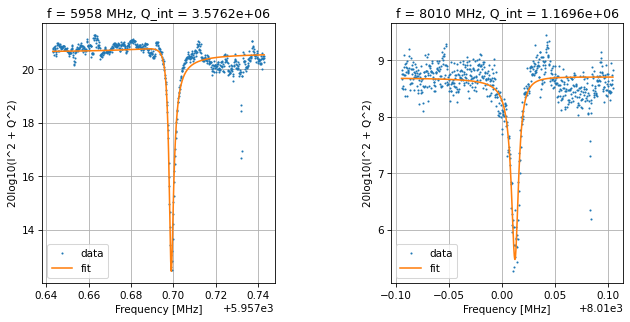

Frequencies out are: [5957.698644449723, 8010.01258562151] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.489 s


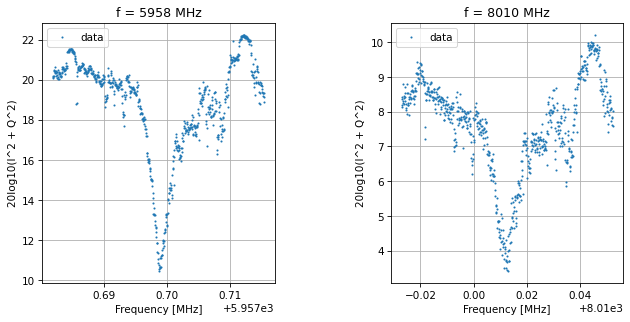

Saving data-2023-09-27-11-26-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.424 s


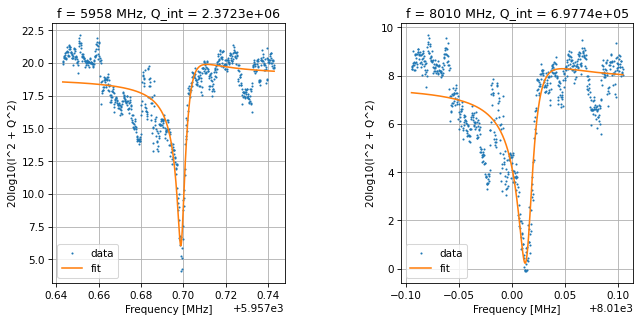

Frequencies out are: [5957.701358964628, 8010.017906390729] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.523 s


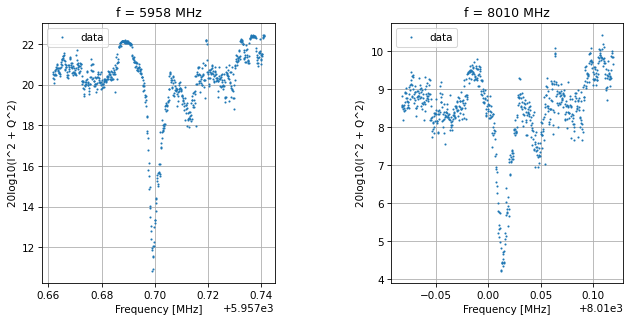

Saving data-2023-09-27-11-26-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.448 s


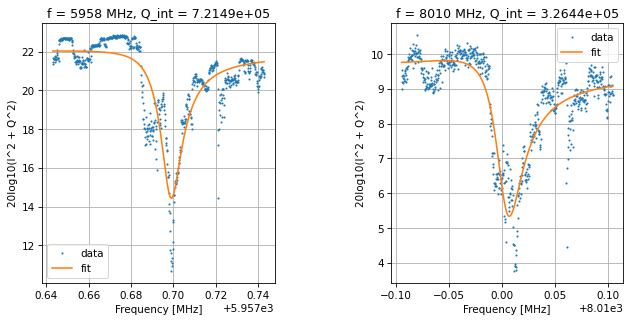

Frequencies out are: [5957.697340086432, 8010.000478677503] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.396 s


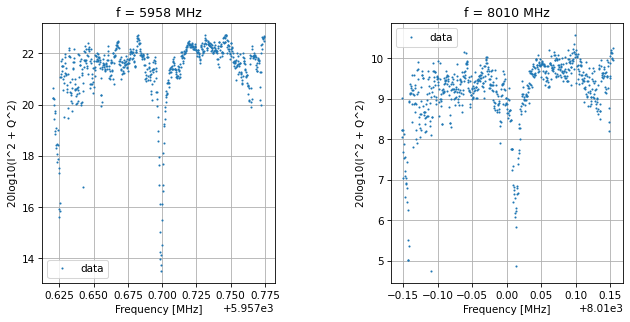

Saving data-2023-09-27-11-27-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.443 s


C:\Users\my\Documents\GitHub\ZCU216\res_dev\FFS/../Client_modules\mResSweepDouble.py:294: RuntimeWarning: divide by zero encountered in scalar divide
  Q_approx = centerF/bandwidth


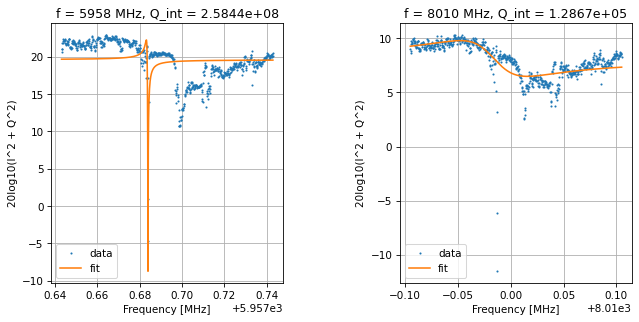

Frequencies out are: [5957.68355195677, 8009.978080357255] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.529 s


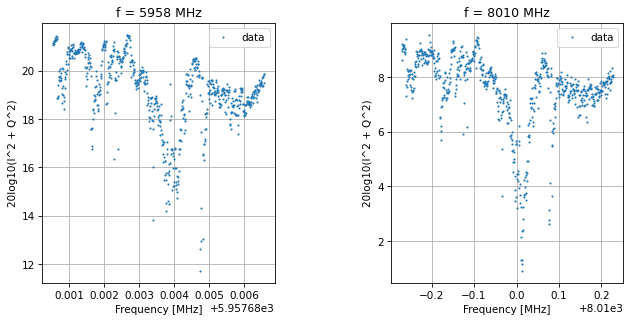

Saving data-2023-09-27-11-27-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.526 s


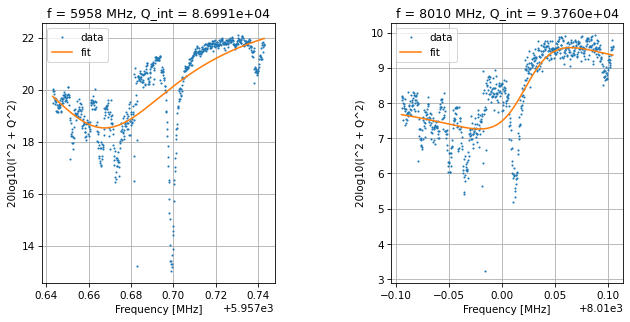

Frequencies out are: [5957.66200510472, 8010.027582755644] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.490 s


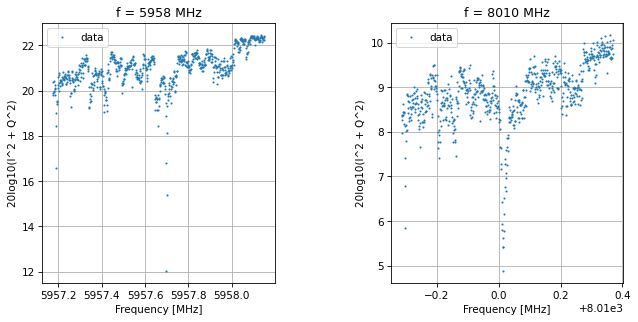

Saving data-2023-09-27-11-28-30
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.408 s


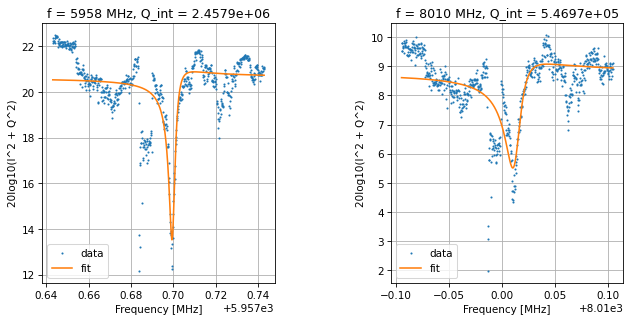

Frequencies out are: [5957.700135682631, 8010.014006201259] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


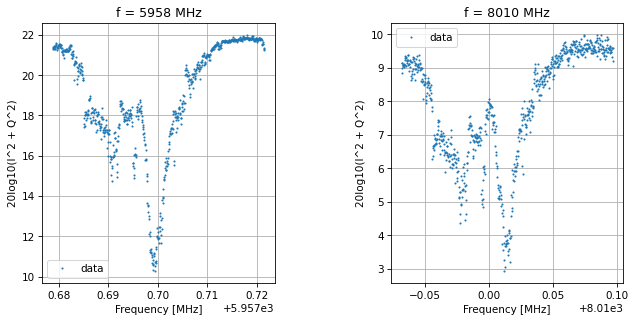

Saving data-2023-09-27-11-29-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.480 s


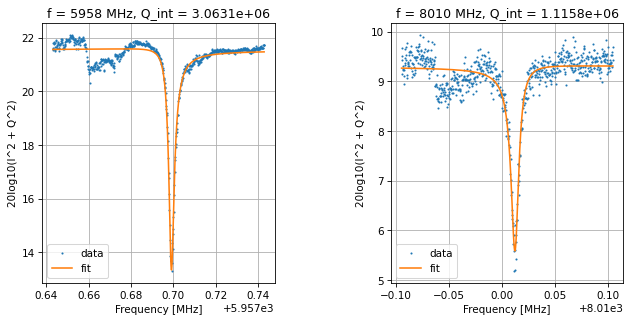

Frequencies out are: [5957.6988669860675, 8010.012734121152] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.561 s


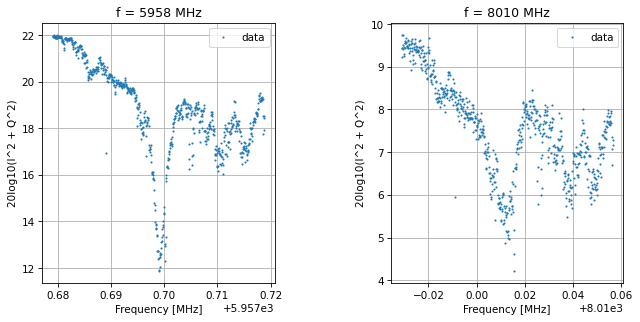

Saving data-2023-09-27-11-29-35
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.642 s


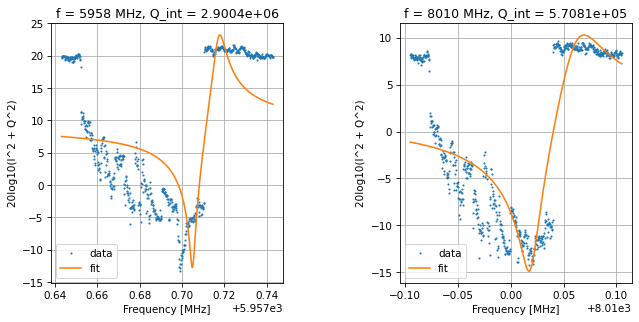

Frequencies out are: [5957.717419897805, 8010.062216143879] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


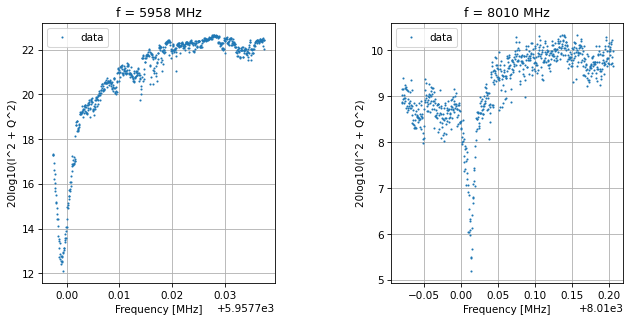

Saving data-2023-09-27-11-30-08
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.295 s


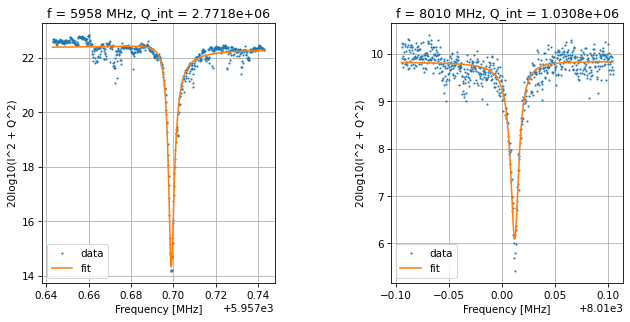

Frequencies out are: [5957.698684016576, 8010.012278704768] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.509 s


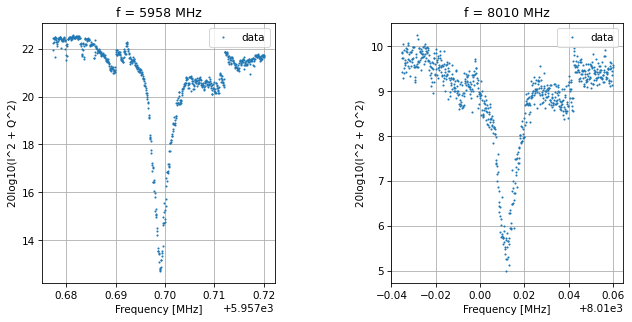

Saving data-2023-09-27-11-30-41
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.450 s


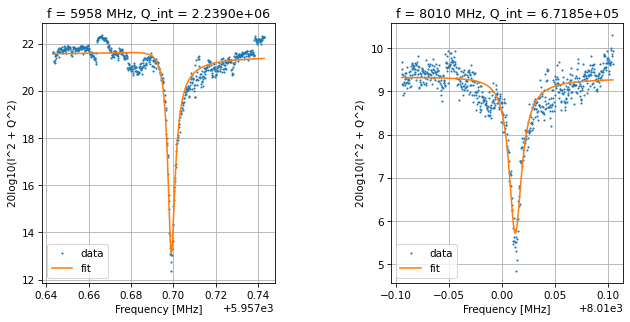

Frequencies out are: [5957.698464648774, 8010.012128649459] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.525 s


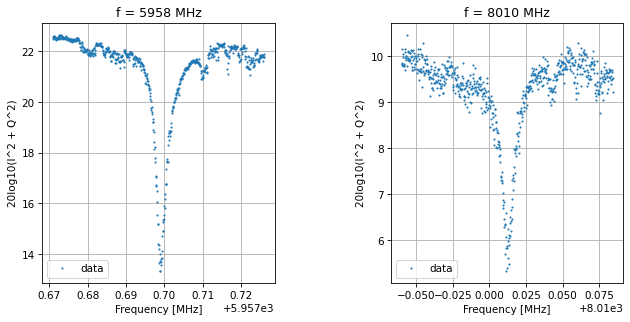

Saving data-2023-09-27-11-31-13
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


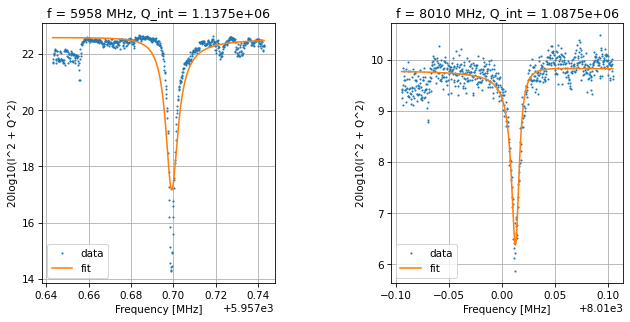

Frequencies out are: [5957.698921020485, 8010.0133242278725] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.516 s


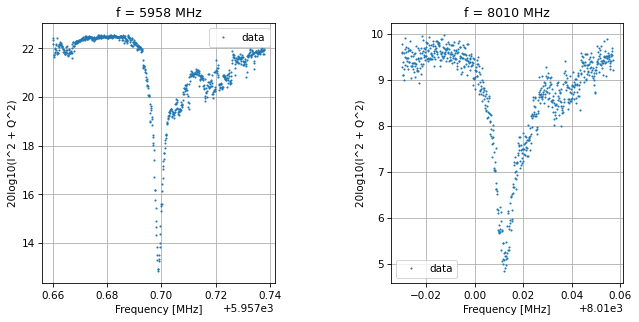

Saving data-2023-09-27-11-31-47
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.552 s


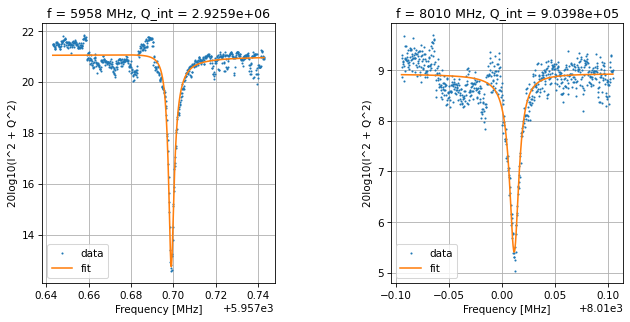

Frequencies out are: [5957.698767189121, 8010.011723180325] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.914 s


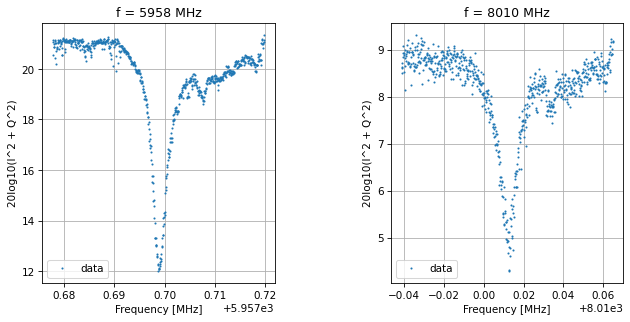

Saving data-2023-09-27-11-32-20
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.432 s


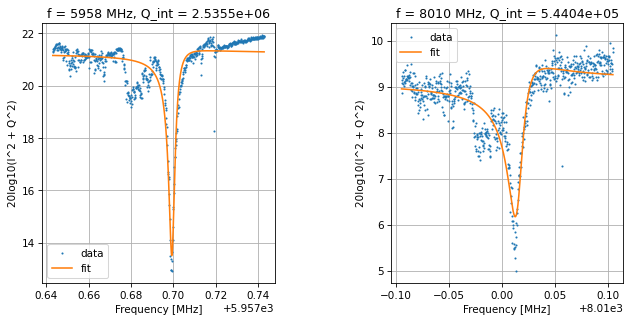

Frequencies out are: [5957.699795674548, 8010.016302550336] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.578 s


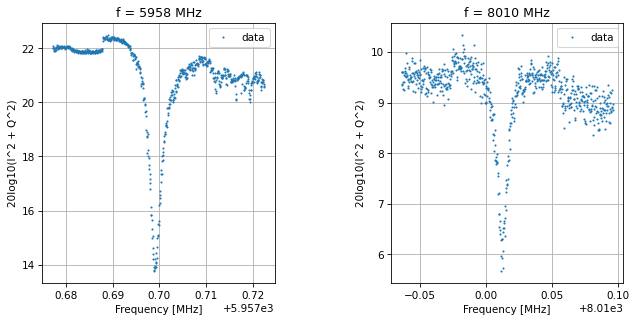

Saving data-2023-09-27-11-32-53
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.412 s


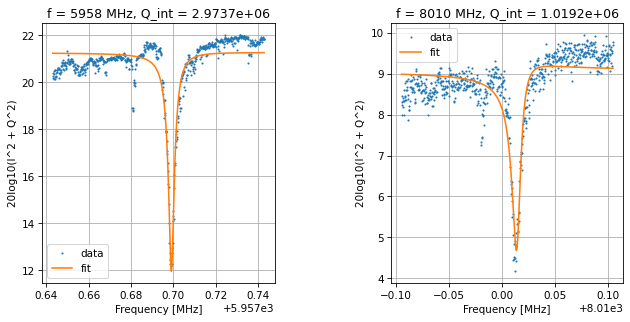

Frequencies out are: [5957.699212944754, 8010.015029795153] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.383 s


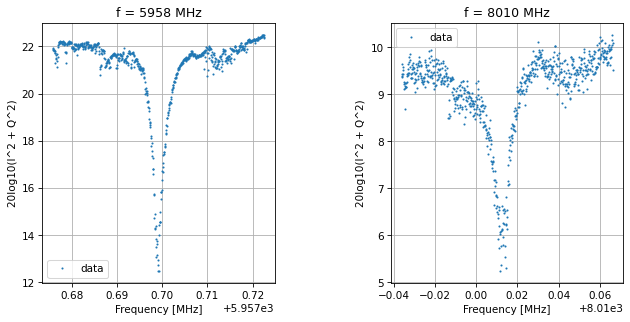

Saving data-2023-09-27-11-33-26
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.472 s


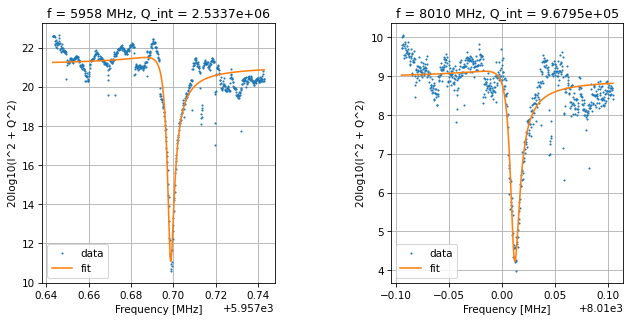

Frequencies out are: [5957.6976860836585, 8010.010478425625] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.534 s


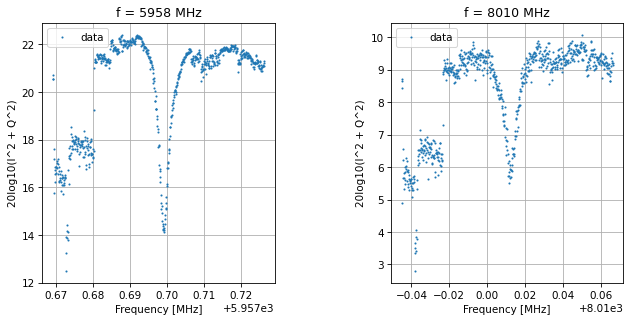

Saving data-2023-09-27-11-33-59
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.569 s


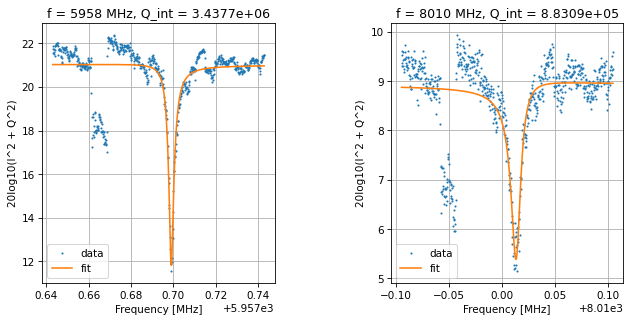

Frequencies out are: [5957.698892450477, 8010.01415172886] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.632 s


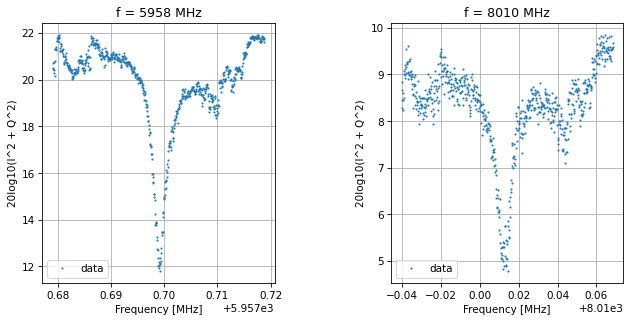

Saving data-2023-09-27-11-34-32
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.533 s


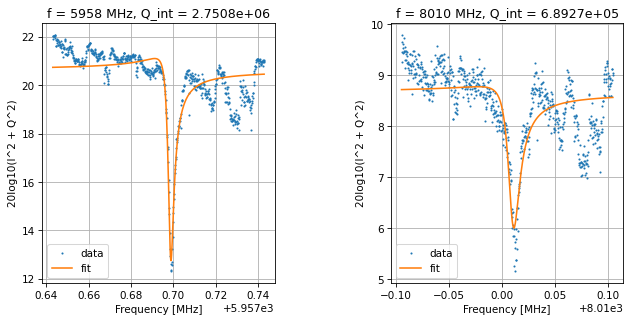

Frequencies out are: [5957.697975199122, 8010.009381379475] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.520 s


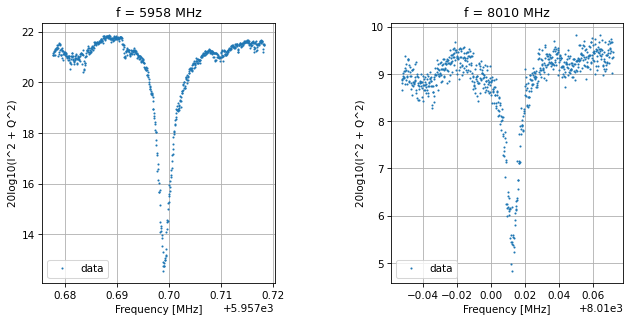

Saving data-2023-09-27-11-35-05
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


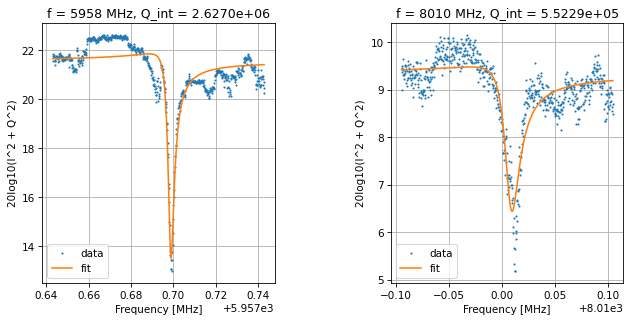

Frequencies out are: [5957.698160767637, 8010.006956013637] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.442 s


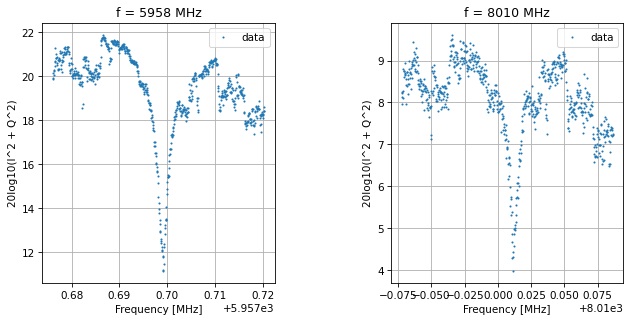

Saving data-2023-09-27-11-35-38
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.434 s


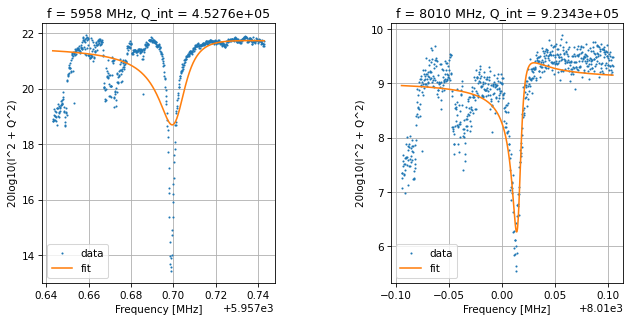

Frequencies out are: [5957.7019100361185, 8010.016277831108] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.385 s


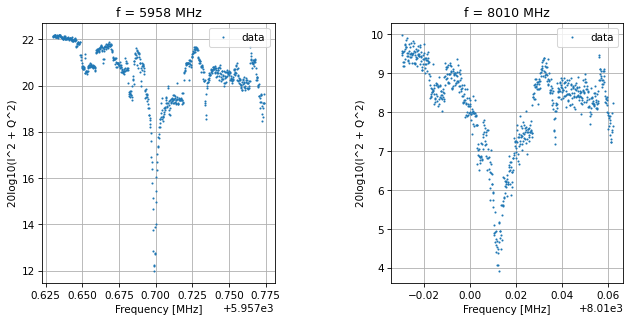

Saving data-2023-09-27-11-36-10
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.470 s


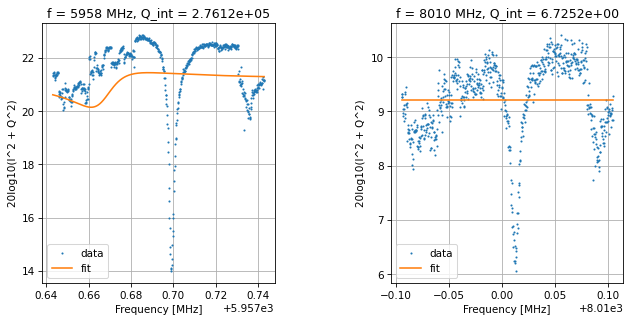

Frequencies out are: [5957.667880062841, 8009.880390717993] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.437 s


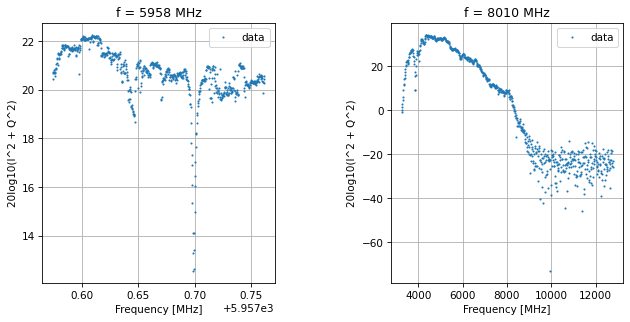

Saving data-2023-09-27-11-36-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.477 s


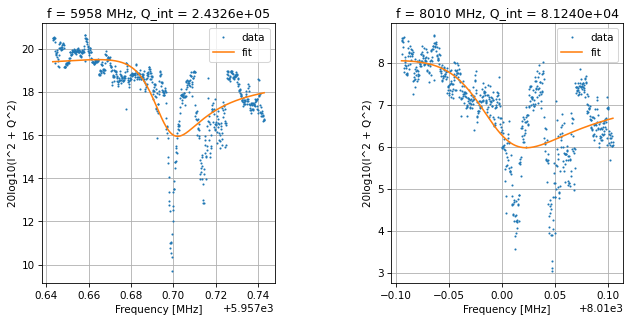

Frequencies out are: [5957.693187192099, 8009.987935414557] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.535 s


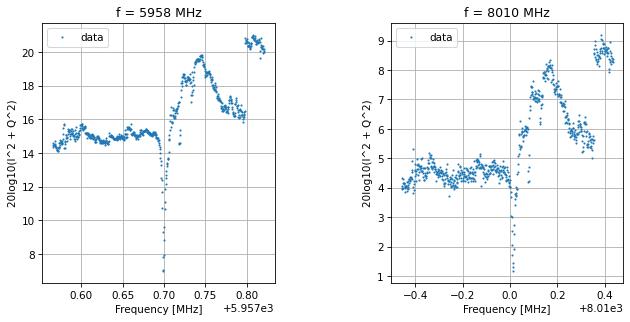

Saving data-2023-09-27-11-37-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.379 s


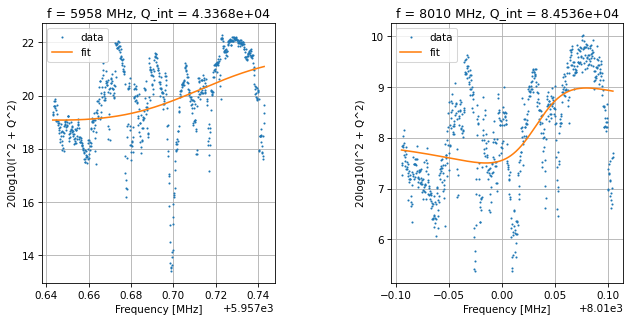

Frequencies out are: [5957.720548108008, 8010.03640704665] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.439 s


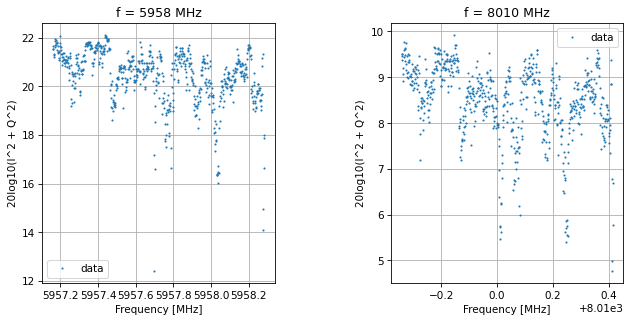

Saving data-2023-09-27-11-37-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.485 s


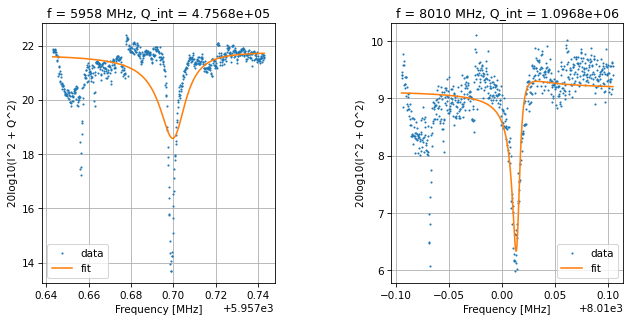

Frequencies out are: [5957.7006991793805, 8010.014758509726] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.936 s


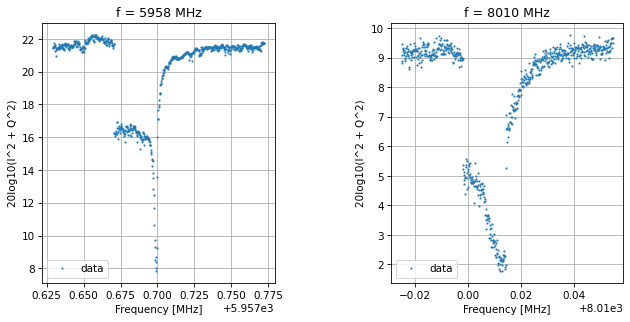

Saving data-2023-09-27-11-38-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.444 s


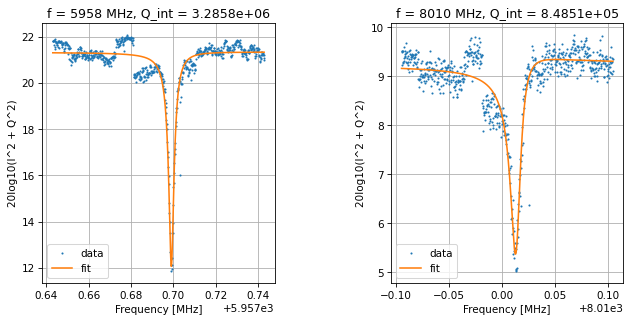

Frequencies out are: [5957.6991973877, 8010.014302908691] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


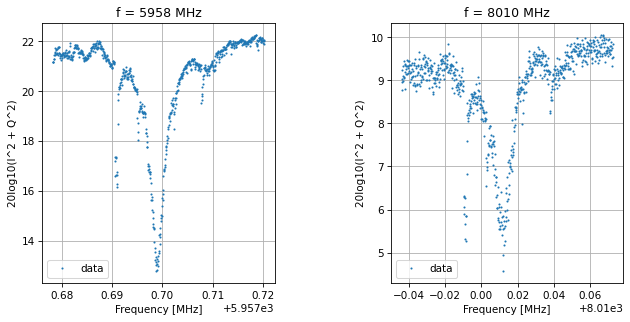

Saving data-2023-09-27-11-38-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.421 s


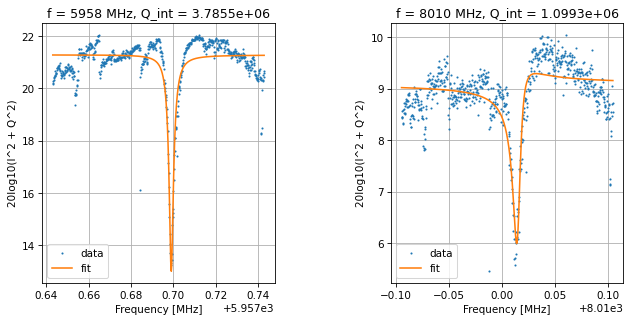

Frequencies out are: [5957.699023928105, 8010.015537332067] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.554 s


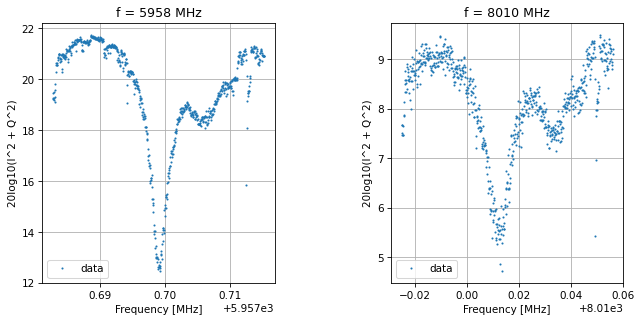

Saving data-2023-09-27-11-39-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.388 s


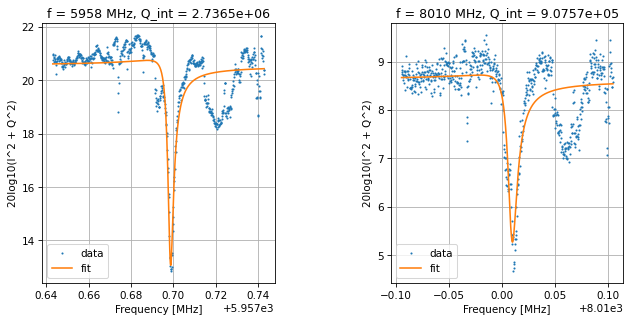

Frequencies out are: [5957.698184707177, 8010.008611034046] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.544 s


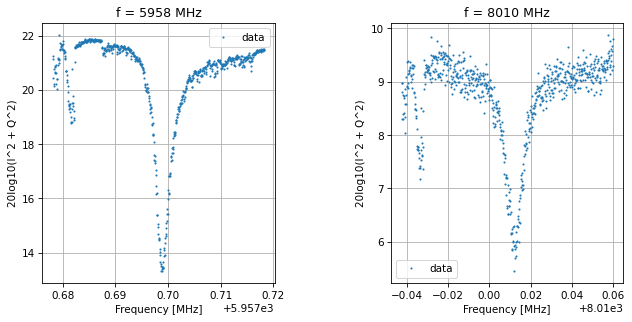

Saving data-2023-09-27-11-40-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.574 s


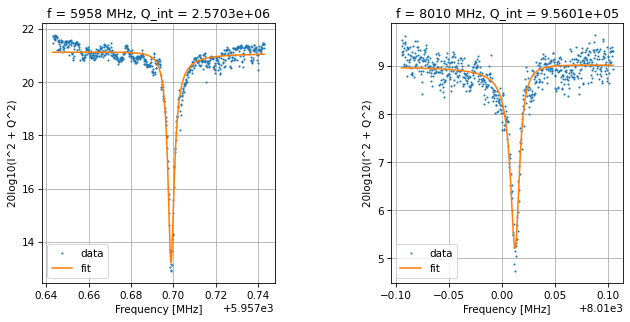

Frequencies out are: [5957.698702675523, 8010.012940928276] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.453 s


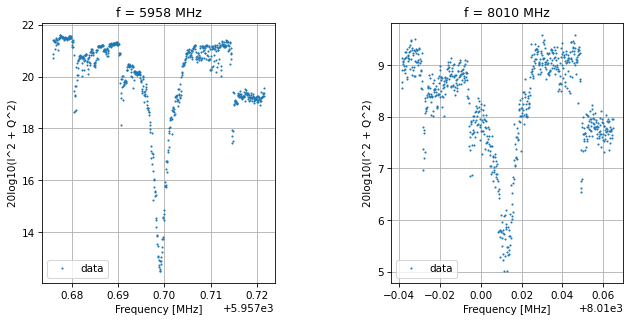

Saving data-2023-09-27-11-40-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.316 s


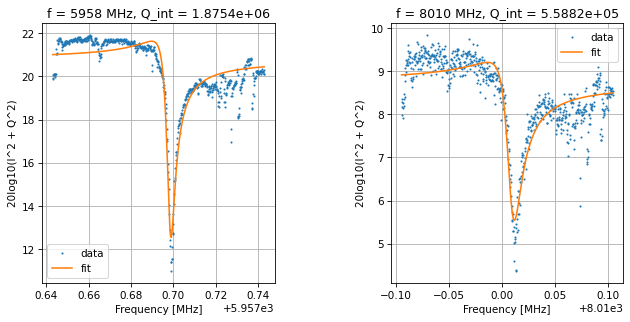

Frequencies out are: [5957.697085079687, 8010.007157790276] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.590 s


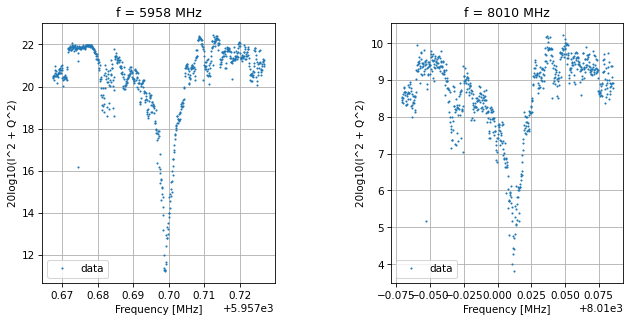

Saving data-2023-09-27-11-41-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.467 s


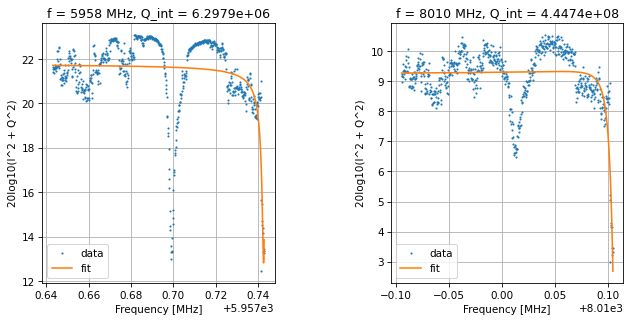

Frequencies out are: [5957.743611491381, 8010.107741267851] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


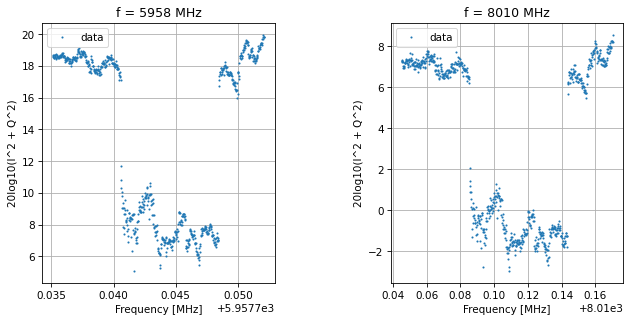

Saving data-2023-09-27-11-41-42
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.642 s


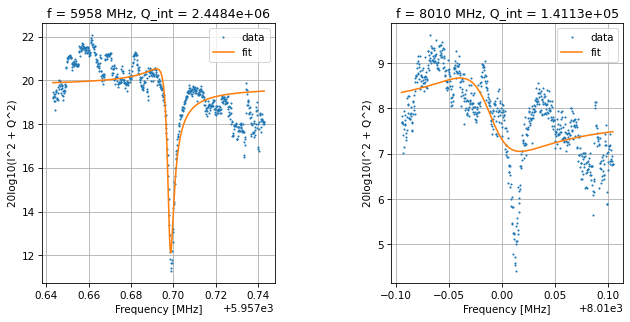

Frequencies out are: [5957.697470226094, 8009.986271511145] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.573 s


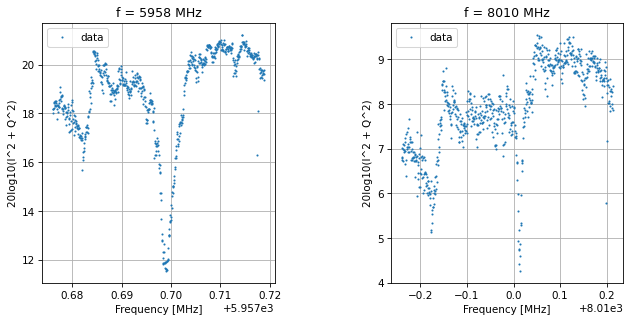

Saving data-2023-09-27-11-42-15
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.437 s


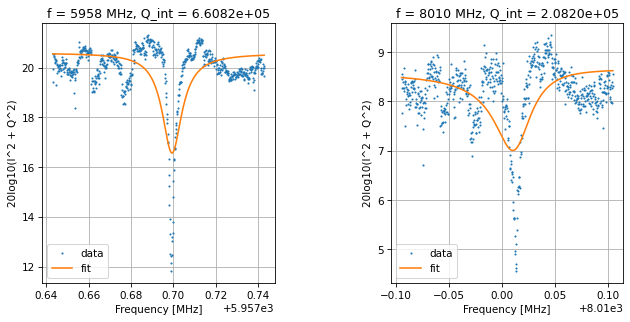

Frequencies out are: [5957.6992882683935, 8010.013399973912] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.502 s


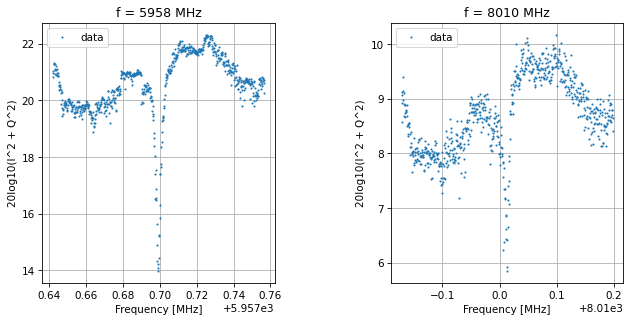

Saving data-2023-09-27-11-42-49
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


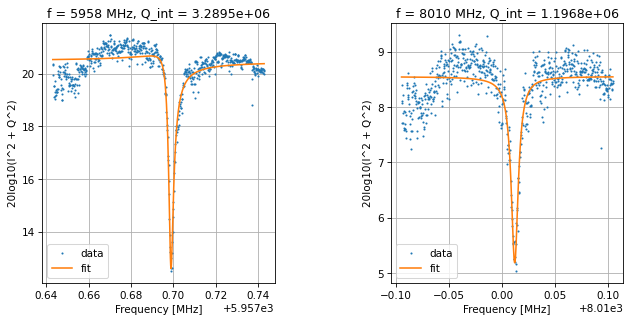

Frequencies out are: [5957.698438256756, 8010.012149346491] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.496 s


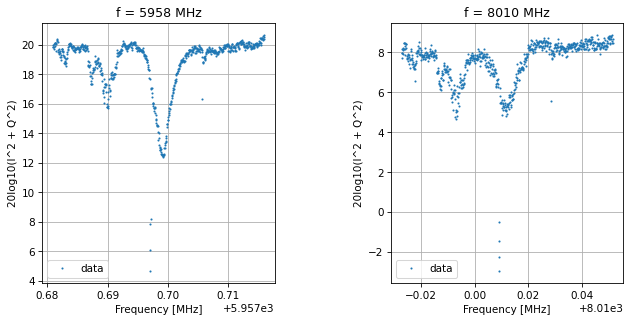

Saving data-2023-09-27-11-43-22
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.568 s


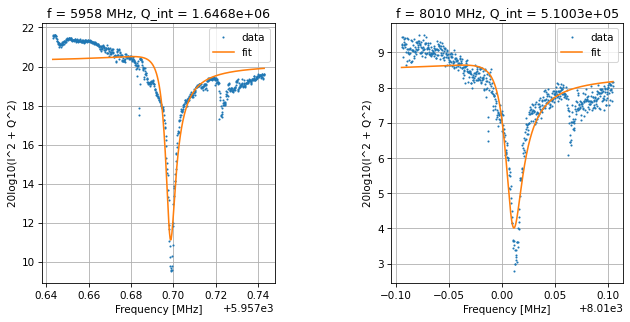

Frequencies out are: [5957.697333217251, 8010.00777638065] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.514 s


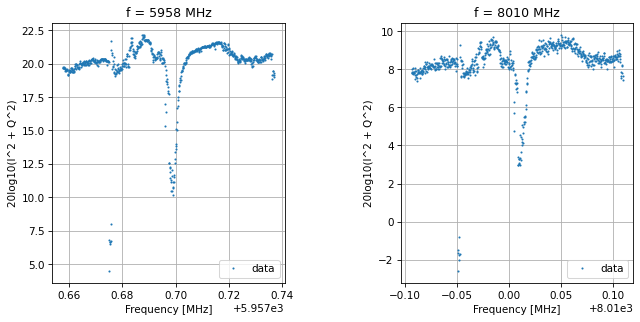

Saving data-2023-09-27-11-43-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


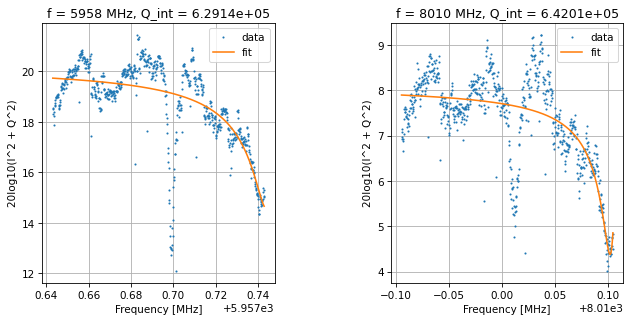

Frequencies out are: [5957.752992988853, 8010.11111392459] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.587 s


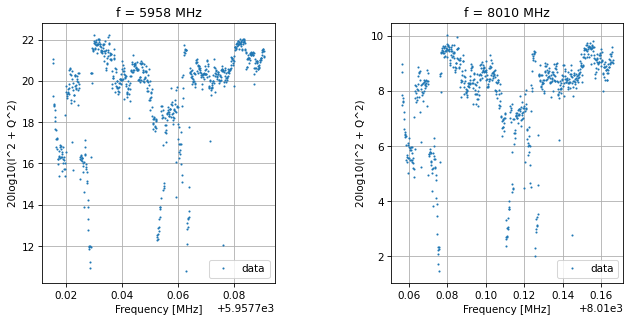

Saving data-2023-09-27-11-44-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.894 s


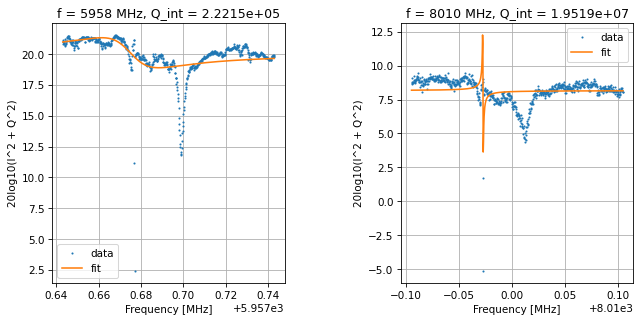

Frequencies out are: [5957.673057495816, 8009.972516354102] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.440 s


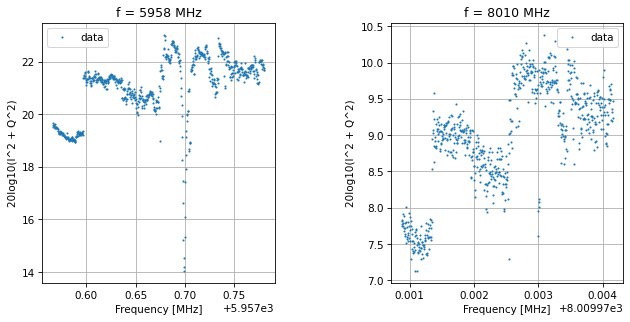

Saving data-2023-09-27-11-45-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.482 s


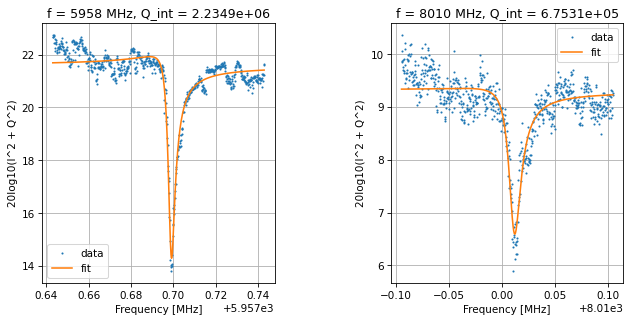

Frequencies out are: [5957.69826395344, 8010.010877141181] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.508 s


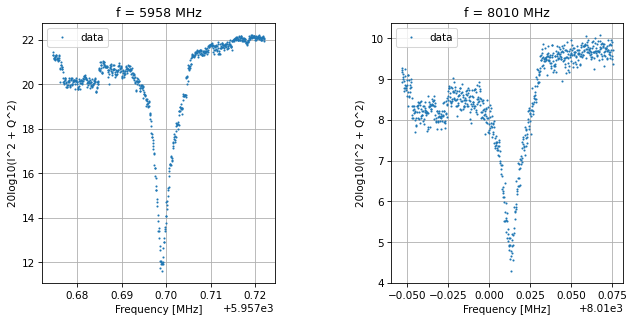

Saving data-2023-09-27-11-45-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.492 s


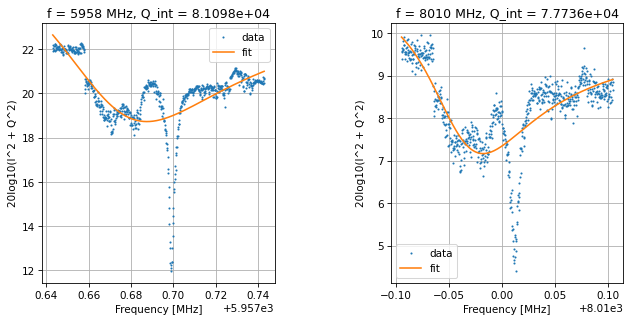

Frequencies out are: [5957.645439214726, 8009.948093800912] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.554 s


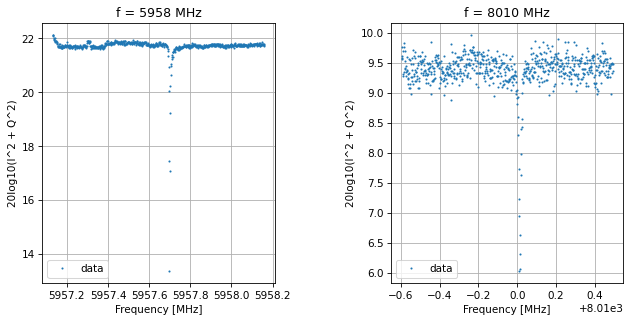

Saving data-2023-09-27-11-46-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


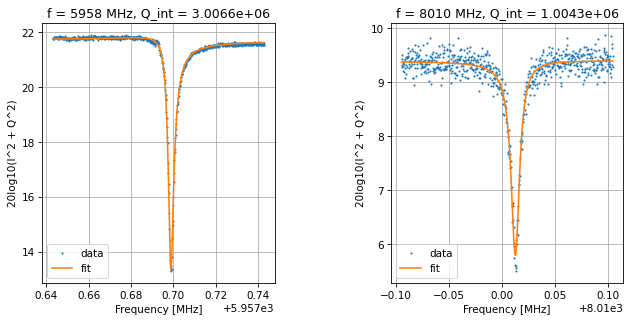

Frequencies out are: [5957.698513082131, 8010.012886170763] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.316 s


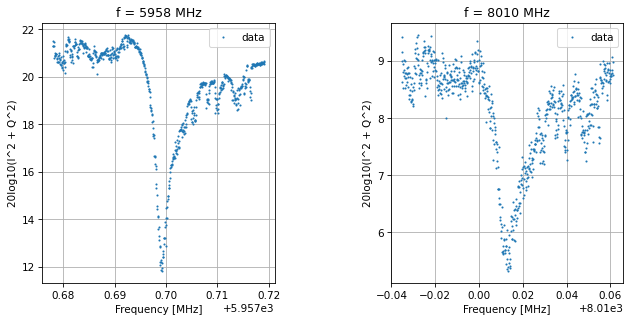

Saving data-2023-09-27-11-46-40
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.490 s


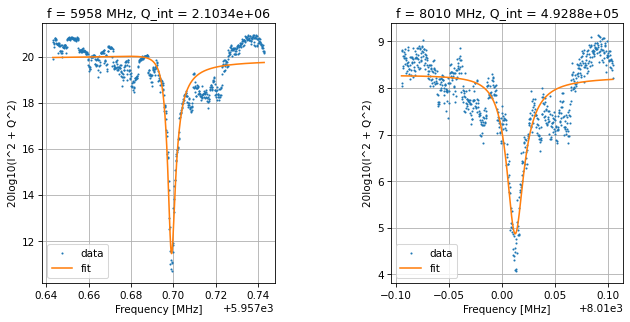

Frequencies out are: [5957.698512274464, 8010.011868386342] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


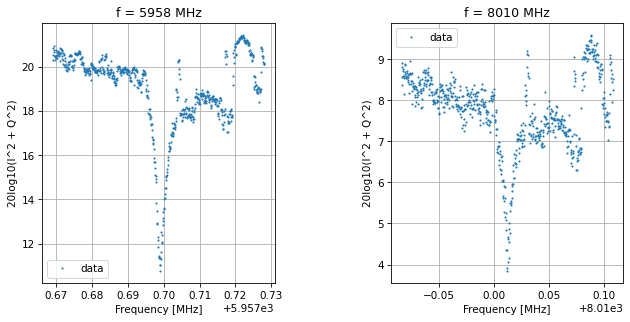

Saving data-2023-09-27-11-47-13
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.425 s


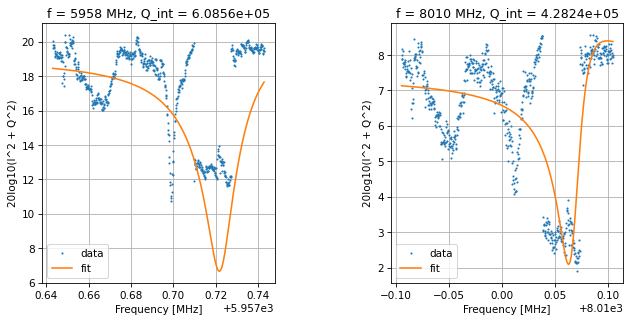

Frequencies out are: [5957.727053818944, 8010.0720045043] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.552 s


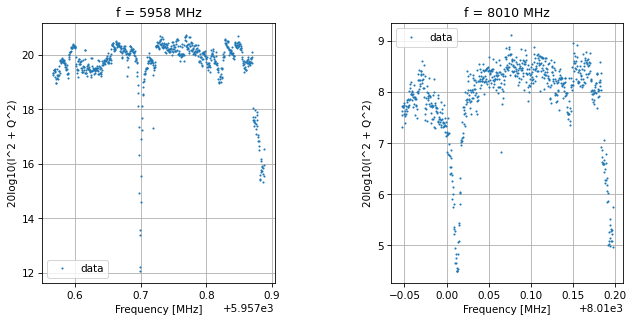

Saving data-2023-09-27-11-47-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.493 s


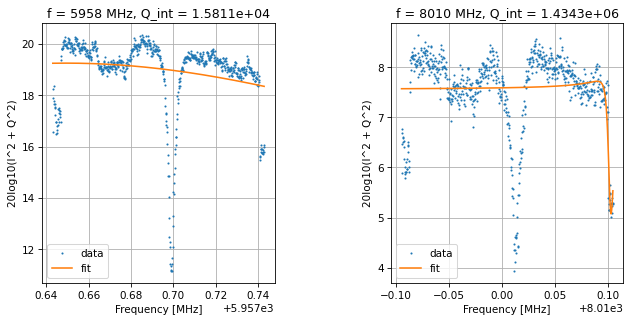

Frequencies out are: [5957.650693901701, 8010.102129099362] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.560 s


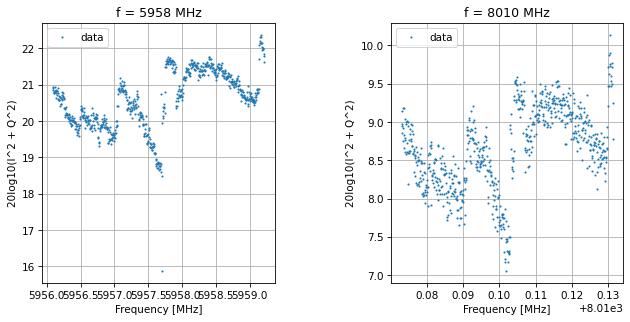

Saving data-2023-09-27-11-48-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.555 s


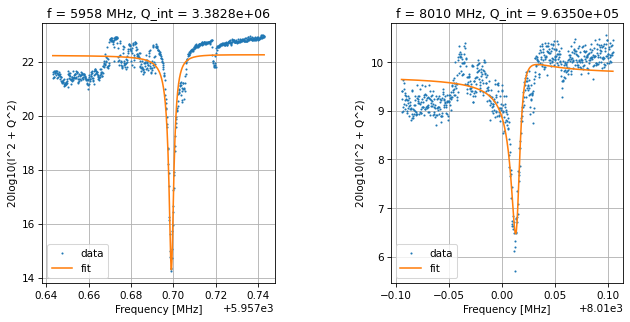

Frequencies out are: [5957.699223779657, 8010.014817283135] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.586 s


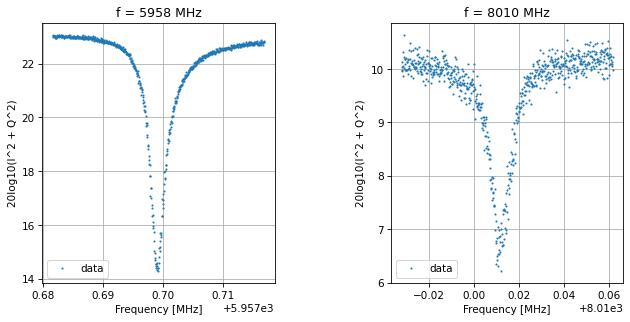

Saving data-2023-09-27-11-48-52
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.495 s


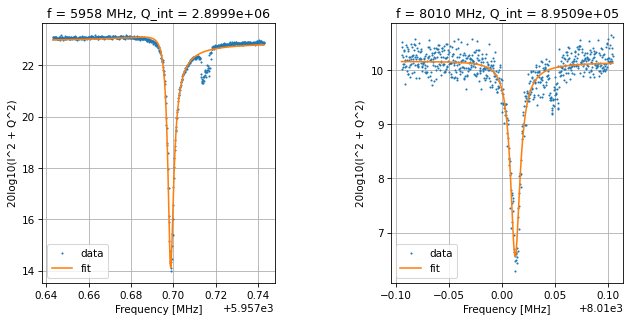

Frequencies out are: [5957.698182510999, 8010.012258396061] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.520 s


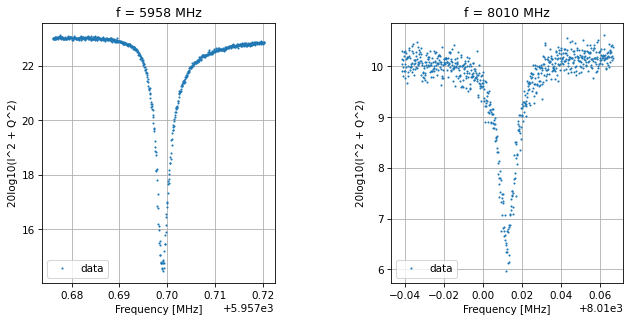

Saving data-2023-09-27-11-49-24
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.541 s


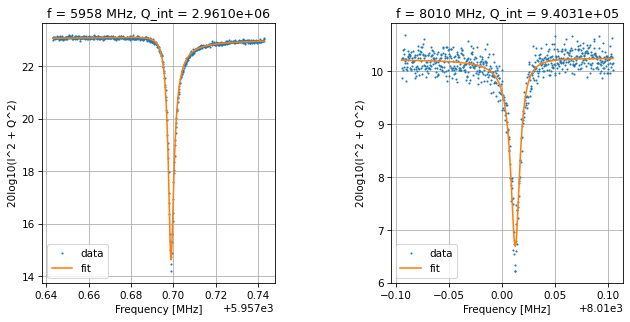

Frequencies out are: [5957.698592214841, 8010.012967316503] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.531 s


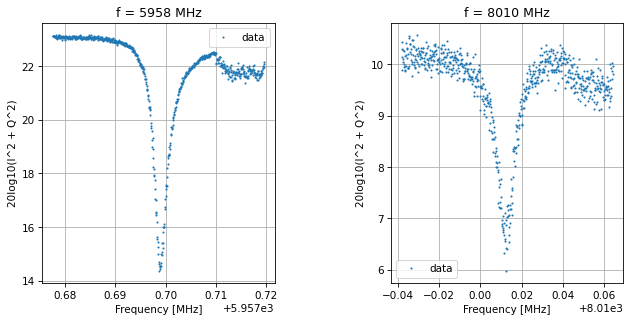

Saving data-2023-09-27-11-49-57
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


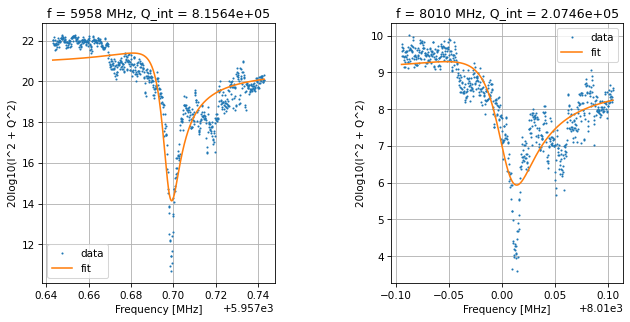

Frequencies out are: [5957.695835329356, 8010.001874467867] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.366 s


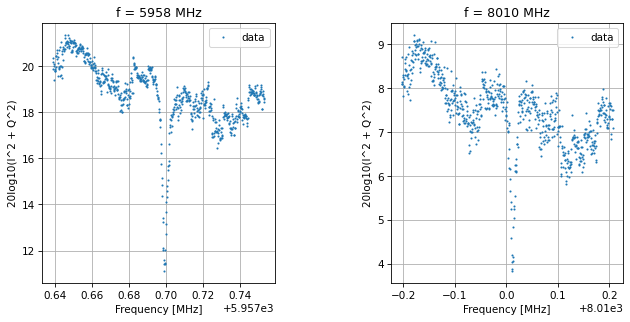

Saving data-2023-09-27-11-50-30
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.439 s


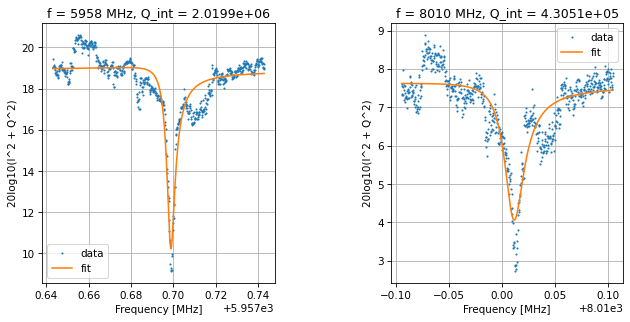

Frequencies out are: [5957.698161550036, 8010.009895362408] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.850 s


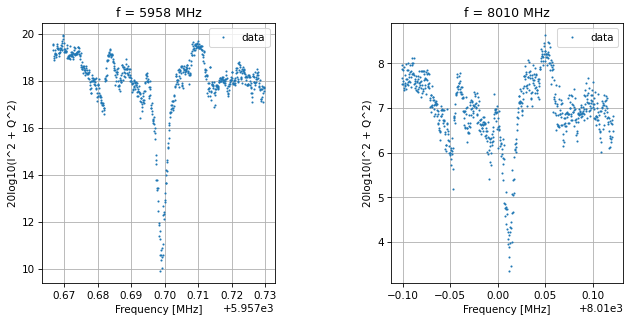

Saving data-2023-09-27-11-51-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.706 s


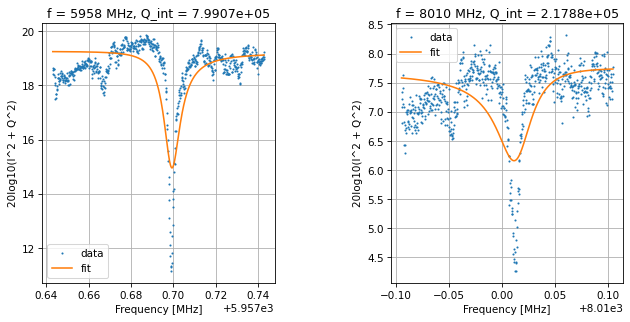

Frequencies out are: [5957.698917507341, 8010.014958954986] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.456 s


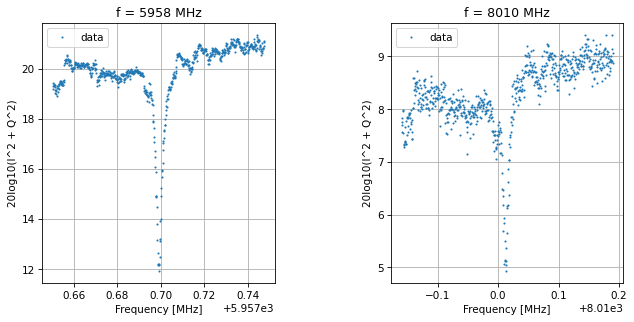

Saving data-2023-09-27-11-51-37
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.416 s


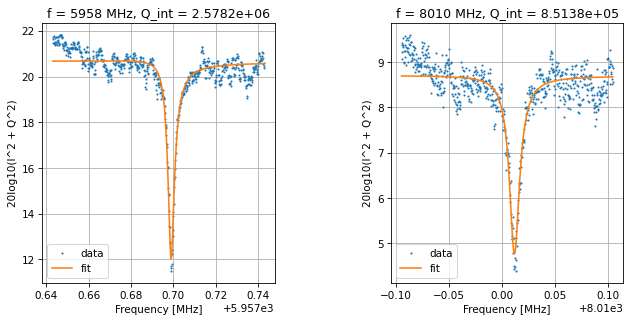

Frequencies out are: [5957.698656461818, 8010.011693428722] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.565 s


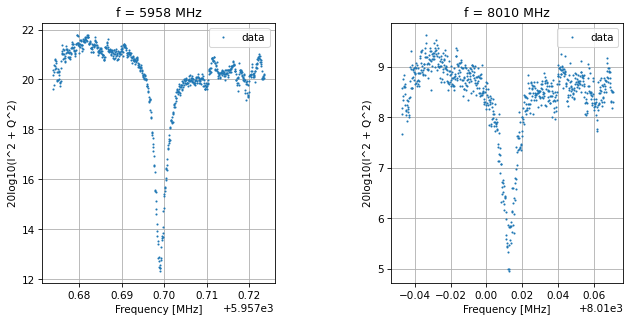

Saving data-2023-09-27-11-52-10
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.503 s


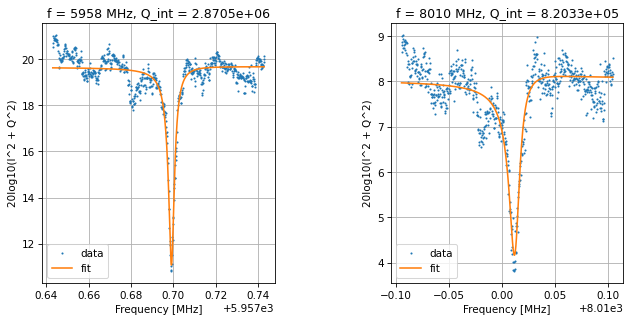

Frequencies out are: [5957.699308036645, 8010.01306359461] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


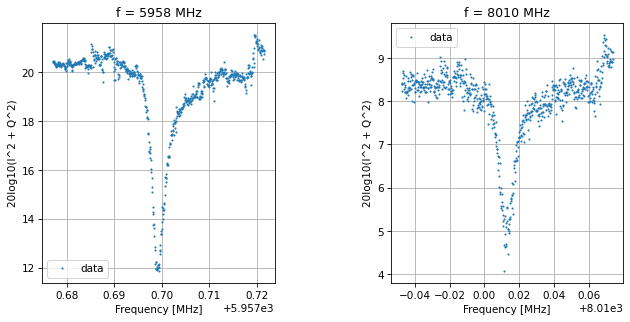

Saving data-2023-09-27-11-52-43
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.572 s


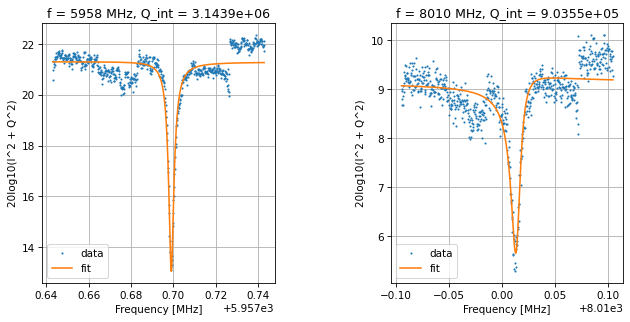

Frequencies out are: [5957.698985210199, 8010.014318781586] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.504 s


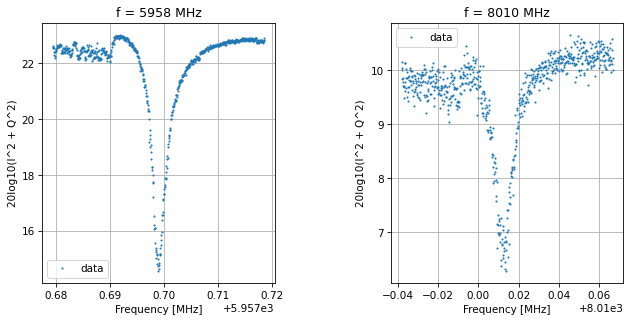

Saving data-2023-09-27-11-53-16
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.581 s


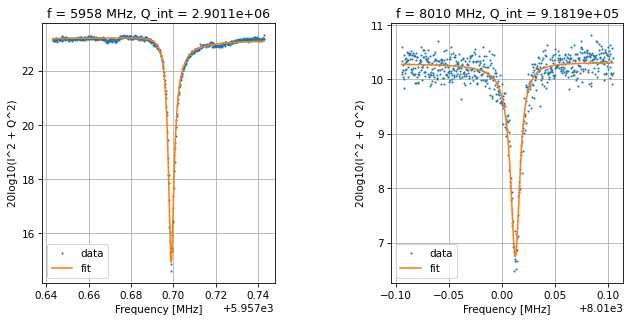

Frequencies out are: [5957.698664408473, 8010.0129561714875] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.474 s


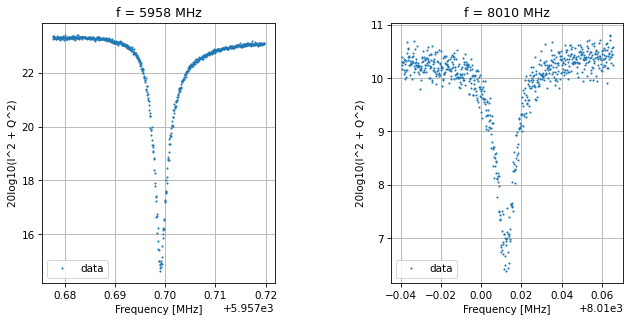

Saving data-2023-09-27-11-53-48
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.602 s


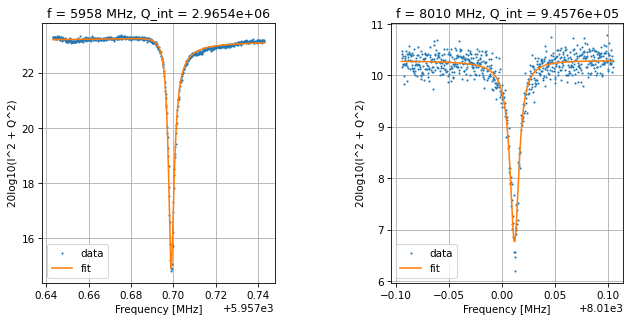

Frequencies out are: [5957.698653180306, 8010.0120357847645] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.460 s


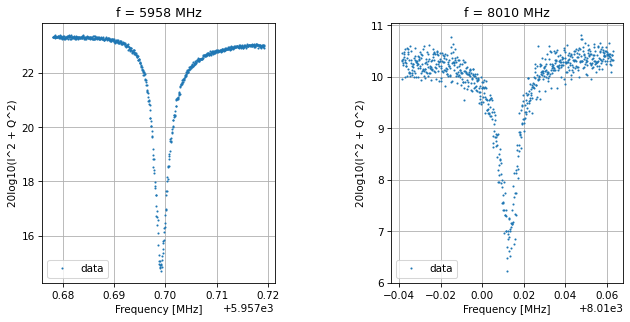

Saving data-2023-09-27-11-54-21
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.465 s


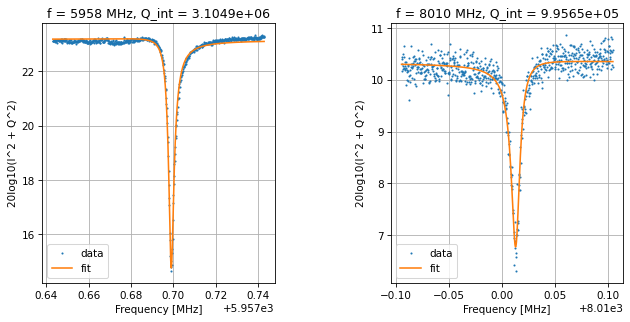

Frequencies out are: [5957.698802113841, 8010.013495447486] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.370 s


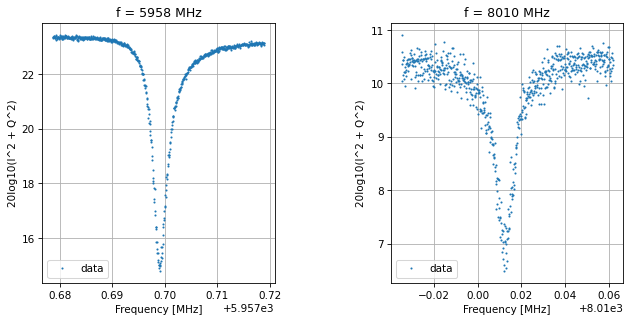

Saving data-2023-09-27-11-54-54
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.523 s


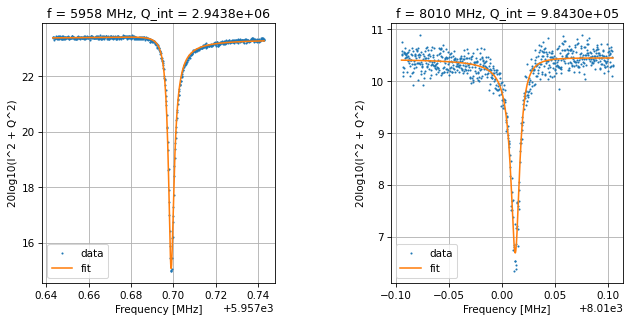

Frequencies out are: [5957.69867636105, 8010.0130358152155] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.532 s


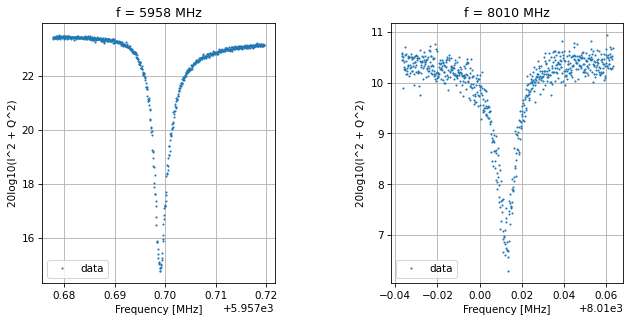

Saving data-2023-09-27-11-55-27
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


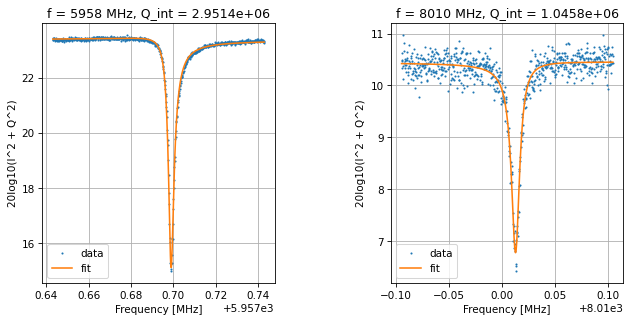

Frequencies out are: [5957.698656308426, 8010.013179675323] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.703 s


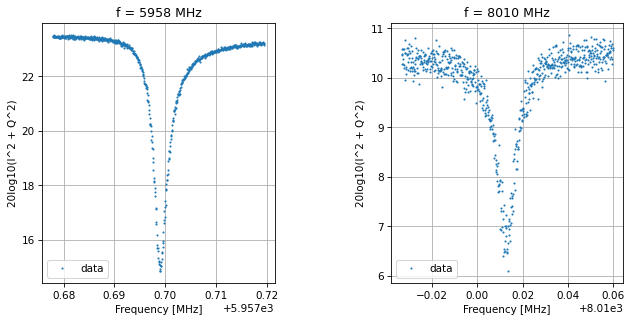

Saving data-2023-09-27-11-56-00
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.571 s


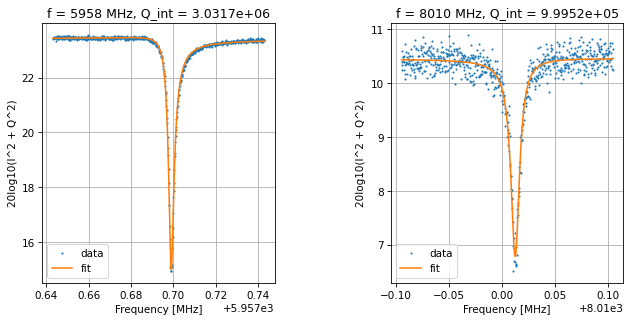

Frequencies out are: [5957.698715592653, 8010.012762436578] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.568 s


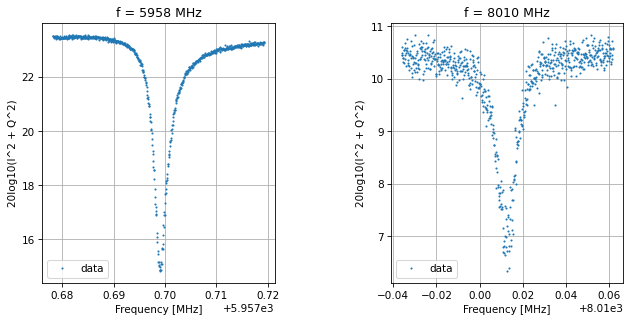

Saving data-2023-09-27-11-56-33
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.500 s


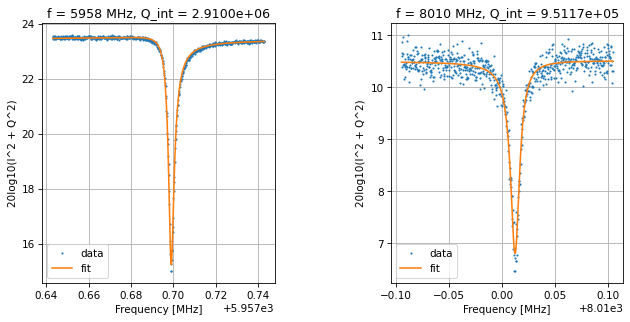

Frequencies out are: [5957.698700360161, 8010.012673177328] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.501 s


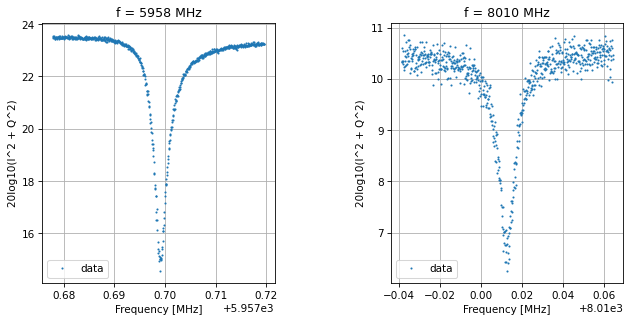

Saving data-2023-09-27-11-57-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.511 s


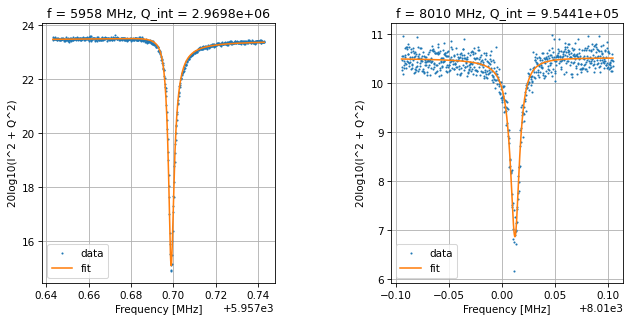

Frequencies out are: [5957.698676681068, 8010.012524869185] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.460 s


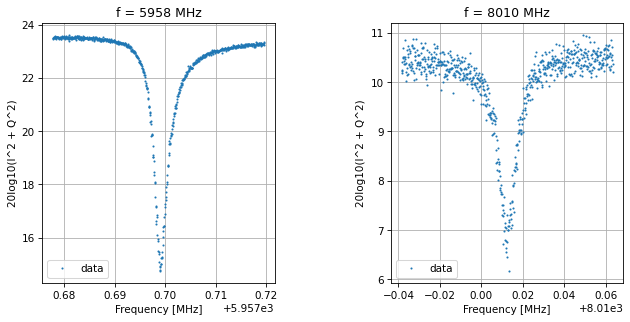

Saving data-2023-09-27-11-57-38
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.545 s


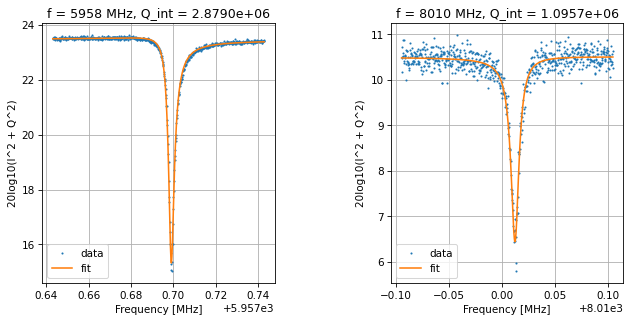

Frequencies out are: [5957.698739901859, 8010.012556236978] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.413 s


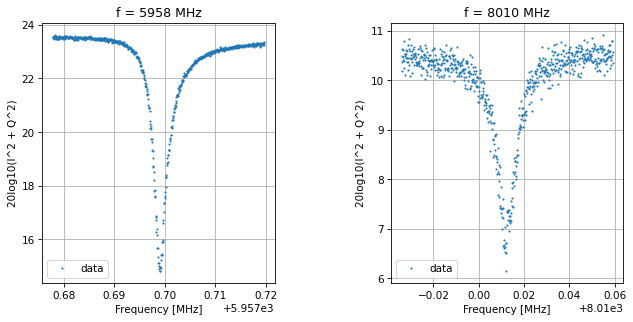

Saving data-2023-09-27-11-58-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.519 s


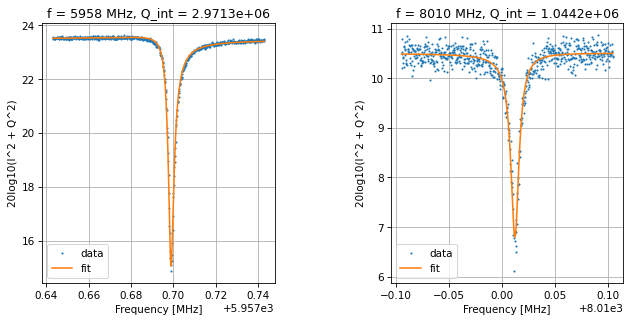

Frequencies out are: [5957.698611183674, 8010.0124406775285] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.596 s


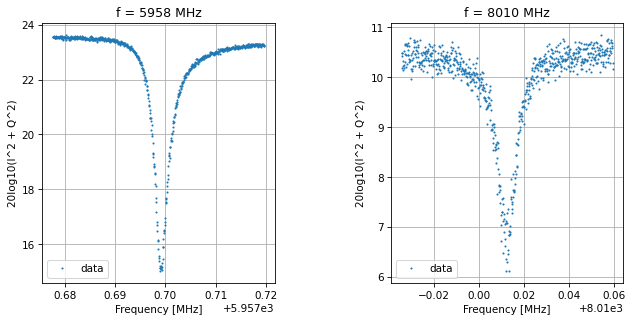

Saving data-2023-09-27-11-58-44
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.506 s


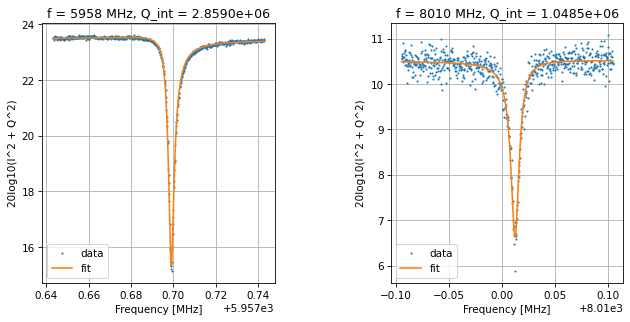

Frequencies out are: [5957.6987116622395, 8010.012674308102] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.435 s


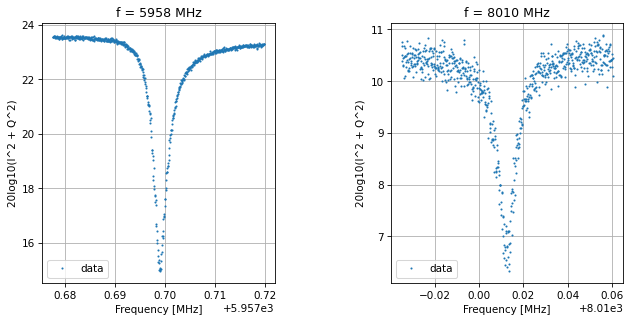

Saving data-2023-09-27-11-59-17
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.619 s


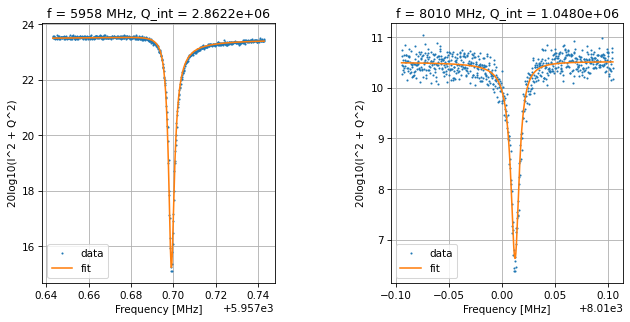

Frequencies out are: [5957.698773478049, 8010.012582906781] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.406 s


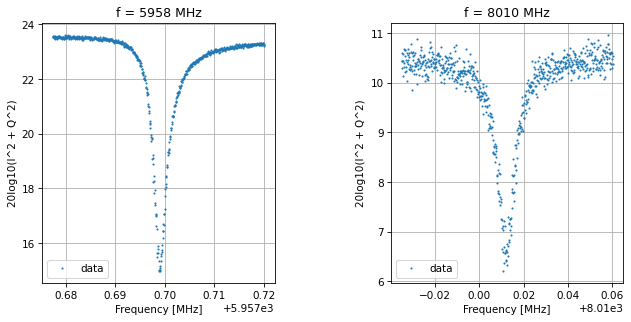

Saving data-2023-09-27-11-59-50
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.473 s


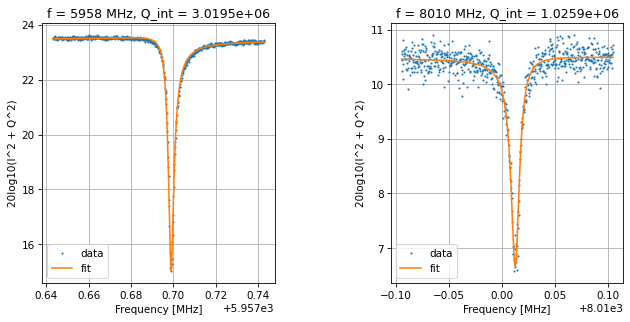

Frequencies out are: [5957.6985885545655, 8010.012969193381] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.520 s


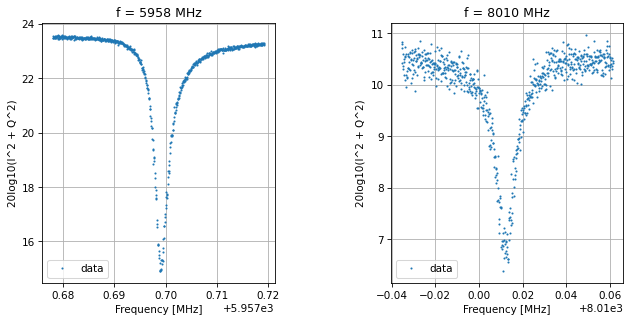

Saving data-2023-09-27-12-00-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.490 s


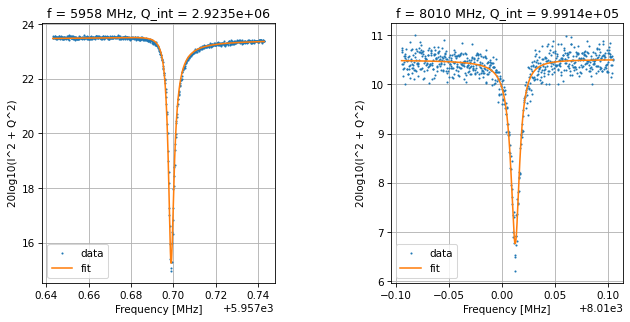

Frequencies out are: [5957.6986385303135, 8010.0127501959305] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.454 s


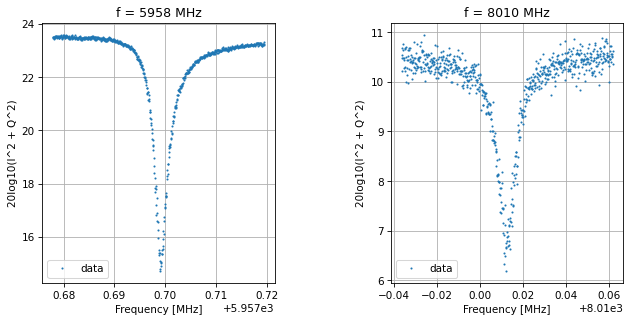

Saving data-2023-09-27-12-00-55
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.585 s


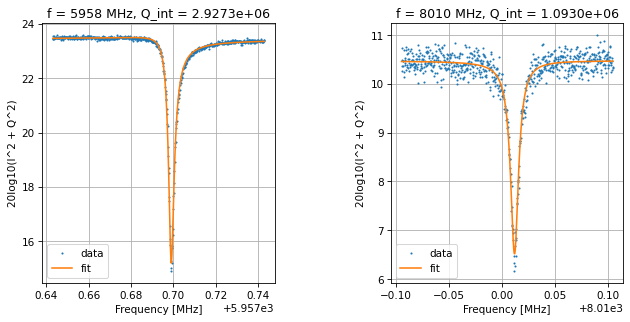

Frequencies out are: [5957.698713071649, 8010.012011752637] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.514 s


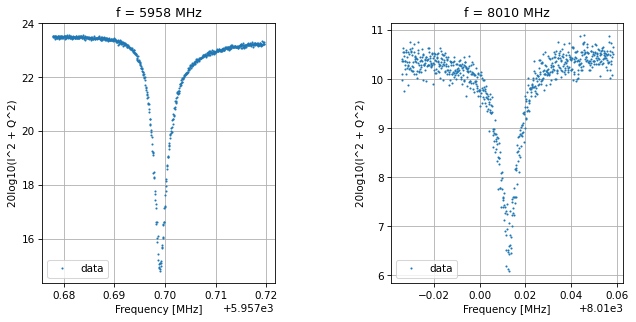

Saving data-2023-09-27-12-01-28
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.413 s


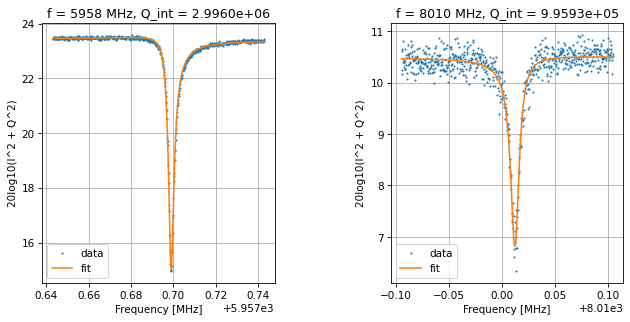

Frequencies out are: [5957.698640997778, 8010.012631746024] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.381 s


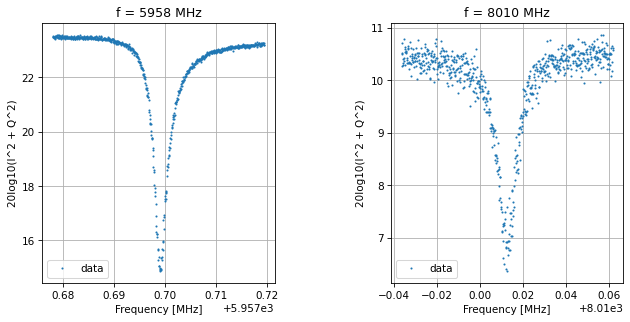

Saving data-2023-09-27-12-02-01
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.513 s


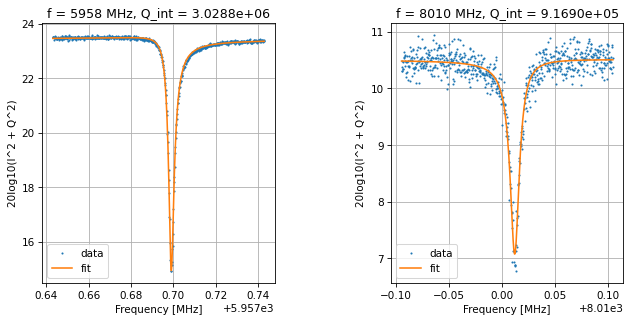

Frequencies out are: [5957.6987486808375, 8010.012353040094] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.561 s


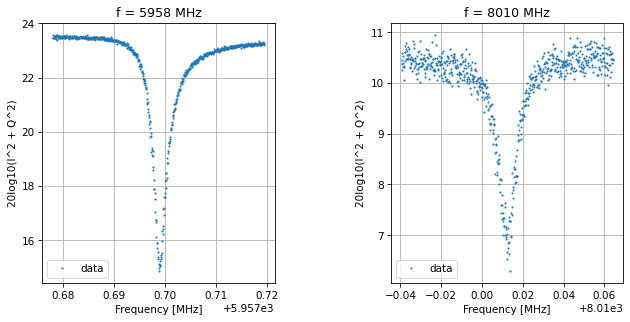

Saving data-2023-09-27-12-02-34
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.527 s


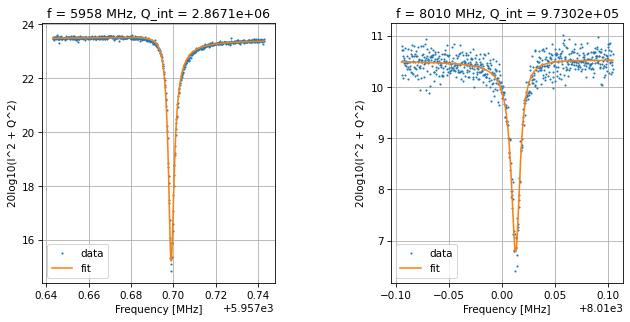

Frequencies out are: [5957.698670082314, 8010.013332613557] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.397 s


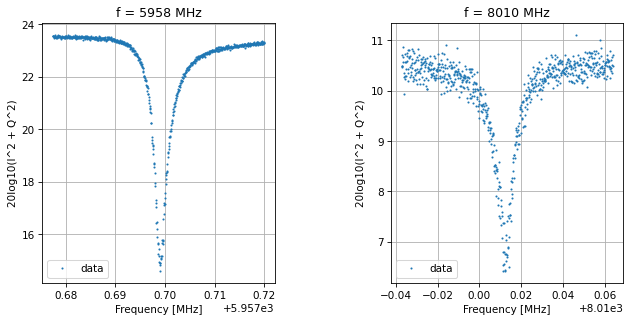

Saving data-2023-09-27-12-03-06
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.554 s


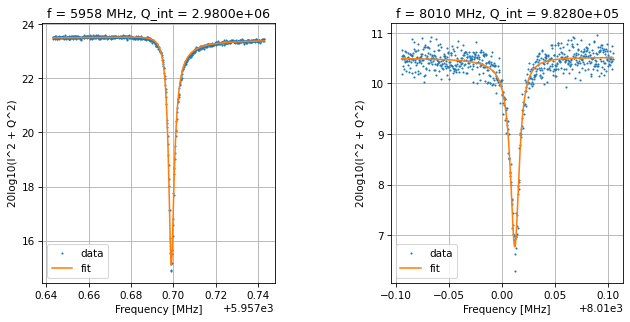

Frequencies out are: [5957.698727850626, 8010.012412013426] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.528 s


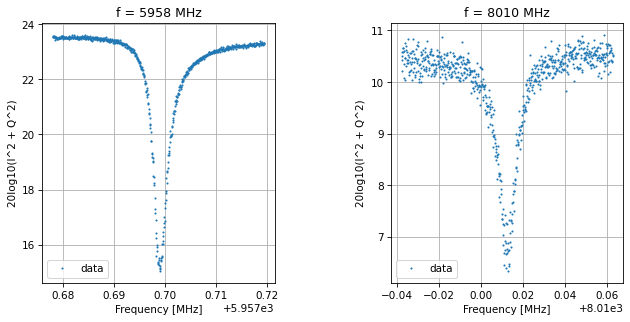

Saving data-2023-09-27-12-03-39
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.538 s


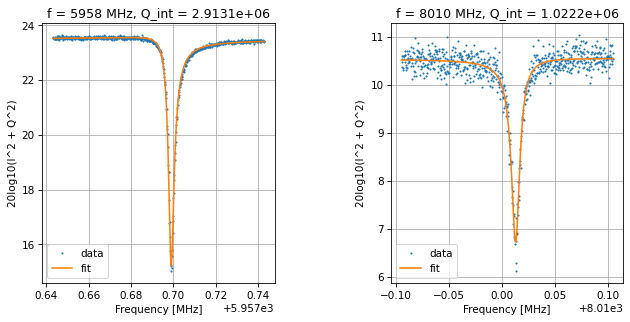

Frequencies out are: [5957.698692690168, 8010.013215283506] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.483 s


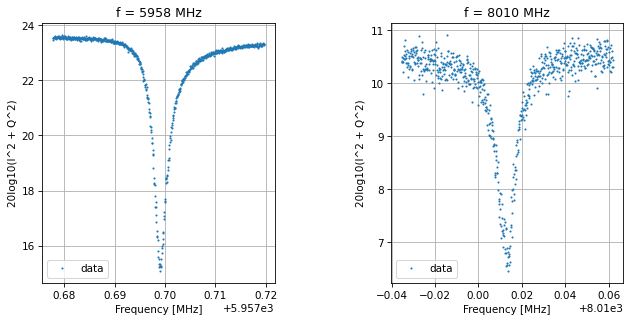

Saving data-2023-09-27-12-04-12
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.883 s


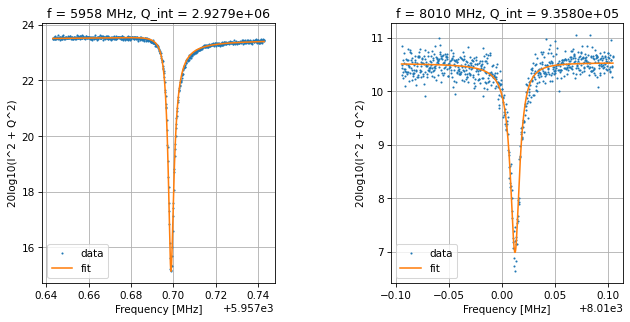

Frequencies out are: [5957.69857635064, 8010.012562882764] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.466 s


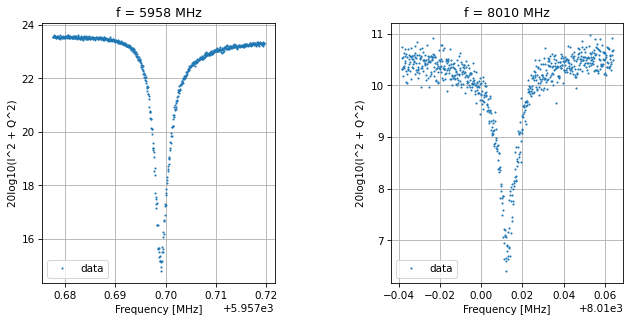

Saving data-2023-09-27-12-04-45
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.479 s


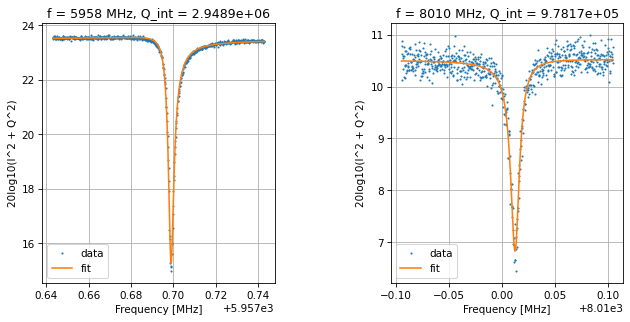

Frequencies out are: [5957.6986162539215, 8010.012695351883] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.487 s


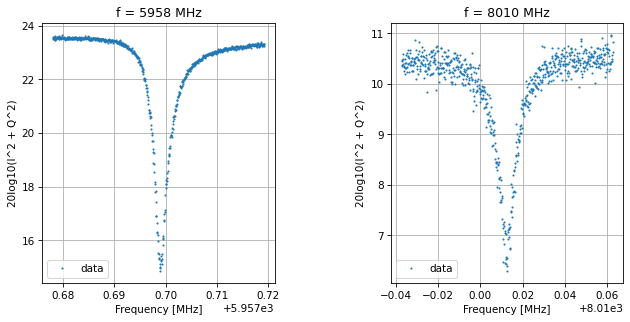

Saving data-2023-09-27-12-05-18
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.610 s


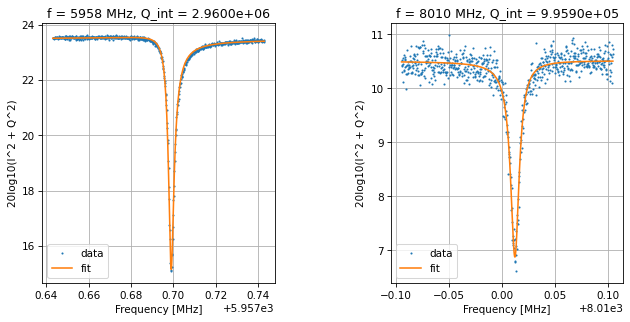

Frequencies out are: [5957.698694862734, 8010.012441717581] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.537 s


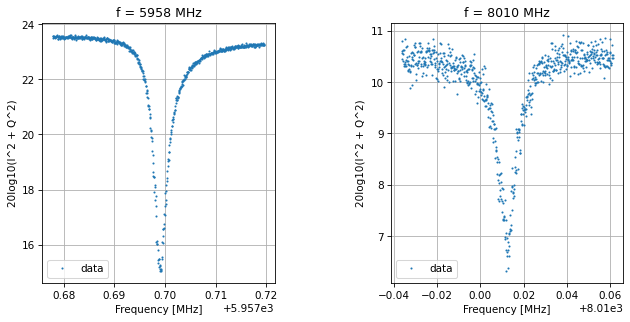

Saving data-2023-09-27-12-05-51
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.494 s


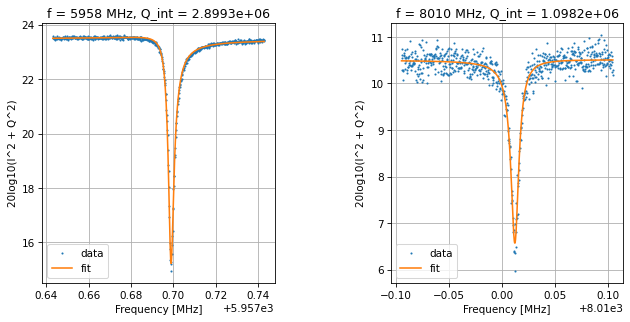

Frequencies out are: [5957.69860310426, 8010.012423807762] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.486 s


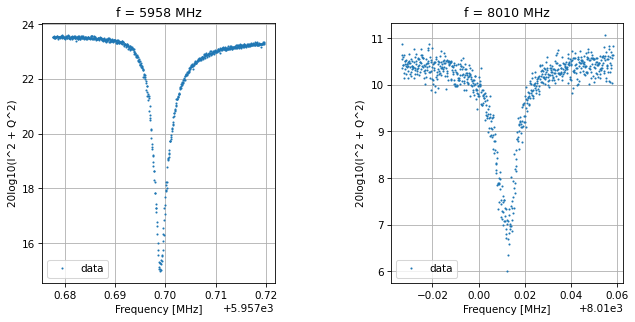

Saving data-2023-09-27-12-06-23
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.594 s


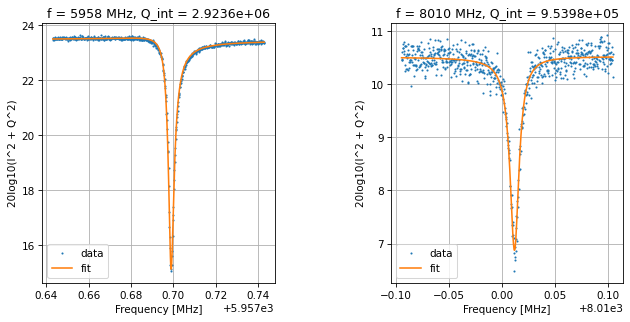

Frequencies out are: [5957.698648007288, 8010.0120377176945] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.465 s


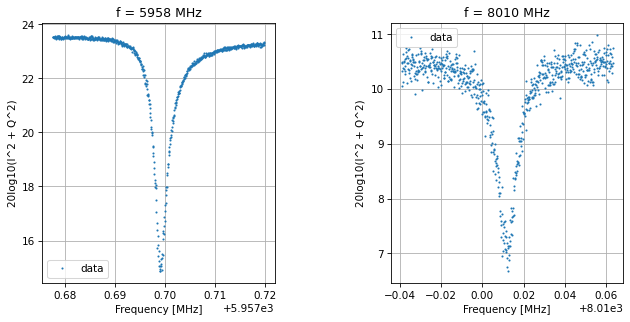

Saving data-2023-09-27-12-06-56
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.406 s


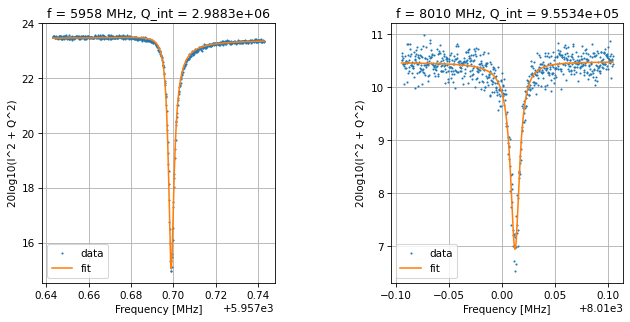

Frequencies out are: [5957.698688070896, 8010.012581259711] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.538 s


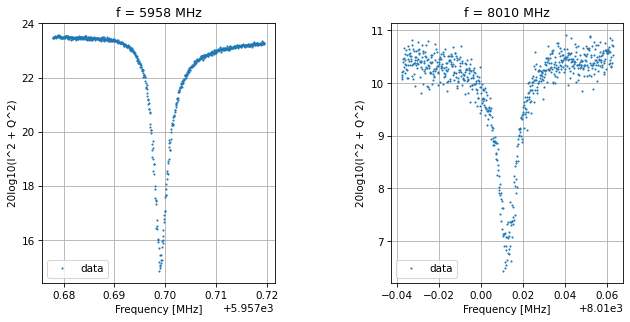

Saving data-2023-09-27-12-07-29
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.427 s


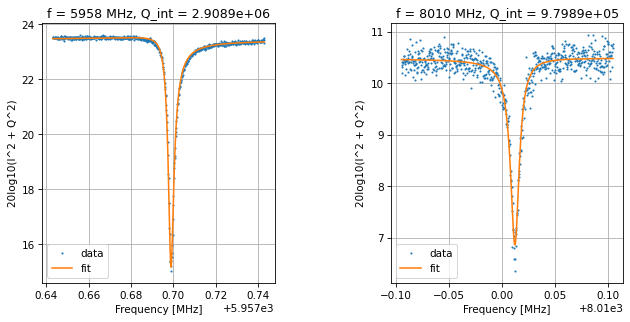

Frequencies out are: [5957.698571037272, 8010.0125154426105] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.627 s


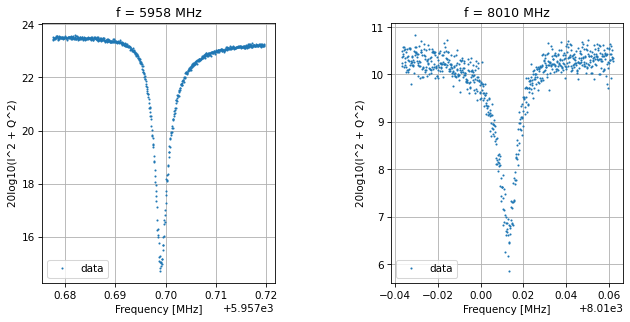

Saving data-2023-09-27-12-08-02
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.468 s


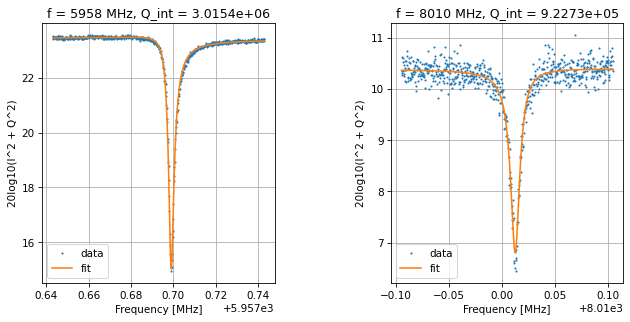

Frequencies out are: [5957.698712657423, 8010.0127544629695] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.521 s


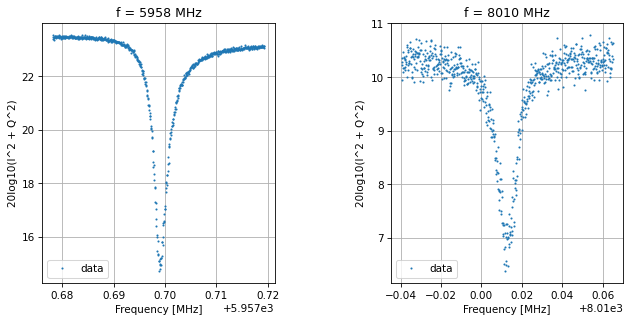

Saving data-2023-09-27-12-08-35
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.537 s


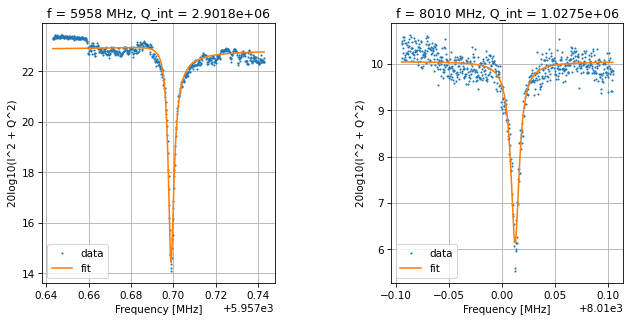

Frequencies out are: [5957.698536952619, 8010.012341653091] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.497 s


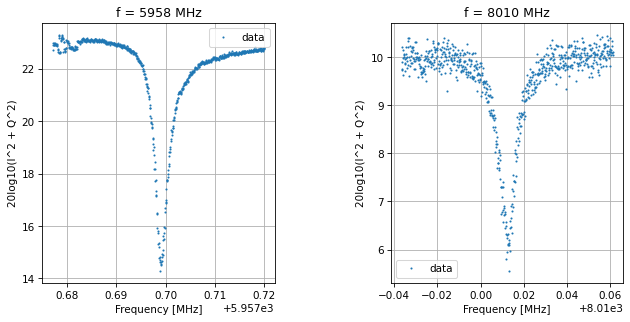

Saving data-2023-09-27-12-09-07
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.563 s


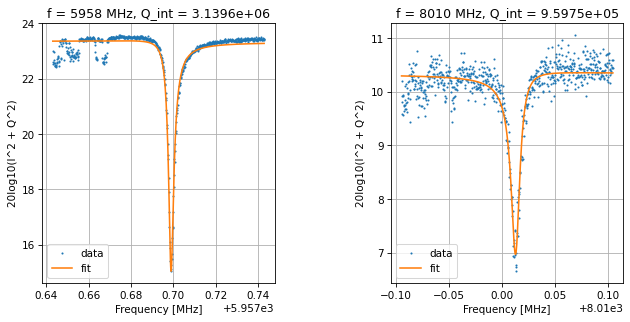

Frequencies out are: [5957.698734370157, 8010.013471074119] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.561 s


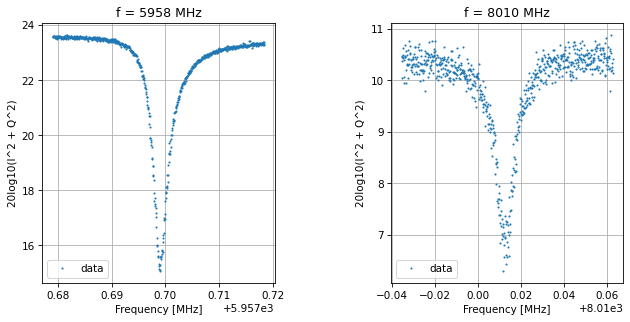

Saving data-2023-09-27-12-09-40
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.547 s


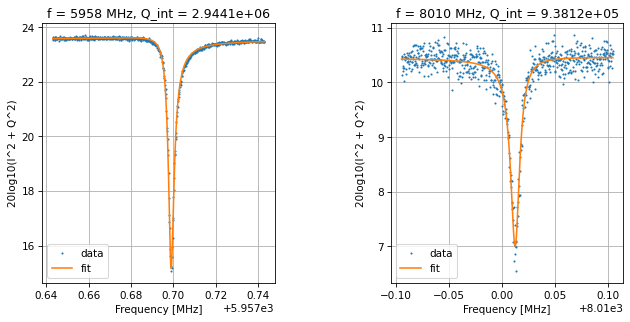

Frequencies out are: [5957.69866132363, 8010.012808102216] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.623 s


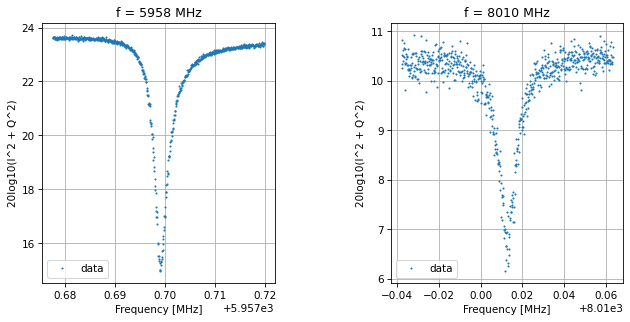

Saving data-2023-09-27-12-10-13
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.386 s


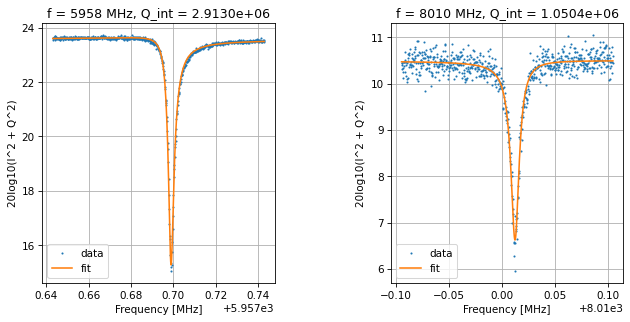

Frequencies out are: [5957.69862726527, 8010.012598628704] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.472 s


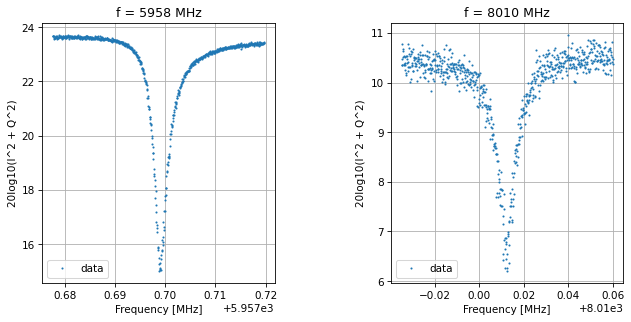

Saving data-2023-09-27-12-10-46
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.450 s


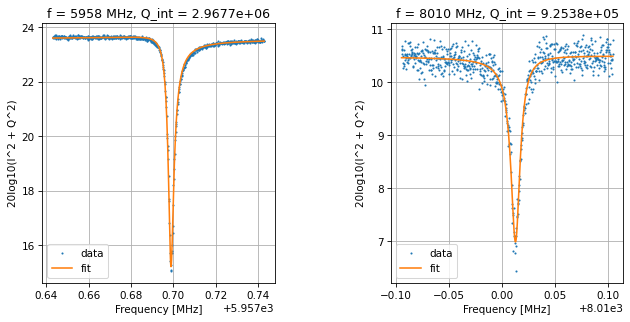

Frequencies out are: [5957.6985886074435, 8010.013140596529] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.383 s


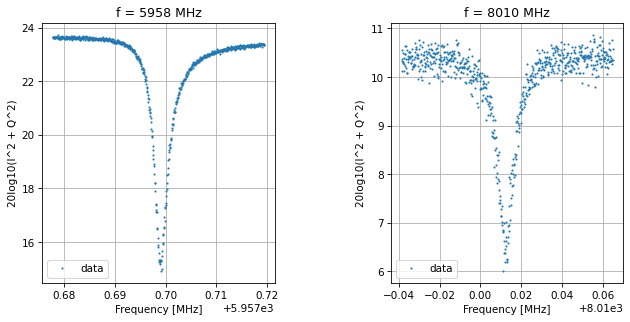

Saving data-2023-09-27-12-11-19
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.340 s


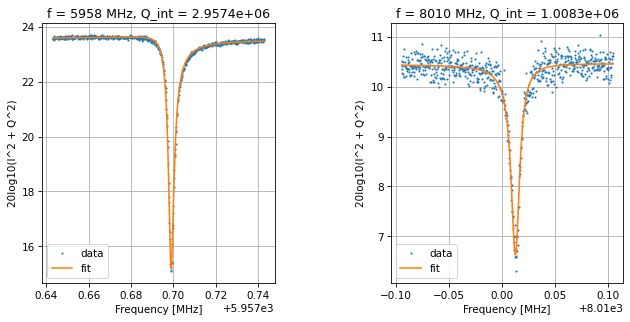

Frequencies out are: [5957.698641956643, 8010.012970844136] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.577 s


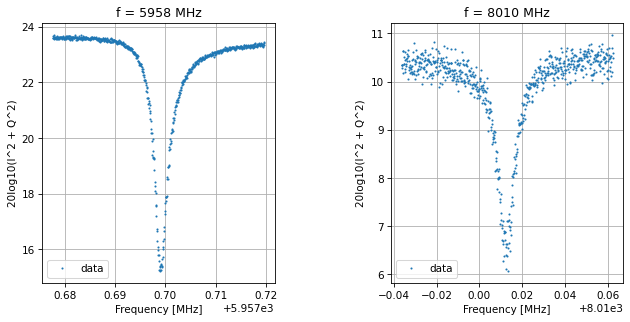

Saving data-2023-09-27-12-11-52
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.585 s


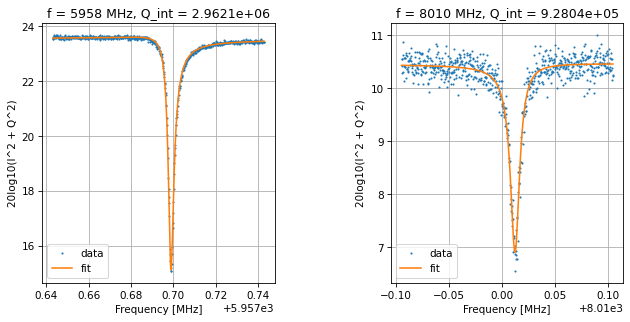

Frequencies out are: [5957.698579322446, 8010.0126511848575] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.507 s


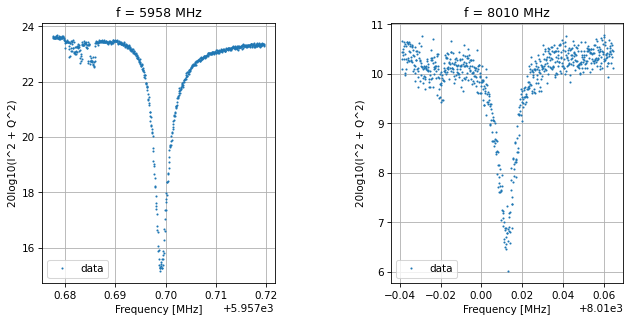

Saving data-2023-09-27-12-12-25
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.508 s


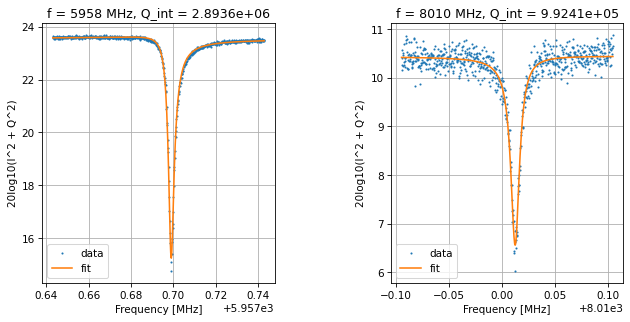

Frequencies out are: [5957.698684774651, 8010.0127188725] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.541 s


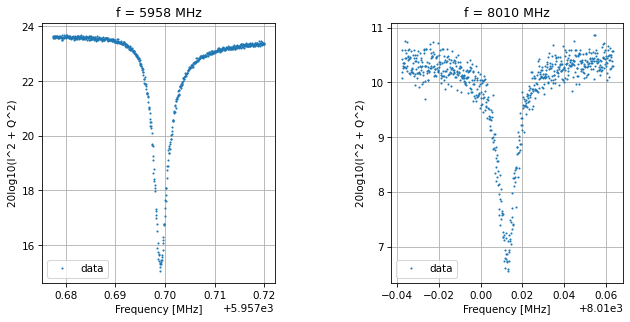

Saving data-2023-09-27-12-12-58
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.606 s


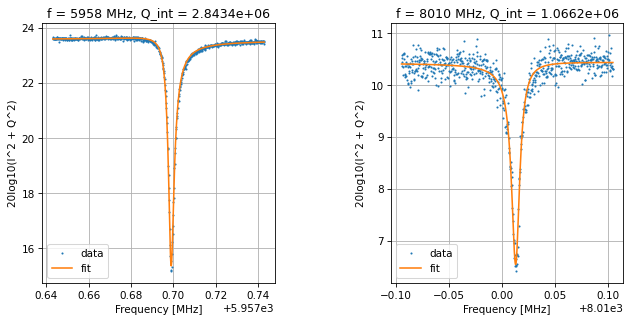

Frequencies out are: [5957.698669070614, 8010.013269966592] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


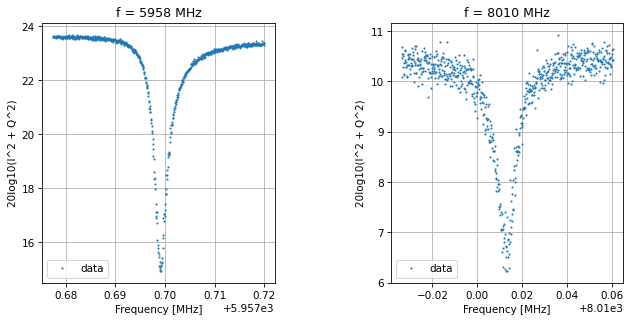

Saving data-2023-09-27-12-13-31
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


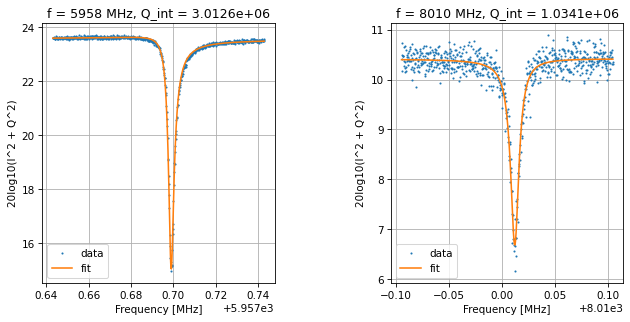

Frequencies out are: [5957.698684940154, 8010.0122787945675] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.684 s


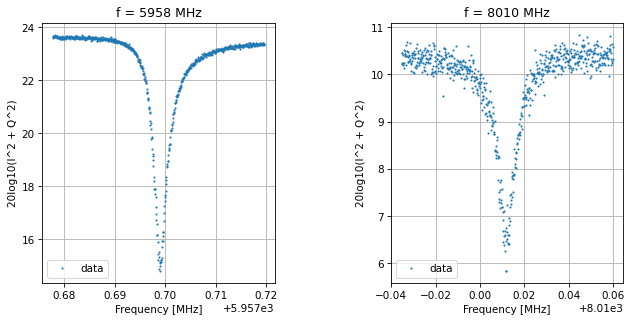

Saving data-2023-09-27-12-14-03
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.476 s


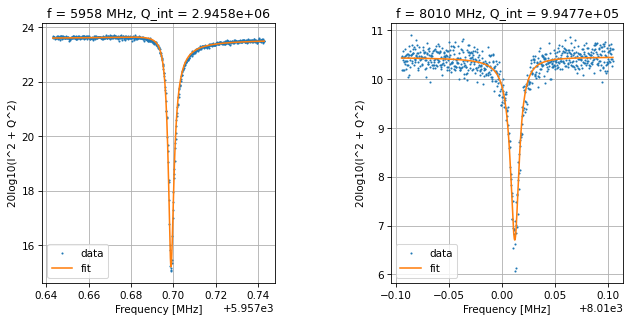

Frequencies out are: [5957.69858777797, 8010.01230430974] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.459 s


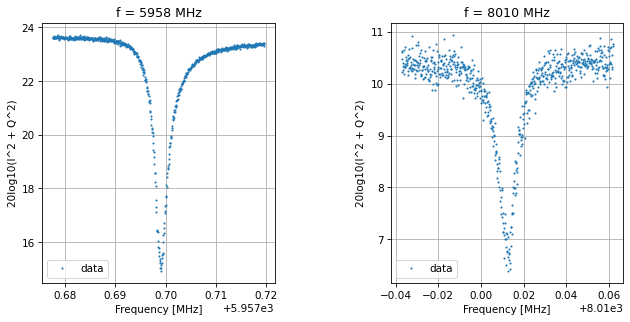

Saving data-2023-09-27-12-14-36
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.556 s


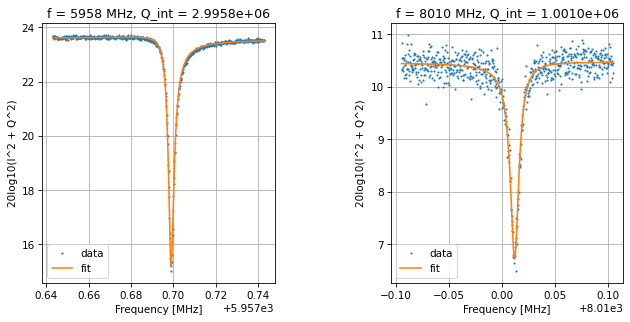

Frequencies out are: [5957.698666029925, 8010.012250797735] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.533 s


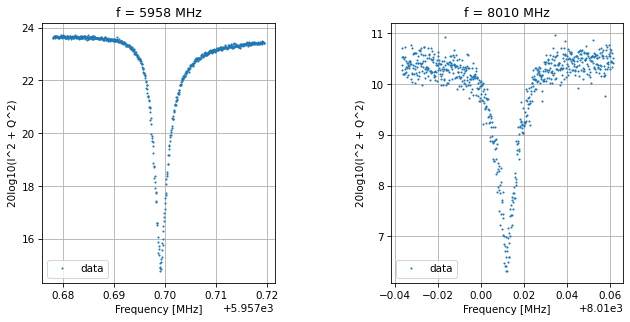

Saving data-2023-09-27-12-15-09
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.478 s


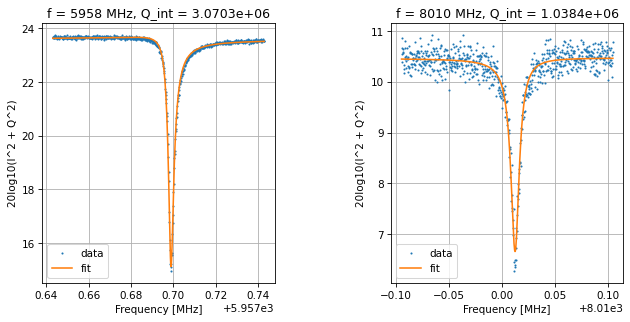

Frequencies out are: [5957.6985915543955, 8010.012597457473] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.493 s


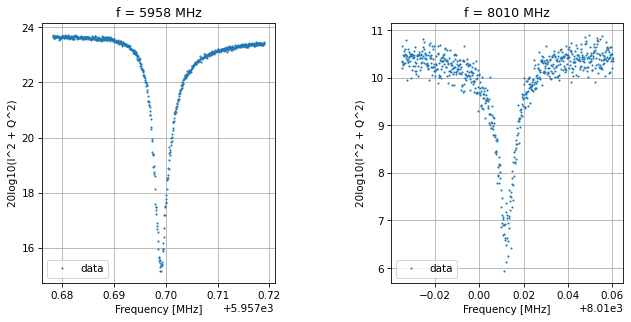

Saving data-2023-09-27-12-15-42
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.573 s


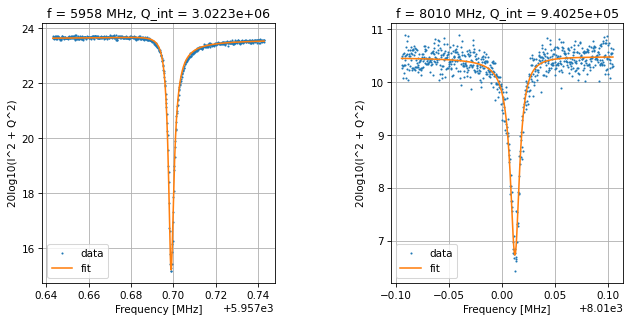

Frequencies out are: [5957.69865189898, 8010.012595856948] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.477 s


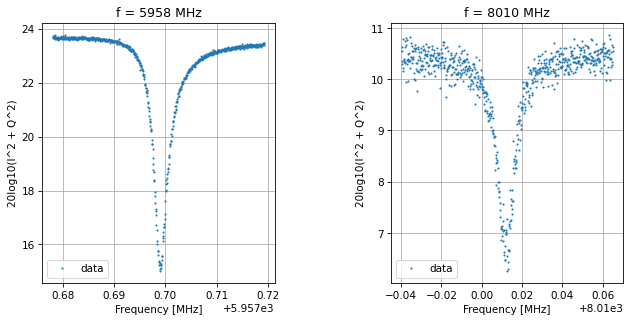

Saving data-2023-09-27-12-16-15
Frequencies out are: [5957.693, 8010.005] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.307 s


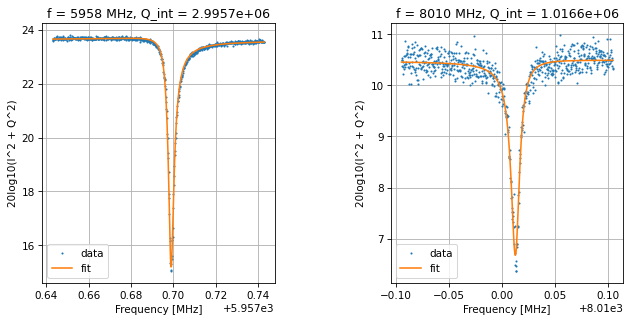

Frequencies out are: [5957.6986512034055, 8010.013065298805] MHz


  0%|          | 0/1 [00:00<?, ?it/s]

Final time = 15.343 s


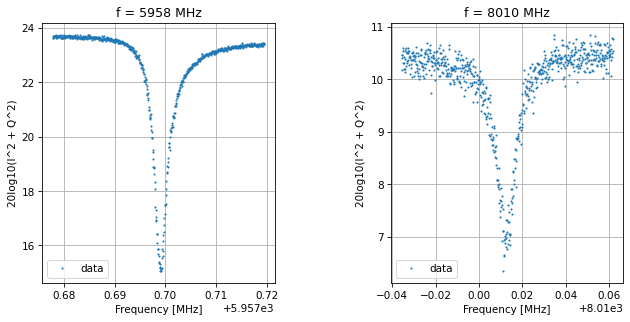

Saving data-2023-09-27-12-16-47
Time for measurement:
3:00:20.056125


In [37]:
# Loop through number of traces
start_time = time.time()

tc.setTemp(0)
print(start_time)
run_TT(socs, chipDicts, soccfgs, turbo = True)
end_time = time.time()

print('Time for measurement:')
print(datetime.timedelta(seconds=end_time-start_time))